In [1]:

from tools.data import Dataset, LensPop, Challenge1, Challenge2, Real
from tools.train import Dispersion, Probabilistic_Dispersion, replacer, globalize

import copy
import numpy as np
import tensorflow as tf
import tensorflow_probability as tfp

tfd = tfp.distributions

%load_ext autoreload
%autoreload 2
%matplotlib inline

In [2]:
dim = (76,76)

lensPop = LensPop()
challenge1 = Challenge1()
real = Real()

challenge2_VIS = Challenge2(['VIS'])
challenge2_VIS.resize(dim)
challenge2 = copy.deepcopy(challenge2_VIS)
challenge2.concatenate(challenge2_VIS)
challenge2.concatenate(challenge2_VIS)

LensPop Data:   0%|          | 0/18289 [00:00<?, ?it/s]

Challenge1 Data:   0%|          | 0/2 [00:00<?, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

Real Data:   0%|          | 0/35 [00:00<?, ?it/s]

Challenge2 Data VIS:   0%|          | 0/65 [00:00<?, ?it/s]

100%|██████████| 14768/14768 [00:00<00:00, 16191.87it/s]


In [3]:
lensPop.shape()
challenge1.shape()
real.shape()
challenge2.shape()

(18289, 76, 76, 3) (18289, 1) (18289, 1)
(3274, 76, 76, 3) (3274, 1) (3274, 1)
(32, 76, 76, 3) (32, 1) (32, 1)
(14768, 76, 76, 3) (14768, 1) (14768, 1)


In [4]:
lensPop.dtype()
challenge1.dtype()
real.dtype()
challenge2.dtype()

LensPop Inputs float32
LensPop Outputs float64
Challenge1 Inputs float32
Challenge1 Outputs float64
Real Inputs float32
Real Outputs float64
Challenge2 Inputs float32
Challenge2 Outputs float64



Real | Band i |   Max: 1.029e+04 |   Min: -4.038e+01
              | P_max: 5.568e+02 | P_min: -2.669e+01

TopK_max: [ 8533.345  9328.51   9972.976 10290.563]
TopK_min: [-40.380768 -40.3455   -39.297543 -35.214947]

Real | Band r |   Max: 7.153e+03 |   Min: -2.618e+01
              | P_max: 3.737e+02 | P_min: -2.085e+01

TopK_max: [5981.873  6475.9233 6931.464  7153.122 ]
TopK_min: [-26.184593 -25.701975 -25.363909 -24.989233]

Real | Band g |   Max: 3.424e+03 |   Min: -2.300e+01
              | P_max: 1.401e+02 | P_min: -1.848e+01

TopK_max: [2796.6343 3125.0996 3309.8606 3423.5417]
TopK_min: [-23.001255 -21.797508 -21.36016  -21.094767]


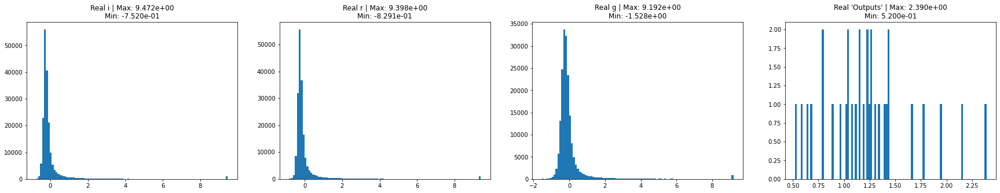

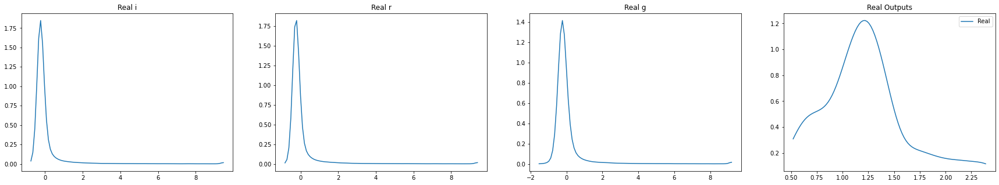

In [5]:
real.adjust_distributions([99.5, 99.5, 99.5], [99.99, 99.99, 99.99], plot=True, normalize= True, density = True, sanity = False, k = 4, bins = 100)


Challenge1 | Band I |   Max: 3.887e-08 |   Min: -6.834e-09
                    | P_max: 2.232e-10 | P_min: -1.772e-11

TopK_max: [3.2547035e-08 3.3978825e-08 3.5870158e-08 3.8865160e-08]
TopK_min: [-6.8338006e-09 -6.8232513e-09 -6.8215882e-09 -6.8160637e-09]

Challenge1 | Band R |   Max: 2.031e-08 |   Min: -8.460e-11
                    | P_max: 1.393e-10 | P_min: -5.438e-12

TopK_max: [1.8701186e-08 1.8771043e-08 1.9080053e-08 2.0305471e-08]
TopK_min: [-8.4604913e-11 -8.4586275e-11 -8.3967250e-11 -8.3104579e-11]

Challenge1 | Band G |   Max: 2.937e-08 |   Min: -6.637e-11
                    | P_max: 6.488e-11 | P_min: -4.461e-12

TopK_max: [2.6771655e-08 2.6771655e-08 2.9370872e-08 2.9370872e-08]
TopK_min: [-6.6374531e-11 -6.4259854e-11 -6.0691813e-11 -6.0532759e-11]


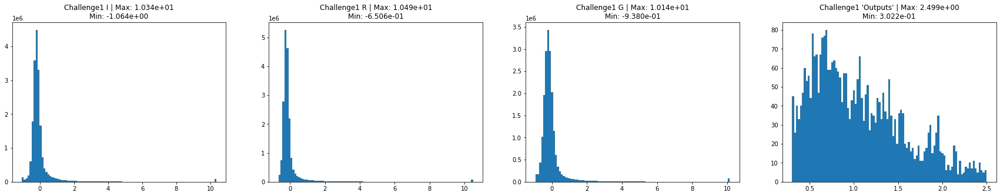

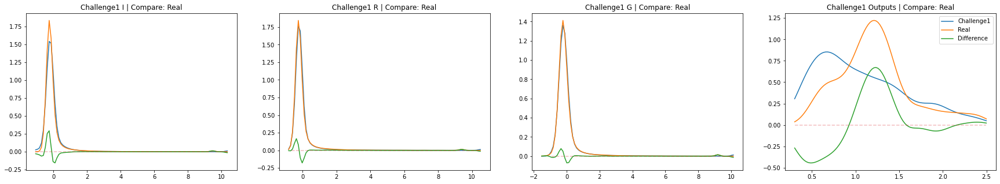

In [6]:
#challenge1.adjust_distributions([99.9, 99.6, 99.6], [99.5, 99.5, 99.5], plot=True, normalize= True,density = True, compare = real,  sanity = False, k = 4, bins = 100)
challenge1.adjust_distributions([99.6, 99.6, 99.6], [99.5, 99.5, 99.5], plot=True, normalize= True,density = True, compare = real,  sanity = False, k = 4, bins = 100)

In [7]:
#challenge1.inputs[:,:,:,0] -= 0.06
#challenge1.inputs[:,:,:,1] -= 0.03
#challenge1.inputs[:,:,:,2] -= 0.02
#challenge1.density(compare = real)


LensPop | Band i |   Max: 7.522e+04 |   Min: -2.788e+01
                 | P_max: 3.685e+02 | P_min: -1.837e+01

TopK_max: [71777.95  71788.195 71788.49  75216.12 ]
TopK_min: [-27.8847   -27.825869 -27.618235 -27.383957]

LensPop | Band r |   Max: 5.439e+04 |   Min: -1.751e+01
                 | P_max: 2.202e+02 | P_min: -1.070e+01

TopK_max: [51824.215 51875.285 51908.73  54387.83 ]
TopK_min: [-17.51338  -16.176178 -16.042444 -15.971641]

LensPop | Band g |   Max: 2.234e+04 |   Min: -1.104e+01
                 | P_max: 6.189e+01 | P_min: -6.625e+00

TopK_max: [21343.115 21358.453 21392.5   22342.312]
TopK_min: [-11.043276  -9.954966  -9.865487  -9.839559]


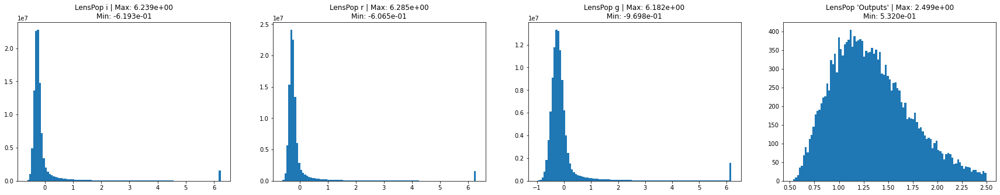

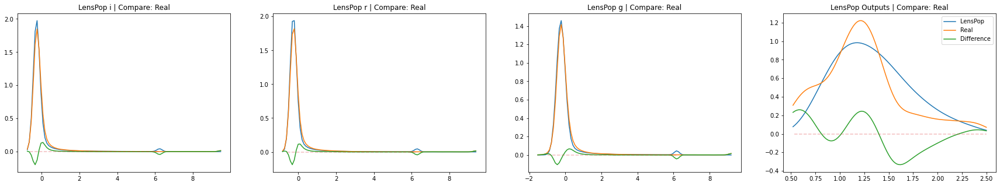

In [8]:
lensPop.adjust_distributions([98.5, 98.5, 98.5], [99.99, 99.99, 99.99], plot=True, normalize= True, density = True, compare = real, sanity = False, k = 4, bins = 100)

In [9]:
#lensPop.inputs[:,:,:,0] += 0.02
#lensPop.inputs[:,:,:,1] += 0.02
#lensPop.inputs[:,:,:,2] += 0.03
#lensPop.density(compare = real)


Challenge2 | Band VIS |   Max: 1.692e-08 |   Min: -2.478e-12
                      | P_max: 1.487e-11 | P_min: -1.494e-12

TopK_max: [1.11054428e-08 1.18620544e-08 1.60126206e-08 1.69185252e-08]
TopK_min: [-2.4780952e-12 -2.3402020e-12 -2.3157539e-12 -2.2743149e-12]

Challenge2 | Band VIS |   Max: 1.692e-08 |   Min: -2.478e-12
                      | P_max: 1.487e-11 | P_min: -1.494e-12

TopK_max: [1.11054428e-08 1.18620544e-08 1.60126206e-08 1.69185252e-08]
TopK_min: [-2.4780952e-12 -2.3402020e-12 -2.3157539e-12 -2.2743149e-12]

Challenge2 | Band VIS |   Max: 1.692e-08 |   Min: -2.478e-12
                      | P_max: 1.487e-11 | P_min: -1.494e-12

TopK_max: [1.11054428e-08 1.18620544e-08 1.60126206e-08 1.69185252e-08]
TopK_min: [-2.4780952e-12 -2.3402020e-12 -2.3157539e-12 -2.2743149e-12]


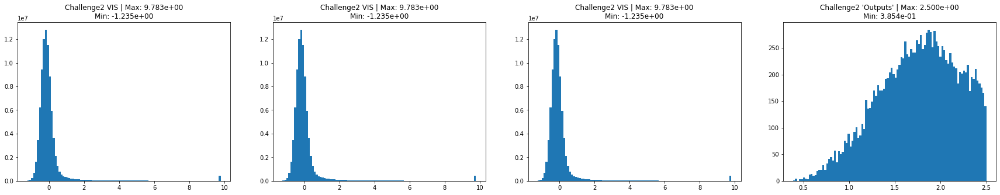

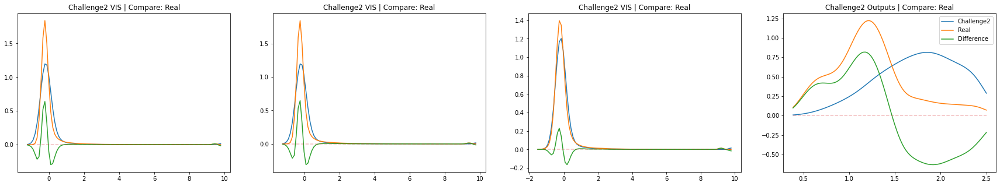

In [10]:
#challenge2.adjust_distributions([99.5, 99.8, 99.7], [99.99, 99.99, 99.99], plot=True, normalize= True, density = True, compare = real, sanity = False, k = 4, bins = 100)
challenge2.adjust_distributions([99.5, 99.5, 99.5], [99.99, 99.99, 99.99], plot=True, normalize= True, density = True, compare = real, sanity = False, k = 4, bins = 100)

In [11]:
#challenge2.inputs[:,:,:,1] -= 0.09
#challenge2.inputs[:,:,:,2] -= 0.04
#challenge2.density(compare = real)

In [12]:
#challenge1.post_processing(sanity = True)
#lensPop.post_processing(sanity = True)
#challenge2.post_processing(sanity = True)

In [13]:
tmp = challenge2.pad(challenge2.inputs[:,:,:,0:1], reverse= True)
tmp = np.concatenate([tmp, challenge2.inputs[:,:,:,0:1]], axis=-1)

In [14]:
X_train = np.concatenate([lensPop.inputs[:,:,:,:], challenge1.inputs[:,:,:,:], tmp], axis=0)
Y_train = np.concatenate([lensPop.outputs, challenge1.outputs, challenge2.outputs], axis=0)
X_val = real.inputs[:,:,:,:]
Y_val = real.outputs

In [ ]:
Train_Dataset = Dataset(X_train, Y_train, ["i",'r','g'])
Train_Dataset.density(compare = real)

# Training

In [ ]:
from tools.train import sample_weight
from tools.models import ResNet34V2, ResNet10V2

#sw, density = sample_weight(Y_train, granularity = 100)


In [ ]:
#indexes = np.random.randint(0,Y_train.shape[0], 512)
#density[indexes].sum()

In [ ]:
optimizer = "adam"
batch_size = 64*8

print("Num GPUs Available: ", len(tf.config.experimental.list_physical_devices('GPU')))

### Deterministic Realm

In [ ]:
#inp = tf.keras.applications.ResNet50V2(
#    include_top=True, weights=None, input_tensor=None,
#    input_shape=(X_val[0,:, :,:].shape), pooling=None, classes=1000)
#inp = ResNet34V2(X_val[0,:,:,:].shape)
inp = ResNet10V2(X_val[0,:,:,:].shape)

#flat = tf.keras.layers.Flatten()(inp.layers[-3].output)

y_hat = tf.keras.layers.Dense(1)(inp.layers[-2].output)

model = tf.keras.models.Model(inputs = inp.input, outputs = y_hat)
model.compile(optimizer = optimizer, loss = "mse")

In [ ]:

gen = tf.keras.preprocessing.image.ImageDataGenerator(
		#rotation_range=180,
		#zoom_range=0.10,
        #brightness_range = [0.90, 1.10],
        #preprocessing_function = lambda x : tf.add(x, tf.random.normal(shape=tf.shape(x), mean=0.0, stddev=1.0, dtype=tf.float32)),
		#vertical_flip = True,
        #horizontal_flip=True,
		fill_mode="nearest")

gen_flow = gen.flow(X_train, Y_train,  batch_size=batch_size, seed=1)

In [ ]:
globalize(model, batch_size, X_train, Y_train, X_val, Y_val)
check = tf.keras.callbacks.ModelCheckpoint('baseline.hdf5', monitor='loss', verbose=1, save_best_only=True)
model.fit(gen_flow, epochs = 300, validation_data = (X_val, Y_val), callbacks=[Dispersion(), check])

### Probabilistic Realm

In [177]:
kernel_divergence_fn = lambda q, p, _: tfd.kl_divergence(q, p) / tf.cast(X_train.shape[0], dtype="float32")

In [178]:
model = replacer(model, tf.keras.layers.Conv2D, 
                      tfp.layers.Convolution2DFlipout,
                      dict(kernel_divergence_fn = kernel_divergence_fn, bias_divergence_fn = kernel_divergence_fn), 
                      ['use_bias', 'bias_initializer', 'bias_regularizer', 'bias_constraint', 'kernel_initializer', 'kernel_regularizer', 'kernel_constraint'])

In [179]:
#flat = tf.keras.layers.Flatten()(model.layers[-3].output)

y_hat = tfp.layers.DenseFlipout(1, kernel_divergence_fn = kernel_divergence_fn, 
                                bias_divergence_fn = kernel_divergence_fn)(model.layers[-2].output)

model = tf.keras.models.Model(inputs = model.input, outputs = y_hat)
model.compile(optimizer = optimizer, loss = "mse")

In [181]:
gen = tf.keras.preprocessing.image.ImageDataGenerator(
		#rotation_range=180,
		#zoom_range=0.10,
        #brightness_range = [0.90, 1.10],
        #preprocessing_function = lambda x : tf.add(x, tf.random.normal(shape=tf.shape(x), mean=0.0, stddev=1.0, dtype=tf.float32)),
		#vertical_flip = True,
        #horizontal_flip=True,
		fill_mode="nearest")

gen_flow = gen.flow(X_train, Y_train,  batch_size=batch_size, seed=1)

Epoch 1/1000
71/71 [==============================] - ETA: 0s - loss: 86.7846

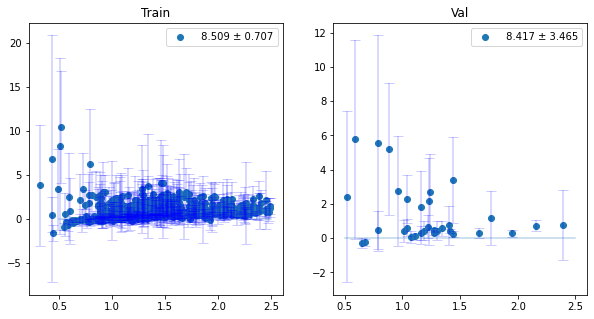

71/71 [==============================] - 101s 1s/step - loss: 86.7846 - val_loss: 98.3905
Epoch 2/1000
71/71 [==============================] - ETA: 0s - loss: 85.2998

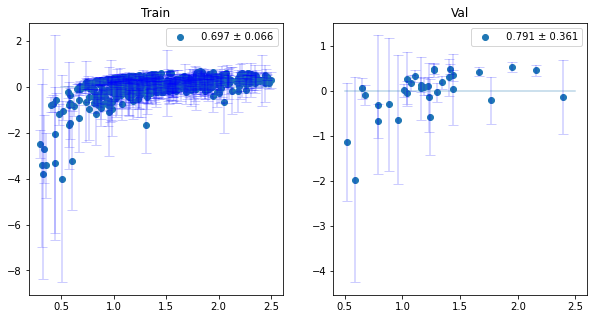

71/71 [==============================] - 100s 1s/step - loss: 85.2998 - val_loss: 84.7906
Epoch 3/1000
71/71 [==============================] - ETA: 0s - loss: 83.7360

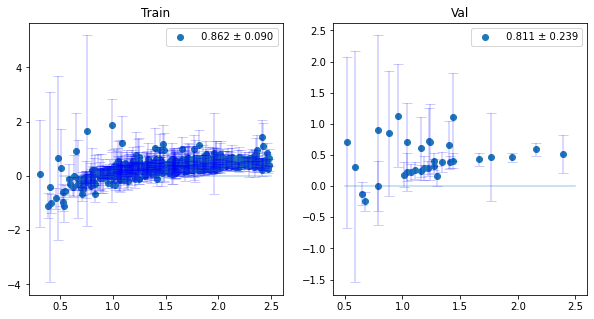

71/71 [==============================] - 101s 1s/step - loss: 83.7360 - val_loss: 83.7167
Epoch 4/1000
71/71 [==============================] - ETA: 0s - loss: 82.0004

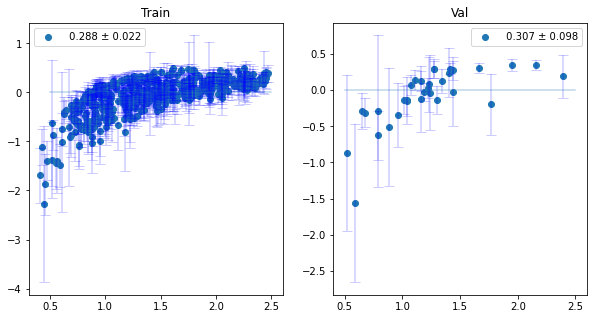

71/71 [==============================] - 101s 1s/step - loss: 82.0004 - val_loss: 81.0857
Epoch 5/1000
71/71 [==============================] - ETA: 0s - loss: 80.1245

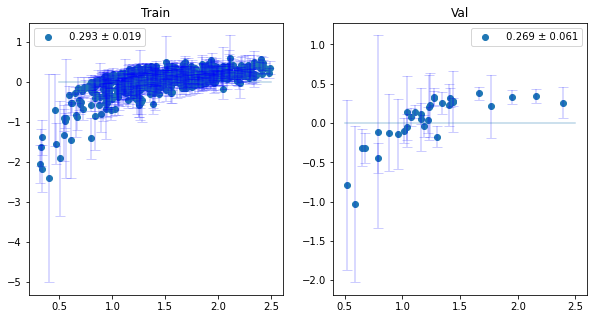

71/71 [==============================] - 101s 1s/step - loss: 80.1245 - val_loss: 79.0921
Epoch 6/1000
71/71 [==============================] - ETA: 0s - loss: 78.1030

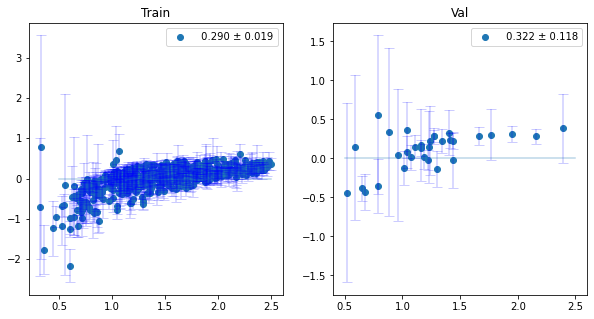

71/71 [==============================] - 101s 1s/step - loss: 78.1030 - val_loss: 77.0749
Epoch 7/1000
71/71 [==============================] - ETA: 0s - loss: 75.9597

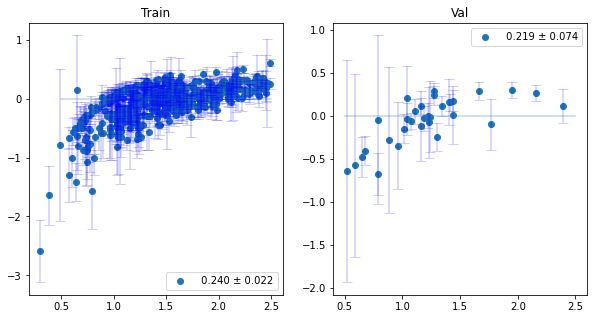

71/71 [==============================] - 101s 1s/step - loss: 75.9597 - val_loss: 74.9081
Epoch 8/1000
71/71 [==============================] - ETA: 0s - loss: 73.6978

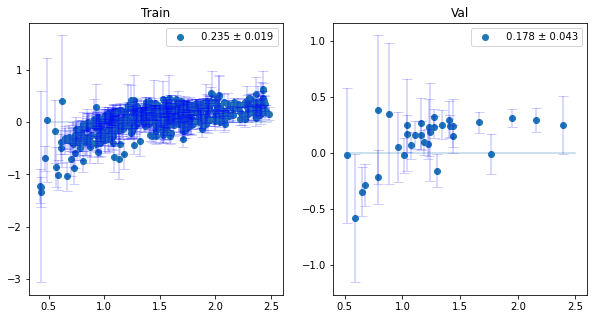

71/71 [==============================] - 101s 1s/step - loss: 73.6978 - val_loss: 72.4717
Epoch 9/1000
71/71 [==============================] - ETA: 0s - loss: 71.3361

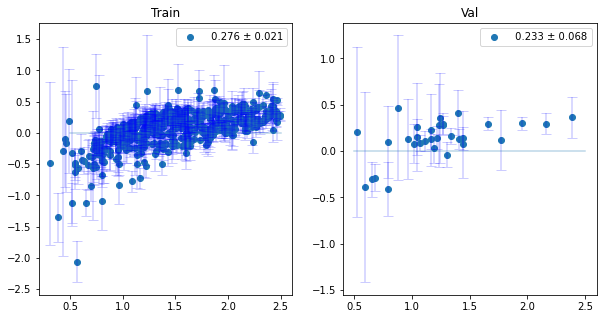

71/71 [==============================] - 101s 1s/step - loss: 71.3361 - val_loss: 70.2360
Epoch 10/1000
71/71 [==============================] - ETA: 0s - loss: 68.8856

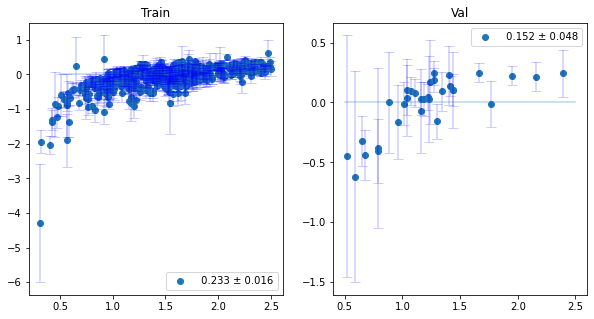

71/71 [==============================] - 100s 1s/step - loss: 68.8856 - val_loss: 67.5957
Epoch 11/1000
71/71 [==============================] - ETA: 0s - loss: 66.3566

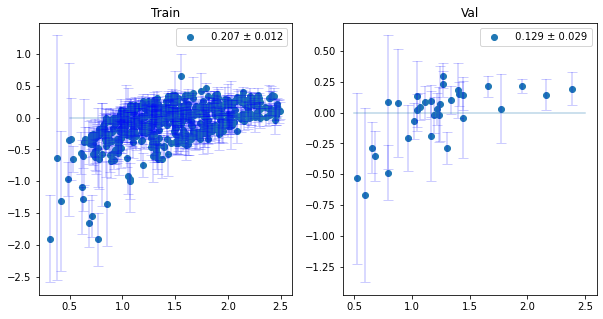

71/71 [==============================] - 102s 1s/step - loss: 66.3566 - val_loss: 65.0305
Epoch 12/1000
71/71 [==============================] - ETA: 0s - loss: 63.7629

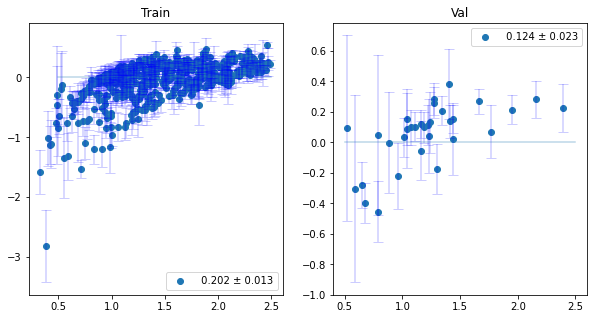

71/71 [==============================] - 102s 1s/step - loss: 63.7629 - val_loss: 62.3631
Epoch 13/1000
71/71 [==============================] - ETA: 0s - loss: 61.1050

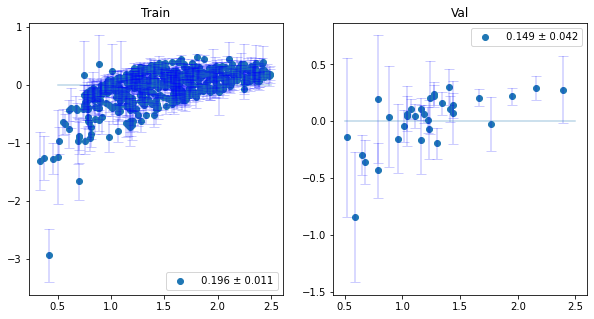

71/71 [==============================] - 100s 1s/step - loss: 61.1050 - val_loss: 59.7619
Epoch 14/1000
71/71 [==============================] - ETA: 0s - loss: 58.4091

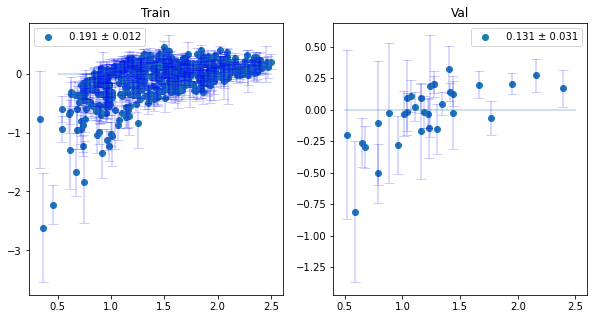

71/71 [==============================] - 100s 1s/step - loss: 58.4091 - val_loss: 56.9475
Epoch 15/1000
71/71 [==============================] - ETA: 0s - loss: 55.6763

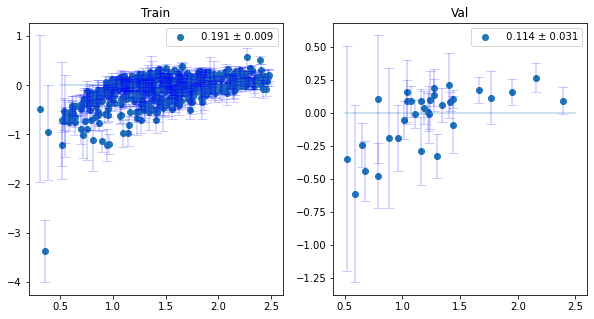

71/71 [==============================] - 101s 1s/step - loss: 55.6763 - val_loss: 54.2016
Epoch 16/1000
71/71 [==============================] - ETA: 0s - loss: 52.9249

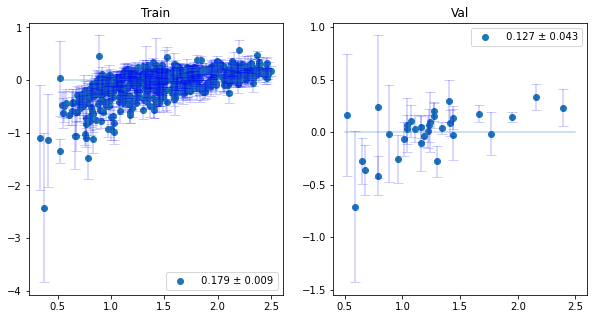

71/71 [==============================] - 101s 1s/step - loss: 52.9249 - val_loss: 51.4925
Epoch 17/1000
71/71 [==============================] - ETA: 0s - loss: 50.1615

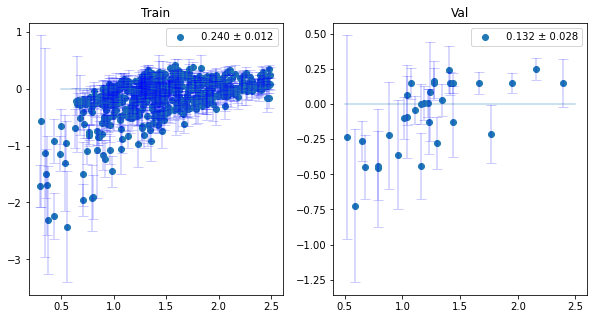

71/71 [==============================] - 100s 1s/step - loss: 50.1615 - val_loss: 48.6441
Epoch 18/1000
71/71 [==============================] - ETA: 0s - loss: 47.4054

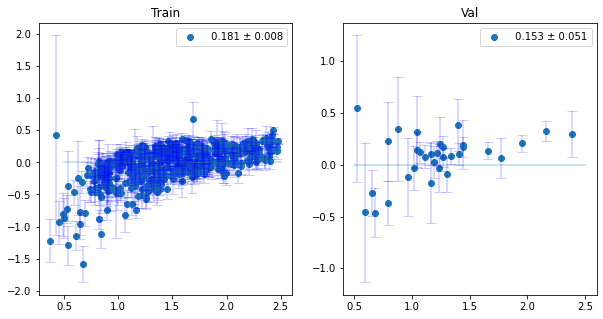

71/71 [==============================] - 101s 1s/step - loss: 47.4054 - val_loss: 45.9848
Epoch 19/1000
71/71 [==============================] - ETA: 0s - loss: 44.6740

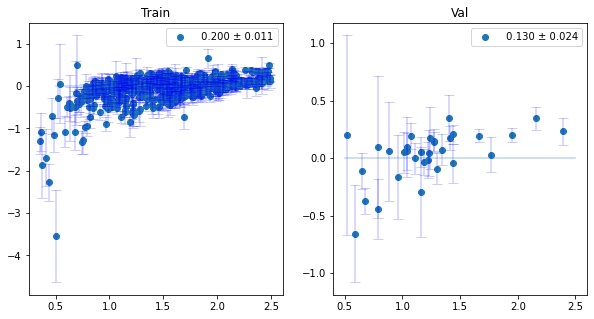

71/71 [==============================] - 101s 1s/step - loss: 44.6740 - val_loss: 43.2792
Epoch 20/1000
71/71 [==============================] - ETA: 0s - loss: 41.9688

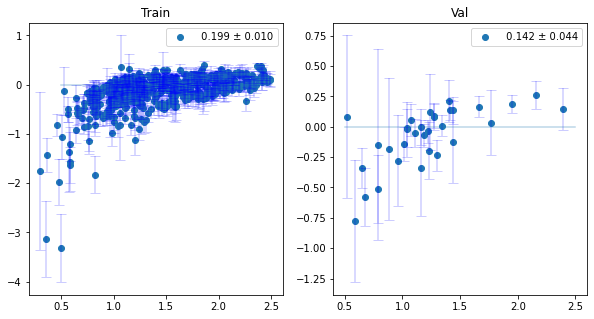

71/71 [==============================] - 101s 1s/step - loss: 41.9688 - val_loss: 40.5983
Epoch 21/1000
71/71 [==============================] - ETA: 0s - loss: 39.3071

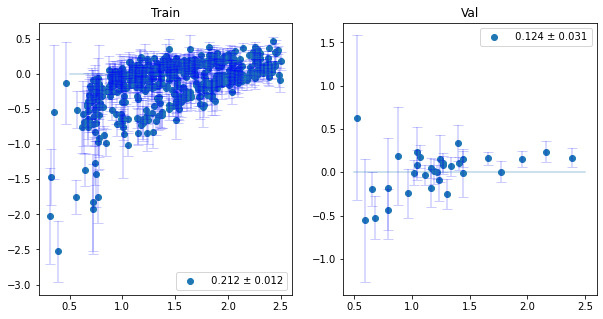

71/71 [==============================] - 100s 1s/step - loss: 39.3071 - val_loss: 37.9654
Epoch 22/1000
71/71 [==============================] - ETA: 0s - loss: 36.6977

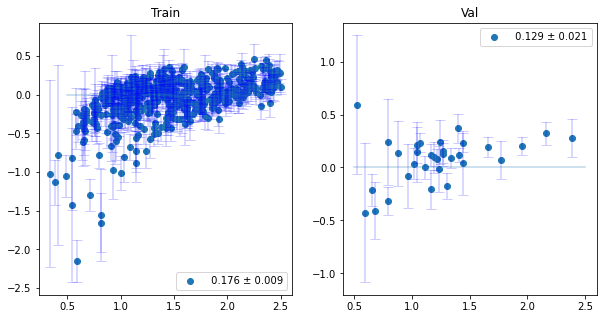

71/71 [==============================] - 100s 1s/step - loss: 36.6977 - val_loss: 35.3970
Epoch 23/1000
71/71 [==============================] - ETA: 0s - loss: 34.1610

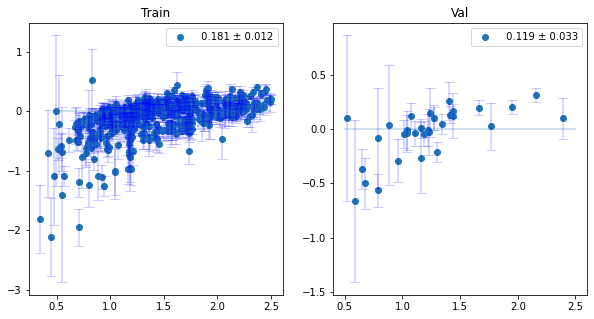

71/71 [==============================] - 101s 1s/step - loss: 34.1610 - val_loss: 32.8678
Epoch 24/1000
71/71 [==============================] - ETA: 0s - loss: 31.6954

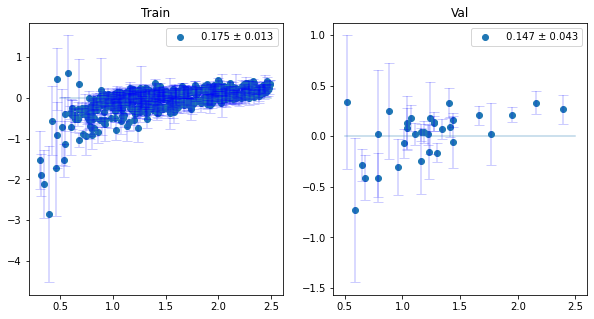

71/71 [==============================] - 101s 1s/step - loss: 31.6954 - val_loss: 30.4393
Epoch 25/1000
71/71 [==============================] - ETA: 0s - loss: 29.3240

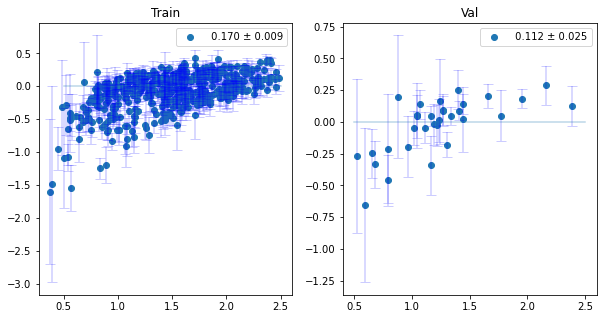

71/71 [==============================] - 101s 1s/step - loss: 29.3240 - val_loss: 28.1315
Epoch 26/1000
71/71 [==============================] - ETA: 0s - loss: 27.0448

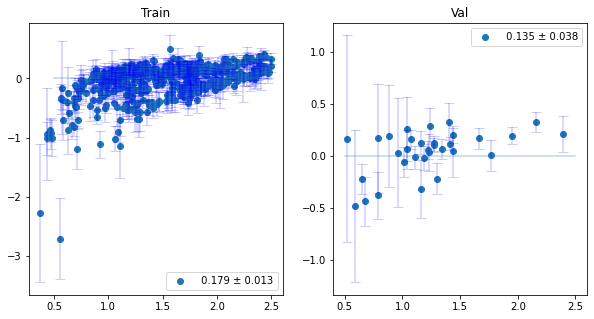

71/71 [==============================] - 102s 1s/step - loss: 27.0448 - val_loss: 25.8854
Epoch 27/1000
71/71 [==============================] - ETA: 0s - loss: 24.8687

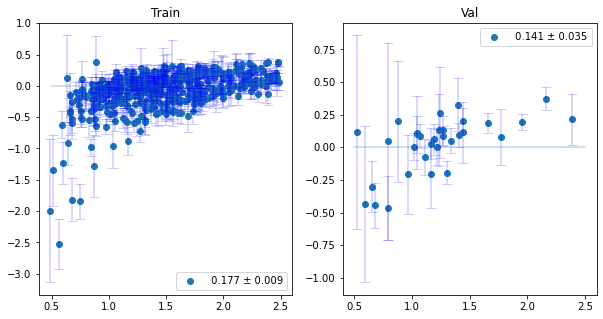

71/71 [==============================] - 102s 1s/step - loss: 24.8687 - val_loss: 23.8335
Epoch 28/1000
71/71 [==============================] - ETA: 0s - loss: 22.8057

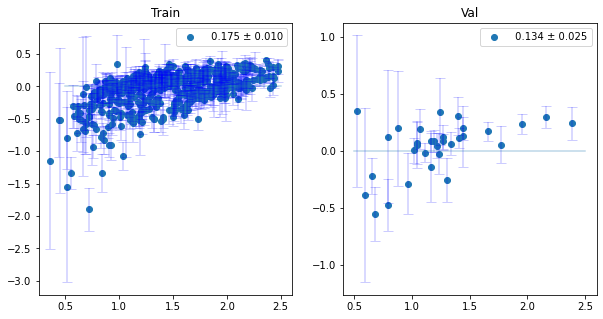

71/71 [==============================] - 101s 1s/step - loss: 22.8057 - val_loss: 21.7835
Epoch 29/1000
71/71 [==============================] - ETA: 0s - loss: 20.8575

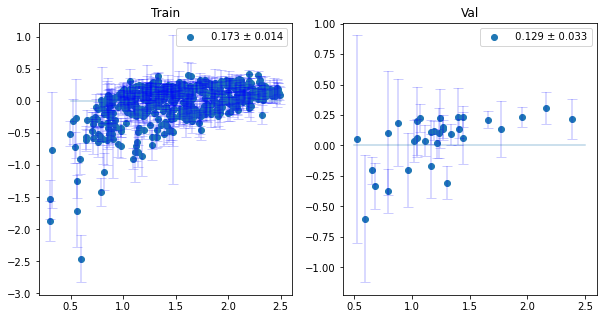

71/71 [==============================] - 101s 1s/step - loss: 20.8575 - val_loss: 19.9118
Epoch 30/1000
71/71 [==============================] - ETA: 0s - loss: 19.0270

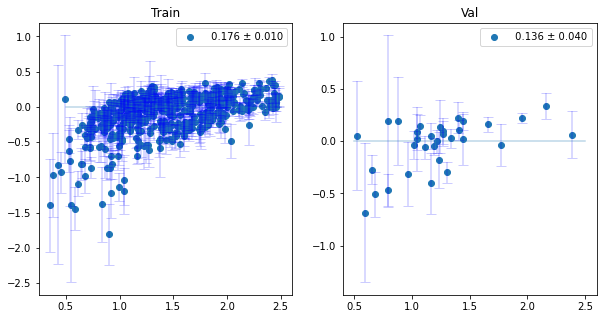

71/71 [==============================] - 102s 1s/step - loss: 19.0270 - val_loss: 18.1084
Epoch 31/1000
71/71 [==============================] - ETA: 0s - loss: 17.3134

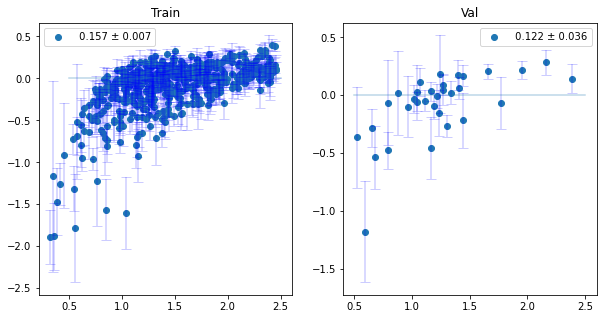

71/71 [==============================] - 102s 1s/step - loss: 17.3134 - val_loss: 16.4770
Epoch 32/1000
71/71 [==============================] - ETA: 0s - loss: 15.7215

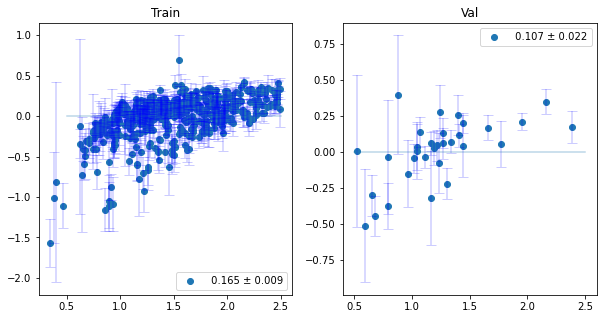

71/71 [==============================] - 102s 1s/step - loss: 15.7215 - val_loss: 14.9576
Epoch 33/1000
71/71 [==============================] - ETA: 0s - loss: 14.2468

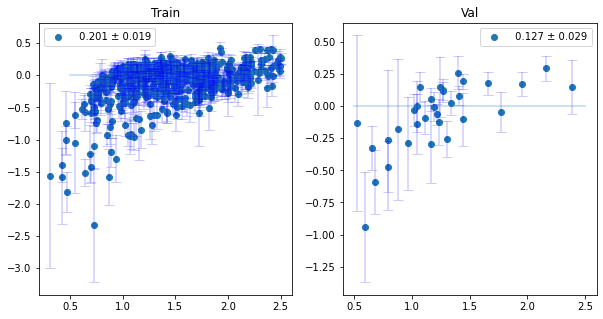

71/71 [==============================] - 100s 1s/step - loss: 14.2468 - val_loss: 13.4874
Epoch 34/1000
71/71 [==============================] - ETA: 0s - loss: 12.8881

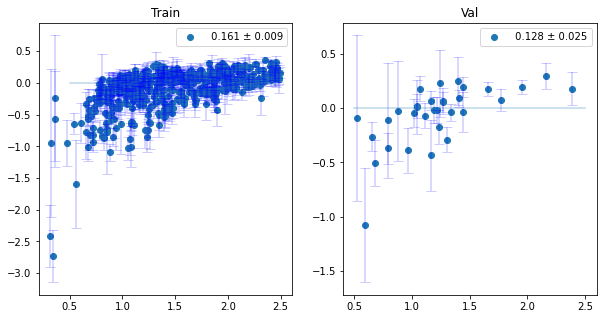

71/71 [==============================] - 100s 1s/step - loss: 12.8881 - val_loss: 12.2813
Epoch 35/1000
71/71 [==============================] - ETA: 0s - loss: 11.6421

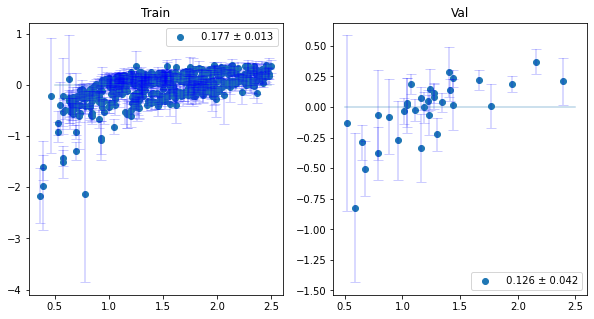

71/71 [==============================] - 100s 1s/step - loss: 11.6421 - val_loss: 11.0311
Epoch 36/1000
71/71 [==============================] - ETA: 0s - loss: 10.5058

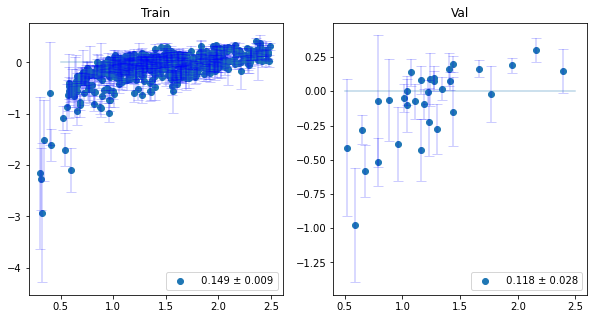

71/71 [==============================] - 100s 1s/step - loss: 10.5058 - val_loss: 9.9362
Epoch 37/1000
71/71 [==============================] - ETA: 0s - loss: 9.4698

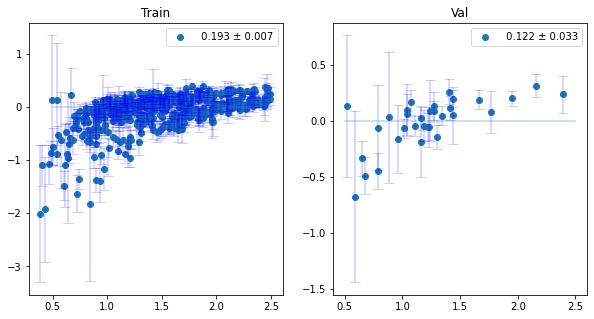

71/71 [==============================] - 100s 1s/step - loss: 9.4698 - val_loss: 8.9962
Epoch 38/1000
71/71 [==============================] - ETA: 0s - loss: 8.5342

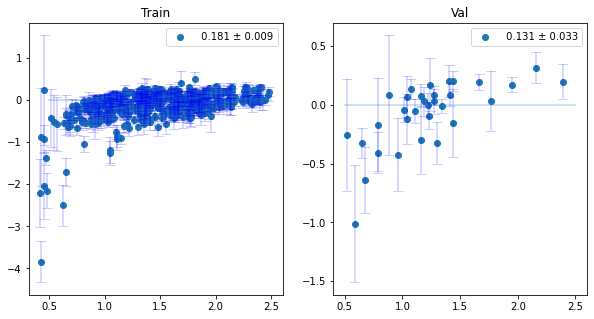

71/71 [==============================] - 100s 1s/step - loss: 8.5342 - val_loss: 8.0690
Epoch 39/1000
71/71 [==============================] - ETA: 0s - loss: 7.6847

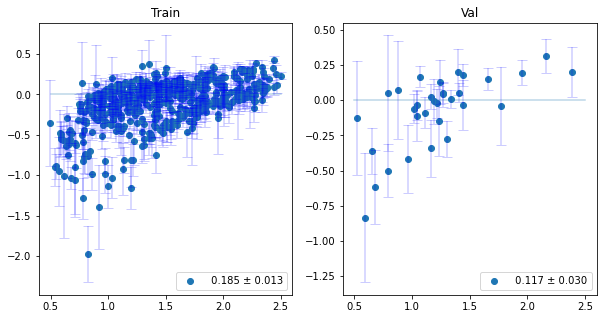

71/71 [==============================] - 101s 1s/step - loss: 7.6847 - val_loss: 7.2714
Epoch 40/1000
71/71 [==============================] - ETA: 0s - loss: 6.9227

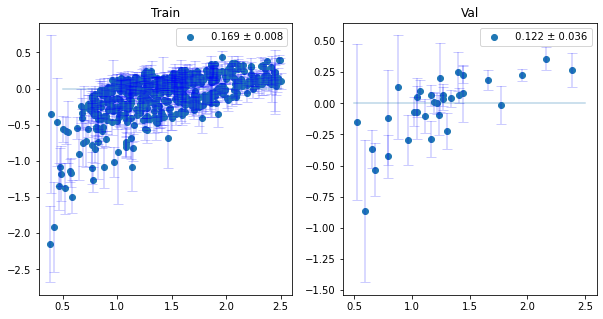

71/71 [==============================] - 101s 1s/step - loss: 6.9227 - val_loss: 6.6086
Epoch 41/1000
71/71 [==============================] - ETA: 0s - loss: 6.2385

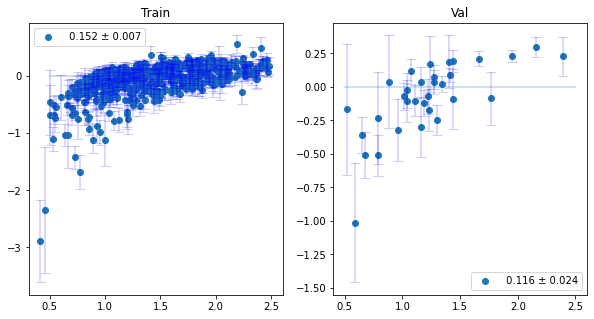

71/71 [==============================] - 101s 1s/step - loss: 6.2385 - val_loss: 5.9160
Epoch 42/1000
71/71 [==============================] - ETA: 0s - loss: 5.6281

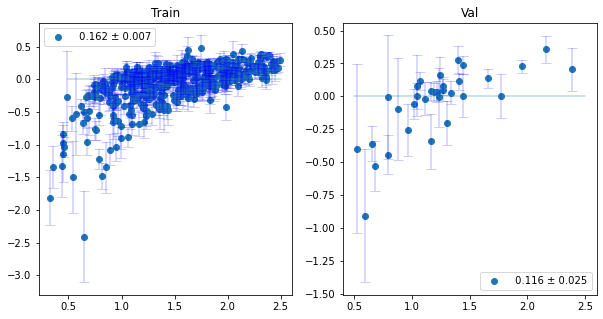

71/71 [==============================] - 101s 1s/step - loss: 5.6281 - val_loss: 5.3062
Epoch 43/1000
71/71 [==============================] - ETA: 0s - loss: 5.0818

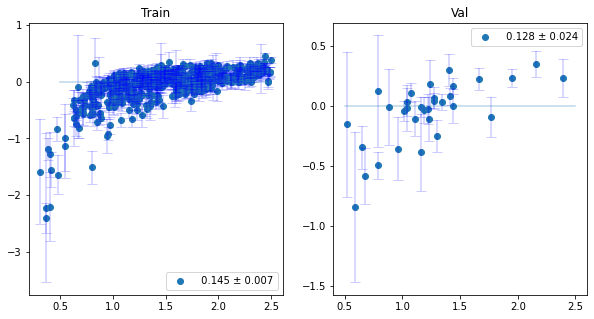

71/71 [==============================] - 100s 1s/step - loss: 5.0818 - val_loss: 4.8422
Epoch 44/1000
71/71 [==============================] - ETA: 0s - loss: 4.5951

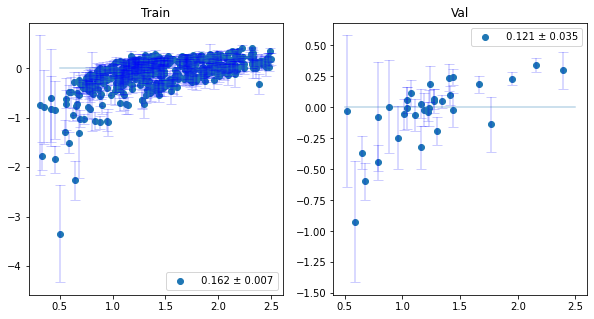

71/71 [==============================] - 101s 1s/step - loss: 4.5951 - val_loss: 4.3300
Epoch 45/1000
71/71 [==============================] - ETA: 0s - loss: 4.1616

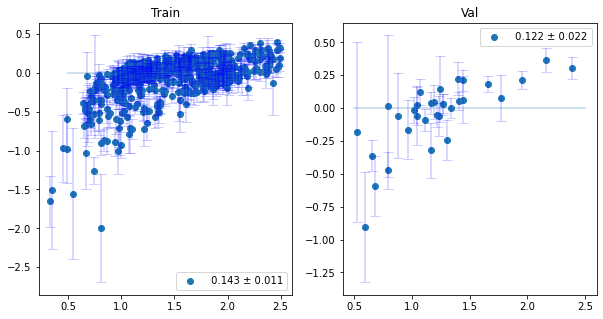

71/71 [==============================] - 101s 1s/step - loss: 4.1616 - val_loss: 3.9245
Epoch 46/1000
71/71 [==============================] - ETA: 0s - loss: 3.7760

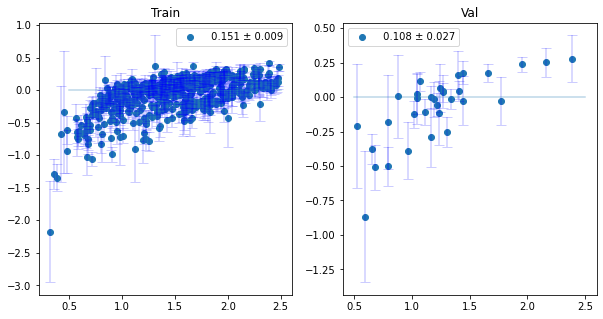

71/71 [==============================] - 101s 1s/step - loss: 3.7760 - val_loss: 3.5394
Epoch 47/1000
71/71 [==============================] - ETA: 0s - loss: 3.4318

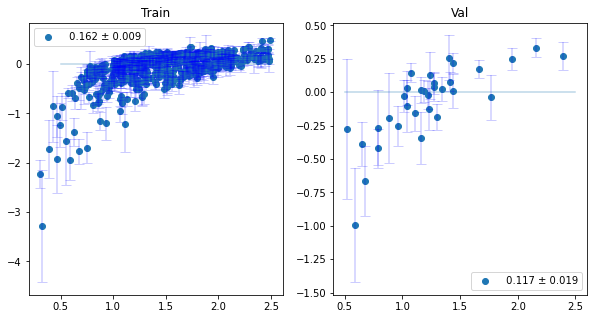

71/71 [==============================] - 101s 1s/step - loss: 3.4318 - val_loss: 3.2679
Epoch 48/1000
71/71 [==============================] - ETA: 0s - loss: 3.1237

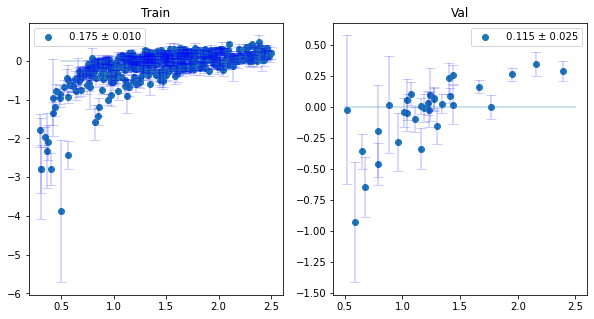

71/71 [==============================] - 101s 1s/step - loss: 3.1237 - val_loss: 2.9639
Epoch 49/1000
71/71 [==============================] - ETA: 0s - loss: 2.8519

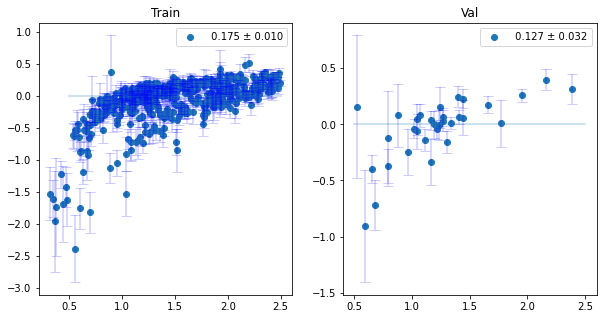

71/71 [==============================] - 100s 1s/step - loss: 2.8519 - val_loss: 2.6890
Epoch 50/1000
71/71 [==============================] - ETA: 0s - loss: 2.6084

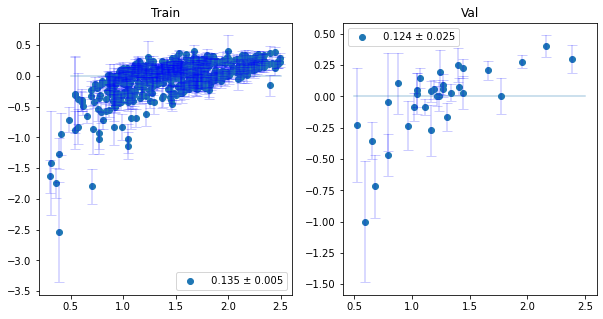

71/71 [==============================] - 101s 1s/step - loss: 2.6084 - val_loss: 2.4542
Epoch 51/1000
71/71 [==============================] - ETA: 0s - loss: 2.3922

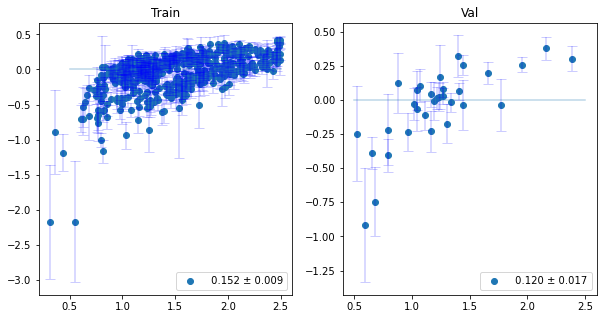

71/71 [==============================] - 101s 1s/step - loss: 2.3922 - val_loss: 2.2673
Epoch 52/1000
71/71 [==============================] - ETA: 0s - loss: 2.1951

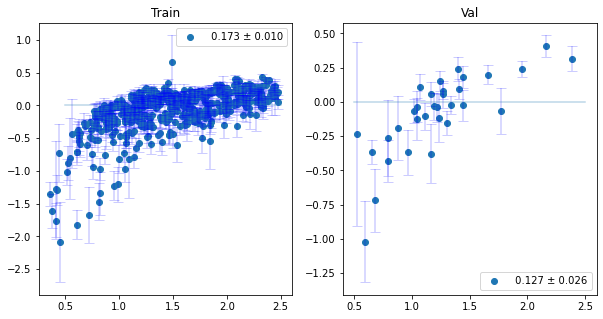

71/71 [==============================] - 101s 1s/step - loss: 2.1951 - val_loss: 2.0785
Epoch 53/1000
71/71 [==============================] - ETA: 0s - loss: 2.0225

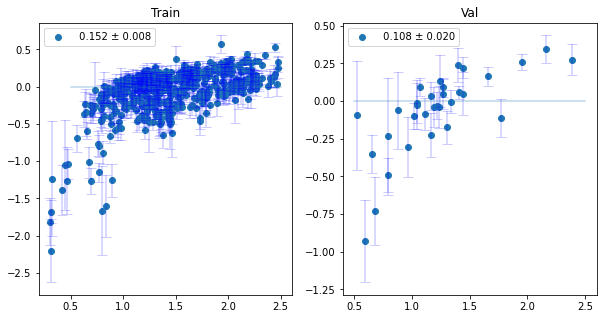

71/71 [==============================] - 101s 1s/step - loss: 2.0225 - val_loss: 1.9103
Epoch 54/1000
71/71 [==============================] - ETA: 0s - loss: 1.8659

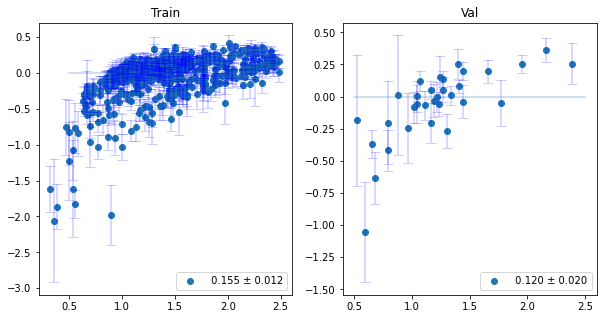

71/71 [==============================] - 100s 1s/step - loss: 1.8659 - val_loss: 1.8095
Epoch 55/1000
71/71 [==============================] - ETA: 0s - loss: 1.7266

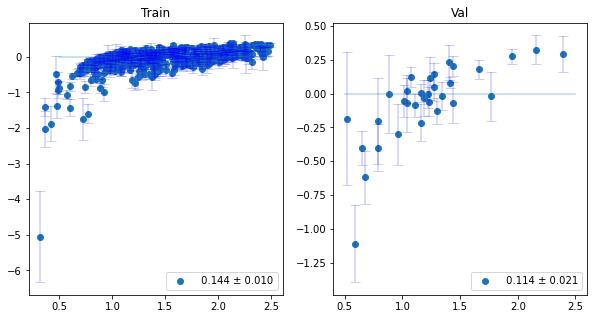

71/71 [==============================] - 100s 1s/step - loss: 1.7266 - val_loss: 1.6290
Epoch 56/1000
71/71 [==============================] - ETA: 0s - loss: 1.5992

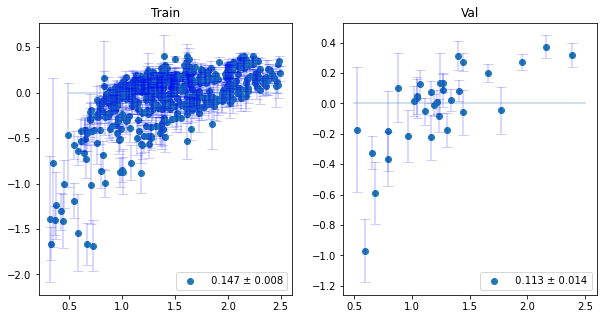

71/71 [==============================] - 102s 1s/step - loss: 1.5992 - val_loss: 1.5618
Epoch 57/1000
71/71 [==============================] - ETA: 0s - loss: 1.4875

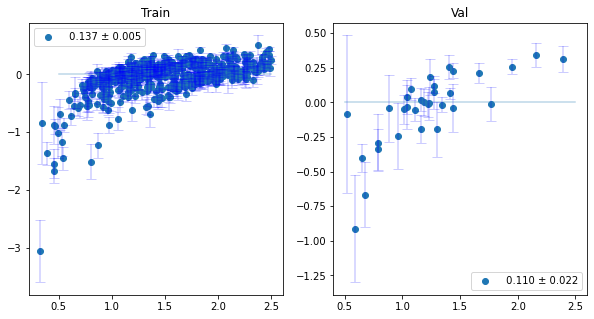

71/71 [==============================] - 100s 1s/step - loss: 1.4875 - val_loss: 1.4591
Epoch 58/1000
71/71 [==============================] - ETA: 0s - loss: 1.3833

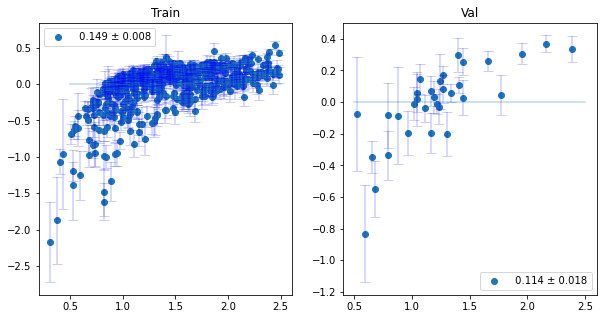

71/71 [==============================] - 100s 1s/step - loss: 1.3833 - val_loss: 1.3149
Epoch 59/1000
71/71 [==============================] - ETA: 0s - loss: 1.2905

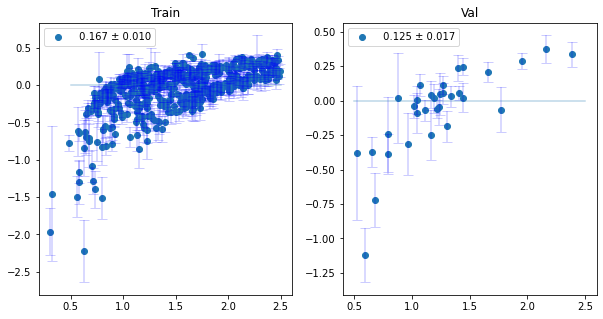

71/71 [==============================] - 102s 1s/step - loss: 1.2905 - val_loss: 1.2051
Epoch 60/1000
71/71 [==============================] - ETA: 0s - loss: 1.2051

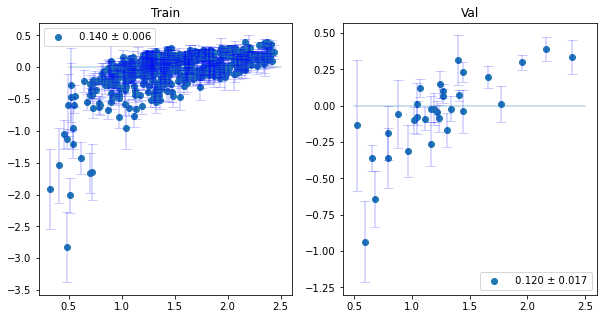

71/71 [==============================] - 101s 1s/step - loss: 1.2051 - val_loss: 1.1112
Epoch 61/1000
71/71 [==============================] - ETA: 0s - loss: 1.1269

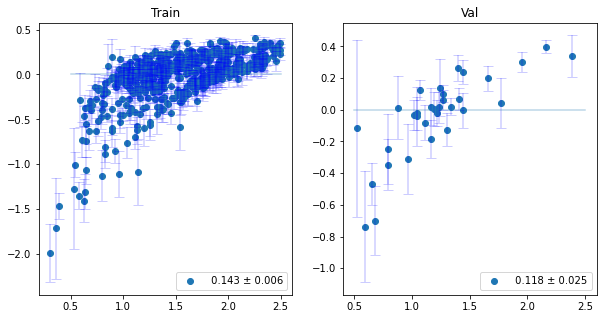

71/71 [==============================] - 100s 1s/step - loss: 1.1269 - val_loss: 1.1001
Epoch 62/1000
71/71 [==============================] - ETA: 0s - loss: 1.0578

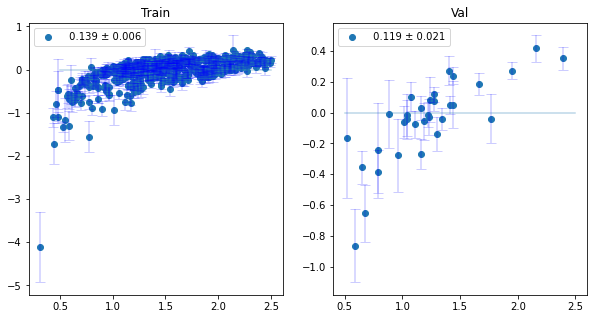

71/71 [==============================] - 102s 1s/step - loss: 1.0578 - val_loss: 1.0053
Epoch 63/1000
71/71 [==============================] - ETA: 0s - loss: 0.9934

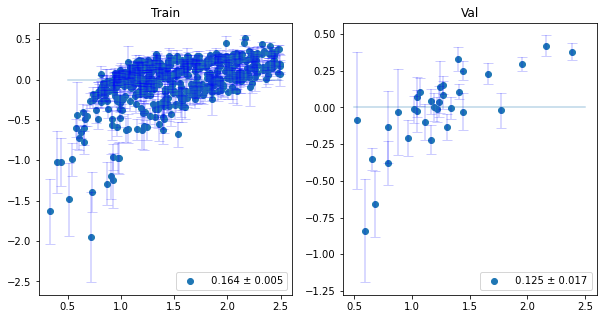

71/71 [==============================] - 102s 1s/step - loss: 0.9934 - val_loss: 0.9480
Epoch 64/1000
71/71 [==============================] - ETA: 0s - loss: 0.9346

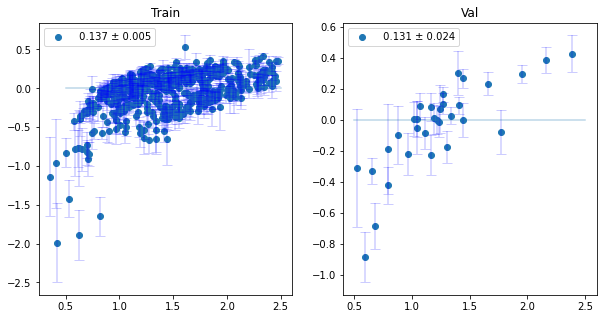

71/71 [==============================] - 102s 1s/step - loss: 0.9346 - val_loss: 0.8870
Epoch 65/1000
71/71 [==============================] - ETA: 0s - loss: 0.8810

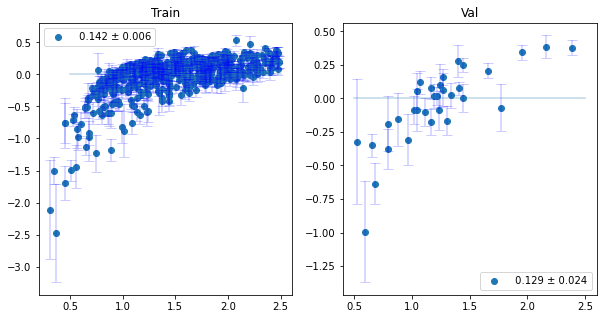

71/71 [==============================] - 102s 1s/step - loss: 0.8810 - val_loss: 0.8521
Epoch 66/1000
71/71 [==============================] - ETA: 0s - loss: 0.8325

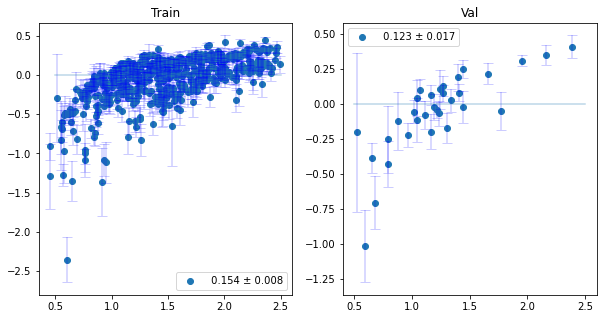

71/71 [==============================] - 100s 1s/step - loss: 0.8325 - val_loss: 0.8254
Epoch 67/1000
71/71 [==============================] - ETA: 0s - loss: 0.7877

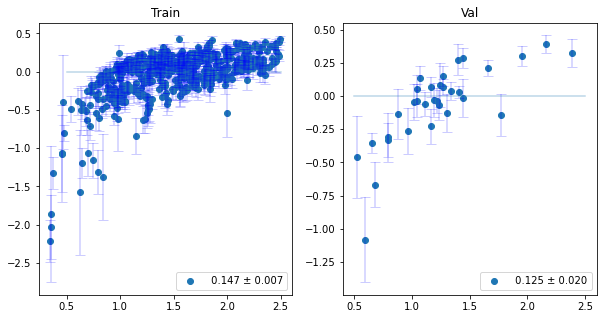

71/71 [==============================] - 101s 1s/step - loss: 0.7877 - val_loss: 0.7466
Epoch 68/1000
71/71 [==============================] - ETA: 0s - loss: 0.7457

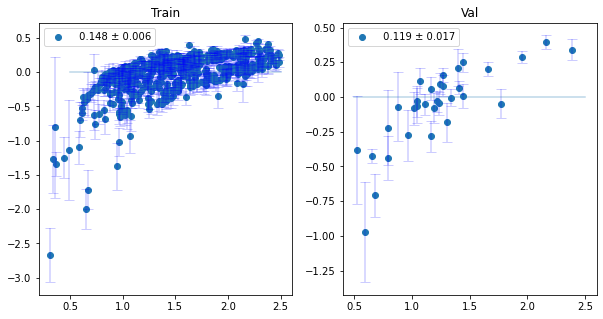

71/71 [==============================] - 101s 1s/step - loss: 0.7457 - val_loss: 0.7092
Epoch 69/1000
71/71 [==============================] - ETA: 0s - loss: 0.7090

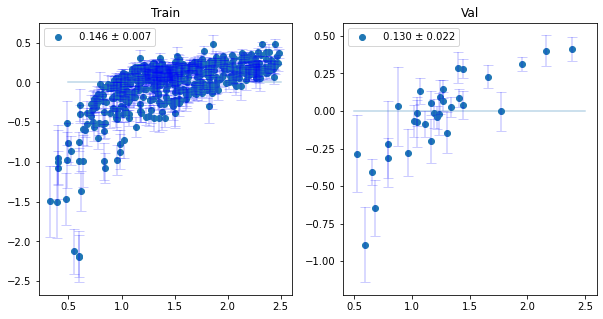

71/71 [==============================] - 100s 1s/step - loss: 0.7090 - val_loss: 0.7093
Epoch 70/1000
71/71 [==============================] - ETA: 0s - loss: 0.6733

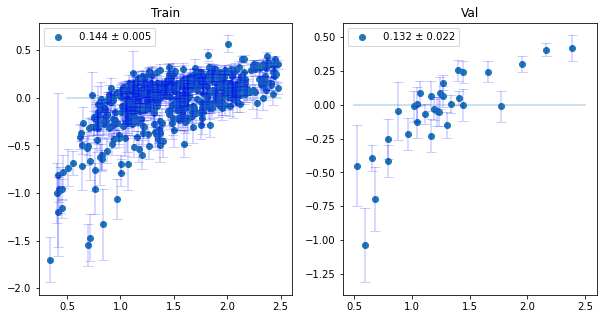

71/71 [==============================] - 100s 1s/step - loss: 0.6733 - val_loss: 0.6568
Epoch 71/1000
71/71 [==============================] - ETA: 0s - loss: 0.6417

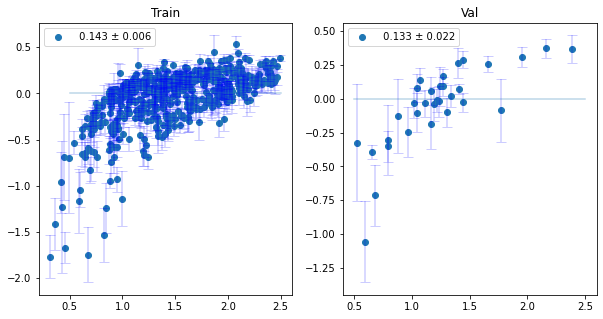

71/71 [==============================] - 100s 1s/step - loss: 0.6417 - val_loss: 0.5995
Epoch 72/1000
71/71 [==============================] - ETA: 0s - loss: 0.6121

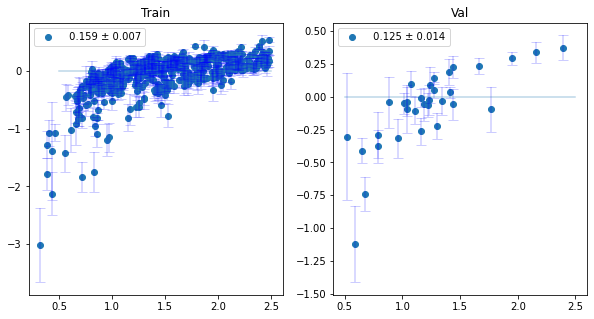

71/71 [==============================] - 100s 1s/step - loss: 0.6121 - val_loss: 0.6019
Epoch 73/1000
71/71 [==============================] - ETA: 0s - loss: 0.5851

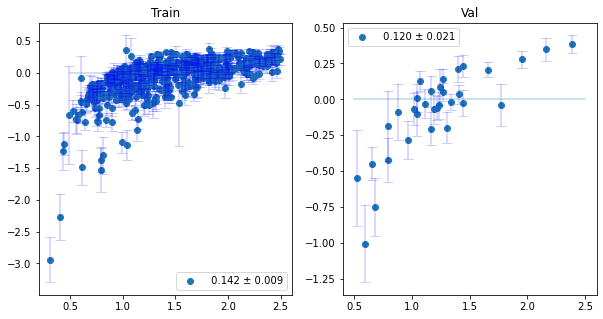

71/71 [==============================] - 100s 1s/step - loss: 0.5851 - val_loss: 0.5914
Epoch 74/1000
71/71 [==============================] - ETA: 0s - loss: 0.5605

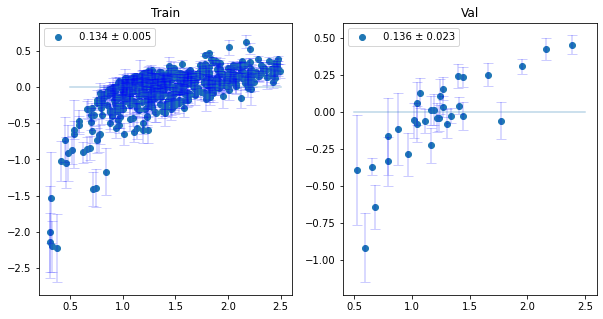

71/71 [==============================] - 100s 1s/step - loss: 0.5605 - val_loss: 0.5507
Epoch 75/1000
71/71 [==============================] - ETA: 0s - loss: 0.5383

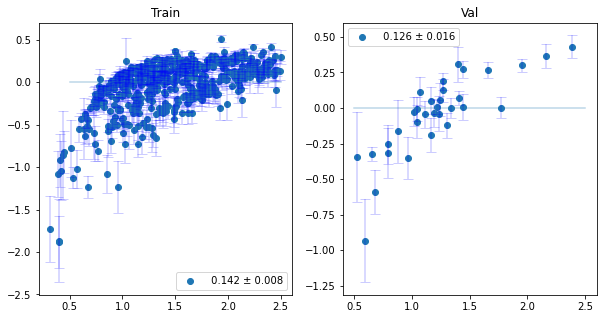

71/71 [==============================] - 101s 1s/step - loss: 0.5383 - val_loss: 0.5330
Epoch 76/1000
71/71 [==============================] - ETA: 0s - loss: 0.5176

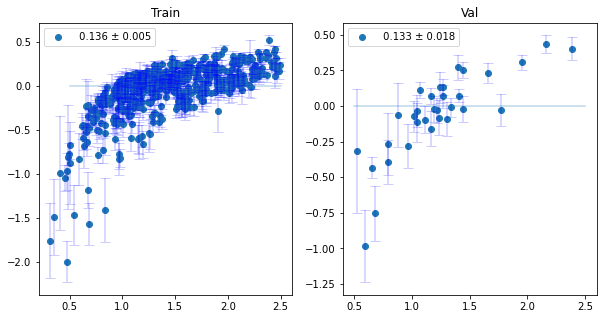

71/71 [==============================] - 101s 1s/step - loss: 0.5176 - val_loss: 0.4946
Epoch 77/1000
71/71 [==============================] - ETA: 0s - loss: 0.4975

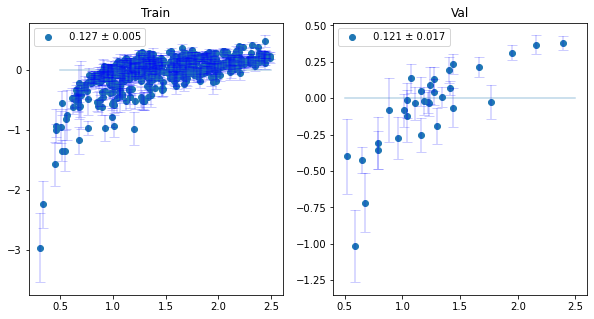

71/71 [==============================] - 101s 1s/step - loss: 0.4975 - val_loss: 0.4522
Epoch 78/1000
71/71 [==============================] - ETA: 0s - loss: 0.4810

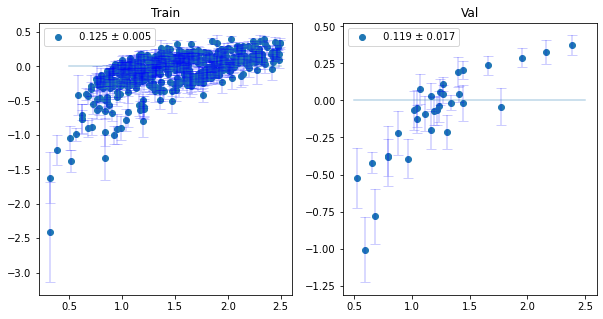

71/71 [==============================] - 101s 1s/step - loss: 0.4810 - val_loss: 0.4798
Epoch 79/1000
71/71 [==============================] - ETA: 0s - loss: 0.4640

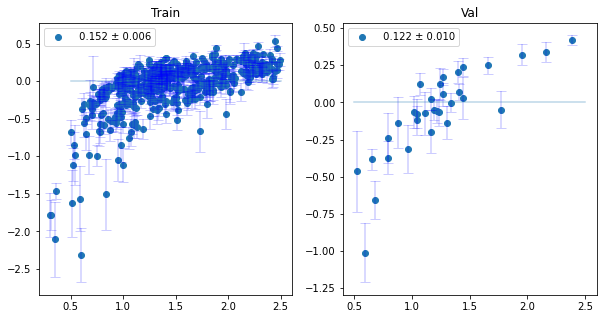

71/71 [==============================] - 101s 1s/step - loss: 0.4640 - val_loss: 0.4249
Epoch 80/1000
71/71 [==============================] - ETA: 0s - loss: 0.4475

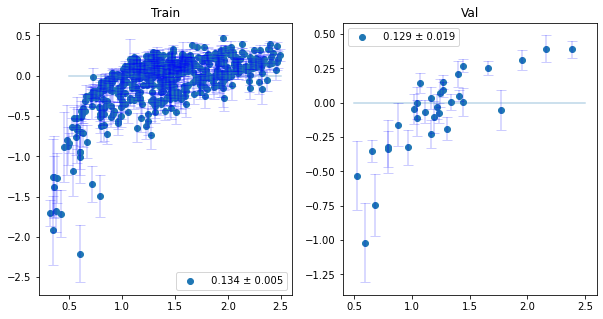

71/71 [==============================] - 102s 1s/step - loss: 0.4475 - val_loss: 0.4282
Epoch 81/1000
71/71 [==============================] - ETA: 0s - loss: 0.4340

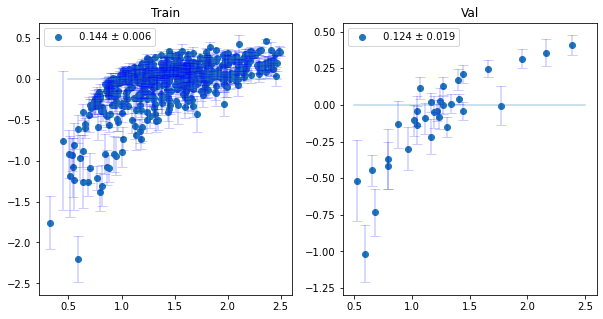

71/71 [==============================] - 103s 1s/step - loss: 0.4340 - val_loss: 0.4171
Epoch 82/1000
71/71 [==============================] - ETA: 0s - loss: 0.4192

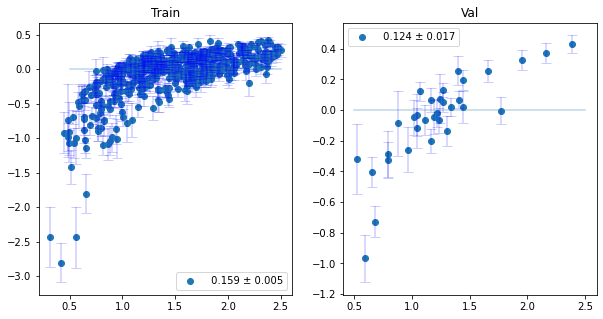

71/71 [==============================] - 102s 1s/step - loss: 0.4192 - val_loss: 0.4040
Epoch 83/1000
71/71 [==============================] - ETA: 0s - loss: 0.4086

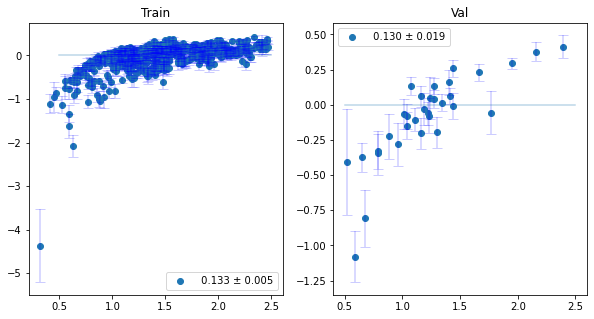

71/71 [==============================] - 101s 1s/step - loss: 0.4086 - val_loss: 0.3760
Epoch 84/1000
71/71 [==============================] - ETA: 0s - loss: 0.3946

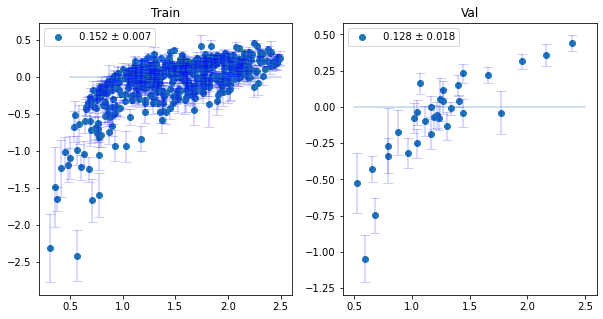

71/71 [==============================] - 100s 1s/step - loss: 0.3946 - val_loss: 0.4121
Epoch 85/1000
71/71 [==============================] - ETA: 0s - loss: 0.3839

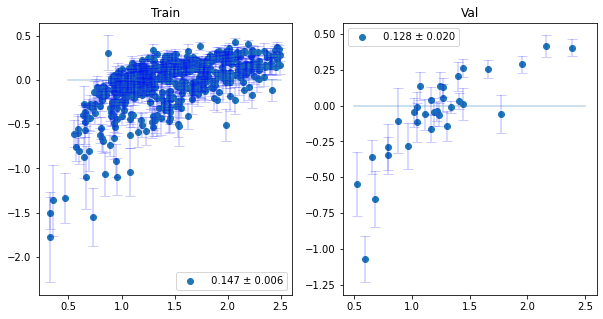

71/71 [==============================] - 102s 1s/step - loss: 0.3839 - val_loss: 0.3658
Epoch 86/1000
71/71 [==============================] - ETA: 0s - loss: 0.3724

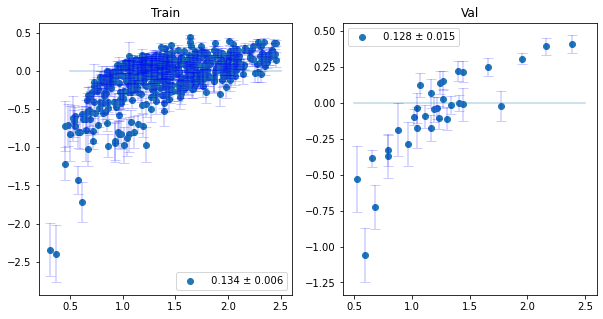

71/71 [==============================] - 100s 1s/step - loss: 0.3724 - val_loss: 0.3927
Epoch 87/1000
71/71 [==============================] - ETA: 0s - loss: 0.3639

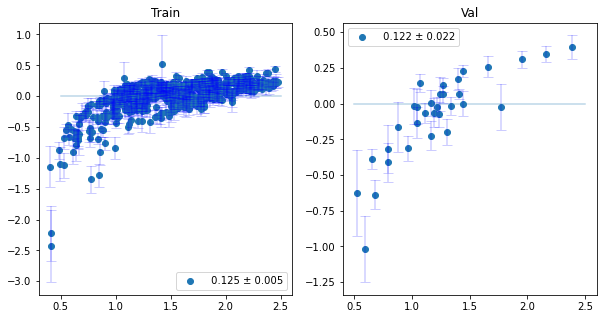

71/71 [==============================] - 100s 1s/step - loss: 0.3639 - val_loss: 0.3552
Epoch 88/1000
71/71 [==============================] - ETA: 0s - loss: 0.3542

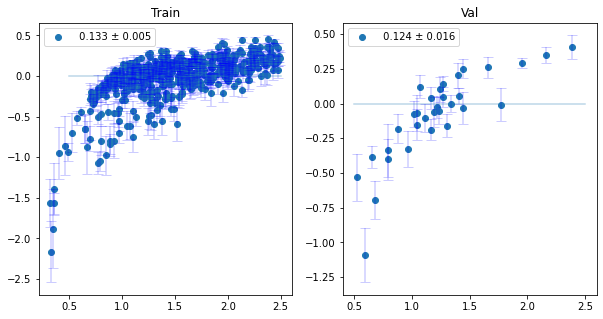

71/71 [==============================] - 102s 1s/step - loss: 0.3542 - val_loss: 0.3214
Epoch 89/1000
71/71 [==============================] - ETA: 0s - loss: 0.3472

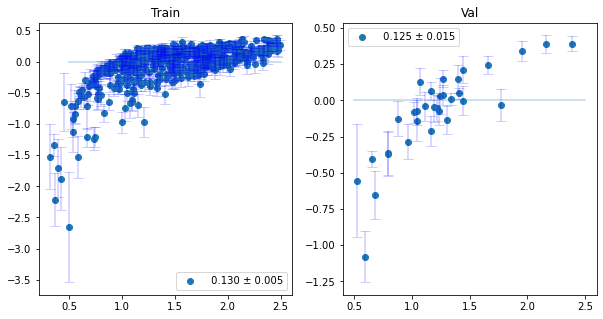

71/71 [==============================] - 102s 1s/step - loss: 0.3472 - val_loss: 0.3498
Epoch 90/1000
71/71 [==============================] - ETA: 0s - loss: 0.3381

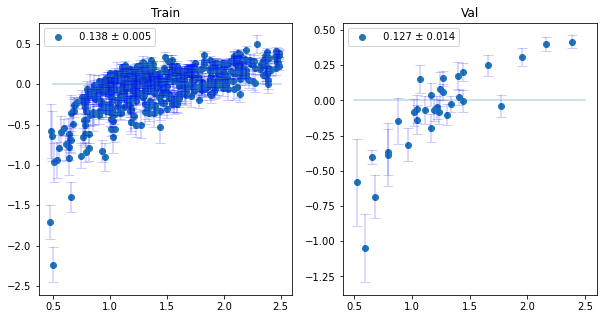

71/71 [==============================] - 100s 1s/step - loss: 0.3381 - val_loss: 0.3956
Epoch 91/1000
71/71 [==============================] - ETA: 0s - loss: 0.3306

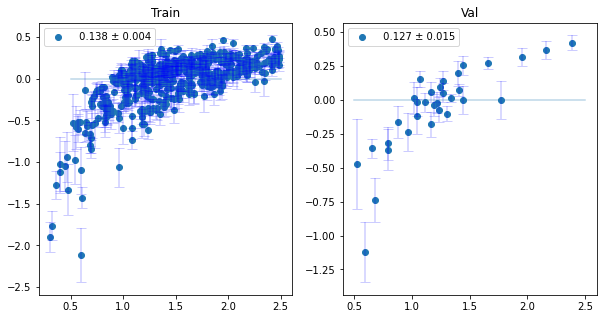

71/71 [==============================] - 101s 1s/step - loss: 0.3306 - val_loss: 0.3222
Epoch 92/1000
71/71 [==============================] - ETA: 0s - loss: 0.3245

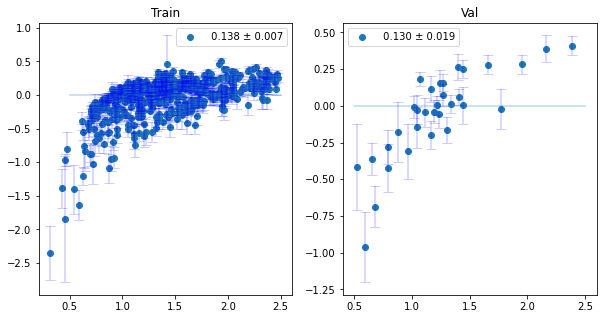

71/71 [==============================] - 101s 1s/step - loss: 0.3245 - val_loss: 0.3592
Epoch 93/1000
71/71 [==============================] - ETA: 0s - loss: 0.3175

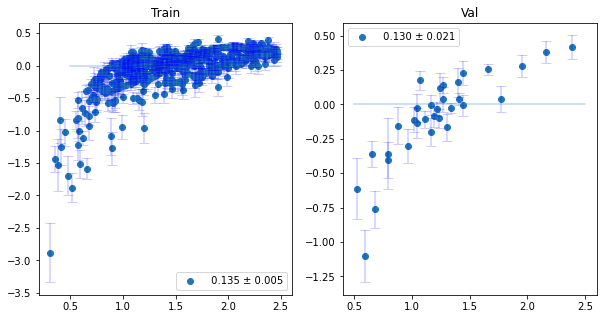

71/71 [==============================] - 102s 1s/step - loss: 0.3175 - val_loss: 0.3296
Epoch 94/1000
71/71 [==============================] - ETA: 0s - loss: 0.3101

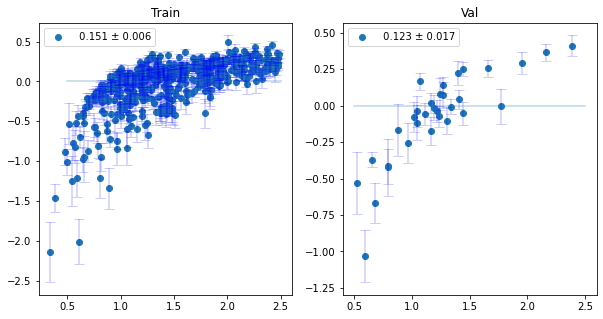

71/71 [==============================] - 100s 1s/step - loss: 0.3101 - val_loss: 0.3194
Epoch 95/1000
71/71 [==============================] - ETA: 0s - loss: 0.3048

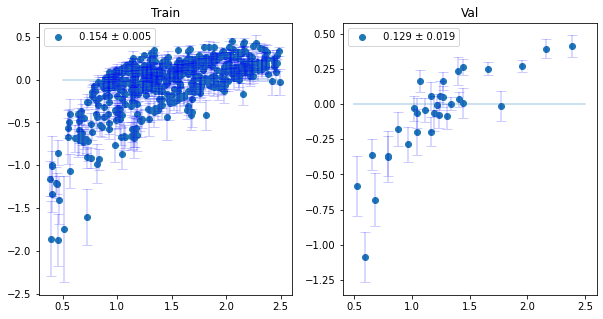

71/71 [==============================] - 102s 1s/step - loss: 0.3048 - val_loss: 0.3096
Epoch 96/1000
71/71 [==============================] - ETA: 0s - loss: 0.2993

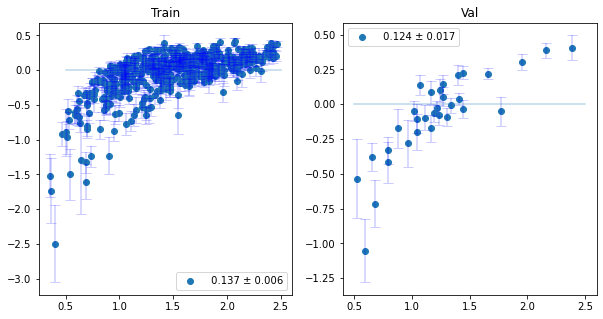

71/71 [==============================] - 101s 1s/step - loss: 0.2993 - val_loss: 0.3060
Epoch 97/1000
71/71 [==============================] - ETA: 0s - loss: 0.2933

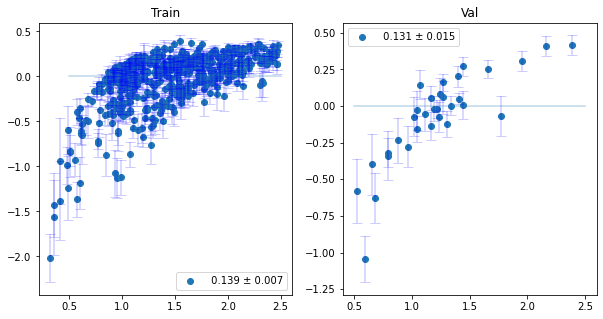

71/71 [==============================] - 101s 1s/step - loss: 0.2933 - val_loss: 0.2661
Epoch 98/1000
71/71 [==============================] - ETA: 0s - loss: 0.2875

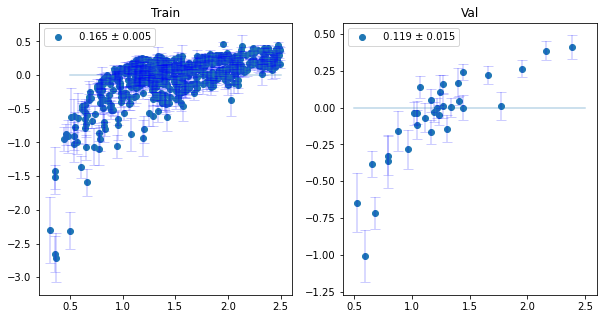

71/71 [==============================] - 100s 1s/step - loss: 0.2875 - val_loss: 0.2625
Epoch 99/1000
71/71 [==============================] - ETA: 0s - loss: 0.2824

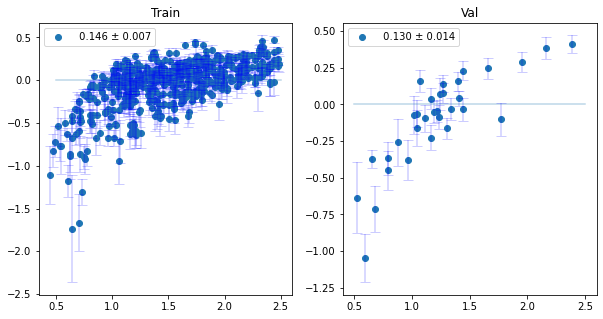

71/71 [==============================] - 101s 1s/step - loss: 0.2824 - val_loss: 0.2957
Epoch 100/1000
71/71 [==============================] - ETA: 0s - loss: 0.2783

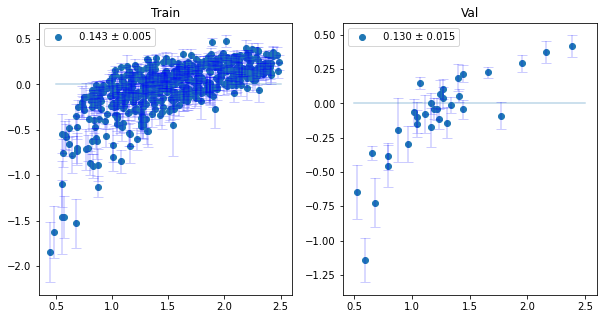

71/71 [==============================] - 101s 1s/step - loss: 0.2783 - val_loss: 0.2530
Epoch 101/1000
71/71 [==============================] - ETA: 0s - loss: 0.2751

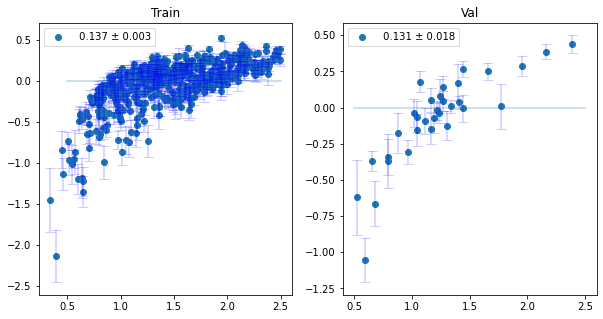

71/71 [==============================] - 101s 1s/step - loss: 0.2751 - val_loss: 0.2701
Epoch 102/1000
71/71 [==============================] - ETA: 0s - loss: 0.2699

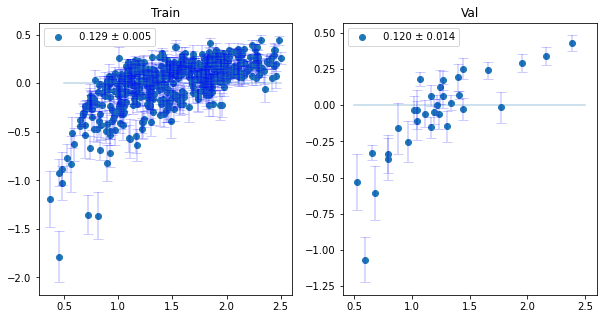

71/71 [==============================] - 102s 1s/step - loss: 0.2699 - val_loss: 0.2444
Epoch 103/1000
71/71 [==============================] - ETA: 0s - loss: 0.2644

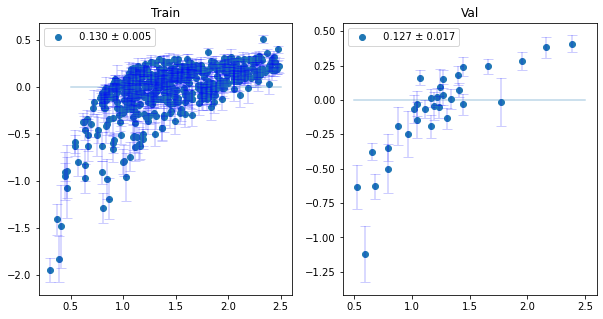

71/71 [==============================] - 102s 1s/step - loss: 0.2644 - val_loss: 0.2725
Epoch 104/1000
71/71 [==============================] - ETA: 0s - loss: 0.2628

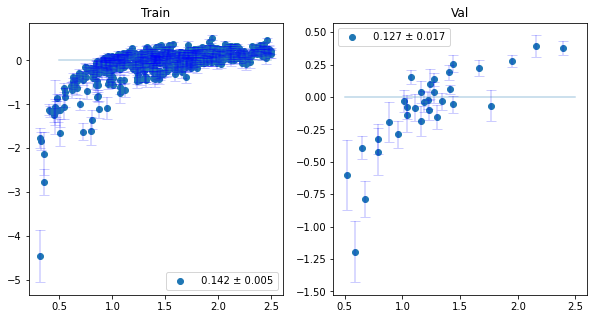

71/71 [==============================] - 101s 1s/step - loss: 0.2628 - val_loss: 0.2494
Epoch 105/1000
71/71 [==============================] - ETA: 0s - loss: 0.2589

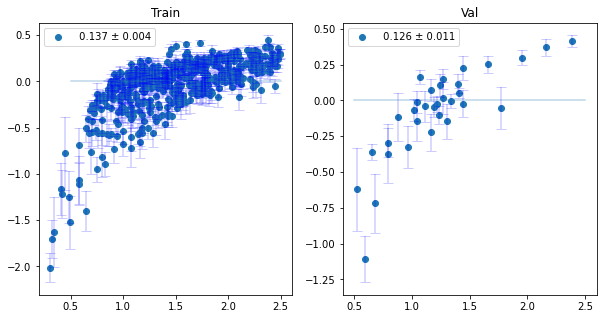

71/71 [==============================] - 101s 1s/step - loss: 0.2589 - val_loss: 0.2750
Epoch 106/1000
71/71 [==============================] - ETA: 0s - loss: 0.2547

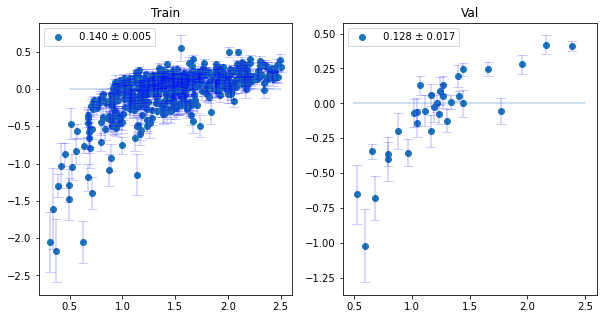

71/71 [==============================] - 100s 1s/step - loss: 0.2547 - val_loss: 0.2706
Epoch 107/1000
71/71 [==============================] - ETA: 0s - loss: 0.2505

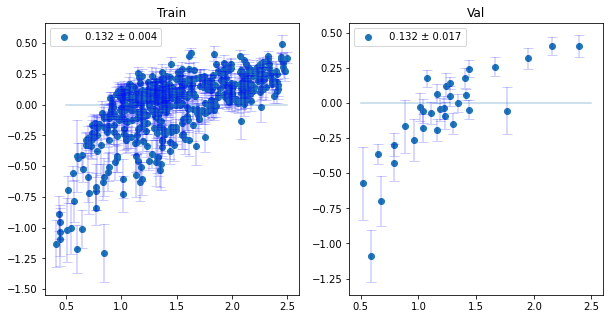

71/71 [==============================] - 100s 1s/step - loss: 0.2505 - val_loss: 0.2439
Epoch 108/1000
71/71 [==============================] - ETA: 0s - loss: 0.2486

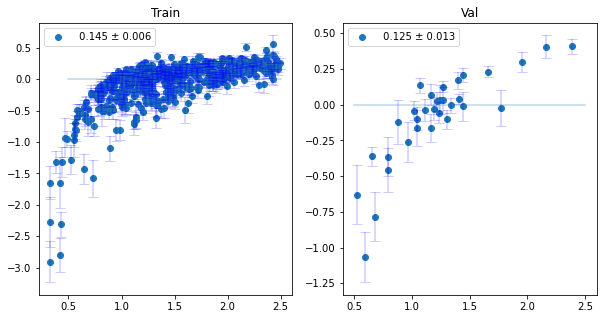

71/71 [==============================] - 100s 1s/step - loss: 0.2486 - val_loss: 0.2396
Epoch 109/1000
71/71 [==============================] - ETA: 0s - loss: 0.2456

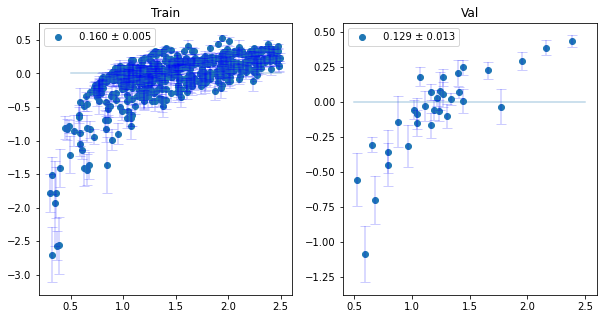

71/71 [==============================] - 101s 1s/step - loss: 0.2456 - val_loss: 0.2433
Epoch 110/1000
71/71 [==============================] - ETA: 0s - loss: 0.2422

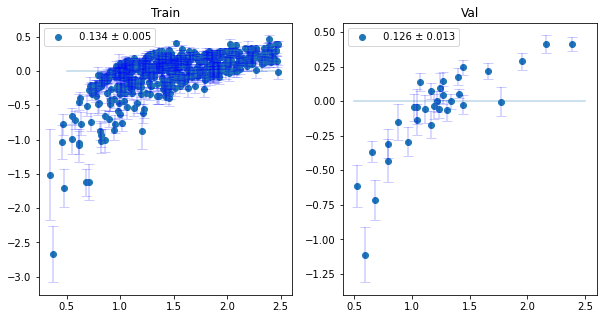

71/71 [==============================] - 101s 1s/step - loss: 0.2422 - val_loss: 0.2390
Epoch 111/1000
71/71 [==============================] - ETA: 0s - loss: 0.2385

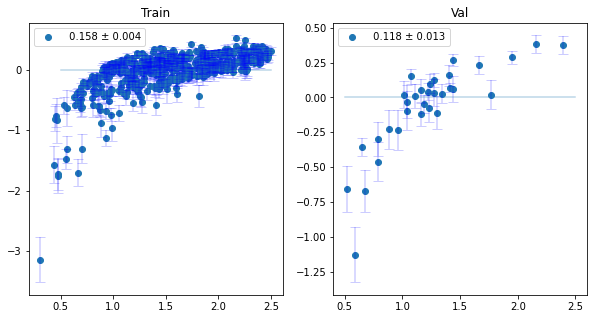

71/71 [==============================] - 101s 1s/step - loss: 0.2385 - val_loss: 0.2388
Epoch 112/1000
71/71 [==============================] - ETA: 0s - loss: 0.2351

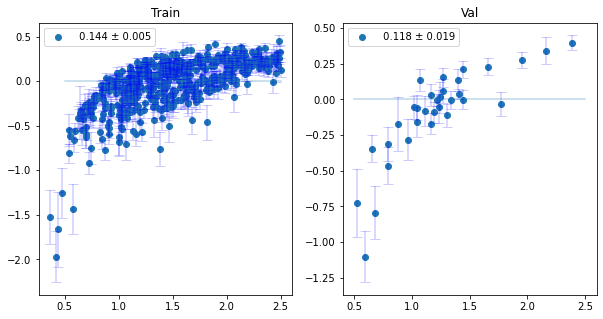

71/71 [==============================] - 100s 1s/step - loss: 0.2351 - val_loss: 0.2435
Epoch 113/1000
71/71 [==============================] - ETA: 0s - loss: 0.2326

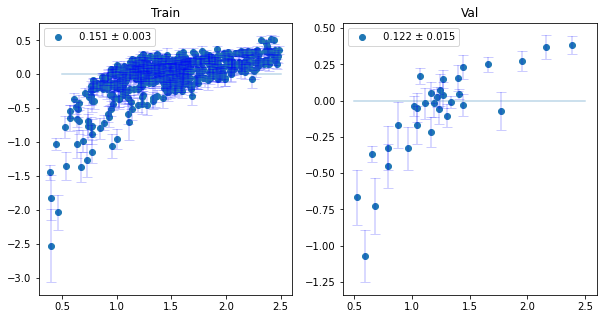

71/71 [==============================] - 100s 1s/step - loss: 0.2326 - val_loss: 0.2406
Epoch 114/1000
71/71 [==============================] - ETA: 0s - loss: 0.2306

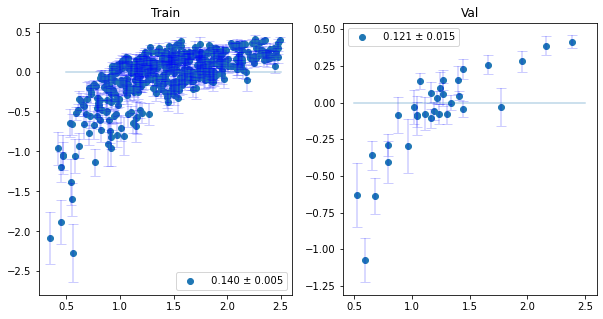

71/71 [==============================] - 101s 1s/step - loss: 0.2306 - val_loss: 0.2273
Epoch 115/1000
71/71 [==============================] - ETA: 0s - loss: 0.2292

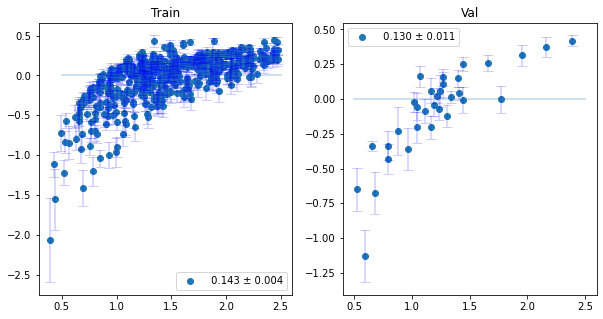

71/71 [==============================] - 101s 1s/step - loss: 0.2292 - val_loss: 0.2516
Epoch 116/1000
71/71 [==============================] - ETA: 0s - loss: 0.2259

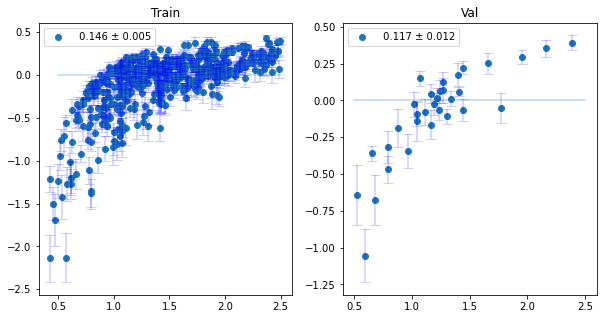

71/71 [==============================] - 102s 1s/step - loss: 0.2259 - val_loss: 0.2156
Epoch 117/1000
71/71 [==============================] - ETA: 0s - loss: 0.2235

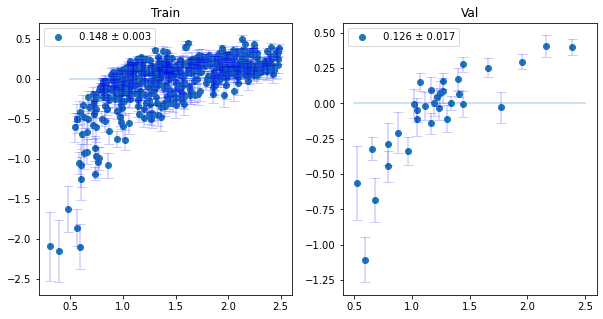

71/71 [==============================] - 103s 1s/step - loss: 0.2235 - val_loss: 0.2374
Epoch 118/1000
71/71 [==============================] - ETA: 0s - loss: 0.2204

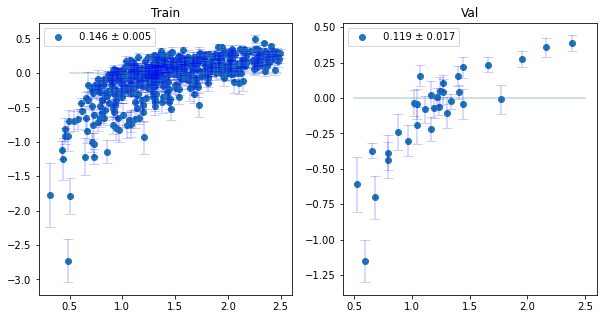

71/71 [==============================] - 101s 1s/step - loss: 0.2204 - val_loss: 0.2140
Epoch 119/1000
71/71 [==============================] - ETA: 0s - loss: 0.2197

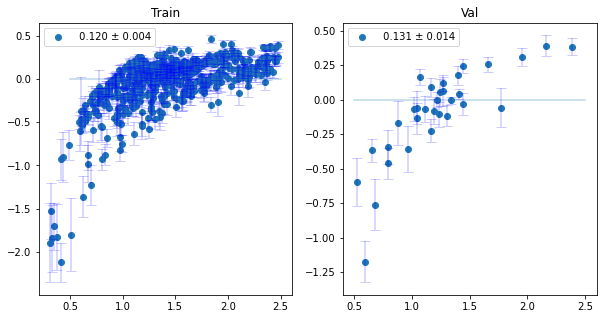

71/71 [==============================] - 100s 1s/step - loss: 0.2197 - val_loss: 0.2231
Epoch 120/1000
71/71 [==============================] - ETA: 0s - loss: 0.2169

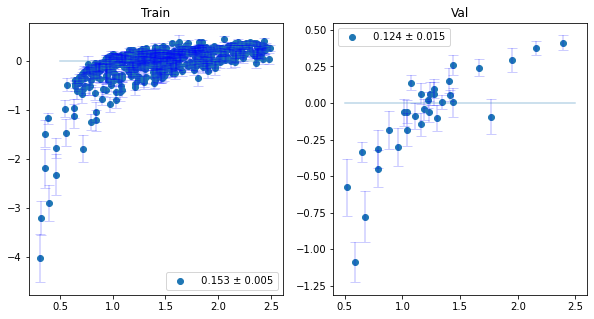

71/71 [==============================] - 101s 1s/step - loss: 0.2169 - val_loss: 0.2063
Epoch 121/1000
71/71 [==============================] - ETA: 0s - loss: 0.2156

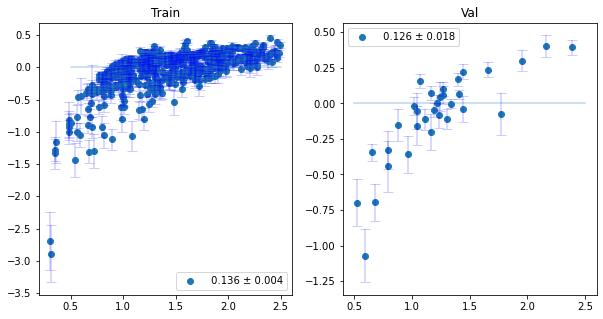

71/71 [==============================] - 101s 1s/step - loss: 0.2156 - val_loss: 0.1984
Epoch 122/1000
71/71 [==============================] - ETA: 0s - loss: 0.2135

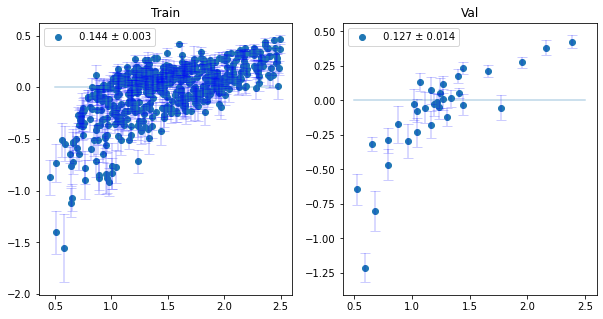

71/71 [==============================] - 101s 1s/step - loss: 0.2135 - val_loss: 0.2079
Epoch 123/1000
71/71 [==============================] - ETA: 0s - loss: 0.2113

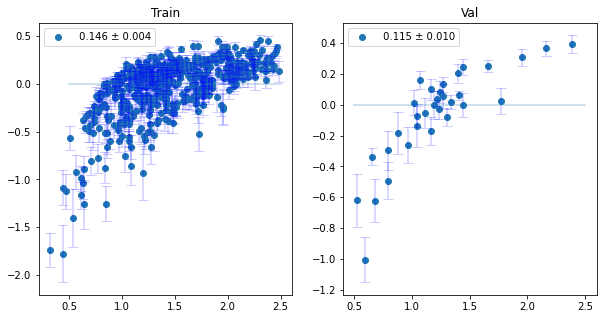

71/71 [==============================] - 102s 1s/step - loss: 0.2113 - val_loss: 0.1807
Epoch 124/1000
71/71 [==============================] - ETA: 0s - loss: 0.2109

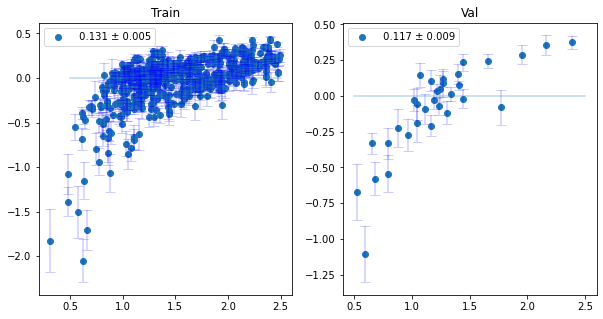

71/71 [==============================] - 101s 1s/step - loss: 0.2109 - val_loss: 0.1740
Epoch 125/1000
71/71 [==============================] - ETA: 0s - loss: 0.2077

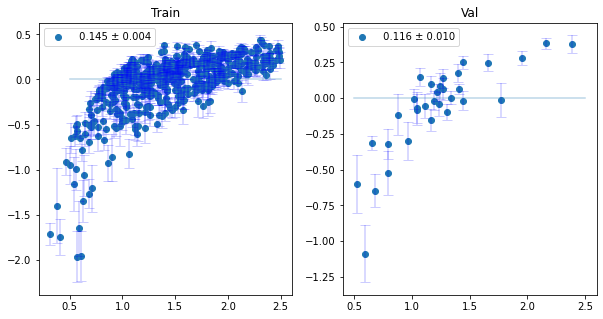

71/71 [==============================] - 101s 1s/step - loss: 0.2077 - val_loss: 0.1842
Epoch 126/1000
71/71 [==============================] - ETA: 0s - loss: 0.2046

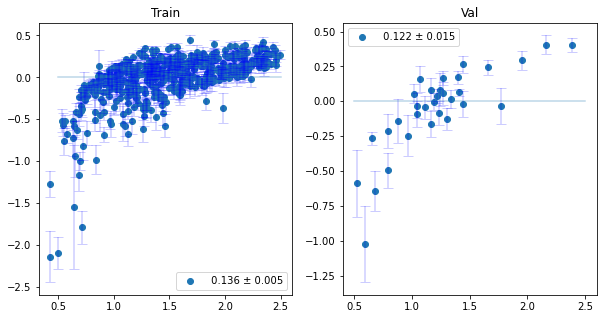

71/71 [==============================] - 100s 1s/step - loss: 0.2046 - val_loss: 0.2168
Epoch 127/1000
71/71 [==============================] - ETA: 0s - loss: 0.2033

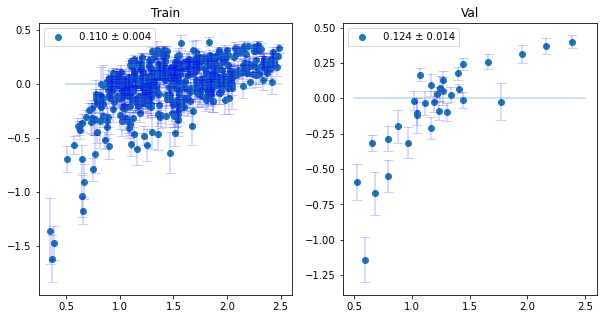

71/71 [==============================] - 101s 1s/step - loss: 0.2033 - val_loss: 0.2133
Epoch 128/1000
71/71 [==============================] - ETA: 0s - loss: 0.2029

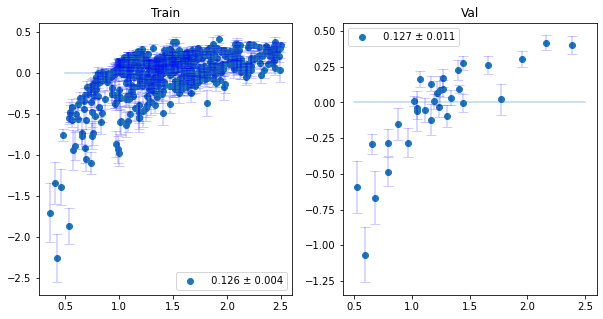

71/71 [==============================] - 100s 1s/step - loss: 0.2029 - val_loss: 0.1996
Epoch 129/1000
71/71 [==============================] - ETA: 0s - loss: 0.2007

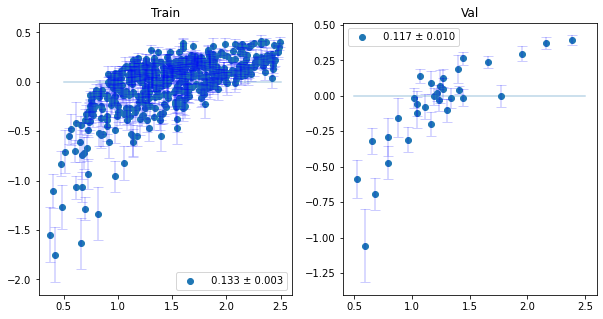

71/71 [==============================] - 100s 1s/step - loss: 0.2007 - val_loss: 0.1860
Epoch 130/1000
71/71 [==============================] - ETA: 0s - loss: 0.2000

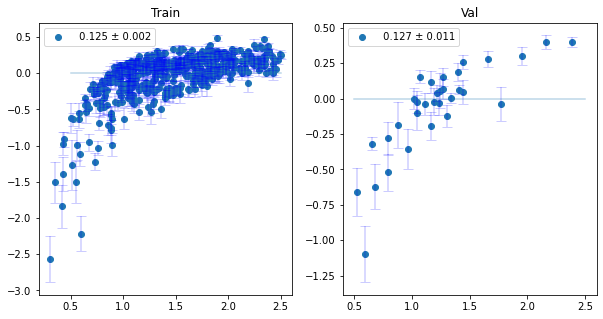

71/71 [==============================] - 101s 1s/step - loss: 0.2000 - val_loss: 0.2085
Epoch 131/1000
71/71 [==============================] - ETA: 0s - loss: 0.1993

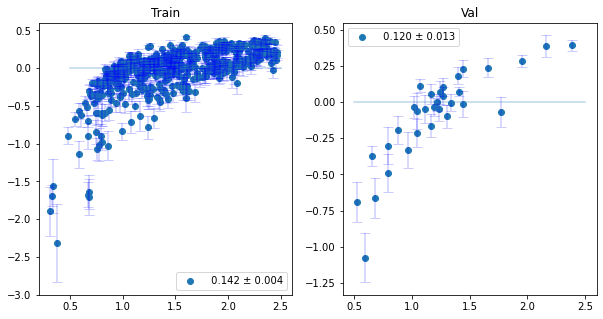

71/71 [==============================] - 101s 1s/step - loss: 0.1993 - val_loss: 0.1881
Epoch 132/1000
71/71 [==============================] - ETA: 0s - loss: 0.1963

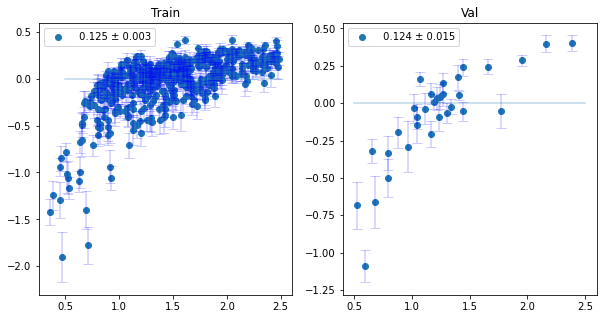

71/71 [==============================] - 100s 1s/step - loss: 0.1963 - val_loss: 0.2148
Epoch 133/1000
71/71 [==============================] - ETA: 0s - loss: 0.1944

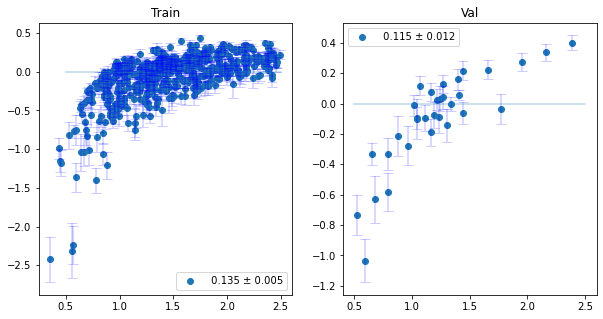

71/71 [==============================] - 101s 1s/step - loss: 0.1944 - val_loss: 0.1702
Epoch 134/1000
71/71 [==============================] - ETA: 0s - loss: 0.1944

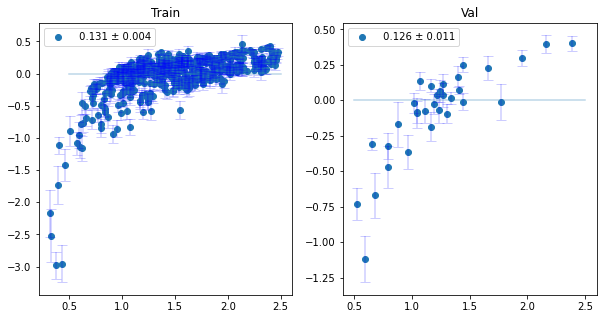

71/71 [==============================] - 100s 1s/step - loss: 0.1944 - val_loss: 0.1730
Epoch 135/1000
71/71 [==============================] - ETA: 0s - loss: 0.1935

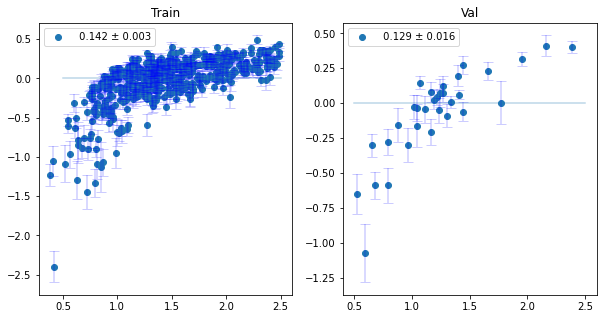

71/71 [==============================] - 101s 1s/step - loss: 0.1935 - val_loss: 0.1747
Epoch 136/1000
71/71 [==============================] - ETA: 0s - loss: 0.1920

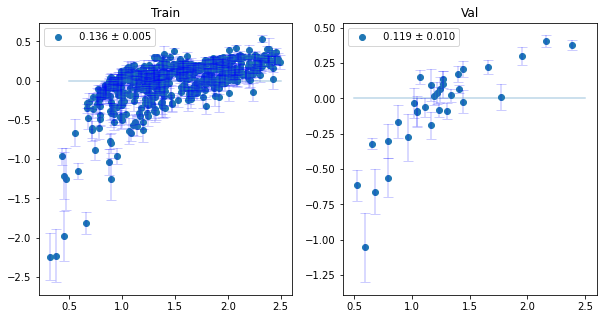

71/71 [==============================] - 101s 1s/step - loss: 0.1920 - val_loss: 0.1735
Epoch 137/1000
71/71 [==============================] - ETA: 0s - loss: 0.1900

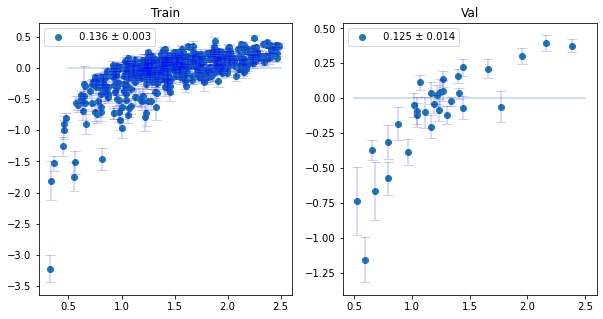

71/71 [==============================] - 101s 1s/step - loss: 0.1900 - val_loss: 0.2094
Epoch 138/1000
71/71 [==============================] - ETA: 0s - loss: 0.1894

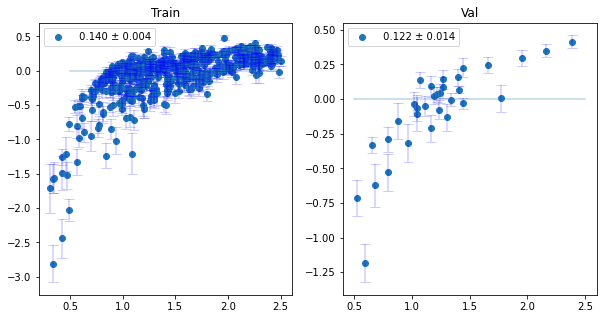

71/71 [==============================] - 101s 1s/step - loss: 0.1894 - val_loss: 0.1857
Epoch 139/1000
71/71 [==============================] - ETA: 0s - loss: 0.1877

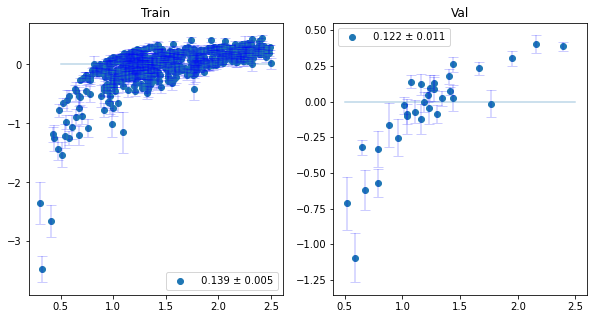

71/71 [==============================] - 101s 1s/step - loss: 0.1877 - val_loss: 0.2014
Epoch 140/1000
71/71 [==============================] - ETA: 0s - loss: 0.1873

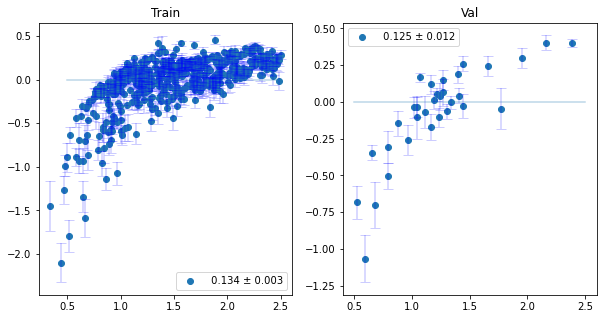

71/71 [==============================] - 101s 1s/step - loss: 0.1873 - val_loss: 0.2020
Epoch 141/1000
71/71 [==============================] - ETA: 0s - loss: 0.1854

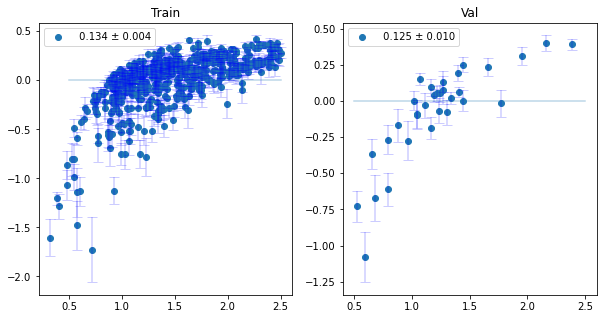

71/71 [==============================] - 101s 1s/step - loss: 0.1854 - val_loss: 0.2100
Epoch 142/1000
71/71 [==============================] - ETA: 0s - loss: 0.1849

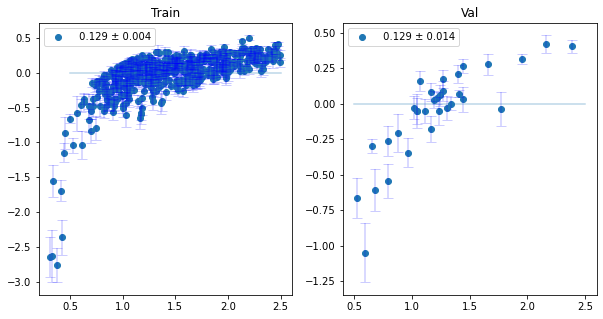

71/71 [==============================] - 101s 1s/step - loss: 0.1849 - val_loss: 0.1672
Epoch 143/1000
71/71 [==============================] - ETA: 0s - loss: 0.1842

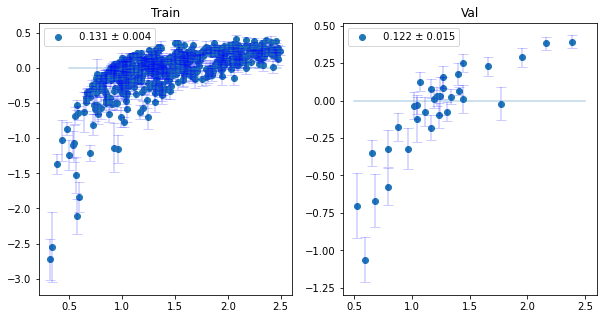

71/71 [==============================] - 101s 1s/step - loss: 0.1842 - val_loss: 0.1848
Epoch 144/1000
71/71 [==============================] - ETA: 0s - loss: 0.1824

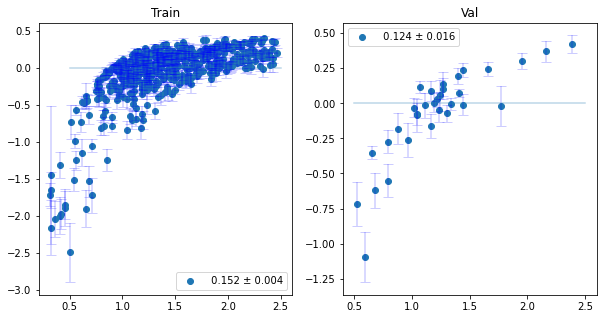

71/71 [==============================] - 101s 1s/step - loss: 0.1824 - val_loss: 0.1692
Epoch 145/1000
71/71 [==============================] - ETA: 0s - loss: 0.1817

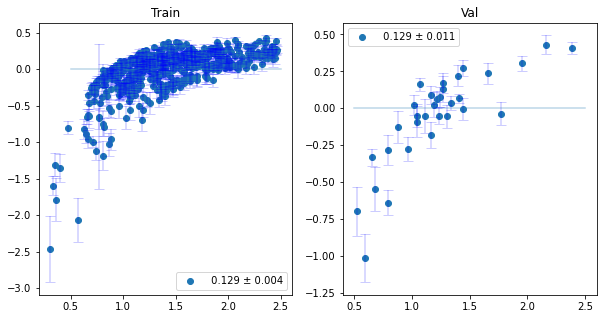

71/71 [==============================] - 100s 1s/step - loss: 0.1817 - val_loss: 0.1762
Epoch 146/1000
71/71 [==============================] - ETA: 0s - loss: 0.1805

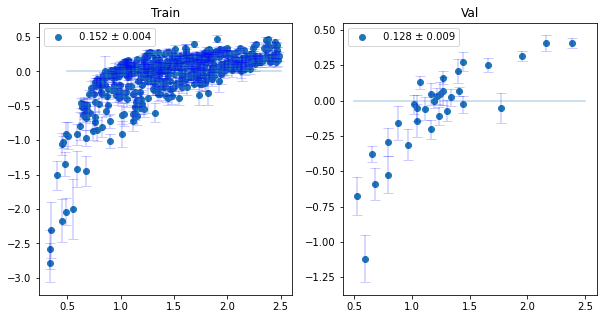

71/71 [==============================] - 101s 1s/step - loss: 0.1805 - val_loss: 0.2000
Epoch 147/1000
71/71 [==============================] - ETA: 0s - loss: 0.1792

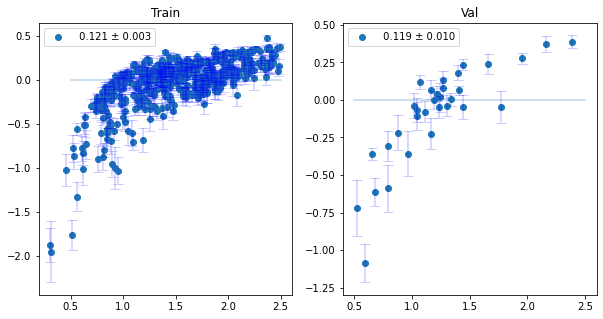

71/71 [==============================] - 100s 1s/step - loss: 0.1792 - val_loss: 0.1624
Epoch 148/1000
71/71 [==============================] - ETA: 0s - loss: 0.1785

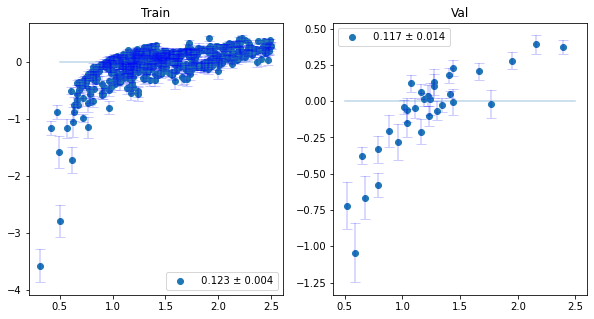

71/71 [==============================] - 100s 1s/step - loss: 0.1785 - val_loss: 0.2050
Epoch 149/1000
71/71 [==============================] - ETA: 0s - loss: 0.1781

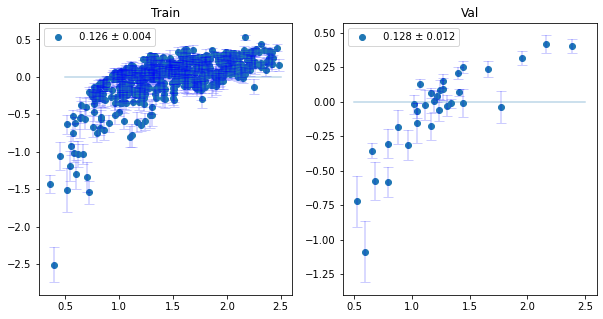

71/71 [==============================] - 101s 1s/step - loss: 0.1781 - val_loss: 0.1942
Epoch 150/1000
71/71 [==============================] - ETA: 0s - loss: 0.1761

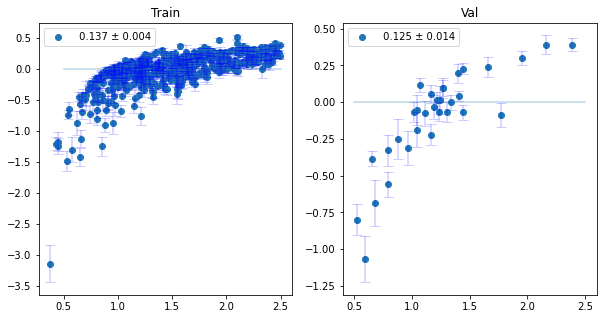

71/71 [==============================] - 101s 1s/step - loss: 0.1761 - val_loss: 0.1791
Epoch 151/1000
71/71 [==============================] - ETA: 0s - loss: 0.1774

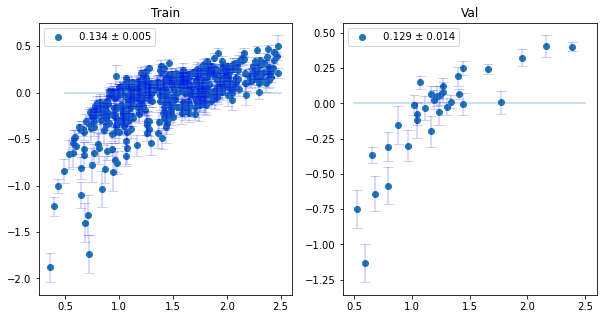

71/71 [==============================] - 101s 1s/step - loss: 0.1774 - val_loss: 0.2212
Epoch 152/1000
71/71 [==============================] - ETA: 0s - loss: 0.1748

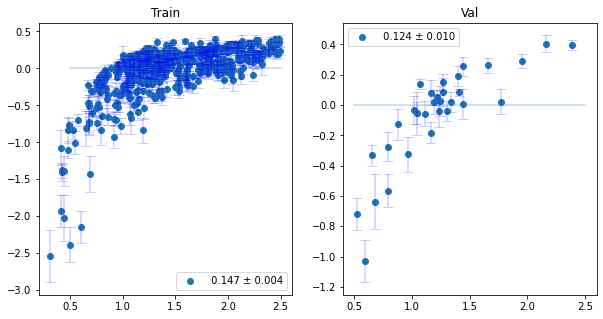

71/71 [==============================] - 101s 1s/step - loss: 0.1748 - val_loss: 0.1767
Epoch 153/1000
71/71 [==============================] - ETA: 0s - loss: 0.1750

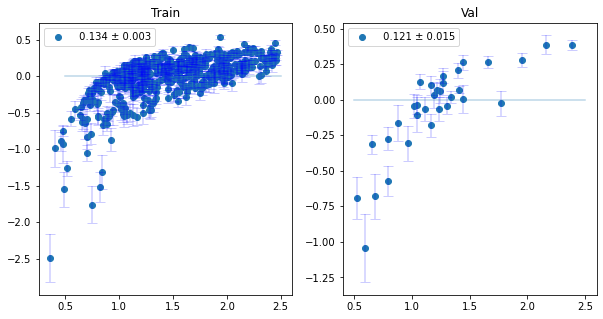

71/71 [==============================] - 102s 1s/step - loss: 0.1750 - val_loss: 0.1711
Epoch 154/1000
71/71 [==============================] - ETA: 0s - loss: 0.1733

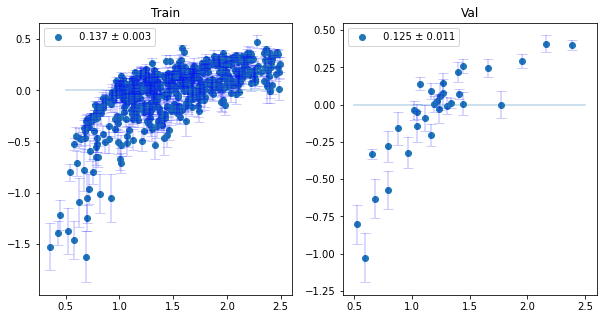

71/71 [==============================] - 103s 1s/step - loss: 0.1733 - val_loss: 0.1655
Epoch 155/1000
71/71 [==============================] - ETA: 0s - loss: 0.1729

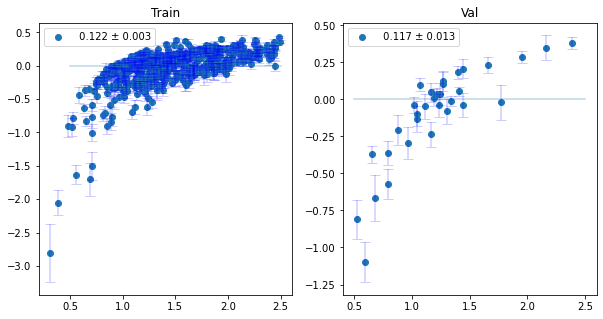

71/71 [==============================] - 100s 1s/step - loss: 0.1729 - val_loss: 0.1873
Epoch 156/1000
71/71 [==============================] - ETA: 0s - loss: 0.1720

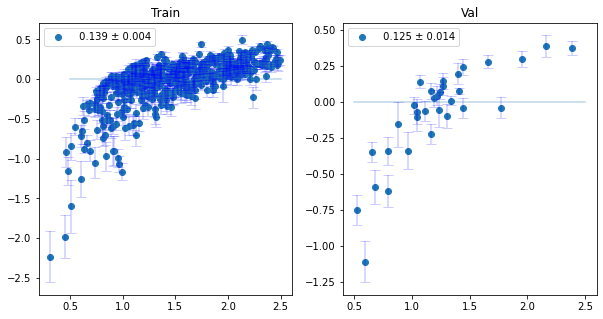

71/71 [==============================] - 101s 1s/step - loss: 0.1720 - val_loss: 0.1617
Epoch 157/1000
71/71 [==============================] - ETA: 0s - loss: 0.1714

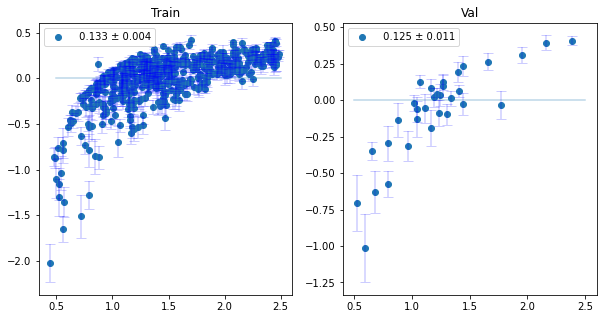

71/71 [==============================] - 103s 1s/step - loss: 0.1714 - val_loss: 0.1584
Epoch 158/1000
71/71 [==============================] - ETA: 0s - loss: 0.1704

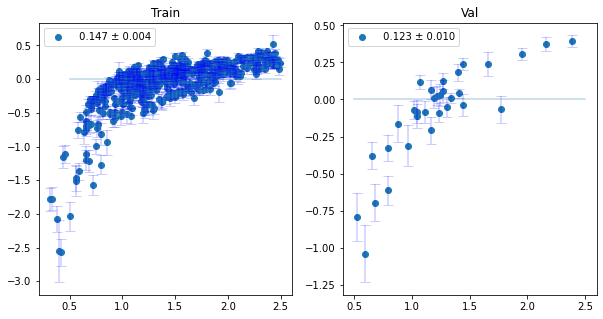

71/71 [==============================] - 101s 1s/step - loss: 0.1704 - val_loss: 0.1701
Epoch 159/1000
71/71 [==============================] - ETA: 0s - loss: 0.1710

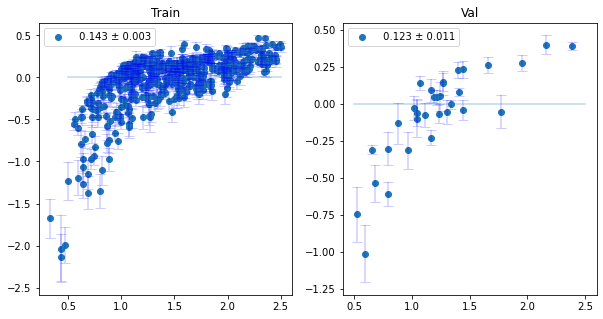

71/71 [==============================] - 100s 1s/step - loss: 0.1710 - val_loss: 0.1809
Epoch 160/1000
71/71 [==============================] - ETA: 0s - loss: 0.1691

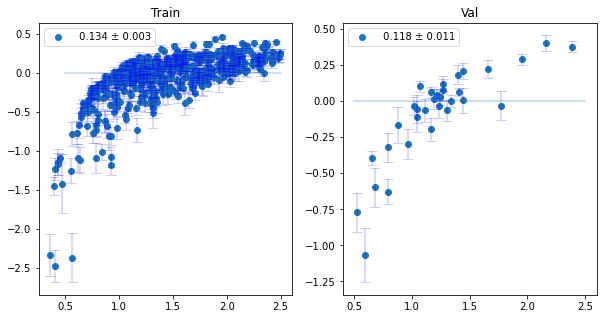

71/71 [==============================] - 100s 1s/step - loss: 0.1691 - val_loss: 0.1637
Epoch 161/1000
71/71 [==============================] - ETA: 0s - loss: 0.1695

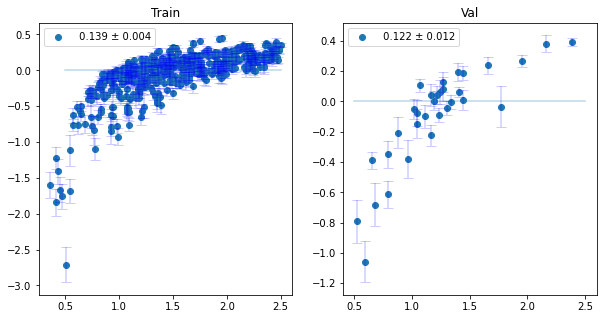

71/71 [==============================] - 101s 1s/step - loss: 0.1695 - val_loss: 0.1585
Epoch 162/1000
71/71 [==============================] - ETA: 0s - loss: 0.1682

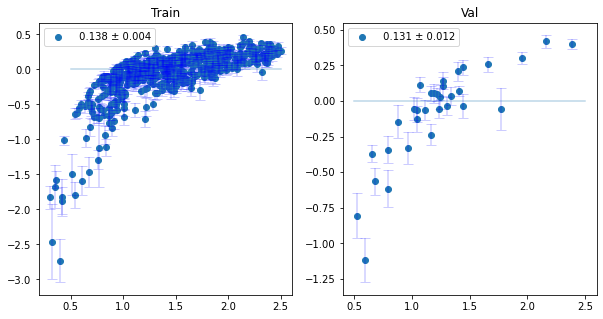

71/71 [==============================] - 102s 1s/step - loss: 0.1682 - val_loss: 0.1692
Epoch 163/1000
71/71 [==============================] - ETA: 0s - loss: 0.1670

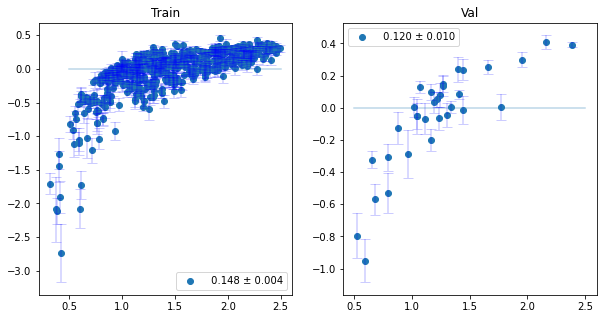

71/71 [==============================] - 103s 1s/step - loss: 0.1670 - val_loss: 0.1637
Epoch 164/1000
71/71 [==============================] - ETA: 0s - loss: 0.1663

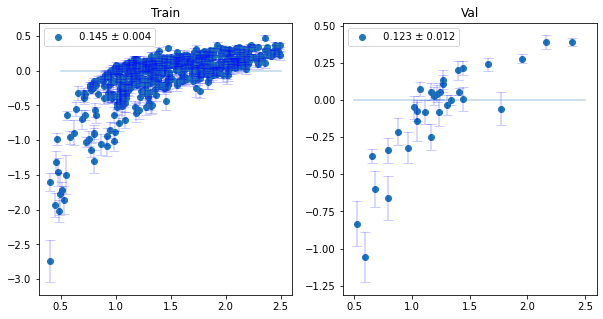

71/71 [==============================] - 102s 1s/step - loss: 0.1663 - val_loss: 0.1598
Epoch 165/1000
71/71 [==============================] - ETA: 0s - loss: 0.1663

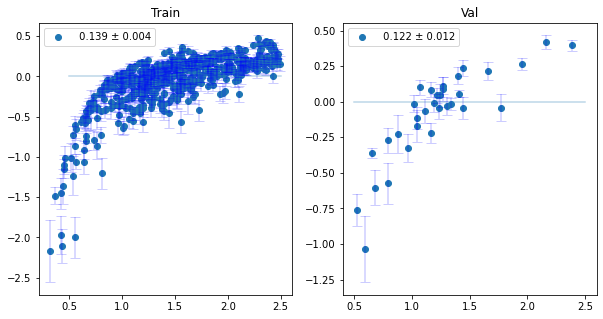

71/71 [==============================] - 101s 1s/step - loss: 0.1663 - val_loss: 0.1800
Epoch 166/1000
71/71 [==============================] - ETA: 0s - loss: 0.1657

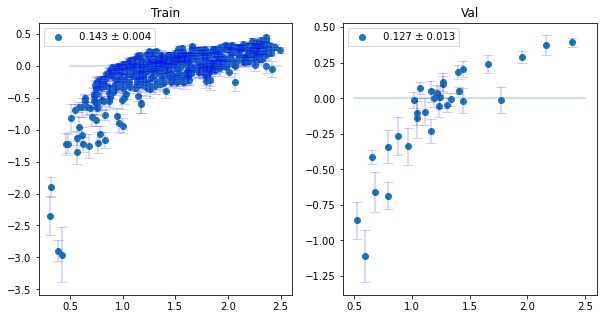

71/71 [==============================] - 102s 1s/step - loss: 0.1657 - val_loss: 0.1790
Epoch 167/1000
71/71 [==============================] - ETA: 0s - loss: 0.1653

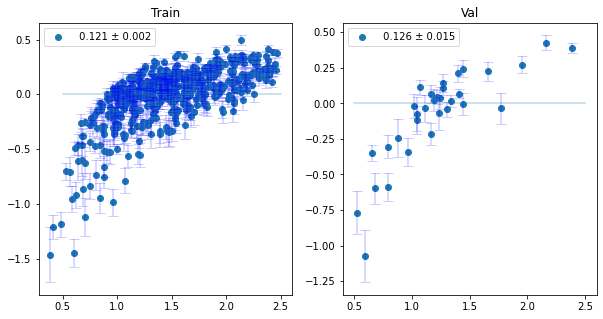

71/71 [==============================] - 102s 1s/step - loss: 0.1653 - val_loss: 0.1606
Epoch 168/1000
71/71 [==============================] - ETA: 0s - loss: 0.1645

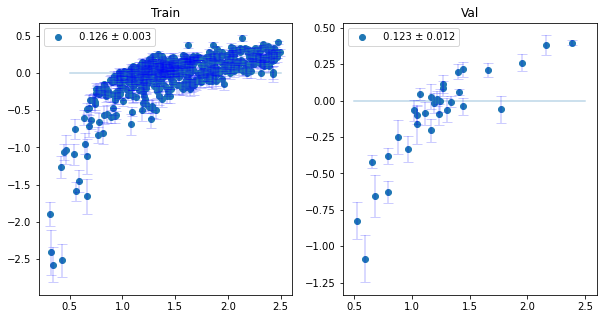

71/71 [==============================] - 102s 1s/step - loss: 0.1645 - val_loss: 0.1603
Epoch 169/1000
71/71 [==============================] - ETA: 0s - loss: 0.1633

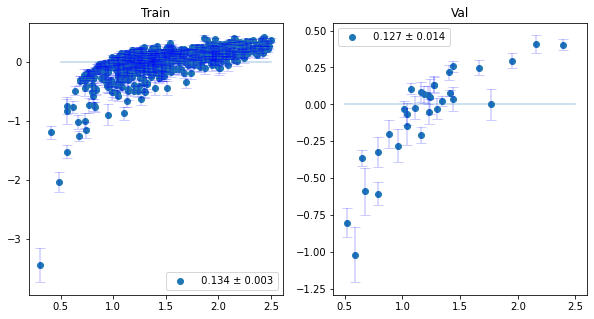

71/71 [==============================] - 102s 1s/step - loss: 0.1633 - val_loss: 0.1546
Epoch 170/1000
71/71 [==============================] - ETA: 0s - loss: 0.1636

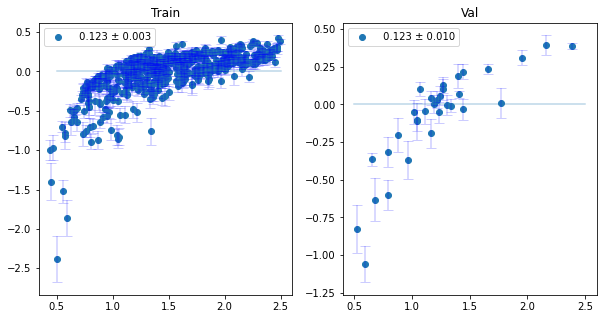

71/71 [==============================] - 103s 1s/step - loss: 0.1636 - val_loss: 0.1718
Epoch 171/1000
71/71 [==============================] - ETA: 0s - loss: 0.1629

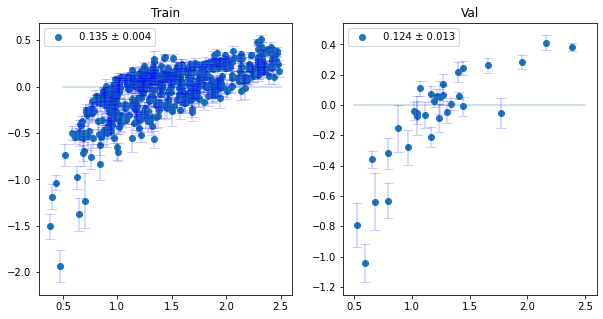

71/71 [==============================] - 103s 1s/step - loss: 0.1629 - val_loss: 0.1655
Epoch 172/1000
71/71 [==============================] - ETA: 0s - loss: 0.1623

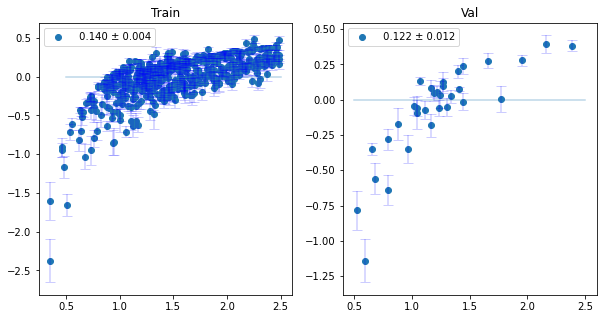

71/71 [==============================] - 103s 1s/step - loss: 0.1623 - val_loss: 0.1658
Epoch 173/1000
71/71 [==============================] - ETA: 0s - loss: 0.1632

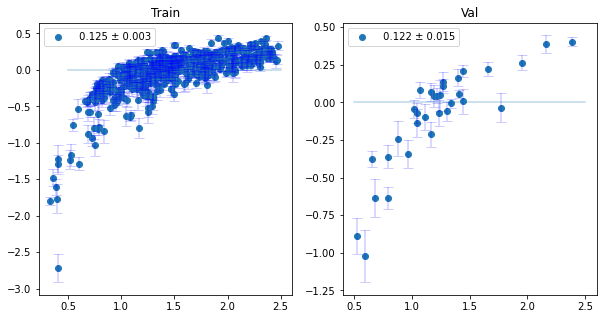

71/71 [==============================] - 101s 1s/step - loss: 0.1632 - val_loss: 0.1785
Epoch 174/1000
71/71 [==============================] - ETA: 0s - loss: 0.1618

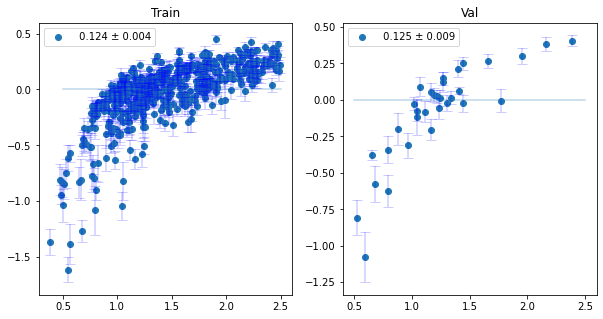

71/71 [==============================] - 100s 1s/step - loss: 0.1618 - val_loss: 0.1550
Epoch 175/1000
71/71 [==============================] - ETA: 0s - loss: 0.1616

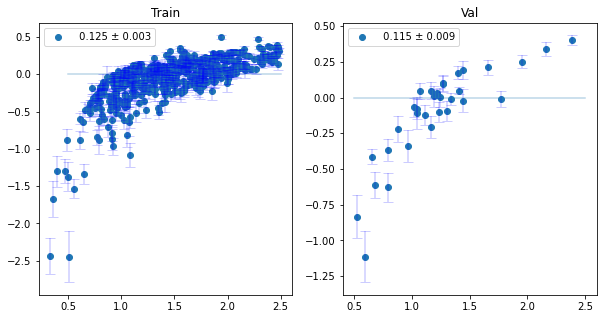

71/71 [==============================] - 101s 1s/step - loss: 0.1616 - val_loss: 0.1723
Epoch 176/1000
71/71 [==============================] - ETA: 0s - loss: 0.1605

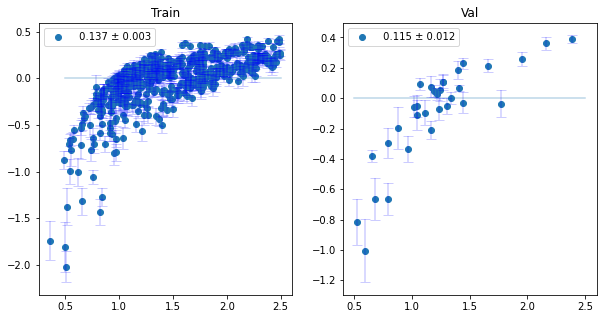

71/71 [==============================] - 101s 1s/step - loss: 0.1605 - val_loss: 0.1433
Epoch 177/1000
71/71 [==============================] - ETA: 0s - loss: 0.1612

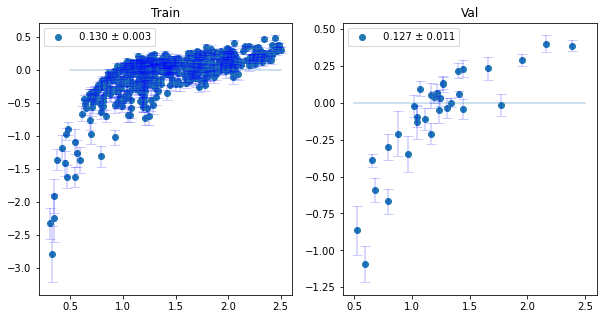

71/71 [==============================] - 101s 1s/step - loss: 0.1612 - val_loss: 0.1692
Epoch 178/1000
71/71 [==============================] - ETA: 0s - loss: 0.1603

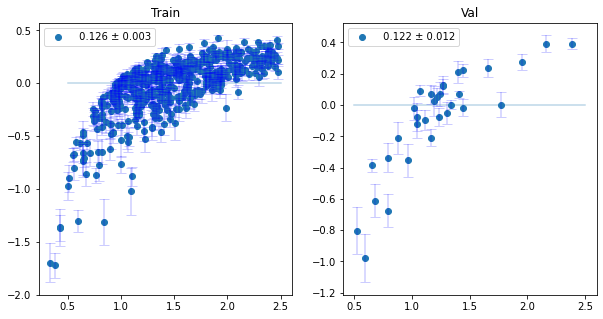

71/71 [==============================] - 100s 1s/step - loss: 0.1603 - val_loss: 0.1595
Epoch 179/1000
71/71 [==============================] - ETA: 0s - loss: 0.1595

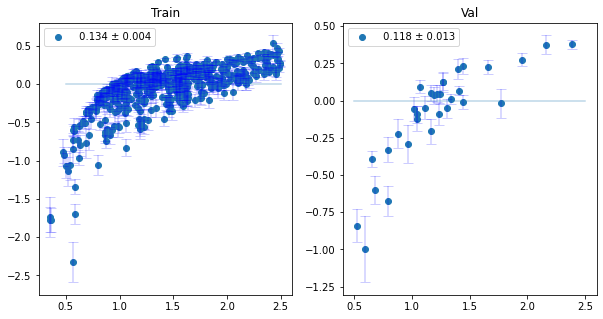

71/71 [==============================] - 100s 1s/step - loss: 0.1595 - val_loss: 0.1603
Epoch 180/1000
71/71 [==============================] - ETA: 0s - loss: 0.1593

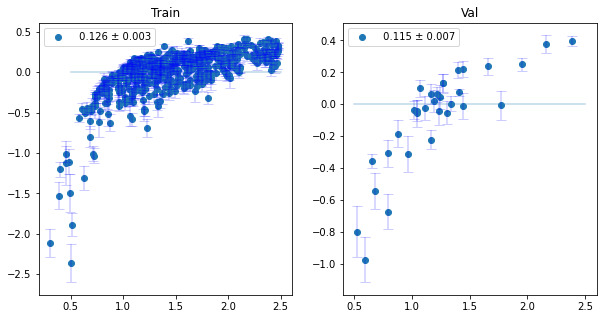

71/71 [==============================] - 100s 1s/step - loss: 0.1593 - val_loss: 0.1515
Epoch 181/1000
71/71 [==============================] - ETA: 0s - loss: 0.1593

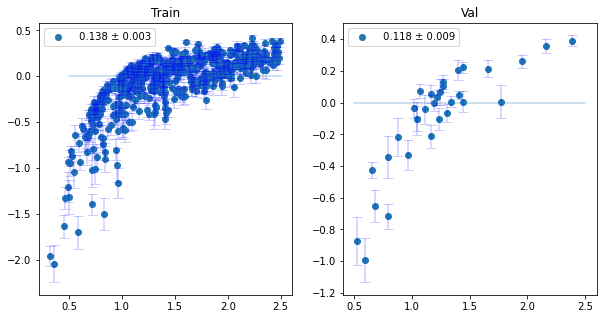

71/71 [==============================] - 101s 1s/step - loss: 0.1593 - val_loss: 0.1533
Epoch 182/1000
71/71 [==============================] - ETA: 0s - loss: 0.1583

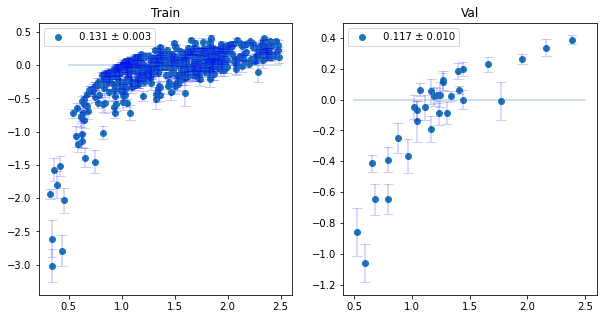

71/71 [==============================] - 100s 1s/step - loss: 0.1583 - val_loss: 0.1611
Epoch 183/1000
71/71 [==============================] - ETA: 0s - loss: 0.1574

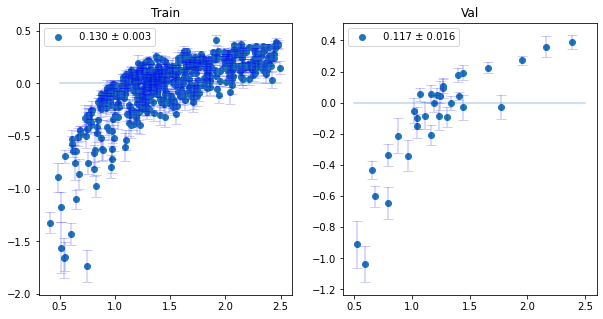

71/71 [==============================] - 100s 1s/step - loss: 0.1574 - val_loss: 0.1721
Epoch 184/1000
71/71 [==============================] - ETA: 0s - loss: 0.1577

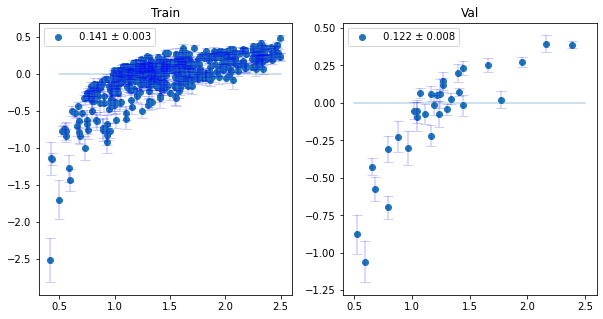

71/71 [==============================] - 100s 1s/step - loss: 0.1577 - val_loss: 0.1541
Epoch 185/1000
71/71 [==============================] - ETA: 0s - loss: 0.1578

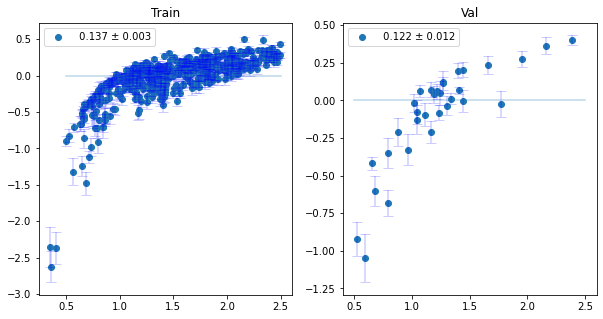

71/71 [==============================] - 100s 1s/step - loss: 0.1578 - val_loss: 0.1321
Epoch 186/1000
71/71 [==============================] - ETA: 0s - loss: 0.1574

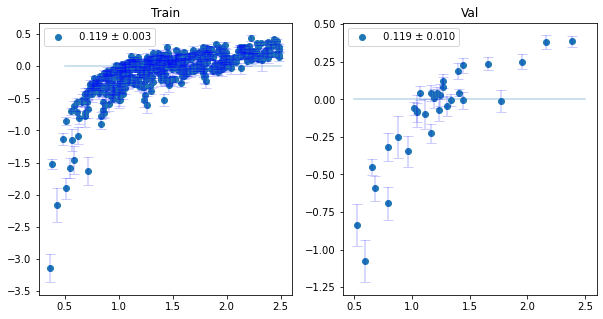

71/71 [==============================] - 102s 1s/step - loss: 0.1574 - val_loss: 0.1512
Epoch 187/1000
71/71 [==============================] - ETA: 0s - loss: 0.1574

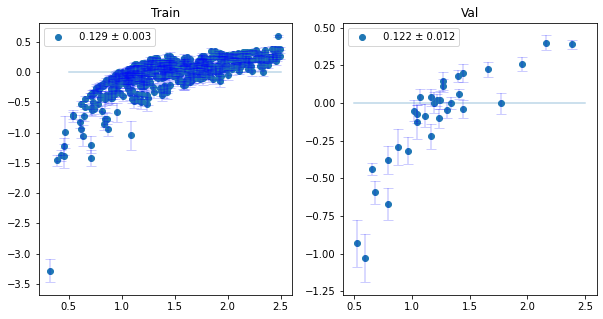

71/71 [==============================] - 103s 1s/step - loss: 0.1574 - val_loss: 0.1560
Epoch 188/1000
71/71 [==============================] - ETA: 0s - loss: 0.1556

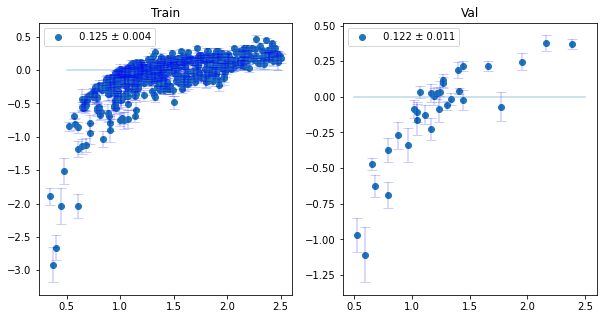

71/71 [==============================] - 101s 1s/step - loss: 0.1556 - val_loss: 0.1678
Epoch 189/1000
71/71 [==============================] - ETA: 0s - loss: 0.1557

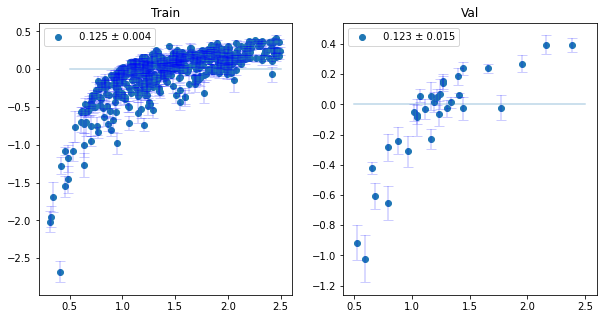

71/71 [==============================] - 101s 1s/step - loss: 0.1557 - val_loss: 0.1405
Epoch 190/1000
71/71 [==============================] - ETA: 0s - loss: 0.1560

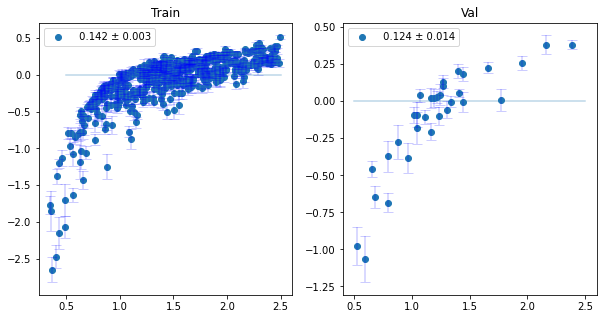

71/71 [==============================] - 101s 1s/step - loss: 0.1560 - val_loss: 0.1656
Epoch 191/1000
71/71 [==============================] - ETA: 0s - loss: 0.1553

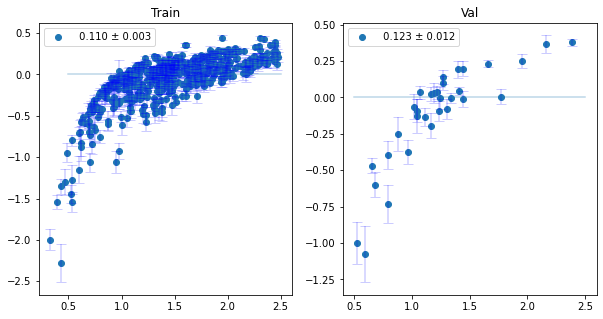

71/71 [==============================] - 101s 1s/step - loss: 0.1553 - val_loss: 0.1450
Epoch 192/1000
71/71 [==============================] - ETA: 0s - loss: 0.1553

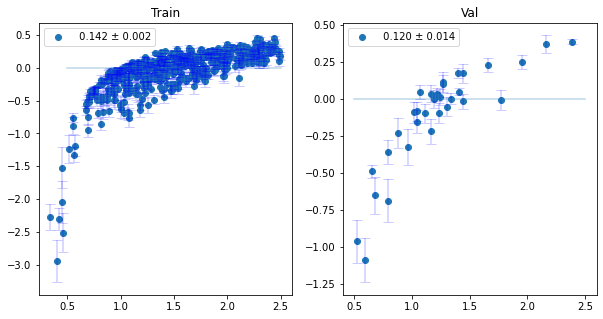

71/71 [==============================] - 102s 1s/step - loss: 0.1553 - val_loss: 0.1598
Epoch 193/1000
71/71 [==============================] - ETA: 0s - loss: 0.1550

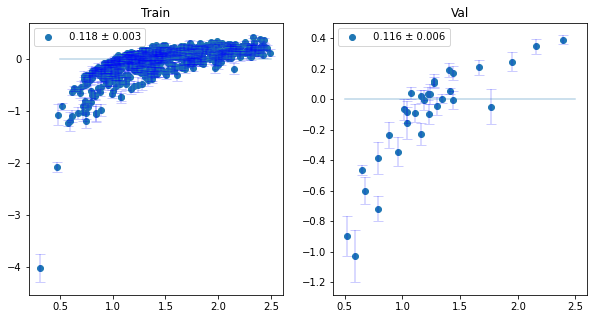

71/71 [==============================] - 102s 1s/step - loss: 0.1550 - val_loss: 0.1714
Epoch 194/1000
71/71 [==============================] - ETA: 0s - loss: 0.1538

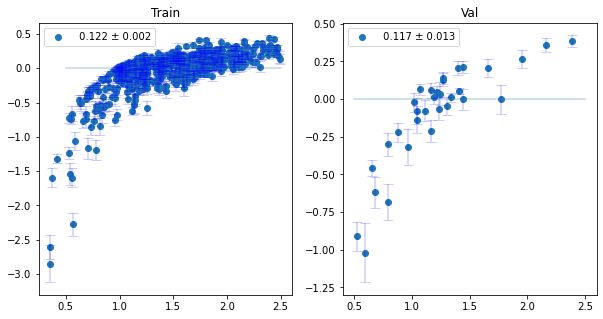

71/71 [==============================] - 100s 1s/step - loss: 0.1538 - val_loss: 0.1461
Epoch 195/1000
71/71 [==============================] - ETA: 0s - loss: 0.1535

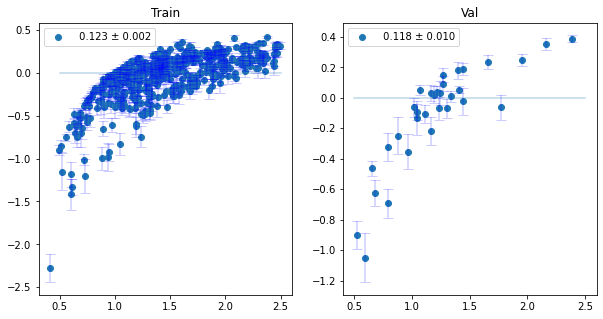

71/71 [==============================] - 101s 1s/step - loss: 0.1535 - val_loss: 0.1535
Epoch 196/1000
71/71 [==============================] - ETA: 0s - loss: 0.1538

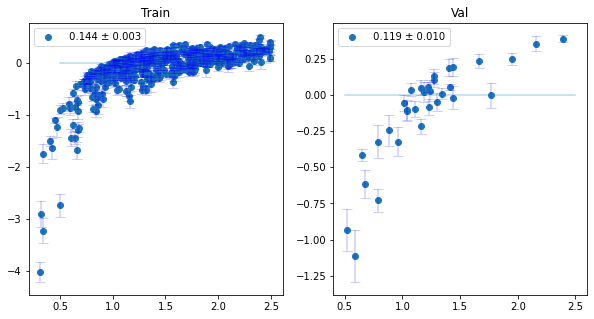

71/71 [==============================] - 100s 1s/step - loss: 0.1538 - val_loss: 0.1752
Epoch 197/1000
71/71 [==============================] - ETA: 0s - loss: 0.1532

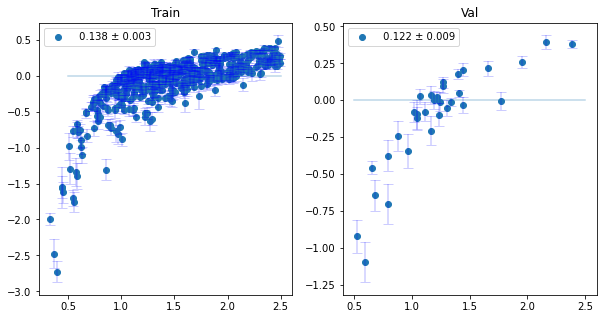

71/71 [==============================] - 101s 1s/step - loss: 0.1532 - val_loss: 0.1418
Epoch 198/1000
71/71 [==============================] - ETA: 0s - loss: 0.1525

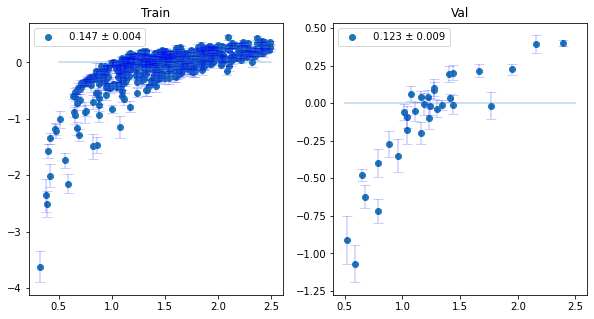

71/71 [==============================] - 101s 1s/step - loss: 0.1525 - val_loss: 0.1561
Epoch 199/1000
71/71 [==============================] - ETA: 0s - loss: 0.1531

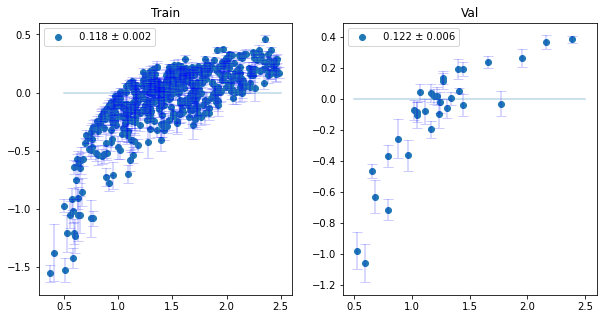

71/71 [==============================] - 100s 1s/step - loss: 0.1531 - val_loss: 0.1669
Epoch 200/1000
71/71 [==============================] - ETA: 0s - loss: 0.1525

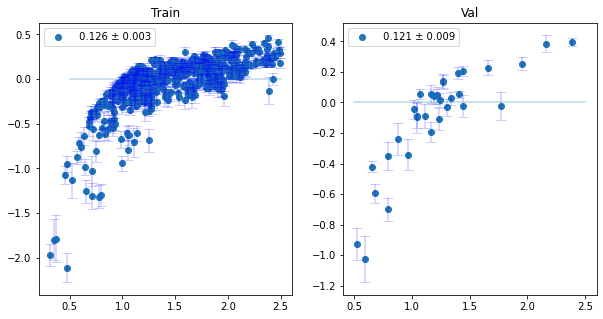

71/71 [==============================] - 100s 1s/step - loss: 0.1525 - val_loss: 0.1599
Epoch 201/1000
71/71 [==============================] - ETA: 0s - loss: 0.1519

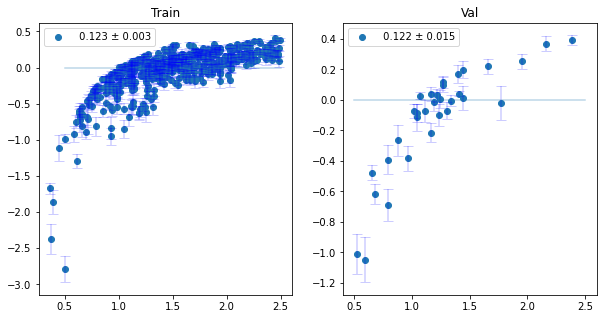

71/71 [==============================] - 101s 1s/step - loss: 0.1519 - val_loss: 0.1492
Epoch 202/1000
71/71 [==============================] - ETA: 0s - loss: 0.1512

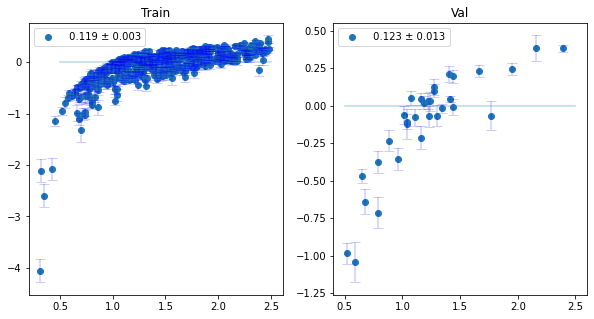

71/71 [==============================] - 100s 1s/step - loss: 0.1512 - val_loss: 0.1525
Epoch 203/1000
71/71 [==============================] - ETA: 0s - loss: 0.1517

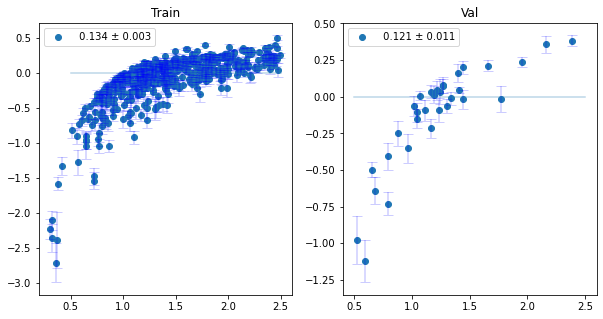

71/71 [==============================] - 101s 1s/step - loss: 0.1517 - val_loss: 0.1519
Epoch 204/1000
71/71 [==============================] - ETA: 0s - loss: 0.1514

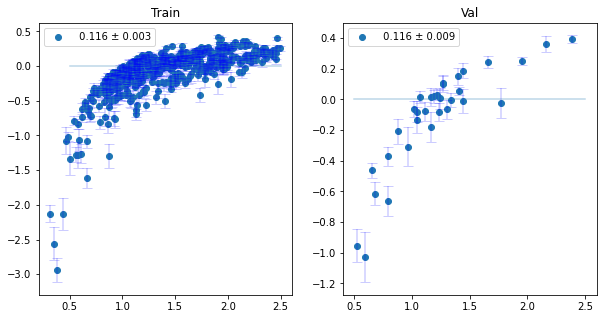

71/71 [==============================] - 101s 1s/step - loss: 0.1514 - val_loss: 0.1518
Epoch 205/1000
71/71 [==============================] - ETA: 0s - loss: 0.1511

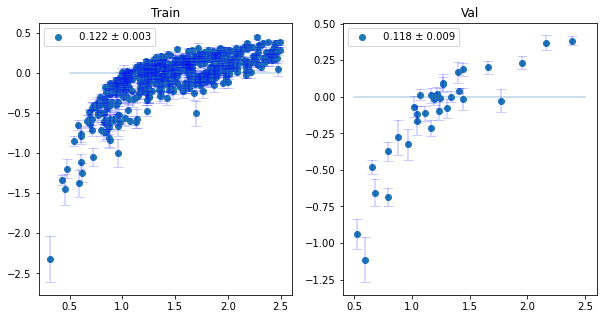

71/71 [==============================] - 100s 1s/step - loss: 0.1511 - val_loss: 0.1516
Epoch 206/1000
71/71 [==============================] - ETA: 0s - loss: 0.1503

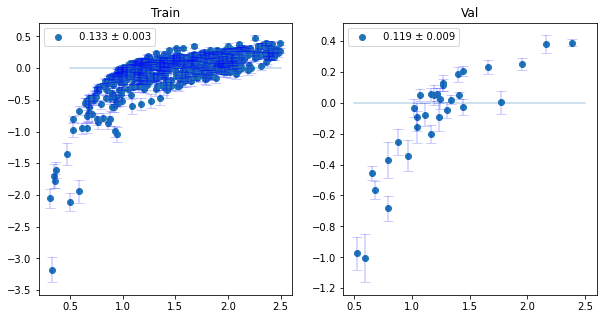

71/71 [==============================] - 100s 1s/step - loss: 0.1503 - val_loss: 0.1513
Epoch 207/1000
71/71 [==============================] - ETA: 0s - loss: 0.1509

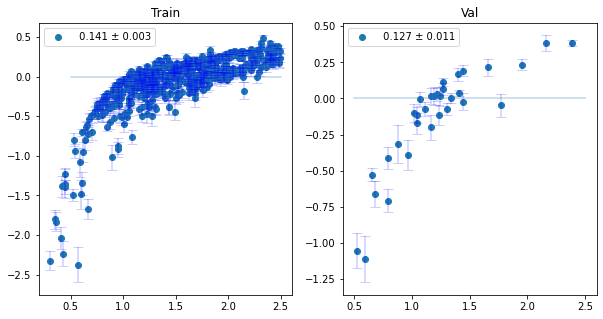

71/71 [==============================] - 102s 1s/step - loss: 0.1509 - val_loss: 0.1579
Epoch 208/1000
71/71 [==============================] - ETA: 0s - loss: 0.1507

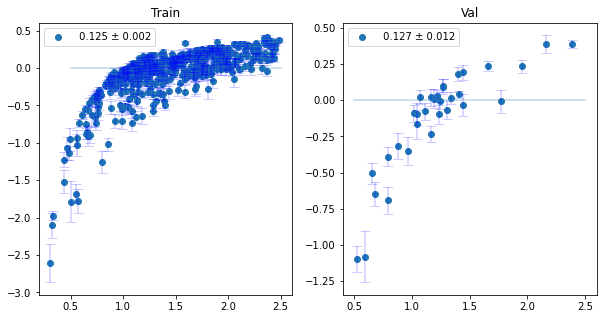

71/71 [==============================] - 101s 1s/step - loss: 0.1507 - val_loss: 0.1446
Epoch 209/1000
71/71 [==============================] - ETA: 0s - loss: 0.1503

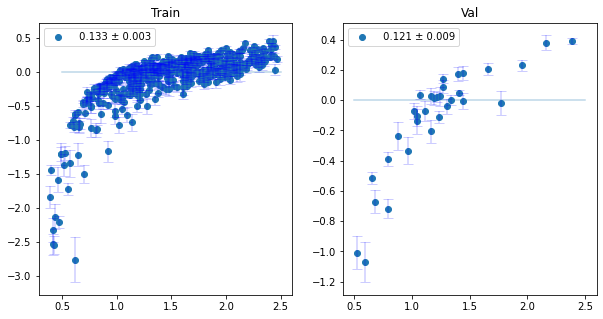

71/71 [==============================] - 100s 1s/step - loss: 0.1503 - val_loss: 0.1663
Epoch 210/1000
71/71 [==============================] - ETA: 0s - loss: 0.1497

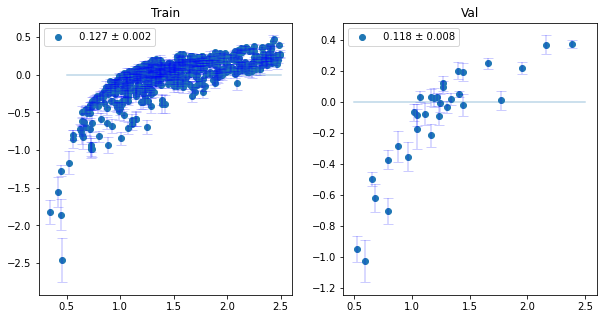

71/71 [==============================] - 101s 1s/step - loss: 0.1497 - val_loss: 0.1455
Epoch 211/1000
71/71 [==============================] - ETA: 0s - loss: 0.1498

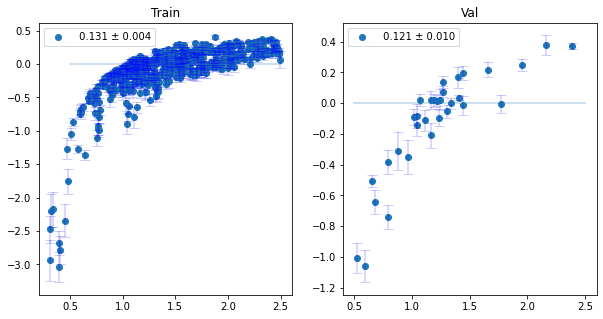

71/71 [==============================] - 99s 1s/step - loss: 0.1498 - val_loss: 0.1548
Epoch 212/1000
71/71 [==============================] - ETA: 0s - loss: 0.1489

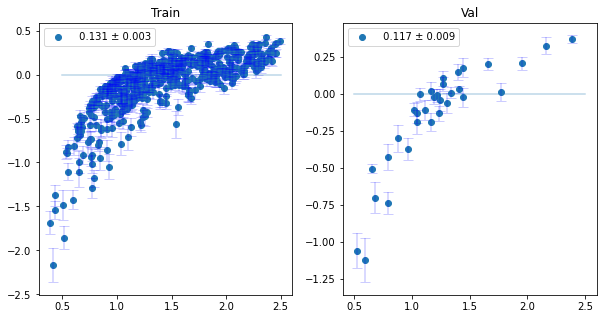

71/71 [==============================] - 101s 1s/step - loss: 0.1489 - val_loss: 0.1513
Epoch 213/1000
71/71 [==============================] - ETA: 0s - loss: 0.1494

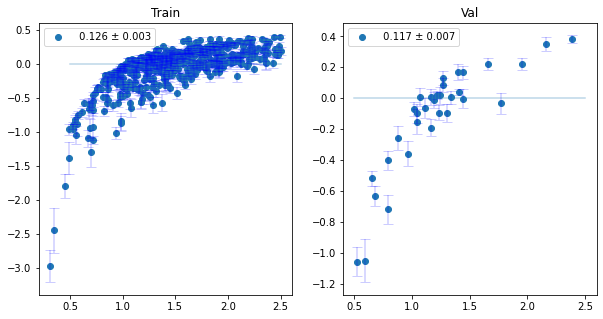

71/71 [==============================] - 101s 1s/step - loss: 0.1494 - val_loss: 0.1493
Epoch 214/1000
71/71 [==============================] - ETA: 0s - loss: 0.1491

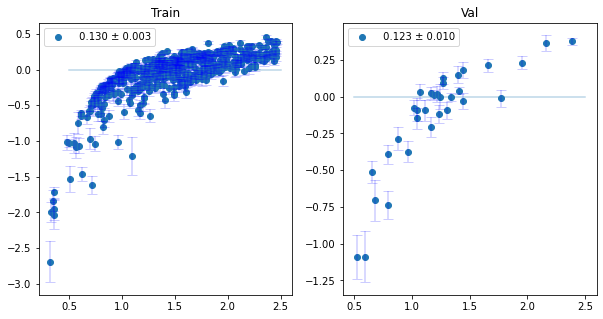

71/71 [==============================] - 102s 1s/step - loss: 0.1491 - val_loss: 0.1561
Epoch 215/1000
71/71 [==============================] - ETA: 0s - loss: 0.1491

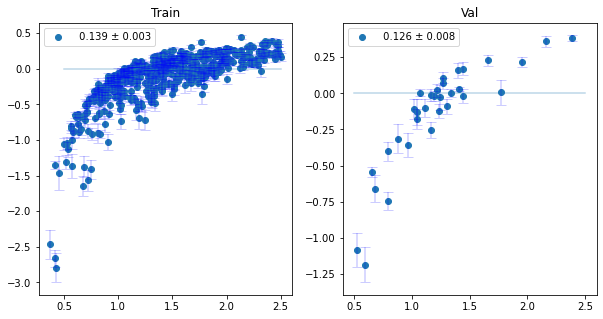

71/71 [==============================] - 103s 1s/step - loss: 0.1491 - val_loss: 0.1477
Epoch 216/1000
71/71 [==============================] - ETA: 0s - loss: 0.1490

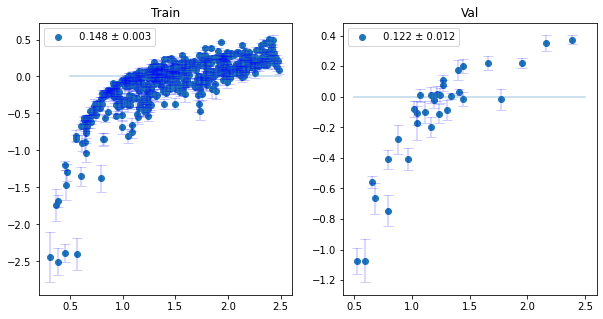

71/71 [==============================] - 101s 1s/step - loss: 0.1490 - val_loss: 0.1495
Epoch 217/1000
71/71 [==============================] - ETA: 0s - loss: 0.1481

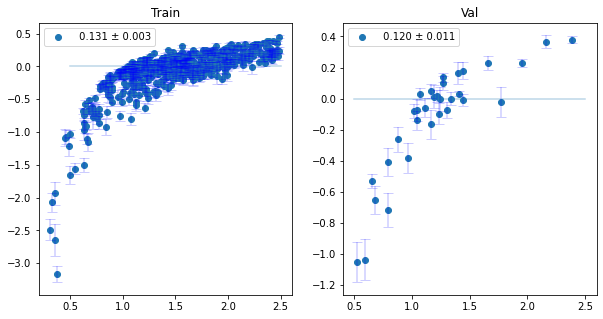

71/71 [==============================] - 100s 1s/step - loss: 0.1481 - val_loss: 0.1566
Epoch 218/1000
71/71 [==============================] - ETA: 0s - loss: 0.1478

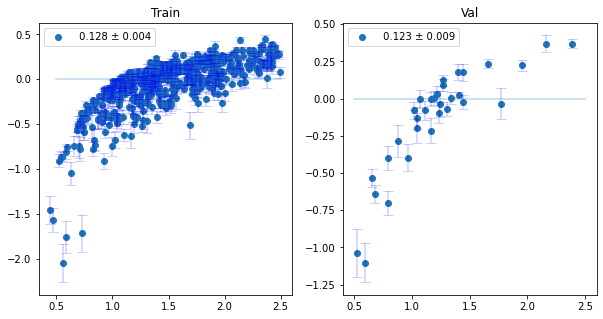

71/71 [==============================] - 100s 1s/step - loss: 0.1478 - val_loss: 0.1443
Epoch 219/1000
71/71 [==============================] - ETA: 0s - loss: 0.1479

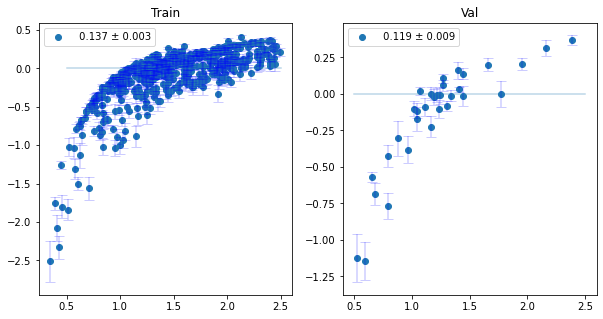

71/71 [==============================] - 100s 1s/step - loss: 0.1479 - val_loss: 0.1582
Epoch 220/1000
71/71 [==============================] - ETA: 0s - loss: 0.1481

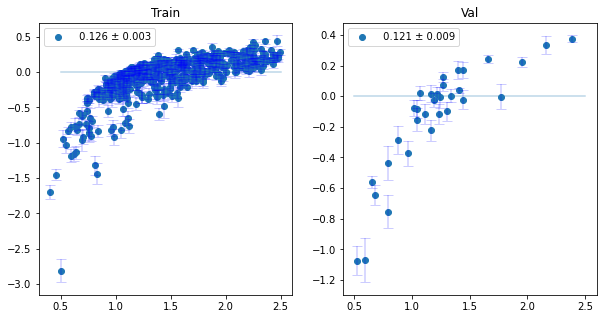

71/71 [==============================] - 100s 1s/step - loss: 0.1481 - val_loss: 0.1673
Epoch 221/1000
71/71 [==============================] - ETA: 0s - loss: 0.1476

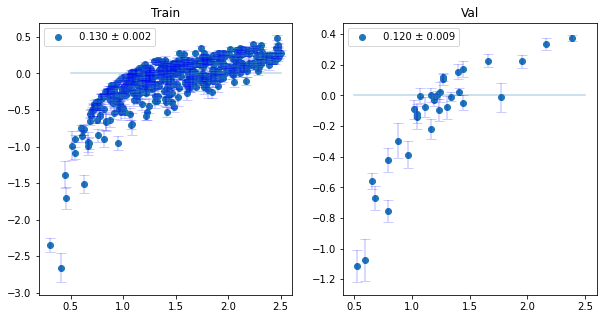

71/71 [==============================] - 101s 1s/step - loss: 0.1476 - val_loss: 0.1456
Epoch 222/1000
71/71 [==============================] - ETA: 0s - loss: 0.1470

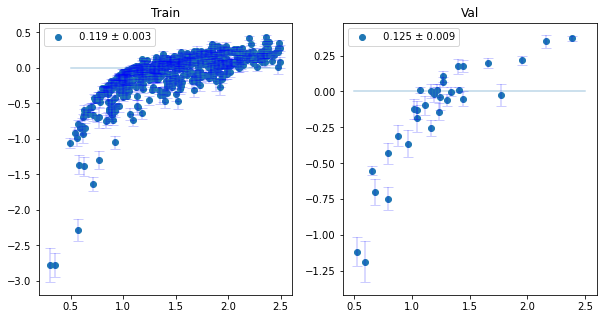

71/71 [==============================] - 101s 1s/step - loss: 0.1470 - val_loss: 0.1634
Epoch 223/1000
71/71 [==============================] - ETA: 0s - loss: 0.1468

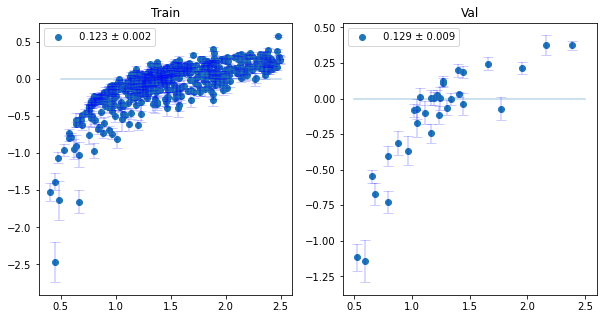

71/71 [==============================] - 101s 1s/step - loss: 0.1468 - val_loss: 0.1589
Epoch 224/1000
71/71 [==============================] - ETA: 0s - loss: 0.1474

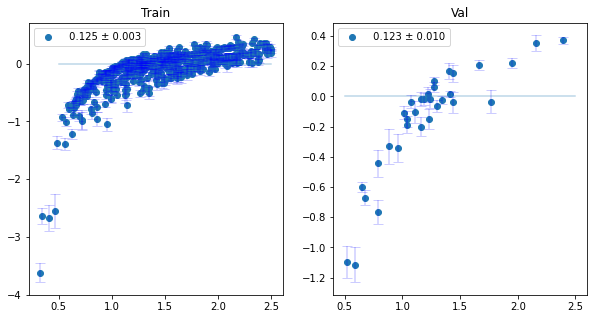

71/71 [==============================] - 101s 1s/step - loss: 0.1474 - val_loss: 0.1573
Epoch 225/1000
71/71 [==============================] - ETA: 0s - loss: 0.1476

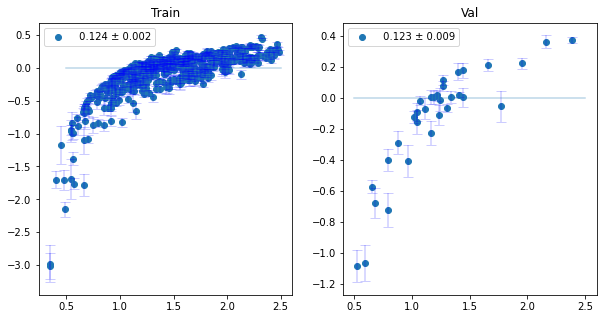

71/71 [==============================] - 101s 1s/step - loss: 0.1476 - val_loss: 0.1772
Epoch 226/1000
71/71 [==============================] - ETA: 0s - loss: 0.1457

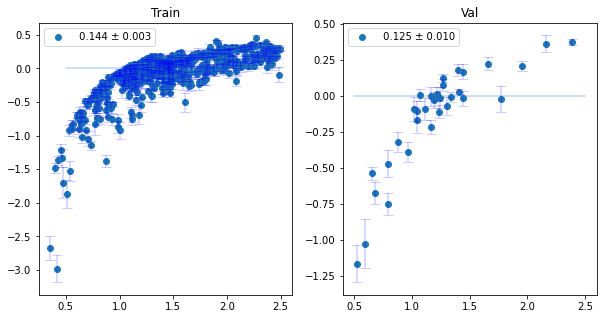

71/71 [==============================] - 101s 1s/step - loss: 0.1457 - val_loss: 0.1504
Epoch 227/1000
71/71 [==============================] - ETA: 0s - loss: 0.1468

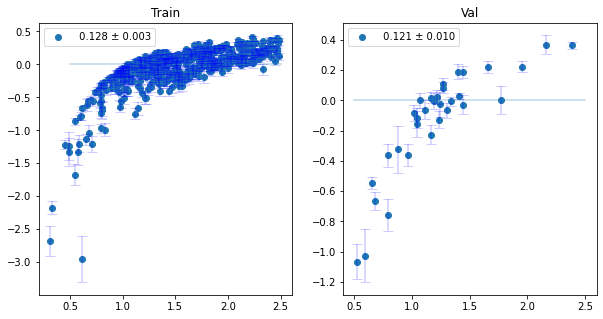

71/71 [==============================] - 101s 1s/step - loss: 0.1468 - val_loss: 0.1352
Epoch 228/1000
71/71 [==============================] - ETA: 0s - loss: 0.1463

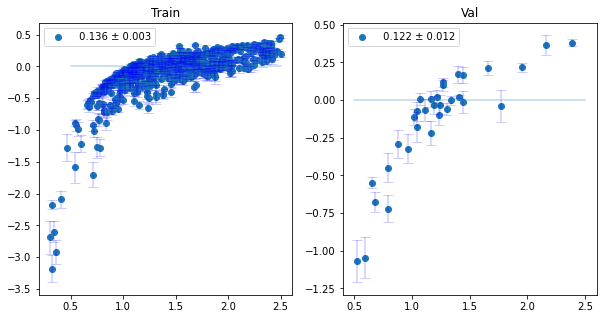

71/71 [==============================] - 101s 1s/step - loss: 0.1463 - val_loss: 0.1541
Epoch 229/1000
71/71 [==============================] - ETA: 0s - loss: 0.1457

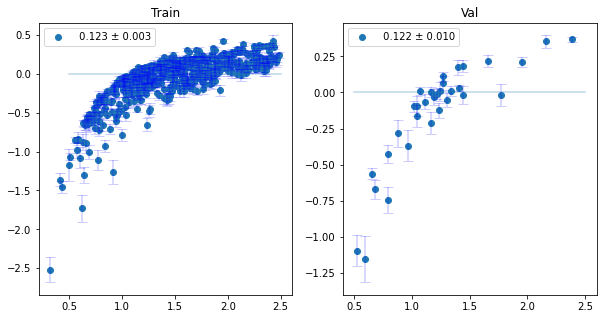

71/71 [==============================] - 101s 1s/step - loss: 0.1457 - val_loss: 0.1458
Epoch 230/1000
71/71 [==============================] - ETA: 0s - loss: 0.1444

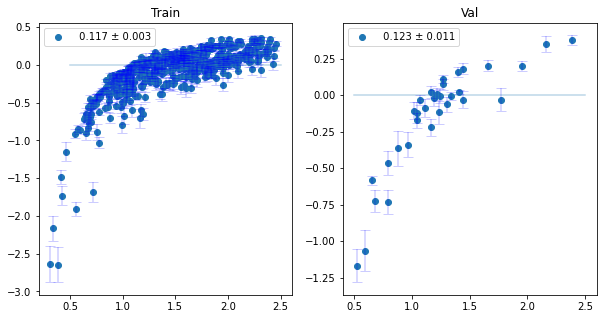

71/71 [==============================] - 100s 1s/step - loss: 0.1444 - val_loss: 0.1556
Epoch 231/1000
71/71 [==============================] - ETA: 0s - loss: 0.1442

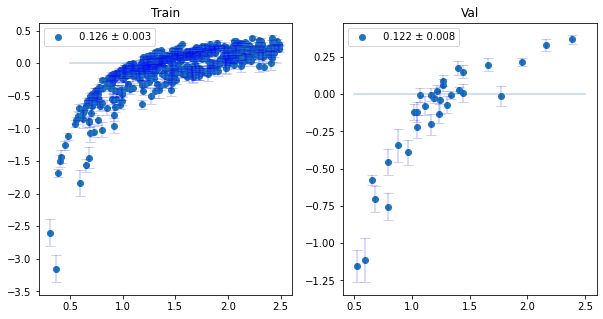

71/71 [==============================] - 100s 1s/step - loss: 0.1442 - val_loss: 0.1508
Epoch 232/1000
71/71 [==============================] - ETA: 0s - loss: 0.1448

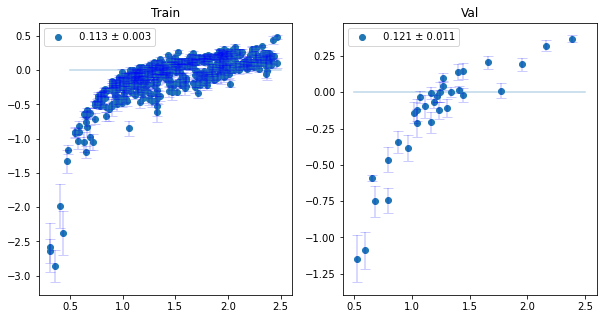

71/71 [==============================] - 100s 1s/step - loss: 0.1448 - val_loss: 0.1469
Epoch 233/1000
71/71 [==============================] - ETA: 0s - loss: 0.1441

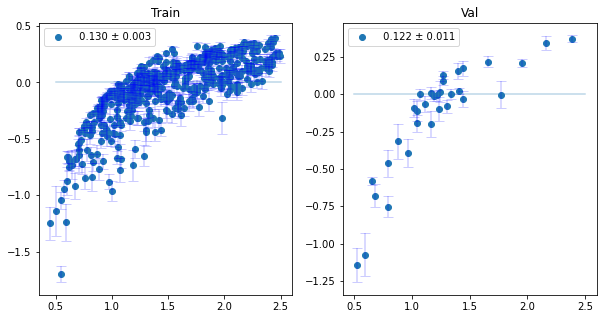

71/71 [==============================] - 100s 1s/step - loss: 0.1441 - val_loss: 0.1557
Epoch 234/1000
71/71 [==============================] - ETA: 0s - loss: 0.1453

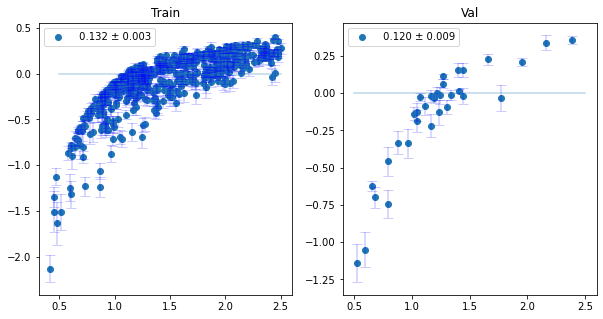

71/71 [==============================] - 100s 1s/step - loss: 0.1453 - val_loss: 0.1571
Epoch 235/1000
71/71 [==============================] - ETA: 0s - loss: 0.1448

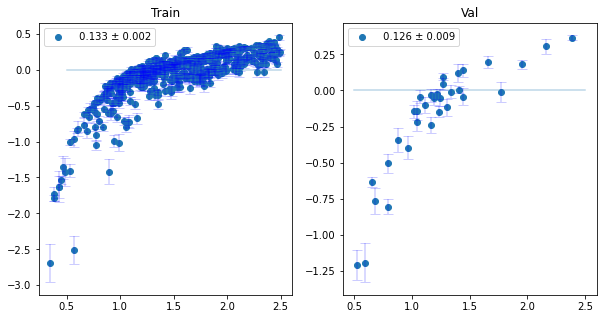

71/71 [==============================] - 101s 1s/step - loss: 0.1448 - val_loss: 0.1603
Epoch 236/1000
71/71 [==============================] - ETA: 0s - loss: 0.1442

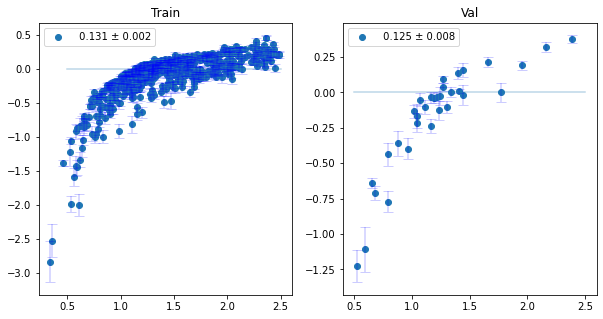

71/71 [==============================] - 100s 1s/step - loss: 0.1442 - val_loss: 0.1538
Epoch 237/1000
71/71 [==============================] - ETA: 0s - loss: 0.1442

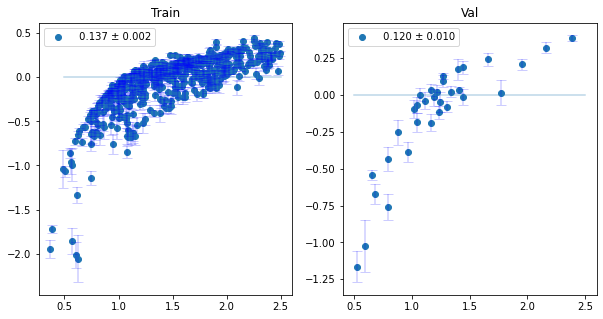

71/71 [==============================] - 100s 1s/step - loss: 0.1442 - val_loss: 0.1565
Epoch 238/1000
71/71 [==============================] - ETA: 0s - loss: 0.1438

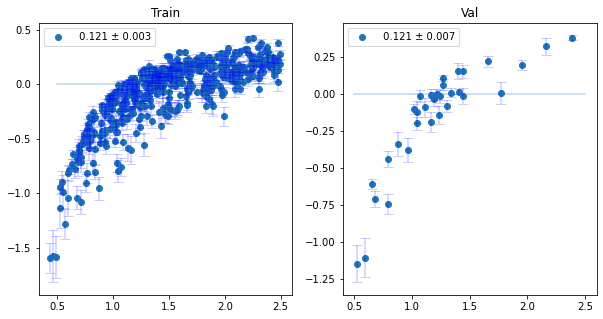

71/71 [==============================] - 101s 1s/step - loss: 0.1438 - val_loss: 0.1609
Epoch 239/1000
71/71 [==============================] - ETA: 0s - loss: 0.1433

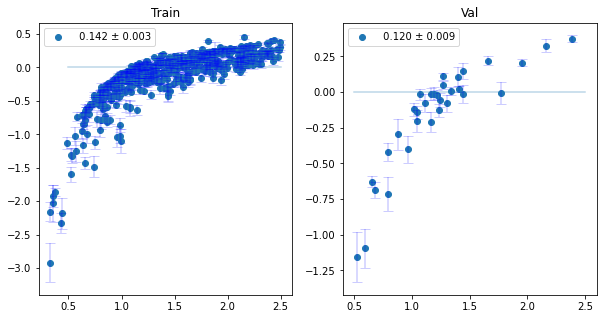

71/71 [==============================] - 101s 1s/step - loss: 0.1433 - val_loss: 0.1486
Epoch 240/1000
71/71 [==============================] - ETA: 0s - loss: 0.1434

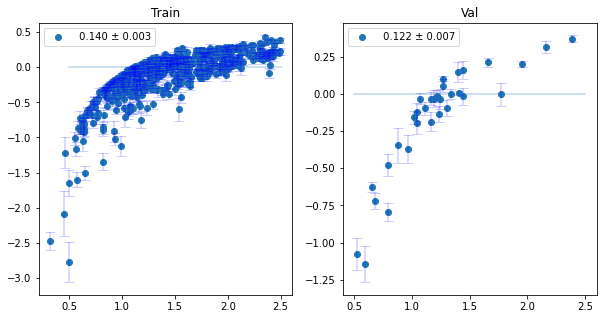

71/71 [==============================] - 101s 1s/step - loss: 0.1434 - val_loss: 0.1440
Epoch 241/1000
71/71 [==============================] - ETA: 0s - loss: 0.1426

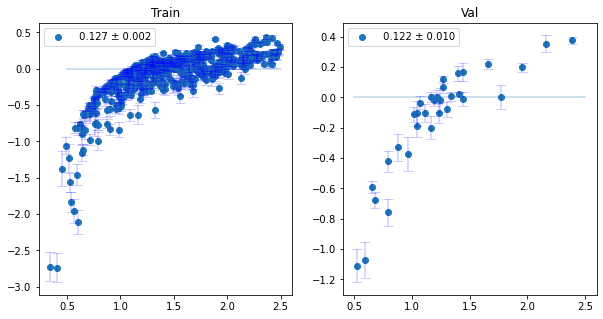

71/71 [==============================] - 101s 1s/step - loss: 0.1426 - val_loss: 0.1521
Epoch 242/1000
71/71 [==============================] - ETA: 0s - loss: 0.1426

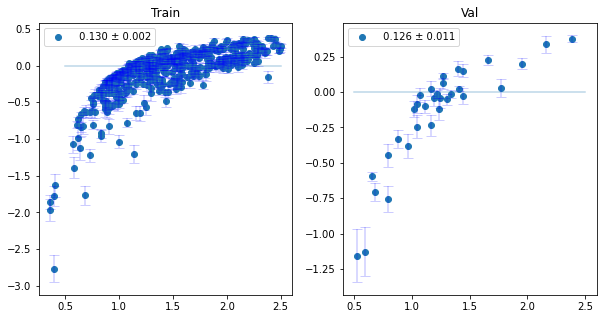

71/71 [==============================] - 101s 1s/step - loss: 0.1426 - val_loss: 0.1481
Epoch 243/1000
71/71 [==============================] - ETA: 0s - loss: 0.1433

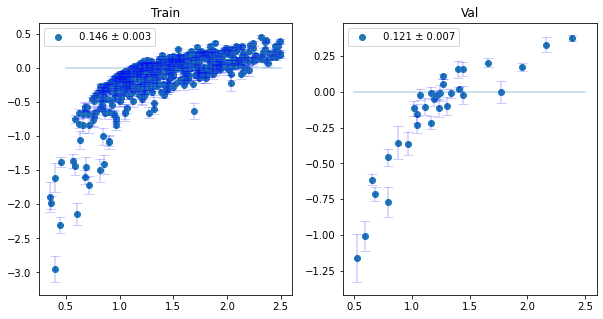

71/71 [==============================] - 101s 1s/step - loss: 0.1433 - val_loss: 0.1352
Epoch 244/1000
71/71 [==============================] - ETA: 0s - loss: 0.1430

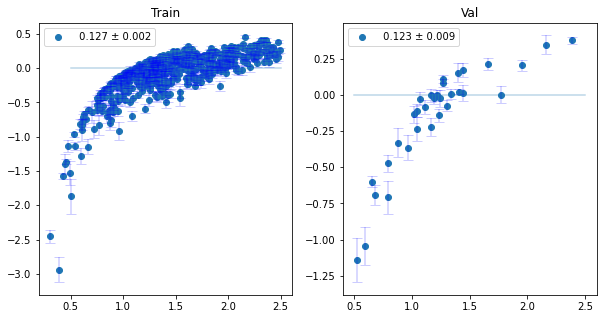

71/71 [==============================] - 100s 1s/step - loss: 0.1430 - val_loss: 0.1756
Epoch 245/1000
71/71 [==============================] - ETA: 0s - loss: 0.1426

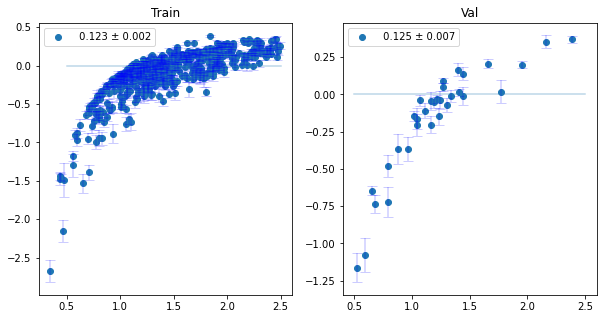

71/71 [==============================] - 100s 1s/step - loss: 0.1426 - val_loss: 0.1548
Epoch 246/1000
71/71 [==============================] - ETA: 0s - loss: 0.1425

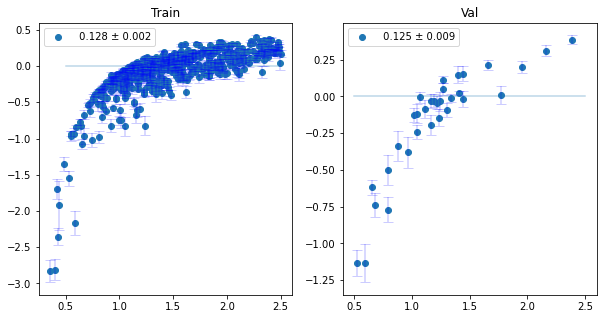

71/71 [==============================] - 100s 1s/step - loss: 0.1425 - val_loss: 0.1410
Epoch 247/1000
71/71 [==============================] - ETA: 0s - loss: 0.1421

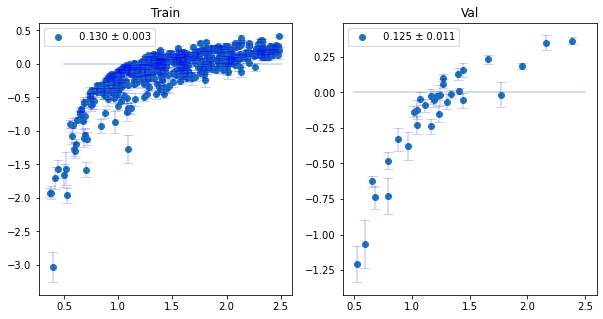

71/71 [==============================] - 100s 1s/step - loss: 0.1421 - val_loss: 0.1556
Epoch 248/1000
71/71 [==============================] - ETA: 0s - loss: 0.1419

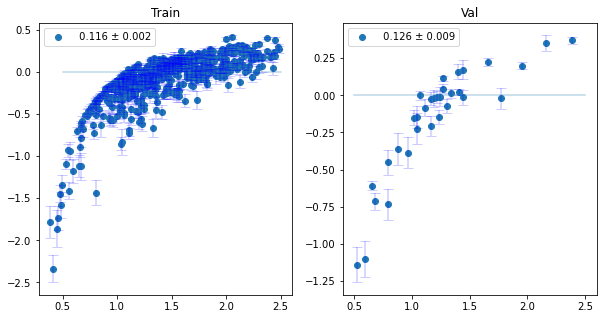

71/71 [==============================] - 102s 1s/step - loss: 0.1419 - val_loss: 0.1642
Epoch 249/1000
71/71 [==============================] - ETA: 0s - loss: 0.1425

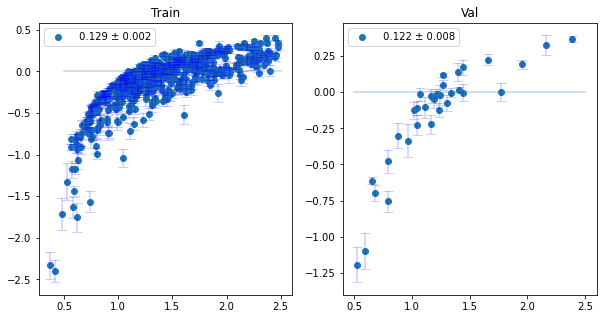

71/71 [==============================] - 104s 1s/step - loss: 0.1425 - val_loss: 0.1484
Epoch 250/1000
71/71 [==============================] - ETA: 0s - loss: 0.1420

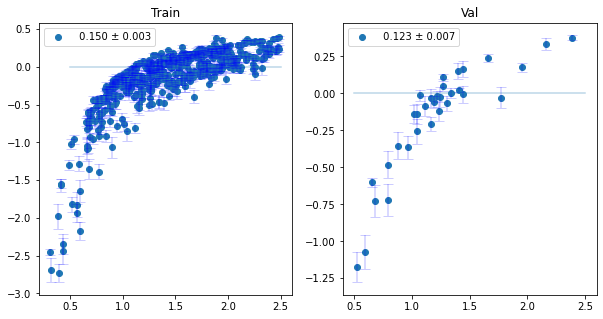

71/71 [==============================] - 104s 1s/step - loss: 0.1420 - val_loss: 0.1490
Epoch 251/1000
71/71 [==============================] - ETA: 0s - loss: 0.1422

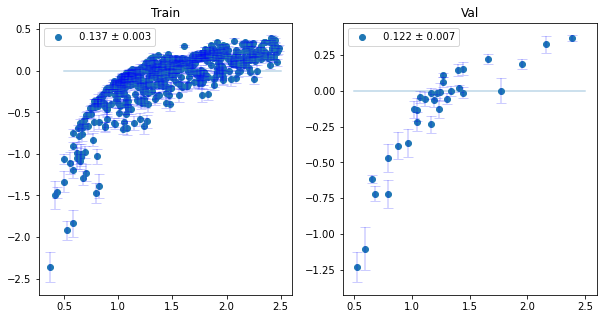

71/71 [==============================] - 100s 1s/step - loss: 0.1422 - val_loss: 0.1492
Epoch 252/1000
71/71 [==============================] - ETA: 0s - loss: 0.1411

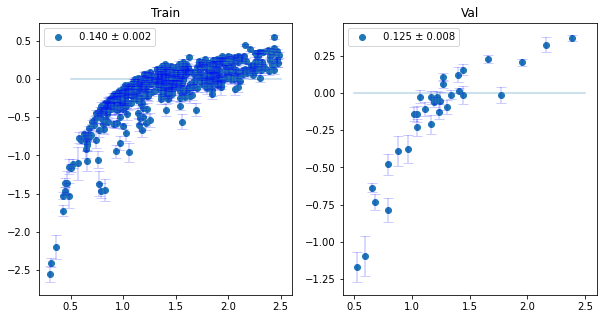

71/71 [==============================] - 101s 1s/step - loss: 0.1411 - val_loss: 0.1499
Epoch 253/1000
71/71 [==============================] - ETA: 0s - loss: 0.1403

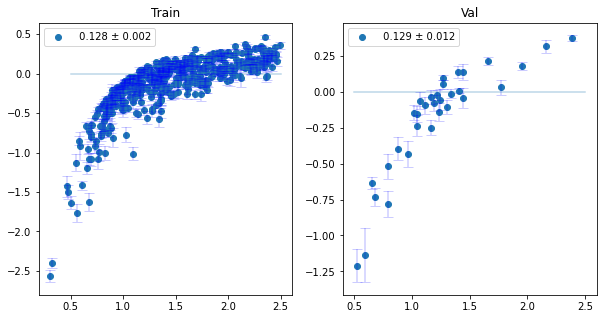

71/71 [==============================] - 101s 1s/step - loss: 0.1403 - val_loss: 0.1671
Epoch 254/1000
71/71 [==============================] - ETA: 0s - loss: 0.1400

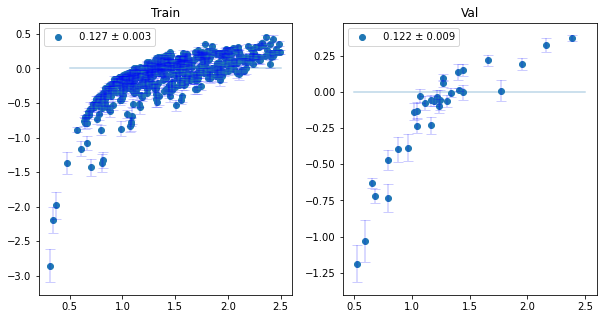

71/71 [==============================] - 102s 1s/step - loss: 0.1400 - val_loss: 0.1520
Epoch 255/1000
71/71 [==============================] - ETA: 0s - loss: 0.1412

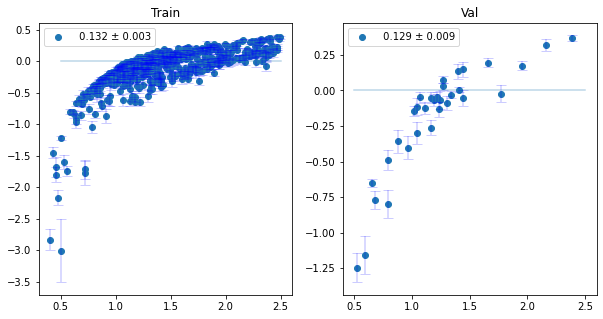

71/71 [==============================] - 100s 1s/step - loss: 0.1412 - val_loss: 0.1534
Epoch 256/1000
71/71 [==============================] - ETA: 0s - loss: 0.1403

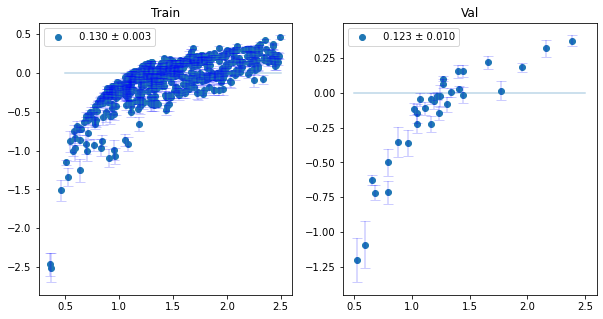

71/71 [==============================] - 100s 1s/step - loss: 0.1403 - val_loss: 0.1454
Epoch 257/1000
71/71 [==============================] - ETA: 0s - loss: 0.1400

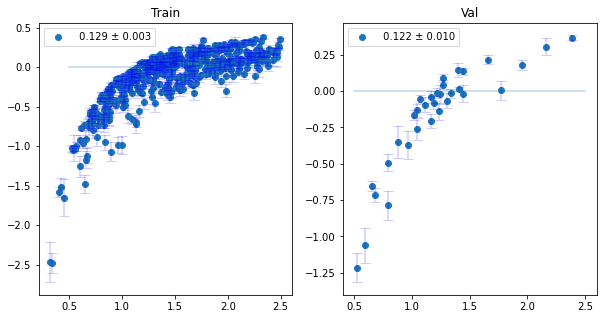

71/71 [==============================] - 102s 1s/step - loss: 0.1400 - val_loss: 0.1385
Epoch 258/1000
71/71 [==============================] - ETA: 0s - loss: 0.1409

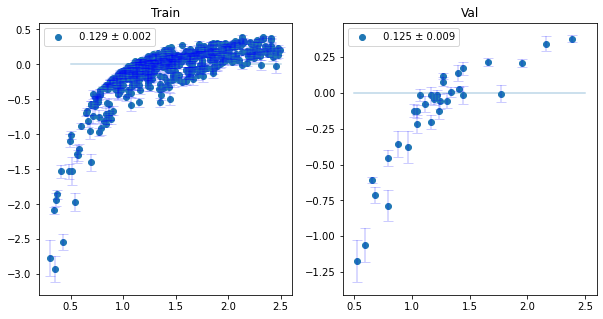

71/71 [==============================] - 103s 1s/step - loss: 0.1409 - val_loss: 0.1592
Epoch 259/1000
71/71 [==============================] - ETA: 0s - loss: 0.1407

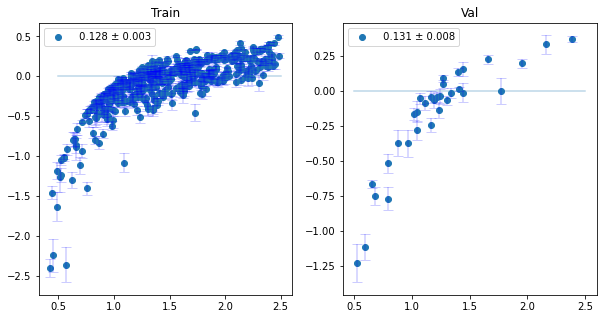

71/71 [==============================] - 102s 1s/step - loss: 0.1407 - val_loss: 0.1547
Epoch 260/1000
71/71 [==============================] - ETA: 0s - loss: 0.1404

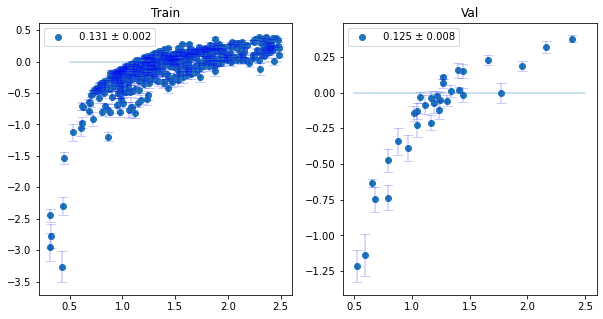

71/71 [==============================] - 102s 1s/step - loss: 0.1404 - val_loss: 0.1495
Epoch 261/1000
71/71 [==============================] - ETA: 0s - loss: 0.1399

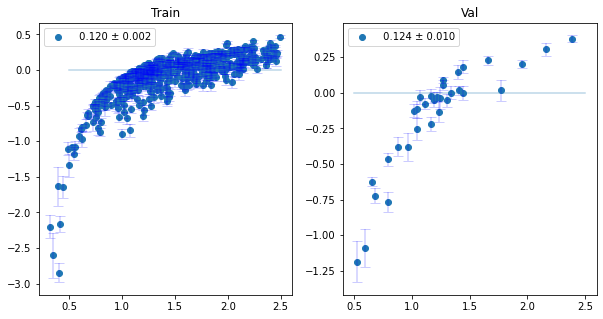

71/71 [==============================] - 103s 1s/step - loss: 0.1399 - val_loss: 0.1530
Epoch 262/1000
71/71 [==============================] - ETA: 0s - loss: 0.1393

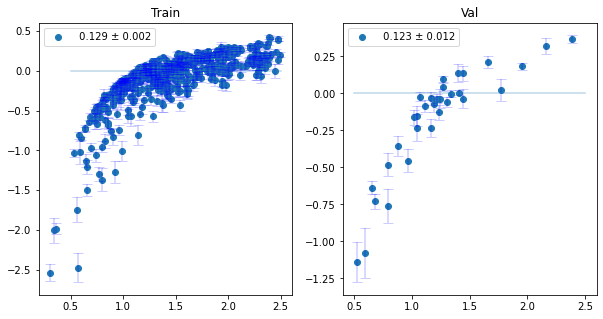

71/71 [==============================] - 103s 1s/step - loss: 0.1393 - val_loss: 0.1578
Epoch 263/1000
71/71 [==============================] - ETA: 0s - loss: 0.1397

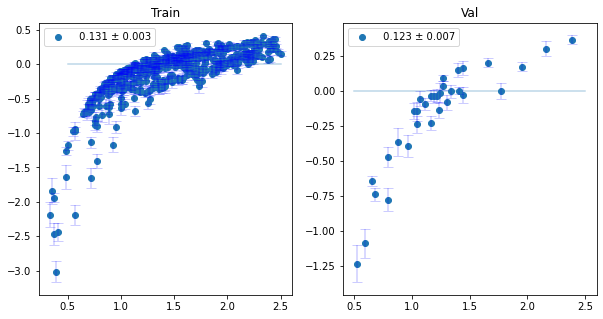

71/71 [==============================] - 103s 1s/step - loss: 0.1397 - val_loss: 0.1679
Epoch 264/1000
71/71 [==============================] - ETA: 0s - loss: 0.1398

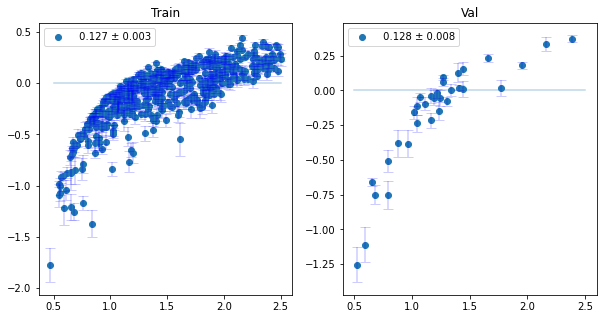

71/71 [==============================] - 101s 1s/step - loss: 0.1398 - val_loss: 0.1509
Epoch 265/1000
71/71 [==============================] - ETA: 0s - loss: 0.1391

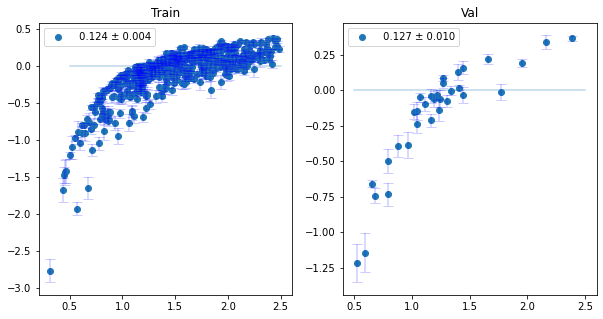

71/71 [==============================] - 101s 1s/step - loss: 0.1391 - val_loss: 0.1479
Epoch 266/1000
71/71 [==============================] - ETA: 0s - loss: 0.1388

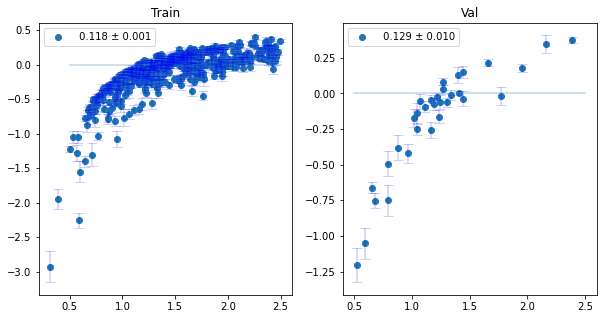

71/71 [==============================] - 100s 1s/step - loss: 0.1388 - val_loss: 0.1634
Epoch 267/1000
71/71 [==============================] - ETA: 0s - loss: 0.1389

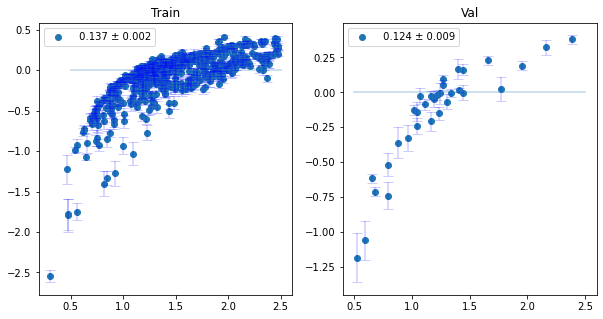

71/71 [==============================] - 100s 1s/step - loss: 0.1389 - val_loss: 0.1475
Epoch 268/1000
71/71 [==============================] - ETA: 0s - loss: 0.1384

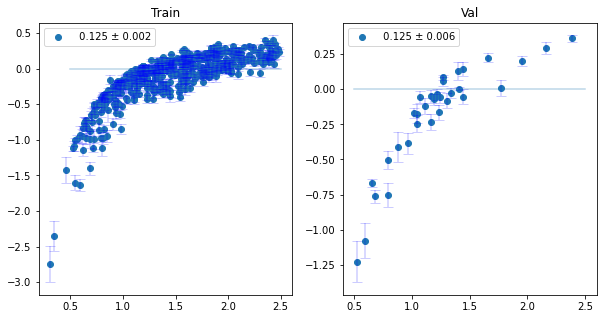

71/71 [==============================] - 101s 1s/step - loss: 0.1384 - val_loss: 0.1559
Epoch 269/1000
71/71 [==============================] - ETA: 0s - loss: 0.1388

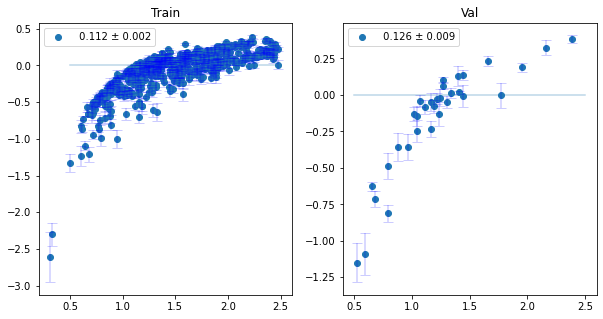

71/71 [==============================] - 101s 1s/step - loss: 0.1388 - val_loss: 0.1656
Epoch 270/1000
71/71 [==============================] - ETA: 0s - loss: 0.1390

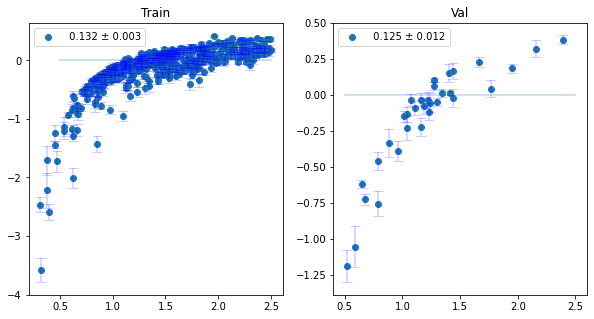

71/71 [==============================] - 102s 1s/step - loss: 0.1390 - val_loss: 0.1380
Epoch 271/1000
71/71 [==============================] - ETA: 0s - loss: 0.1380

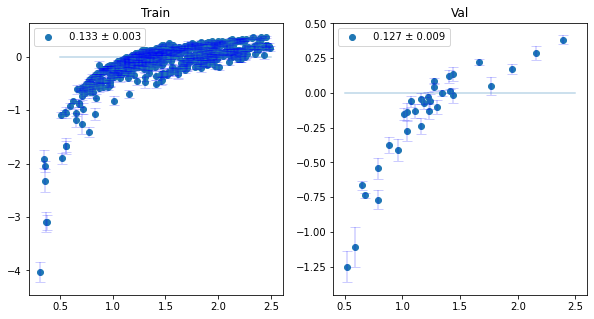

71/71 [==============================] - 103s 1s/step - loss: 0.1380 - val_loss: 0.1504
Epoch 272/1000
71/71 [==============================] - ETA: 0s - loss: 0.1391

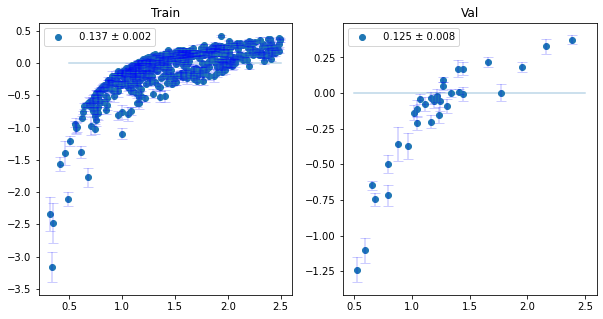

71/71 [==============================] - 102s 1s/step - loss: 0.1391 - val_loss: 0.1510
Epoch 273/1000
71/71 [==============================] - ETA: 0s - loss: 0.1381

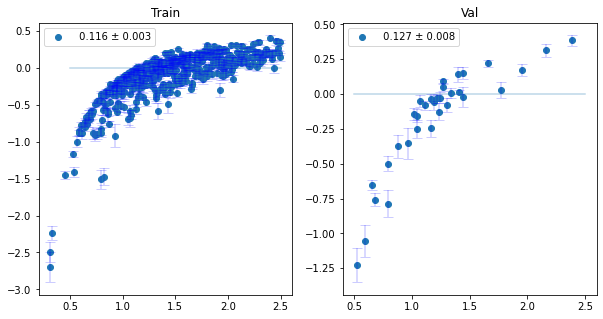

71/71 [==============================] - 100s 1s/step - loss: 0.1381 - val_loss: 0.1418
Epoch 274/1000
71/71 [==============================] - ETA: 0s - loss: 0.1371

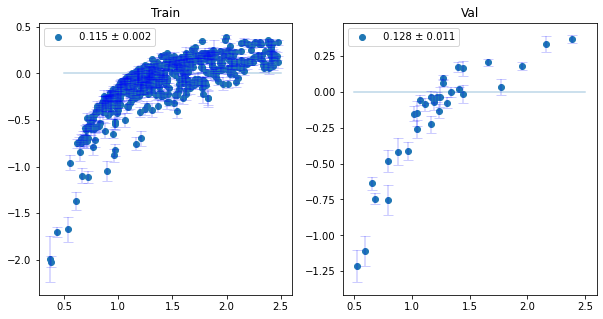

71/71 [==============================] - 101s 1s/step - loss: 0.1371 - val_loss: 0.1519
Epoch 275/1000
71/71 [==============================] - ETA: 0s - loss: 0.1375

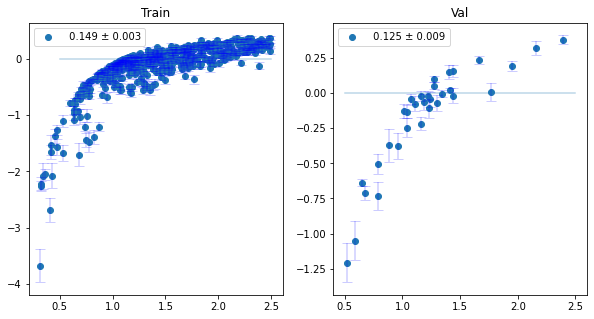

71/71 [==============================] - 101s 1s/step - loss: 0.1375 - val_loss: 0.1603
Epoch 276/1000
71/71 [==============================] - ETA: 0s - loss: 0.1385

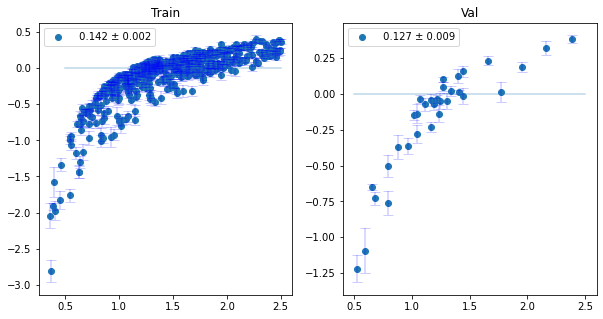

71/71 [==============================] - 100s 1s/step - loss: 0.1385 - val_loss: 0.1464
Epoch 277/1000
71/71 [==============================] - ETA: 0s - loss: 0.1380

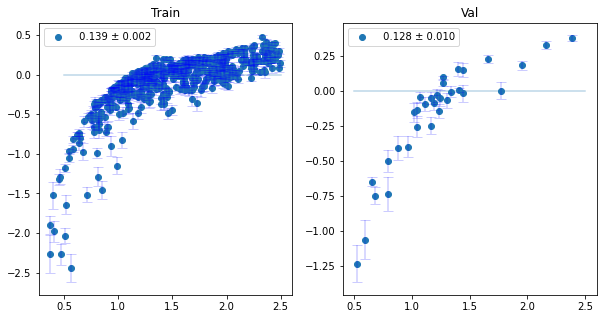

71/71 [==============================] - 101s 1s/step - loss: 0.1380 - val_loss: 0.1488
Epoch 278/1000
71/71 [==============================] - ETA: 0s - loss: 0.1384

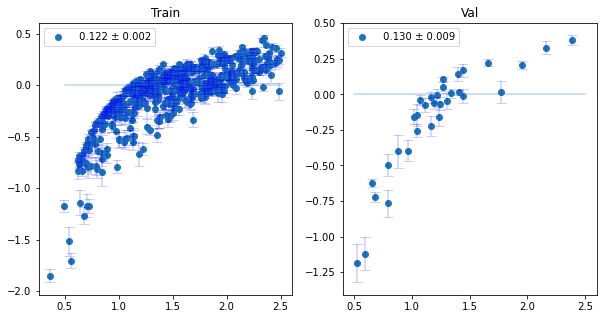

71/71 [==============================] - 101s 1s/step - loss: 0.1384 - val_loss: 0.1648
Epoch 279/1000
71/71 [==============================] - ETA: 0s - loss: 0.1373

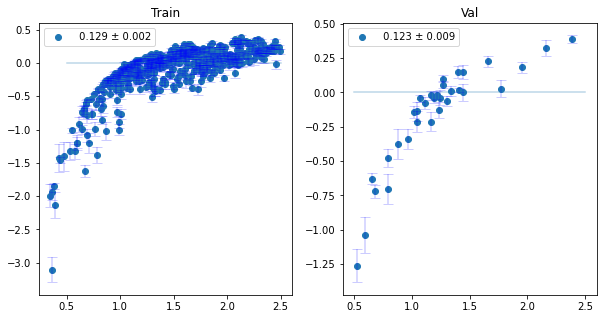

71/71 [==============================] - 101s 1s/step - loss: 0.1373 - val_loss: 0.1773
Epoch 280/1000
71/71 [==============================] - ETA: 0s - loss: 0.1368

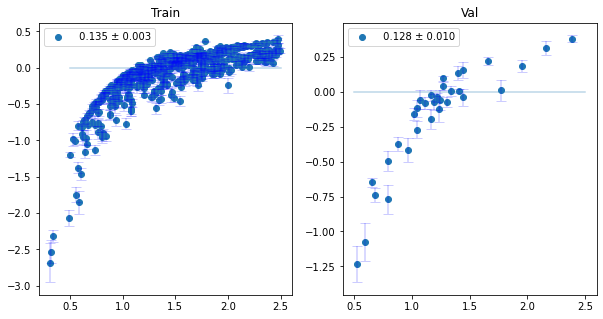

71/71 [==============================] - 102s 1s/step - loss: 0.1368 - val_loss: 0.1621
Epoch 281/1000
71/71 [==============================] - ETA: 0s - loss: 0.1366

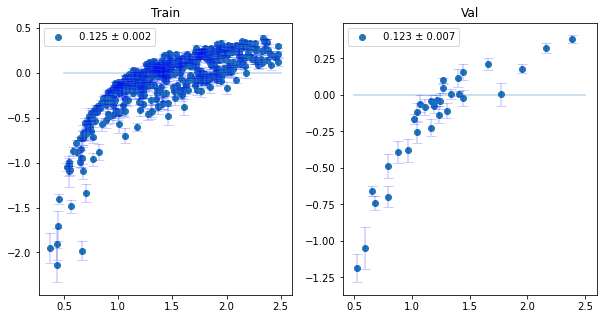

71/71 [==============================] - 101s 1s/step - loss: 0.1366 - val_loss: 0.1549
Epoch 282/1000
71/71 [==============================] - ETA: 0s - loss: 0.1363

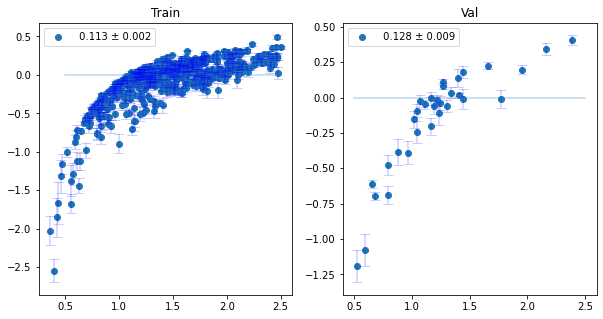

71/71 [==============================] - 103s 1s/step - loss: 0.1363 - val_loss: 0.1566
Epoch 283/1000
71/71 [==============================] - ETA: 0s - loss: 0.1366

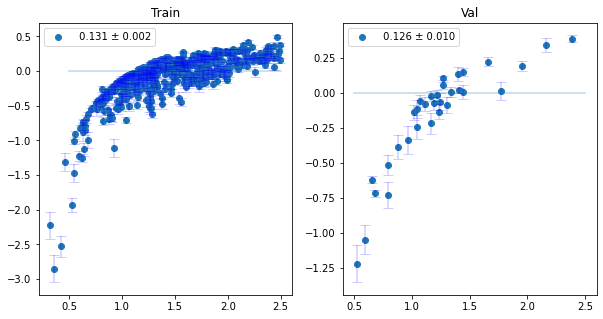

71/71 [==============================] - 103s 1s/step - loss: 0.1366 - val_loss: 0.1541
Epoch 284/1000
71/71 [==============================] - ETA: 0s - loss: 0.1363

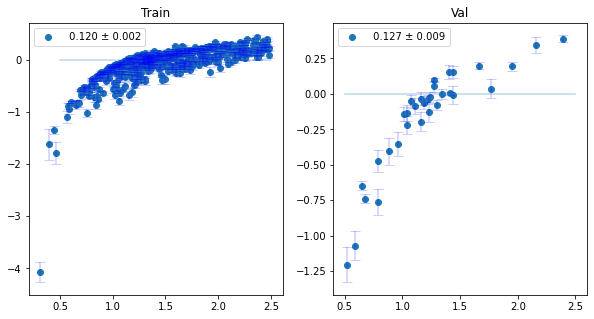

71/71 [==============================] - 101s 1s/step - loss: 0.1363 - val_loss: 0.1441
Epoch 285/1000
71/71 [==============================] - ETA: 0s - loss: 0.1364

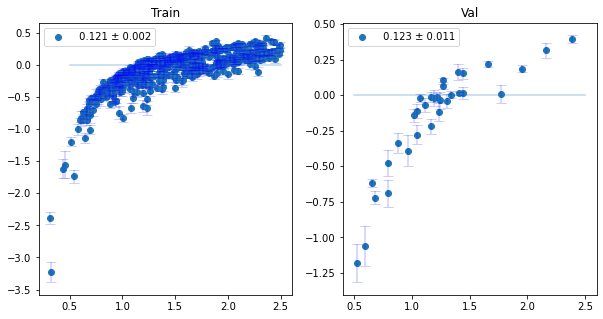

71/71 [==============================] - 102s 1s/step - loss: 0.1364 - val_loss: 0.1463
Epoch 286/1000
71/71 [==============================] - ETA: 0s - loss: 0.1362

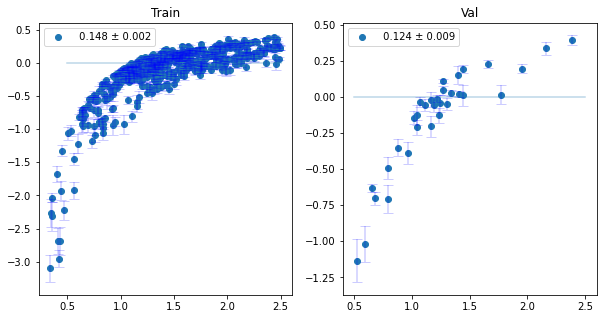

71/71 [==============================] - 103s 1s/step - loss: 0.1362 - val_loss: 0.1419
Epoch 287/1000
71/71 [==============================] - ETA: 0s - loss: 0.1363

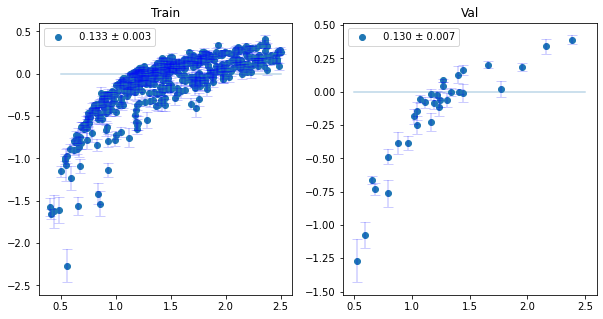

71/71 [==============================] - 100s 1s/step - loss: 0.1363 - val_loss: 0.1608
Epoch 288/1000
71/71 [==============================] - ETA: 0s - loss: 0.1363

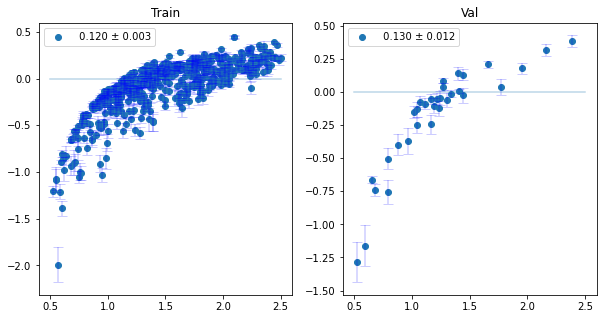

71/71 [==============================] - 101s 1s/step - loss: 0.1363 - val_loss: 0.1638
Epoch 289/1000
71/71 [==============================] - ETA: 0s - loss: 0.1364

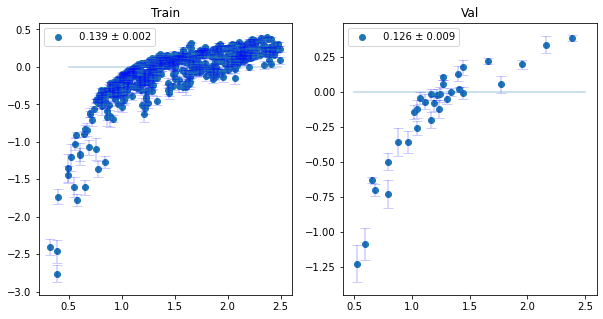

71/71 [==============================] - 100s 1s/step - loss: 0.1364 - val_loss: 0.1644
Epoch 290/1000
71/71 [==============================] - ETA: 0s - loss: 0.1358

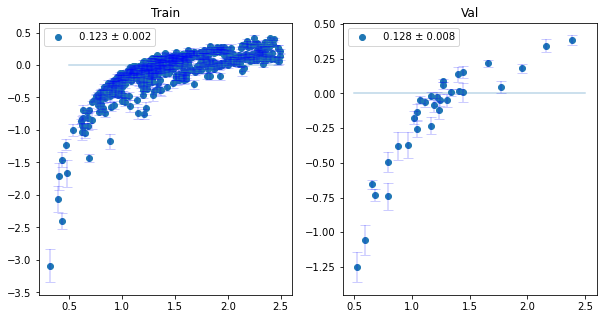

71/71 [==============================] - 101s 1s/step - loss: 0.1358 - val_loss: 0.1666
Epoch 291/1000
71/71 [==============================] - ETA: 0s - loss: 0.1352

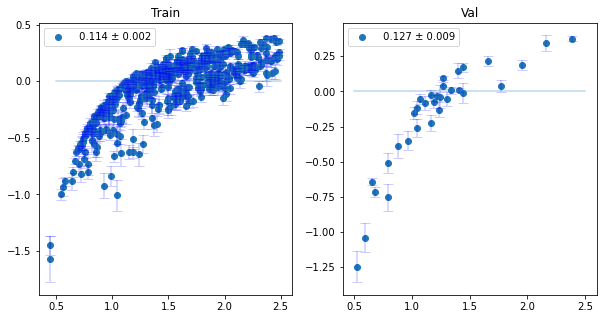

71/71 [==============================] - 100s 1s/step - loss: 0.1352 - val_loss: 0.1625
Epoch 292/1000
71/71 [==============================] - ETA: 0s - loss: 0.1358

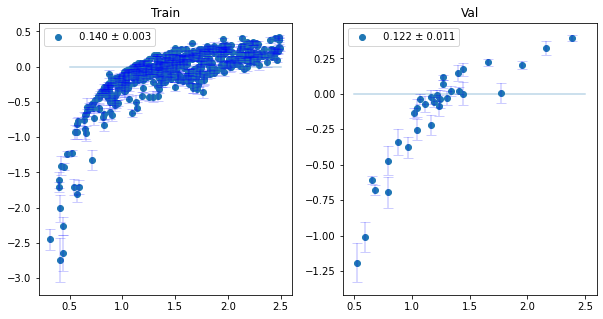

71/71 [==============================] - 100s 1s/step - loss: 0.1358 - val_loss: 0.1654
Epoch 293/1000
71/71 [==============================] - ETA: 0s - loss: 0.1353

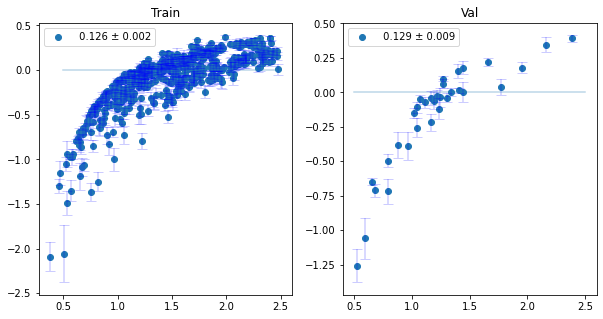

71/71 [==============================] - 100s 1s/step - loss: 0.1353 - val_loss: 0.1437
Epoch 294/1000
71/71 [==============================] - ETA: 0s - loss: 0.1358

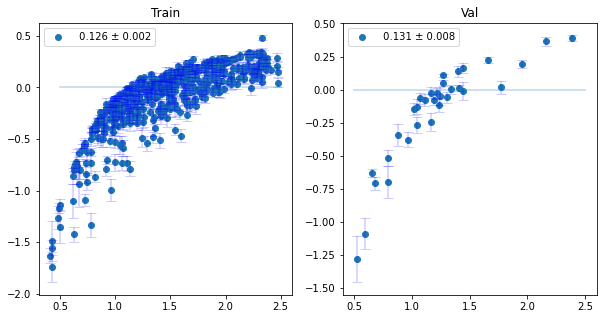

71/71 [==============================] - 101s 1s/step - loss: 0.1358 - val_loss: 0.1569
Epoch 295/1000
71/71 [==============================] - ETA: 0s - loss: 0.1353

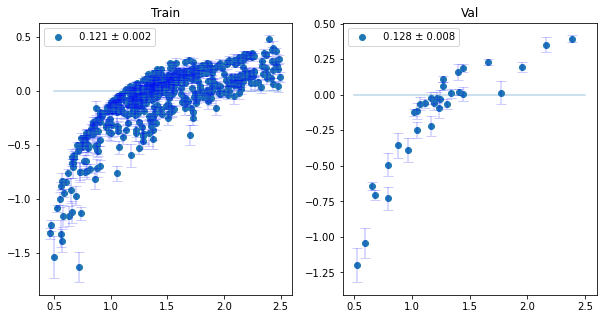

71/71 [==============================] - 101s 1s/step - loss: 0.1353 - val_loss: 0.1551
Epoch 296/1000
71/71 [==============================] - ETA: 0s - loss: 0.1351

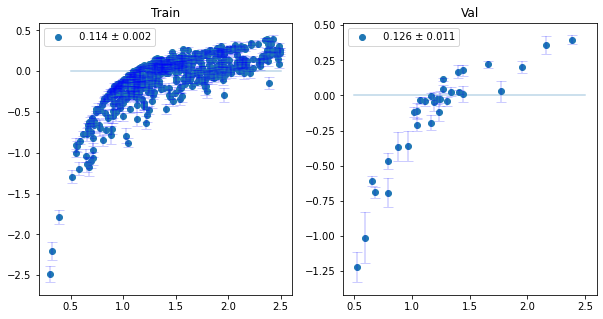

71/71 [==============================] - 102s 1s/step - loss: 0.1351 - val_loss: 0.1529
Epoch 297/1000
71/71 [==============================] - ETA: 0s - loss: 0.1341

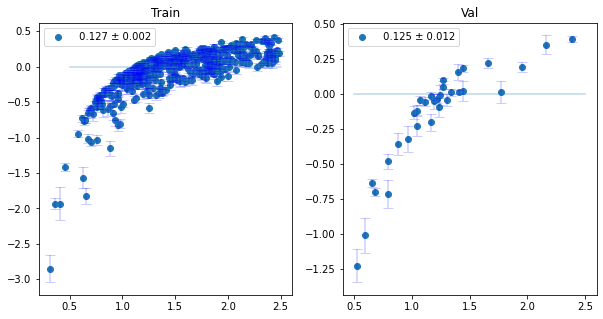

71/71 [==============================] - 100s 1s/step - loss: 0.1341 - val_loss: 0.1489
Epoch 298/1000
71/71 [==============================] - ETA: 0s - loss: 0.1346

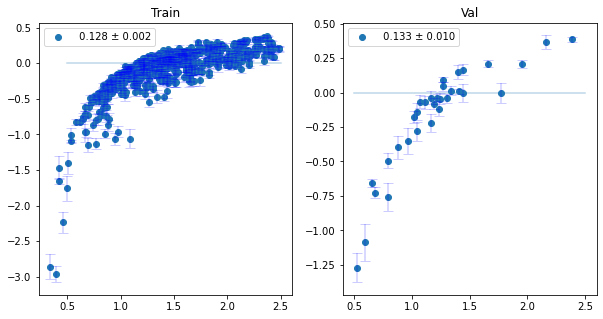

71/71 [==============================] - 101s 1s/step - loss: 0.1346 - val_loss: 0.1548
Epoch 299/1000
71/71 [==============================] - ETA: 0s - loss: 0.1348

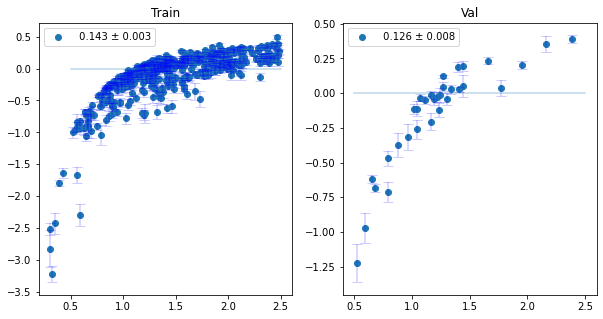

71/71 [==============================] - 101s 1s/step - loss: 0.1348 - val_loss: 0.1561
Epoch 300/1000
71/71 [==============================] - ETA: 0s - loss: 0.1347

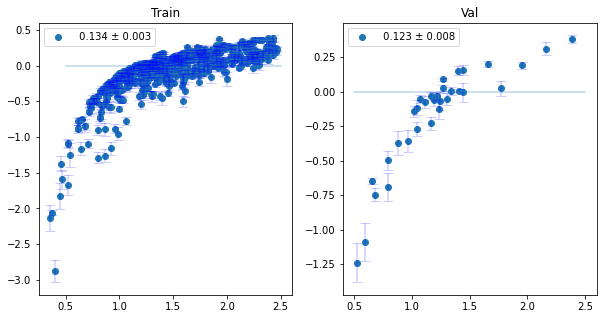

71/71 [==============================] - 101s 1s/step - loss: 0.1347 - val_loss: 0.1682
Epoch 301/1000
71/71 [==============================] - ETA: 0s - loss: 0.1347

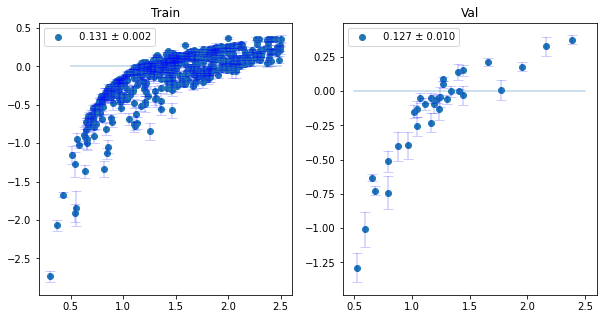

71/71 [==============================] - 101s 1s/step - loss: 0.1347 - val_loss: 0.1493
Epoch 302/1000
71/71 [==============================] - ETA: 0s - loss: 0.1343

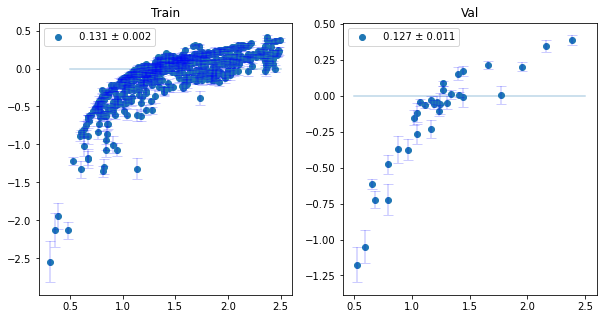

71/71 [==============================] - 102s 1s/step - loss: 0.1343 - val_loss: 0.1472
Epoch 303/1000
71/71 [==============================] - ETA: 0s - loss: 0.1337

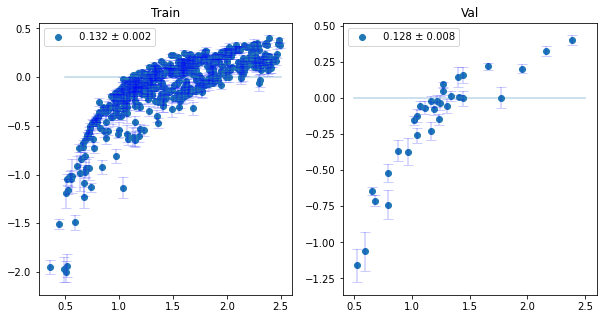

71/71 [==============================] - 103s 1s/step - loss: 0.1337 - val_loss: 0.1513
Epoch 304/1000
71/71 [==============================] - ETA: 0s - loss: 0.1347

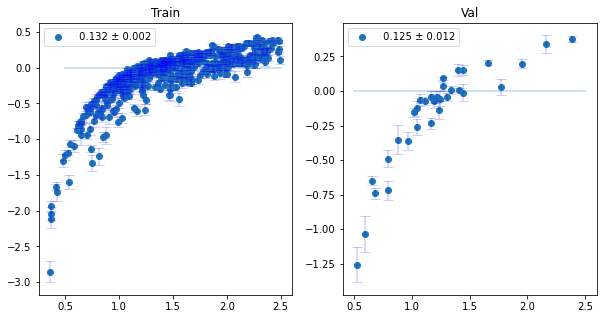

71/71 [==============================] - 103s 1s/step - loss: 0.1347 - val_loss: 0.1626
Epoch 305/1000
71/71 [==============================] - ETA: 0s - loss: 0.1341

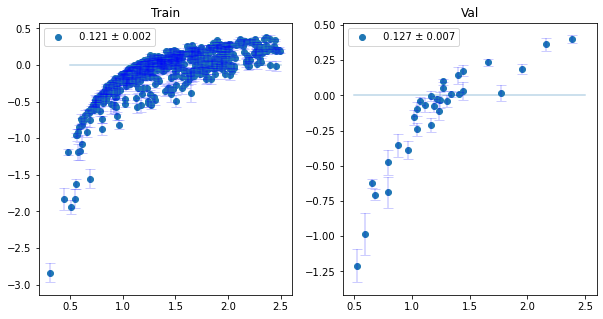

71/71 [==============================] - 103s 1s/step - loss: 0.1341 - val_loss: 0.1789
Epoch 306/1000
71/71 [==============================] - ETA: 0s - loss: 0.1337

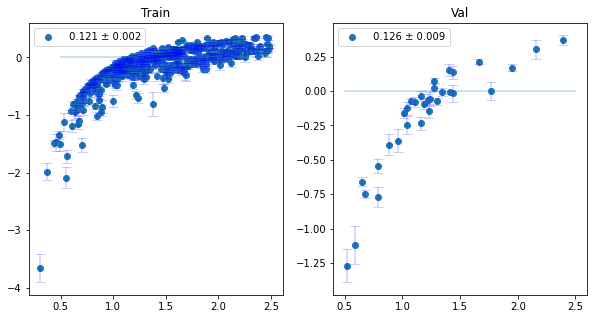

71/71 [==============================] - 103s 1s/step - loss: 0.1337 - val_loss: 0.1698
Epoch 307/1000
71/71 [==============================] - ETA: 0s - loss: 0.1344

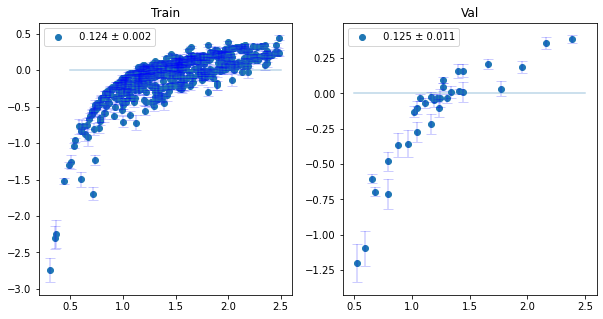

71/71 [==============================] - 102s 1s/step - loss: 0.1344 - val_loss: 0.1624
Epoch 308/1000
71/71 [==============================] - ETA: 0s - loss: 0.1340

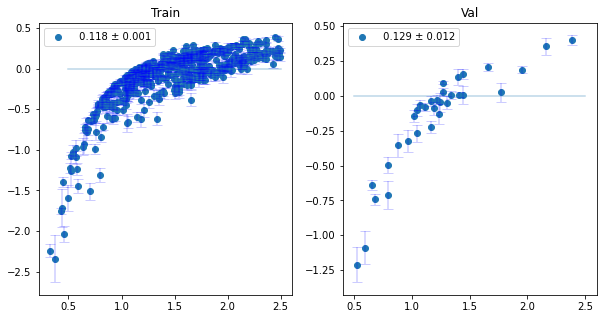

71/71 [==============================] - 100s 1s/step - loss: 0.1340 - val_loss: 0.1553
Epoch 309/1000
71/71 [==============================] - ETA: 0s - loss: 0.1340

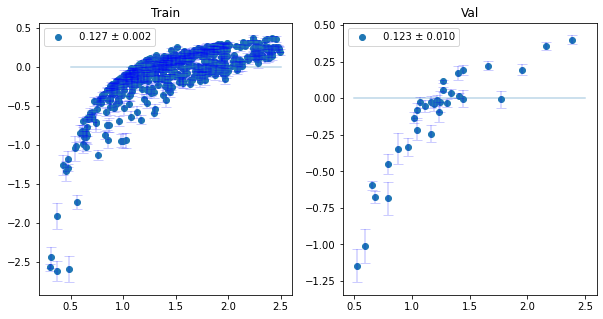

71/71 [==============================] - 101s 1s/step - loss: 0.1340 - val_loss: 0.1654
Epoch 310/1000
71/71 [==============================] - ETA: 0s - loss: 0.1338

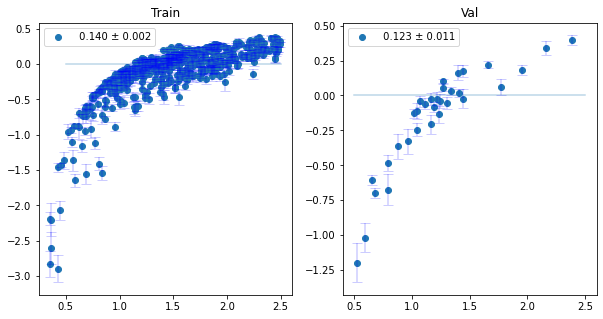

71/71 [==============================] - 102s 1s/step - loss: 0.1338 - val_loss: 0.1383
Epoch 311/1000
71/71 [==============================] - ETA: 0s - loss: 0.1338

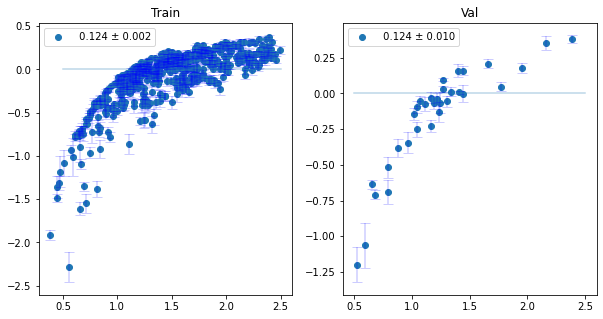

71/71 [==============================] - 101s 1s/step - loss: 0.1338 - val_loss: 0.1529
Epoch 312/1000
71/71 [==============================] - ETA: 0s - loss: 0.1329

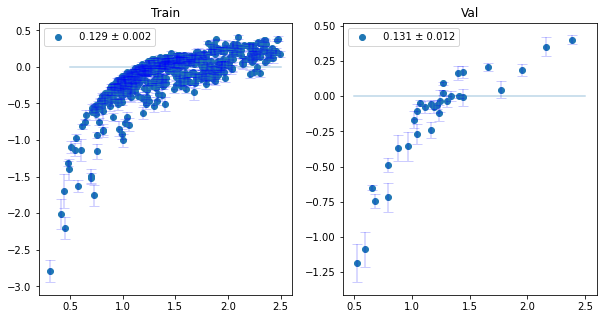

71/71 [==============================] - 101s 1s/step - loss: 0.1329 - val_loss: 0.1531
Epoch 313/1000
71/71 [==============================] - ETA: 0s - loss: 0.1334

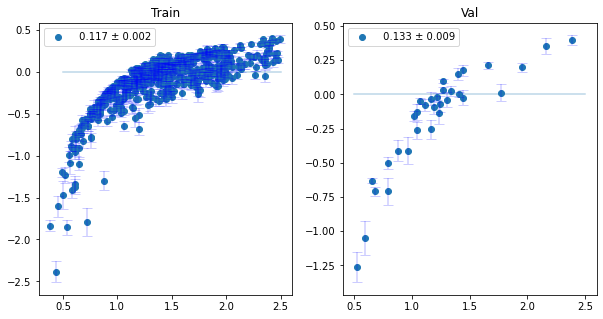

71/71 [==============================] - 101s 1s/step - loss: 0.1334 - val_loss: 0.1600
Epoch 314/1000
71/71 [==============================] - ETA: 0s - loss: 0.1339

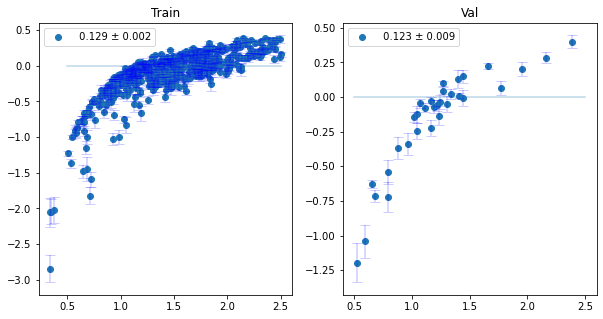

71/71 [==============================] - 101s 1s/step - loss: 0.1339 - val_loss: 0.1498
Epoch 315/1000
71/71 [==============================] - ETA: 0s - loss: 0.1334

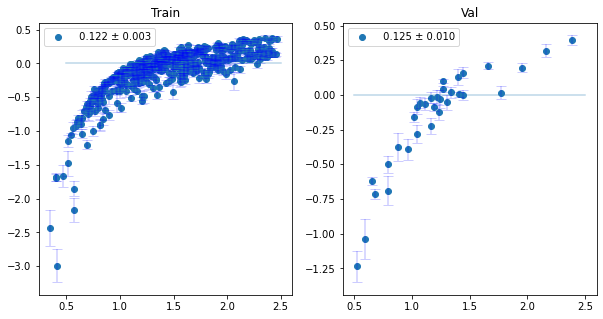

71/71 [==============================] - 100s 1s/step - loss: 0.1334 - val_loss: 0.1683
Epoch 316/1000
71/71 [==============================] - ETA: 0s - loss: 0.1336

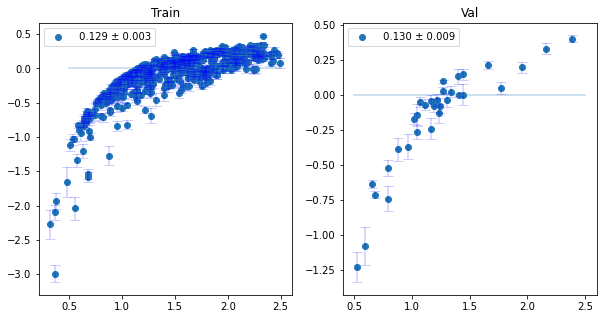

71/71 [==============================] - 100s 1s/step - loss: 0.1336 - val_loss: 0.1477
Epoch 317/1000
71/71 [==============================] - ETA: 0s - loss: 0.1326

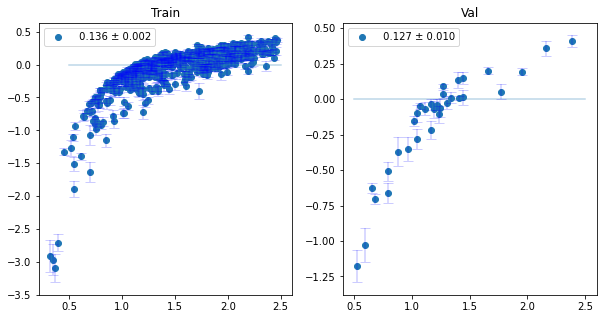

71/71 [==============================] - 101s 1s/step - loss: 0.1326 - val_loss: 0.1615
Epoch 318/1000
71/71 [==============================] - ETA: 0s - loss: 0.1334

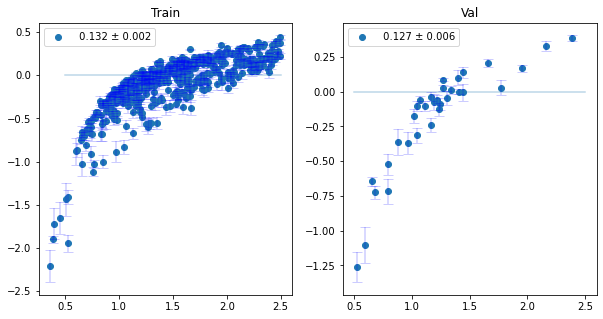

71/71 [==============================] - 100s 1s/step - loss: 0.1334 - val_loss: 0.1430
Epoch 319/1000
71/71 [==============================] - ETA: 0s - loss: 0.1332

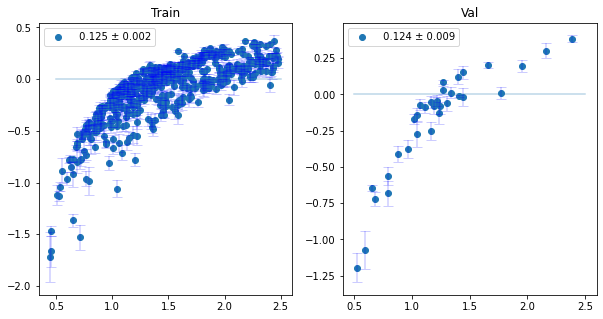

71/71 [==============================] - 101s 1s/step - loss: 0.1332 - val_loss: 0.1444
Epoch 320/1000
71/71 [==============================] - ETA: 0s - loss: 0.1327

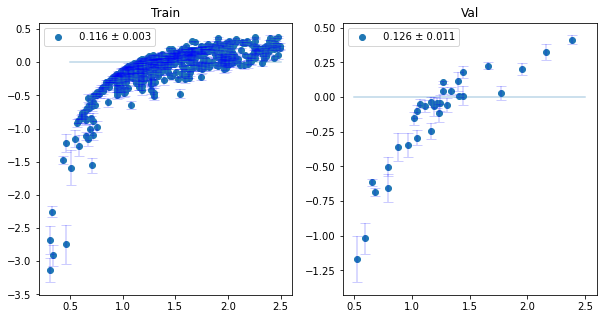

71/71 [==============================] - 101s 1s/step - loss: 0.1327 - val_loss: 0.1483
Epoch 321/1000
71/71 [==============================] - ETA: 0s - loss: 0.1328

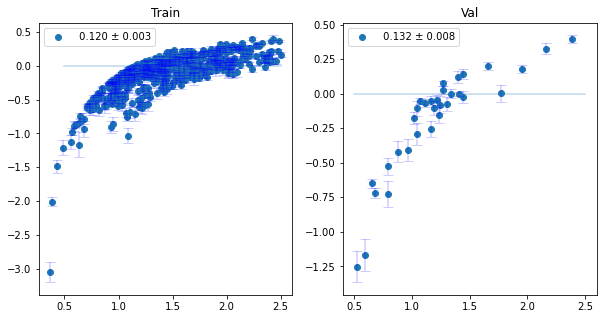

71/71 [==============================] - 101s 1s/step - loss: 0.1328 - val_loss: 0.1461
Epoch 322/1000
71/71 [==============================] - ETA: 0s - loss: 0.1329

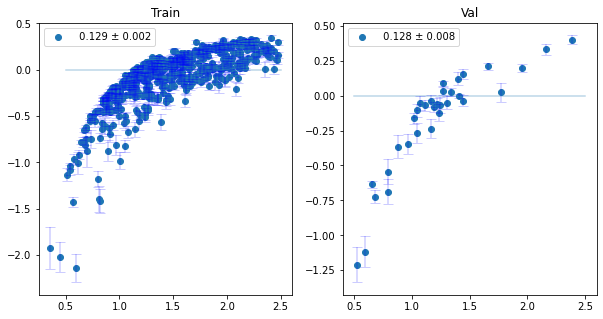

71/71 [==============================] - 102s 1s/step - loss: 0.1329 - val_loss: 0.1521
Epoch 323/1000
71/71 [==============================] - ETA: 0s - loss: 0.1326

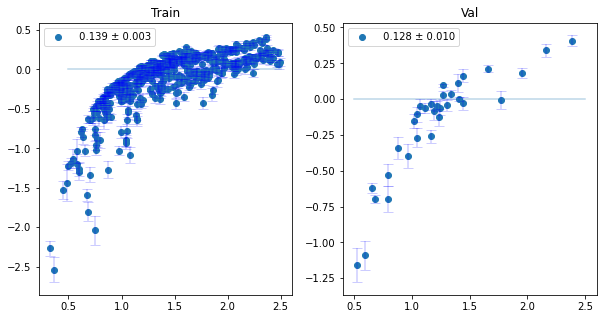

71/71 [==============================] - 102s 1s/step - loss: 0.1326 - val_loss: 0.1461
Epoch 324/1000
71/71 [==============================] - ETA: 0s - loss: 0.1325

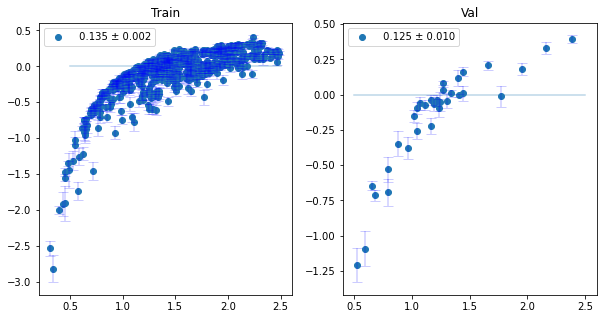

71/71 [==============================] - 100s 1s/step - loss: 0.1325 - val_loss: 0.1477
Epoch 325/1000
71/71 [==============================] - ETA: 0s - loss: 0.1328

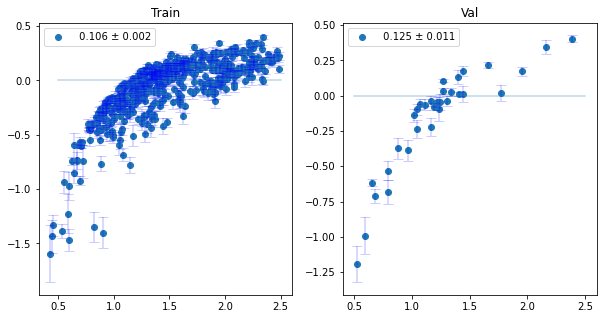

71/71 [==============================] - 101s 1s/step - loss: 0.1328 - val_loss: 0.1433
Epoch 326/1000
71/71 [==============================] - ETA: 0s - loss: 0.1320

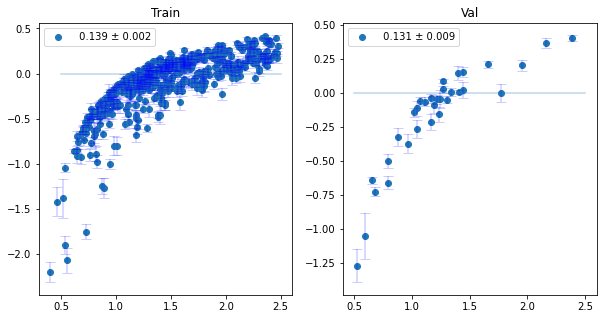

71/71 [==============================] - 101s 1s/step - loss: 0.1320 - val_loss: 0.1576
Epoch 327/1000
71/71 [==============================] - ETA: 0s - loss: 0.1322

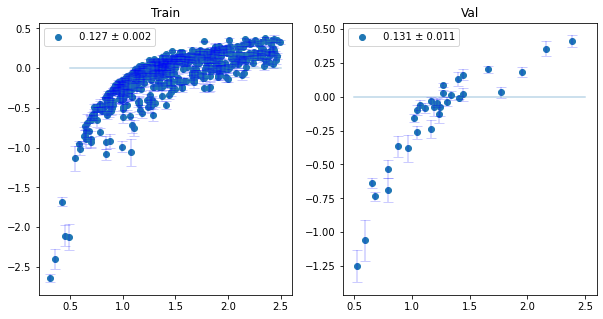

71/71 [==============================] - 101s 1s/step - loss: 0.1322 - val_loss: 0.1647
Epoch 328/1000
71/71 [==============================] - ETA: 0s - loss: 0.1314

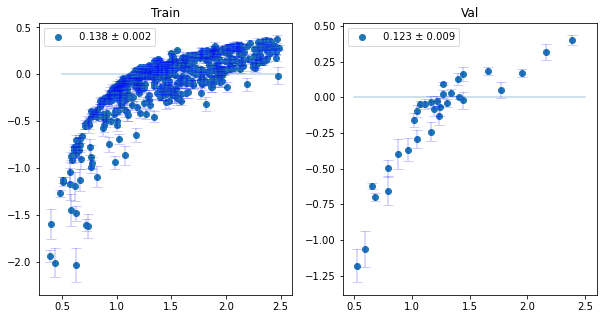

71/71 [==============================] - 101s 1s/step - loss: 0.1314 - val_loss: 0.1626
Epoch 329/1000
71/71 [==============================] - ETA: 0s - loss: 0.1316

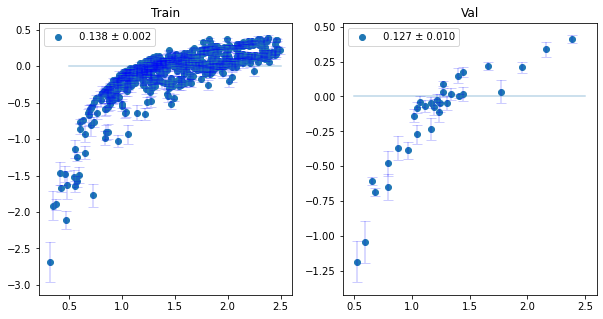

71/71 [==============================] - 102s 1s/step - loss: 0.1316 - val_loss: 0.1425
Epoch 330/1000
71/71 [==============================] - ETA: 0s - loss: 0.1319

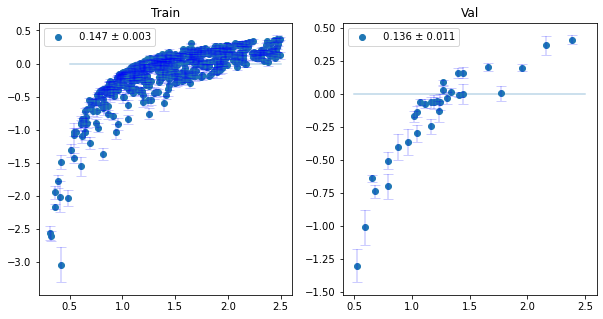

71/71 [==============================] - 101s 1s/step - loss: 0.1319 - val_loss: 0.1596
Epoch 331/1000
71/71 [==============================] - ETA: 0s - loss: 0.1323

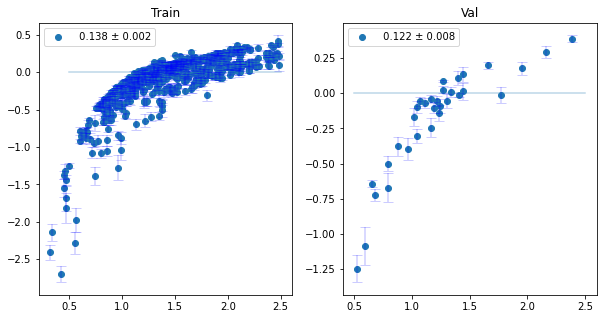

71/71 [==============================] - 101s 1s/step - loss: 0.1323 - val_loss: 0.1603
Epoch 332/1000
71/71 [==============================] - ETA: 0s - loss: 0.1315

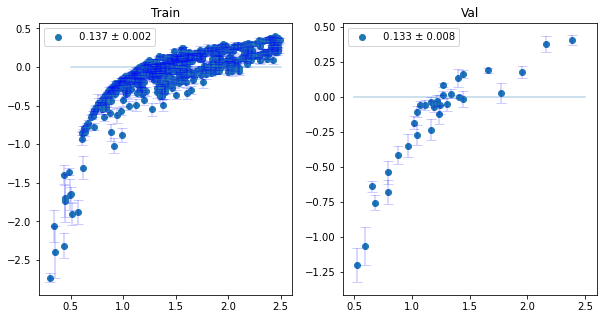

71/71 [==============================] - 101s 1s/step - loss: 0.1315 - val_loss: 0.1632
Epoch 333/1000
71/71 [==============================] - ETA: 0s - loss: 0.1317

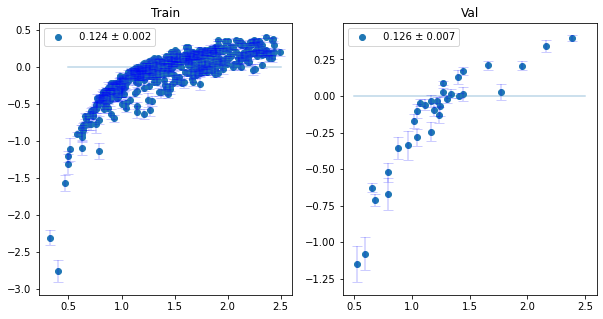

71/71 [==============================] - 101s 1s/step - loss: 0.1317 - val_loss: 0.1470
Epoch 334/1000
71/71 [==============================] - ETA: 0s - loss: 0.1313

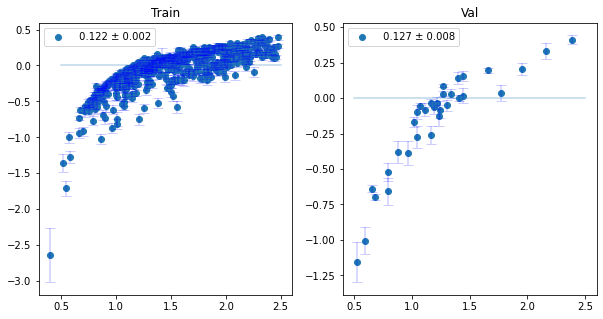

71/71 [==============================] - 101s 1s/step - loss: 0.1313 - val_loss: 0.1510
Epoch 335/1000
71/71 [==============================] - ETA: 0s - loss: 0.1318

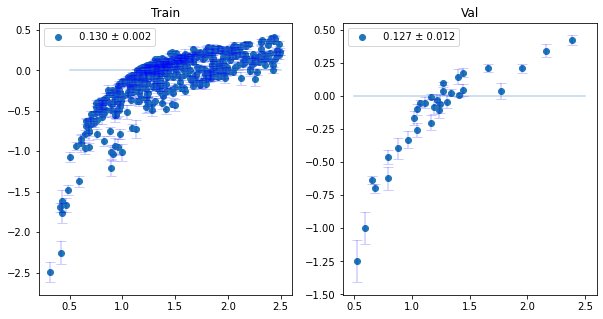

71/71 [==============================] - 101s 1s/step - loss: 0.1318 - val_loss: 0.1548
Epoch 336/1000
71/71 [==============================] - ETA: 0s - loss: 0.1319

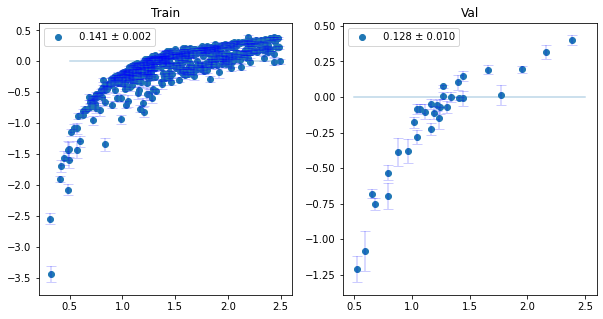

71/71 [==============================] - 100s 1s/step - loss: 0.1319 - val_loss: 0.1427
Epoch 337/1000
71/71 [==============================] - ETA: 0s - loss: 0.1315

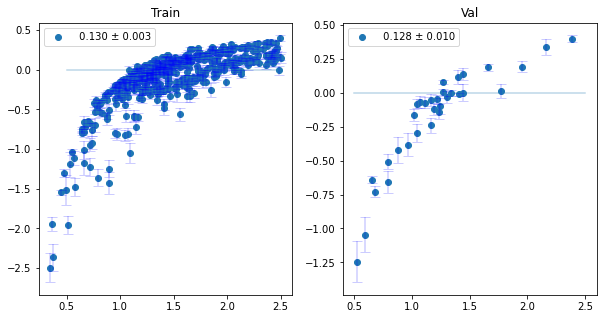

71/71 [==============================] - 100s 1s/step - loss: 0.1315 - val_loss: 0.1575
Epoch 338/1000
71/71 [==============================] - ETA: 0s - loss: 0.1318

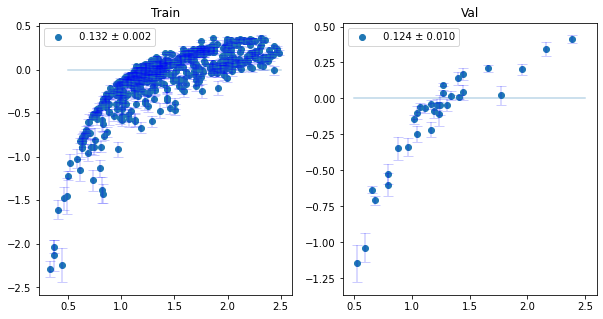

71/71 [==============================] - 100s 1s/step - loss: 0.1318 - val_loss: 0.1481
Epoch 339/1000
71/71 [==============================] - ETA: 0s - loss: 0.1315

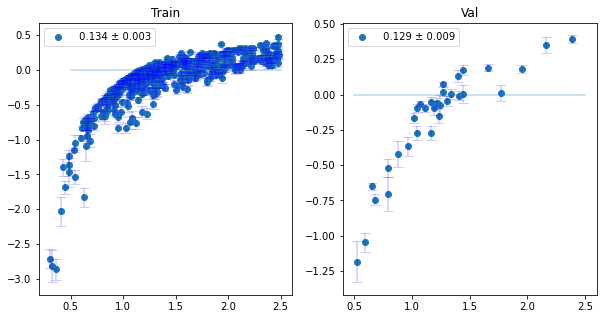

71/71 [==============================] - 100s 1s/step - loss: 0.1315 - val_loss: 0.1522
Epoch 340/1000
71/71 [==============================] - ETA: 0s - loss: 0.1312

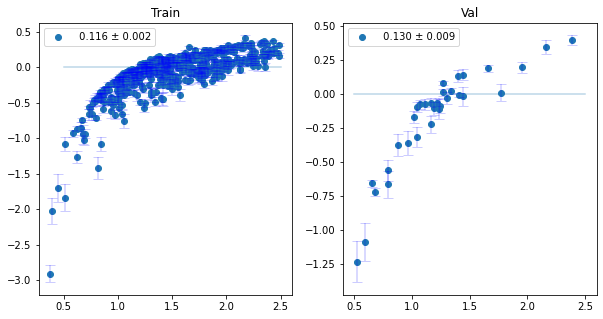

71/71 [==============================] - 102s 1s/step - loss: 0.1312 - val_loss: 0.1653
Epoch 341/1000
71/71 [==============================] - ETA: 0s - loss: 0.1307

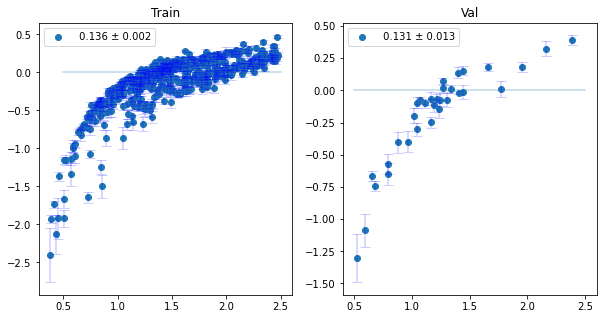

71/71 [==============================] - 101s 1s/step - loss: 0.1307 - val_loss: 0.1633
Epoch 342/1000
71/71 [==============================] - ETA: 0s - loss: 0.1312

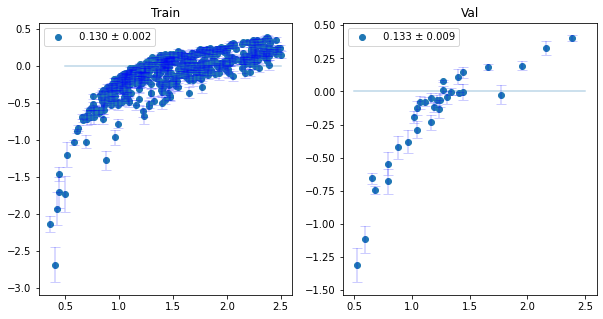

71/71 [==============================] - 100s 1s/step - loss: 0.1312 - val_loss: 0.1475
Epoch 343/1000
71/71 [==============================] - ETA: 0s - loss: 0.1306

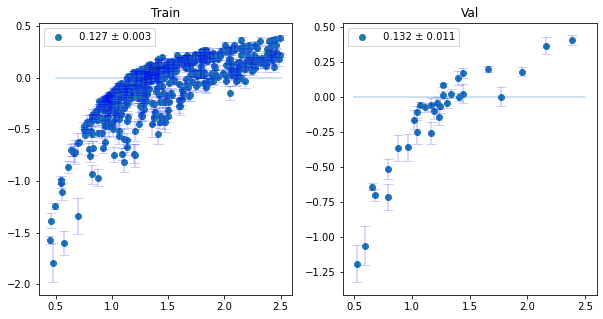

71/71 [==============================] - 100s 1s/step - loss: 0.1306 - val_loss: 0.1660
Epoch 344/1000
71/71 [==============================] - ETA: 0s - loss: 0.1309

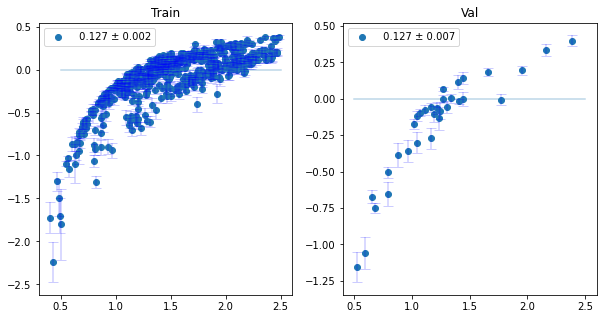

71/71 [==============================] - 101s 1s/step - loss: 0.1309 - val_loss: 0.1445
Epoch 345/1000
71/71 [==============================] - ETA: 0s - loss: 0.1316

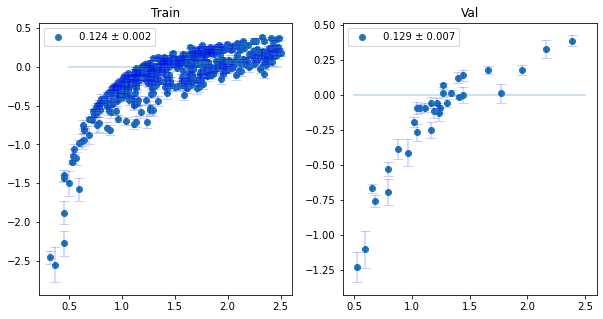

71/71 [==============================] - 101s 1s/step - loss: 0.1316 - val_loss: 0.1319
Epoch 346/1000
71/71 [==============================] - ETA: 0s - loss: 0.1311

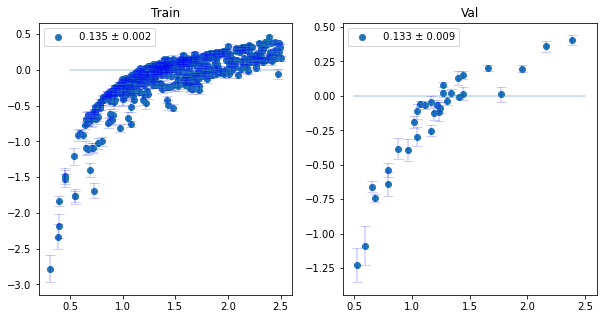

71/71 [==============================] - 100s 1s/step - loss: 0.1311 - val_loss: 0.1562
Epoch 347/1000
71/71 [==============================] - ETA: 0s - loss: 0.1304

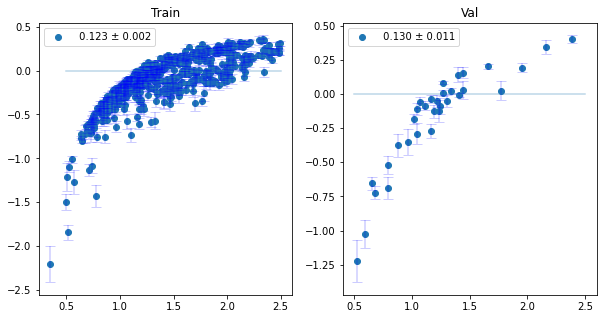

71/71 [==============================] - 101s 1s/step - loss: 0.1304 - val_loss: 0.1626
Epoch 348/1000
71/71 [==============================] - ETA: 0s - loss: 0.1308

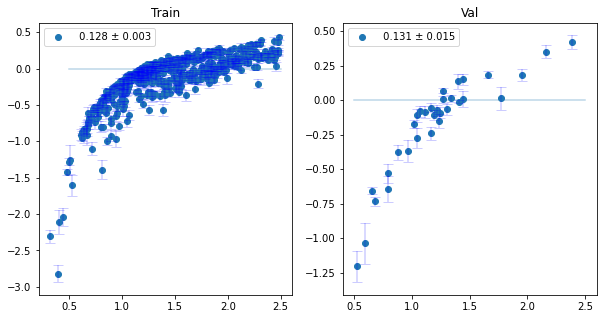

71/71 [==============================] - 101s 1s/step - loss: 0.1308 - val_loss: 0.1630
Epoch 349/1000
71/71 [==============================] - ETA: 0s - loss: 0.1315

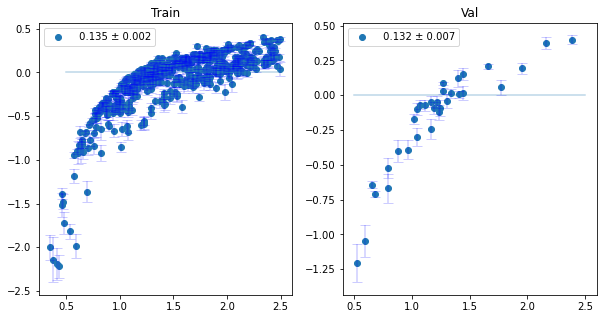

71/71 [==============================] - 100s 1s/step - loss: 0.1315 - val_loss: 0.1425
Epoch 350/1000
71/71 [==============================] - ETA: 0s - loss: 0.1312

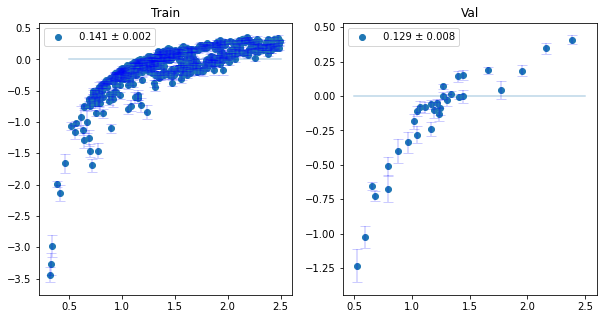

71/71 [==============================] - 100s 1s/step - loss: 0.1312 - val_loss: 0.1554
Epoch 351/1000
71/71 [==============================] - ETA: 0s - loss: 0.1303

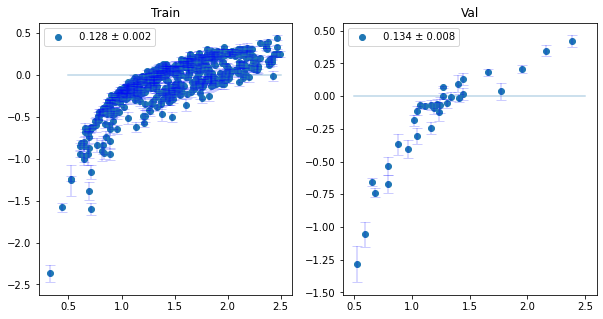

71/71 [==============================] - 101s 1s/step - loss: 0.1303 - val_loss: 0.1599
Epoch 352/1000
71/71 [==============================] - ETA: 0s - loss: 0.1306

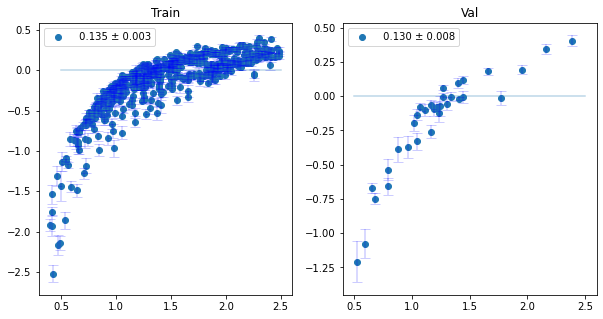

71/71 [==============================] - 100s 1s/step - loss: 0.1306 - val_loss: 0.1555
Epoch 353/1000
71/71 [==============================] - ETA: 0s - loss: 0.1303

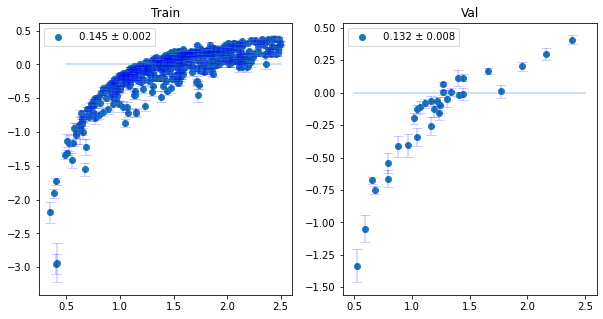

71/71 [==============================] - 100s 1s/step - loss: 0.1303 - val_loss: 0.1621
Epoch 354/1000
71/71 [==============================] - ETA: 0s - loss: 0.1307

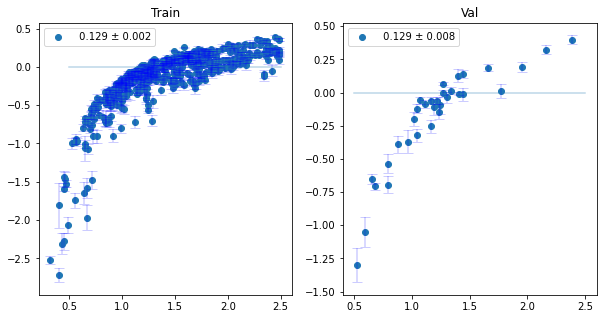

71/71 [==============================] - 101s 1s/step - loss: 0.1307 - val_loss: 0.1679
Epoch 355/1000
71/71 [==============================] - ETA: 0s - loss: 0.1308

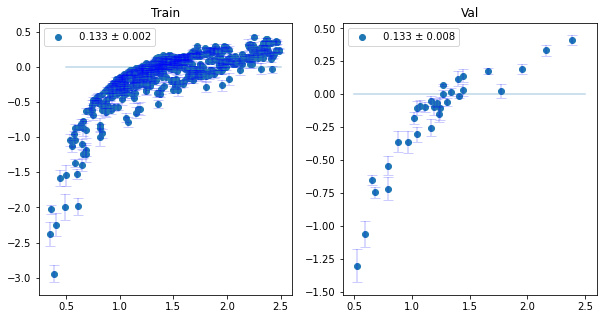

71/71 [==============================] - 101s 1s/step - loss: 0.1308 - val_loss: 0.1538
Epoch 356/1000
71/71 [==============================] - ETA: 0s - loss: 0.1298

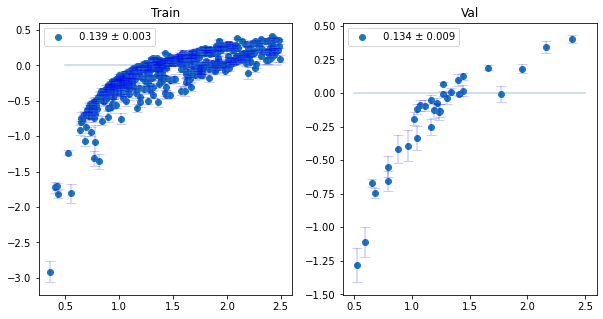

71/71 [==============================] - 102s 1s/step - loss: 0.1298 - val_loss: 0.1515
Epoch 357/1000
71/71 [==============================] - ETA: 0s - loss: 0.1298

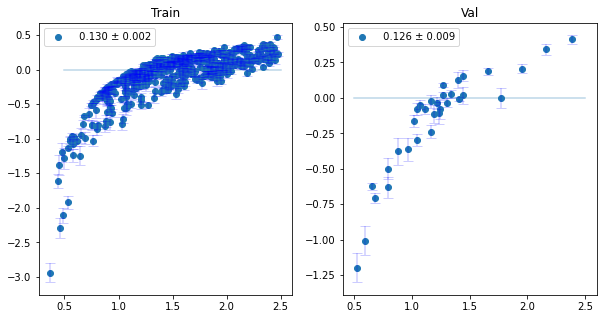

71/71 [==============================] - 101s 1s/step - loss: 0.1298 - val_loss: 0.1671
Epoch 358/1000
71/71 [==============================] - ETA: 0s - loss: 0.1300

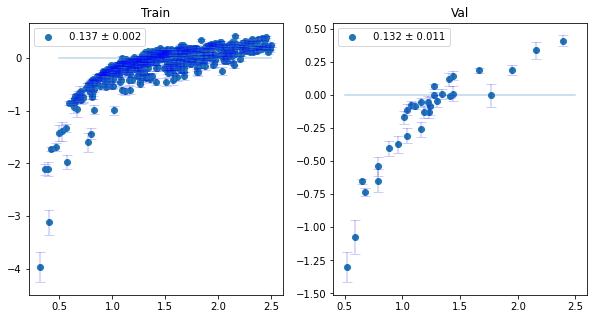

71/71 [==============================] - 101s 1s/step - loss: 0.1300 - val_loss: 0.1465
Epoch 359/1000
71/71 [==============================] - ETA: 0s - loss: 0.1291

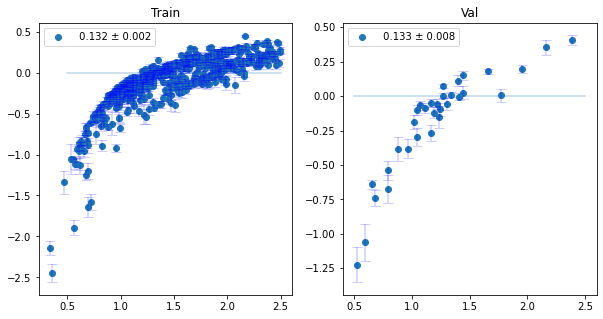

71/71 [==============================] - 100s 1s/step - loss: 0.1291 - val_loss: 0.1653
Epoch 360/1000
71/71 [==============================] - ETA: 0s - loss: 0.1302

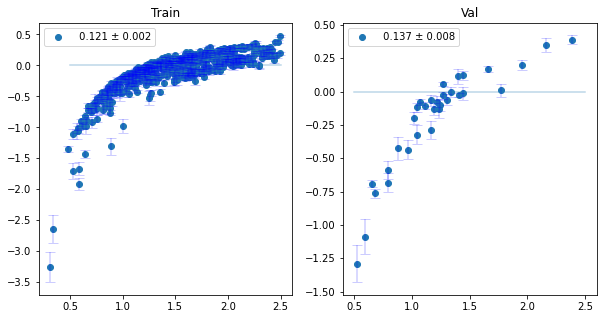

71/71 [==============================] - 101s 1s/step - loss: 0.1302 - val_loss: 0.1642
Epoch 361/1000
71/71 [==============================] - ETA: 0s - loss: 0.1301

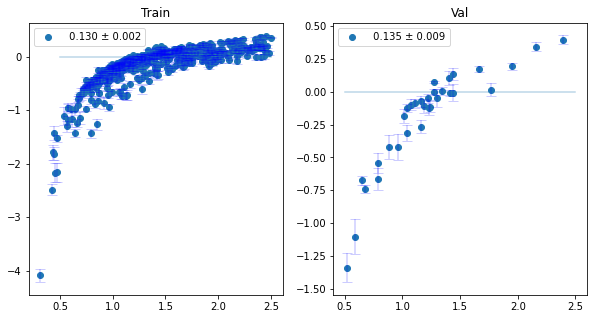

71/71 [==============================] - 101s 1s/step - loss: 0.1301 - val_loss: 0.1432
Epoch 362/1000
71/71 [==============================] - ETA: 0s - loss: 0.1291

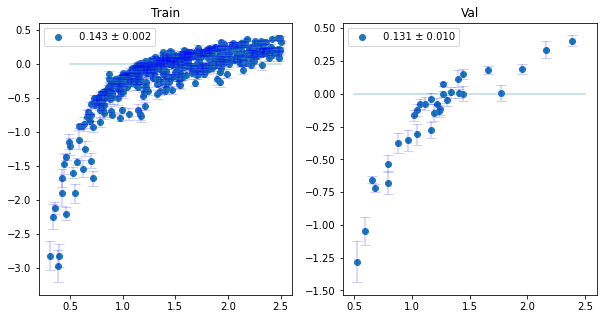

71/71 [==============================] - 101s 1s/step - loss: 0.1291 - val_loss: 0.1579
Epoch 363/1000
71/71 [==============================] - ETA: 0s - loss: 0.1293

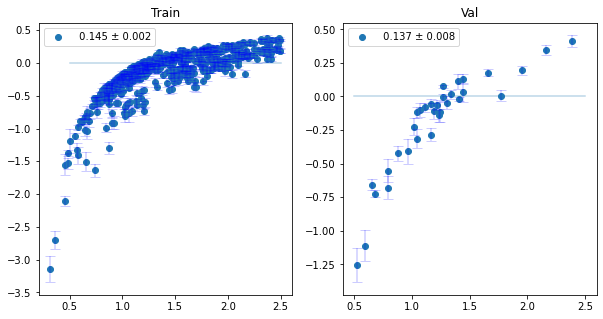

71/71 [==============================] - 100s 1s/step - loss: 0.1293 - val_loss: 0.1461
Epoch 364/1000
71/71 [==============================] - ETA: 0s - loss: 0.1292

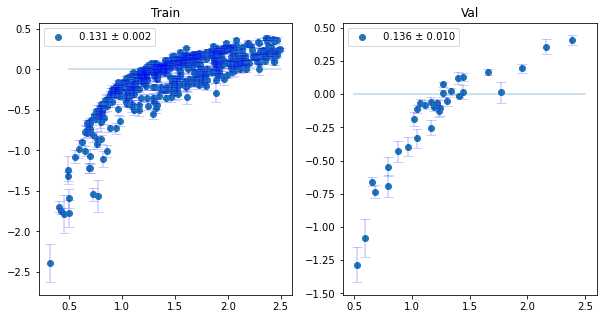

71/71 [==============================] - 101s 1s/step - loss: 0.1292 - val_loss: 0.1583
Epoch 365/1000
71/71 [==============================] - ETA: 0s - loss: 0.1289

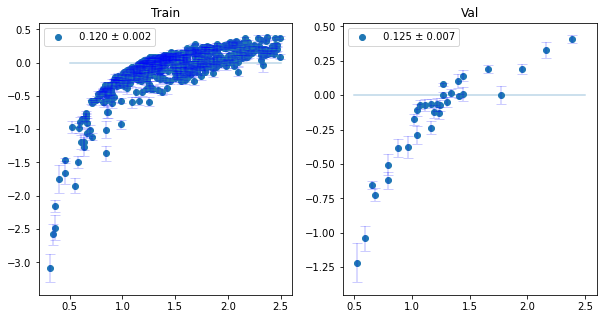

71/71 [==============================] - 100s 1s/step - loss: 0.1289 - val_loss: 0.1605
Epoch 366/1000
71/71 [==============================] - ETA: 0s - loss: 0.1297

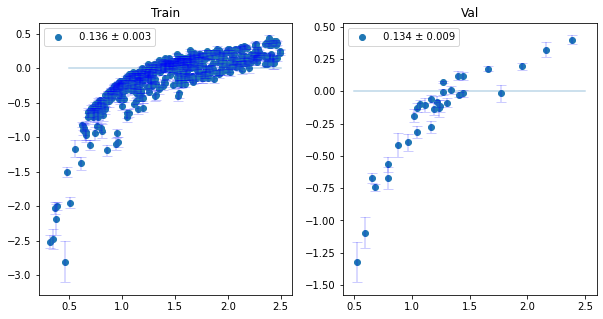

71/71 [==============================] - 100s 1s/step - loss: 0.1297 - val_loss: 0.1612
Epoch 367/1000
71/71 [==============================] - ETA: 0s - loss: 0.1287

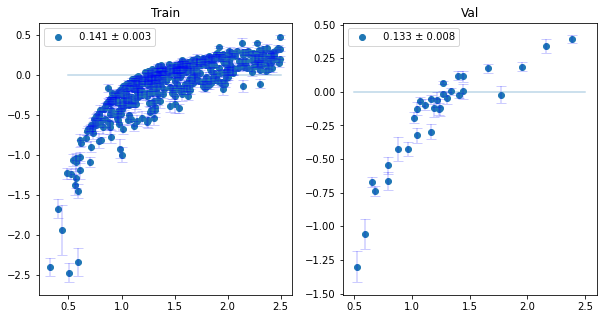

71/71 [==============================] - 101s 1s/step - loss: 0.1287 - val_loss: 0.1448
Epoch 368/1000
71/71 [==============================] - ETA: 0s - loss: 0.1289

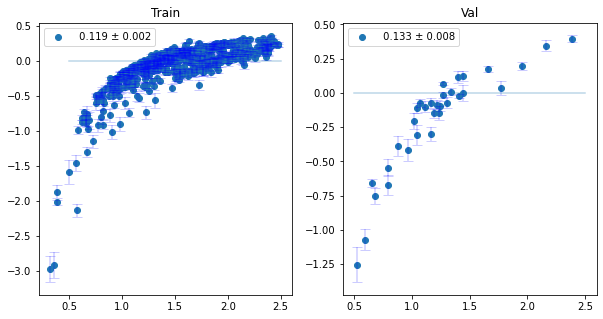

71/71 [==============================] - 101s 1s/step - loss: 0.1289 - val_loss: 0.1509
Epoch 369/1000
71/71 [==============================] - ETA: 0s - loss: 0.1293

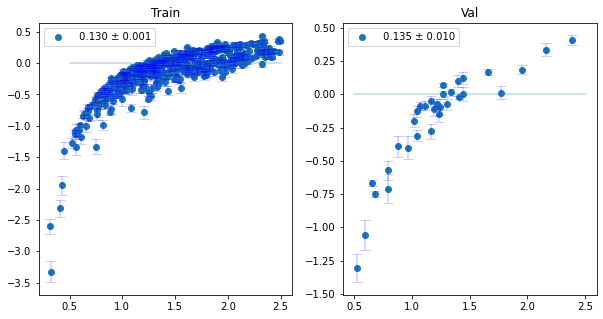

71/71 [==============================] - 102s 1s/step - loss: 0.1293 - val_loss: 0.1581
Epoch 370/1000
71/71 [==============================] - ETA: 0s - loss: 0.1289

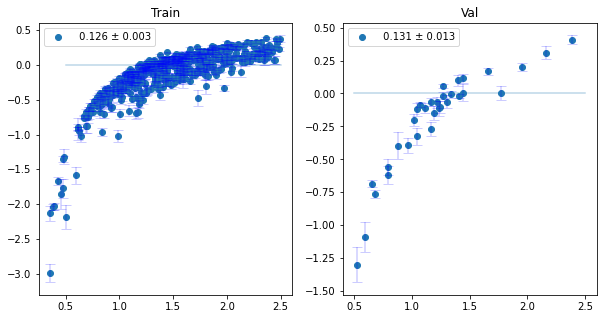

71/71 [==============================] - 100s 1s/step - loss: 0.1289 - val_loss: 0.1464
Epoch 371/1000
71/71 [==============================] - ETA: 0s - loss: 0.1285

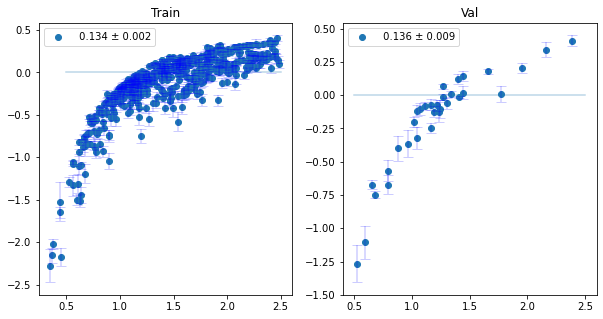

71/71 [==============================] - 101s 1s/step - loss: 0.1285 - val_loss: 0.1673
Epoch 372/1000
71/71 [==============================] - ETA: 0s - loss: 0.1282

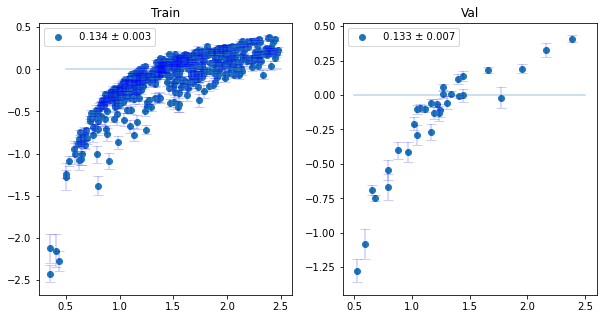

71/71 [==============================] - 100s 1s/step - loss: 0.1282 - val_loss: 0.1503
Epoch 373/1000
71/71 [==============================] - ETA: 0s - loss: 0.1284

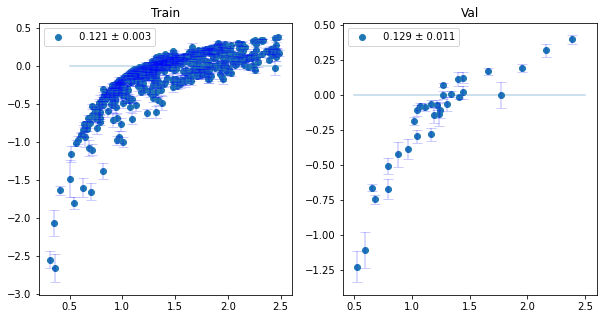

71/71 [==============================] - 101s 1s/step - loss: 0.1284 - val_loss: 0.1744
Epoch 374/1000
71/71 [==============================] - ETA: 0s - loss: 0.1285

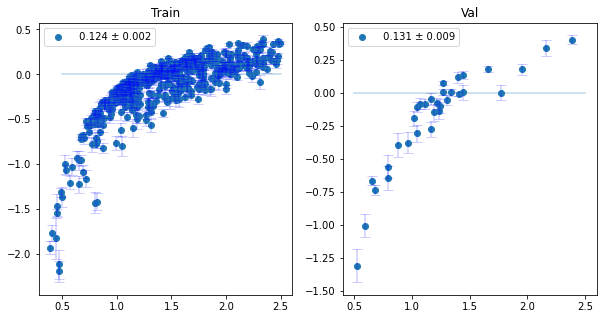

71/71 [==============================] - 102s 1s/step - loss: 0.1285 - val_loss: 0.1444
Epoch 375/1000
71/71 [==============================] - ETA: 0s - loss: 0.1281

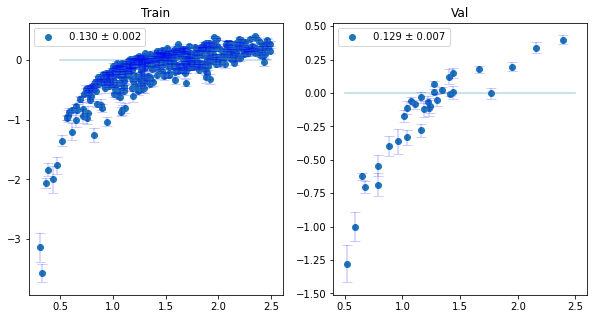

71/71 [==============================] - 102s 1s/step - loss: 0.1281 - val_loss: 0.1464
Epoch 376/1000
71/71 [==============================] - ETA: 0s - loss: 0.1277

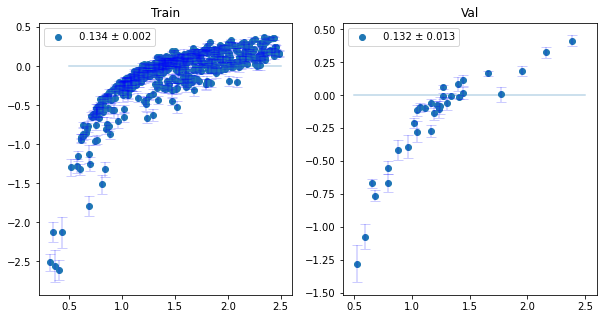

71/71 [==============================] - 100s 1s/step - loss: 0.1277 - val_loss: 0.1455
Epoch 377/1000
71/71 [==============================] - ETA: 0s - loss: 0.1275

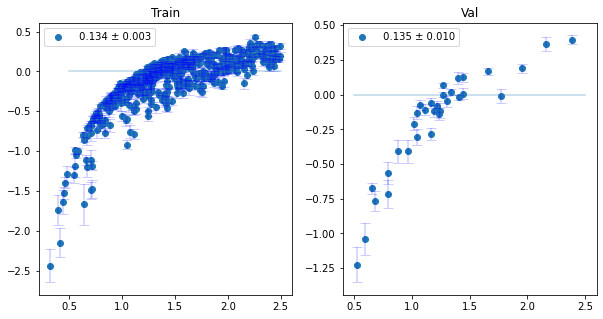

71/71 [==============================] - 100s 1s/step - loss: 0.1275 - val_loss: 0.1401
Epoch 378/1000
71/71 [==============================] - ETA: 0s - loss: 0.1289

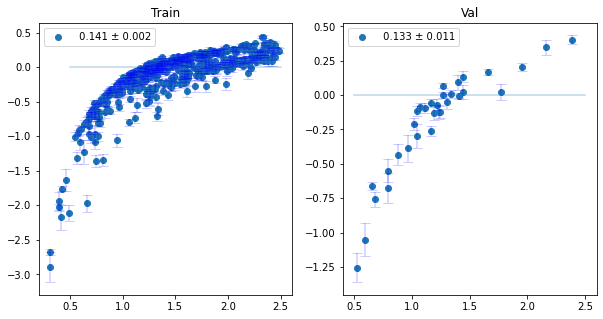

71/71 [==============================] - 101s 1s/step - loss: 0.1289 - val_loss: 0.1387
Epoch 379/1000
71/71 [==============================] - ETA: 0s - loss: 0.1285

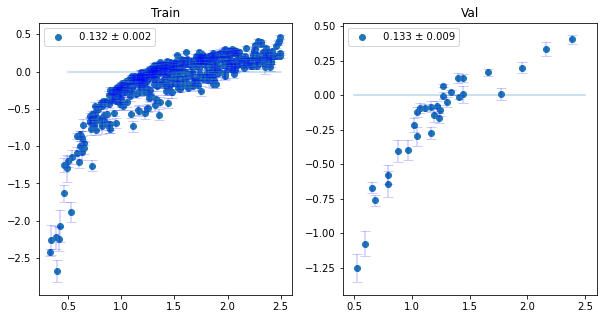

71/71 [==============================] - 101s 1s/step - loss: 0.1285 - val_loss: 0.1571
Epoch 380/1000
71/71 [==============================] - ETA: 0s - loss: 0.1282

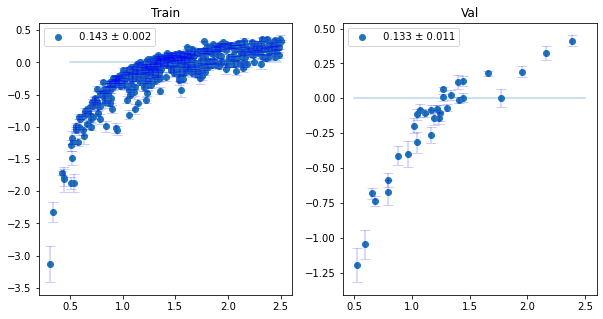

71/71 [==============================] - 101s 1s/step - loss: 0.1282 - val_loss: 0.1501
Epoch 381/1000
71/71 [==============================] - ETA: 0s - loss: 0.1277

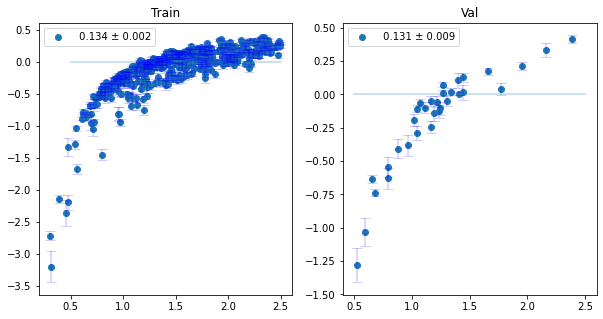

71/71 [==============================] - 101s 1s/step - loss: 0.1277 - val_loss: 0.1581
Epoch 382/1000
71/71 [==============================] - ETA: 0s - loss: 0.1286

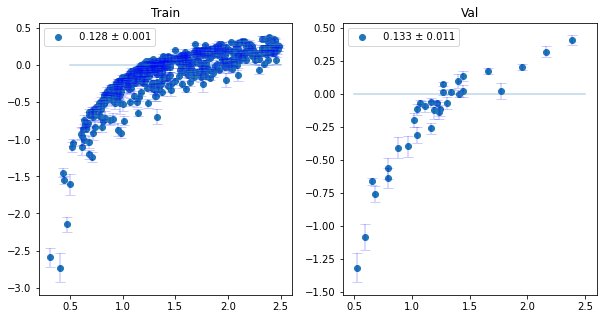

71/71 [==============================] - 101s 1s/step - loss: 0.1286 - val_loss: 0.1597
Epoch 383/1000
71/71 [==============================] - ETA: 0s - loss: 0.1288

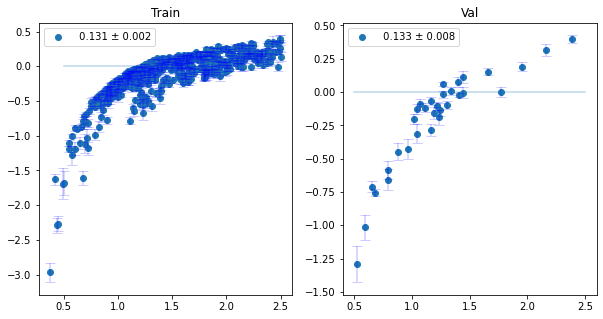

71/71 [==============================] - 101s 1s/step - loss: 0.1288 - val_loss: 0.1657
Epoch 384/1000
71/71 [==============================] - ETA: 0s - loss: 0.1285

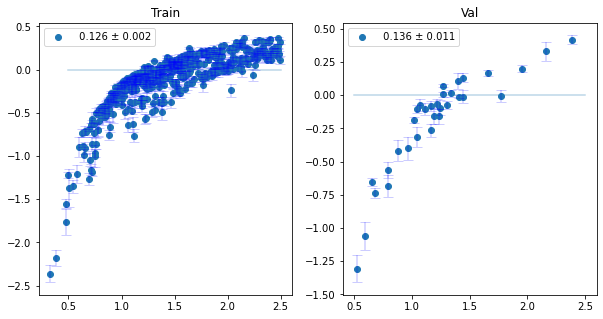

71/71 [==============================] - 101s 1s/step - loss: 0.1285 - val_loss: 0.1670
Epoch 385/1000
71/71 [==============================] - ETA: 0s - loss: 0.1280

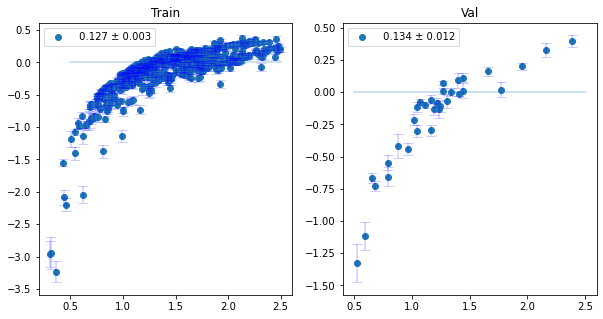

71/71 [==============================] - 101s 1s/step - loss: 0.1280 - val_loss: 0.1527
Epoch 386/1000
71/71 [==============================] - ETA: 0s - loss: 0.1278

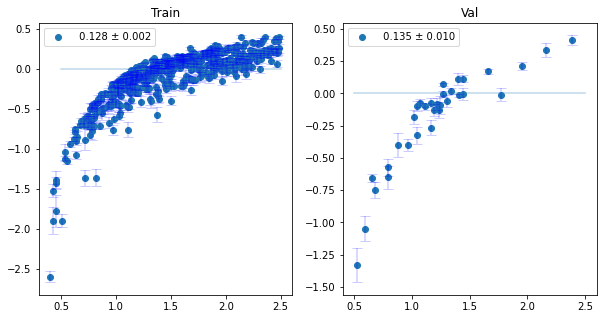

71/71 [==============================] - 100s 1s/step - loss: 0.1278 - val_loss: 0.1590
Epoch 387/1000
71/71 [==============================] - ETA: 0s - loss: 0.1279

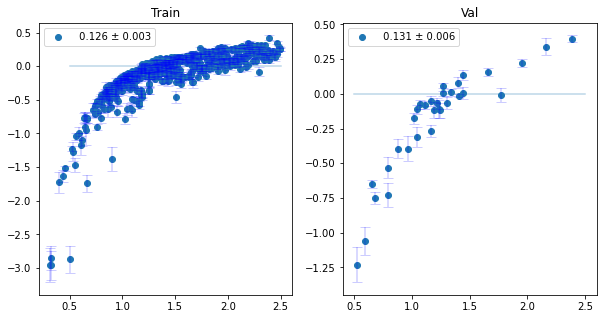

71/71 [==============================] - 101s 1s/step - loss: 0.1279 - val_loss: 0.1426
Epoch 388/1000
71/71 [==============================] - ETA: 0s - loss: 0.1283

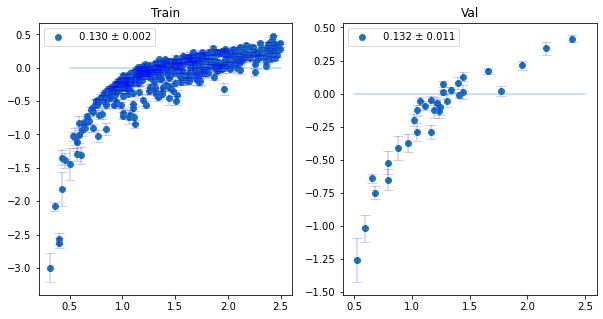

71/71 [==============================] - 100s 1s/step - loss: 0.1283 - val_loss: 0.1485
Epoch 389/1000
71/71 [==============================] - ETA: 0s - loss: 0.1272

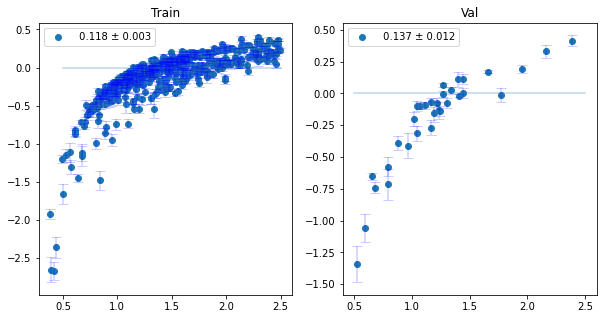

71/71 [==============================] - 102s 1s/step - loss: 0.1272 - val_loss: 0.1700
Epoch 390/1000
71/71 [==============================] - ETA: 0s - loss: 0.1271

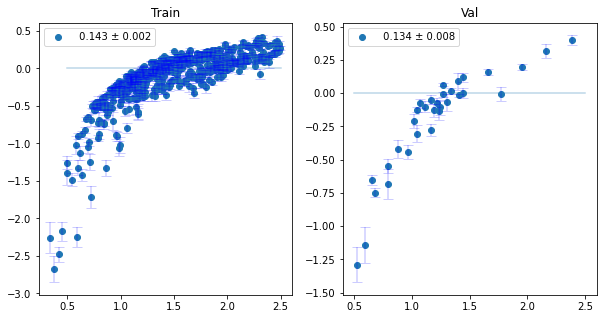

71/71 [==============================] - 101s 1s/step - loss: 0.1271 - val_loss: 0.1938
Epoch 391/1000
71/71 [==============================] - ETA: 0s - loss: 0.1275

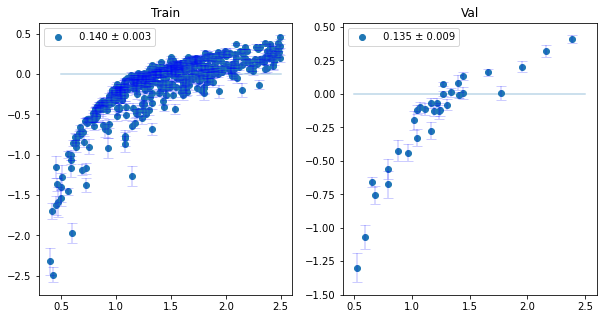

71/71 [==============================] - 101s 1s/step - loss: 0.1275 - val_loss: 0.1580
Epoch 392/1000
71/71 [==============================] - ETA: 0s - loss: 0.1277

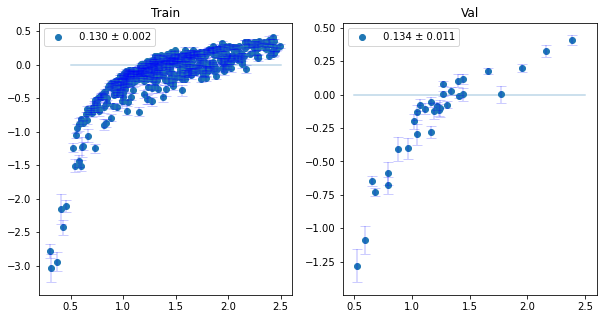

71/71 [==============================] - 102s 1s/step - loss: 0.1277 - val_loss: 0.1653
Epoch 393/1000
71/71 [==============================] - ETA: 0s - loss: 0.1278

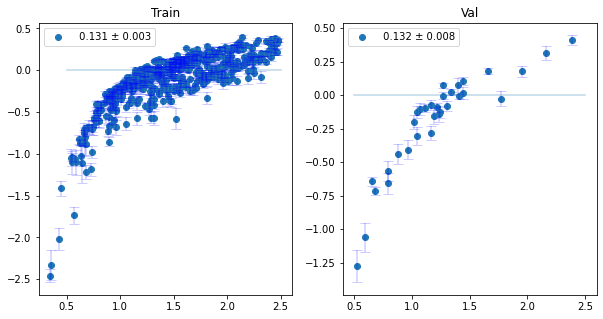

71/71 [==============================] - 101s 1s/step - loss: 0.1278 - val_loss: 0.1638
Epoch 394/1000
71/71 [==============================] - ETA: 0s - loss: 0.1271

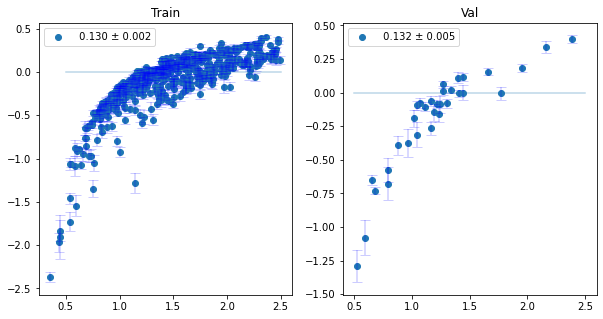

71/71 [==============================] - 101s 1s/step - loss: 0.1271 - val_loss: 0.1654
Epoch 395/1000
71/71 [==============================] - ETA: 0s - loss: 0.1266

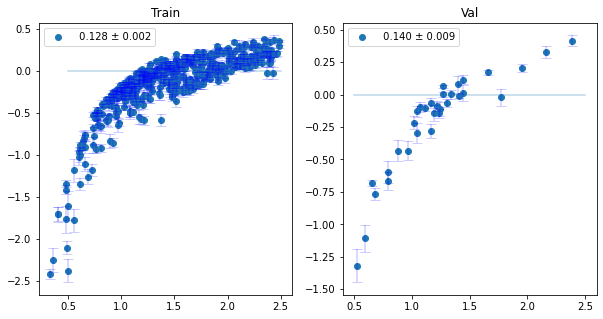

71/71 [==============================] - 100s 1s/step - loss: 0.1266 - val_loss: 0.1558
Epoch 396/1000
71/71 [==============================] - ETA: 0s - loss: 0.1270

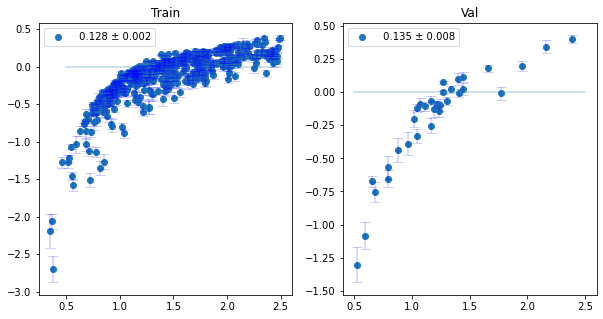

71/71 [==============================] - 101s 1s/step - loss: 0.1270 - val_loss: 0.1615
Epoch 397/1000
71/71 [==============================] - ETA: 0s - loss: 0.1262

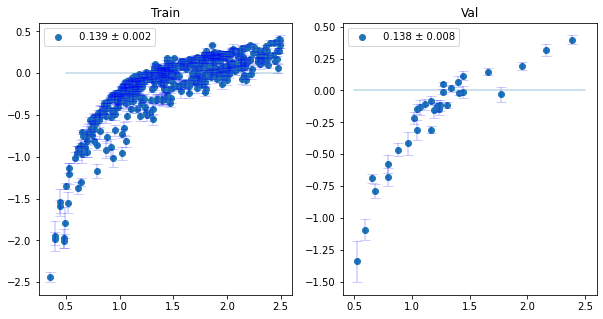

71/71 [==============================] - 101s 1s/step - loss: 0.1262 - val_loss: 0.1623
Epoch 398/1000
71/71 [==============================] - ETA: 0s - loss: 0.1268

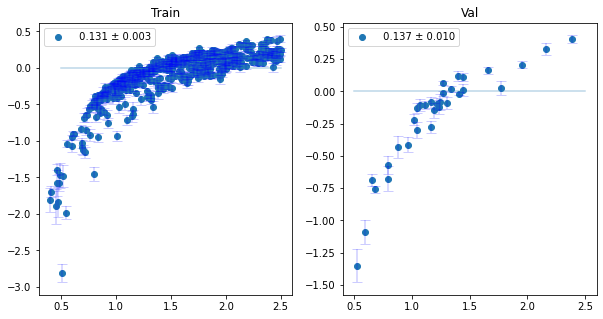

71/71 [==============================] - 101s 1s/step - loss: 0.1268 - val_loss: 0.1625
Epoch 399/1000
71/71 [==============================] - ETA: 0s - loss: 0.1268

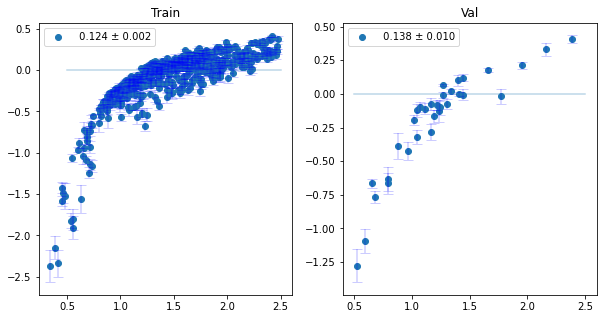

71/71 [==============================] - 102s 1s/step - loss: 0.1268 - val_loss: 0.1495
Epoch 400/1000
71/71 [==============================] - ETA: 0s - loss: 0.1270

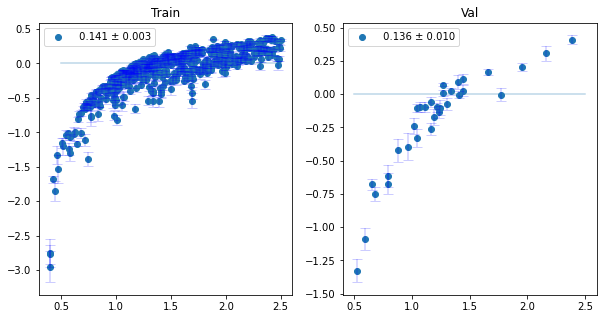

71/71 [==============================] - 100s 1s/step - loss: 0.1270 - val_loss: 0.1464
Epoch 401/1000
71/71 [==============================] - ETA: 0s - loss: 0.1262

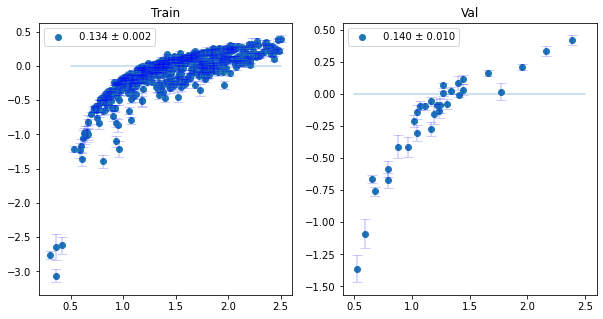

71/71 [==============================] - 101s 1s/step - loss: 0.1262 - val_loss: 0.1589
Epoch 402/1000
71/71 [==============================] - ETA: 0s - loss: 0.1262

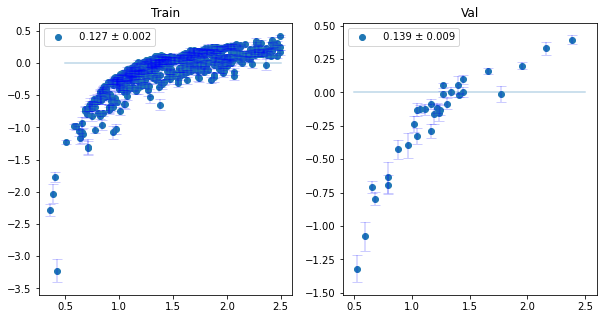

71/71 [==============================] - 101s 1s/step - loss: 0.1262 - val_loss: 0.1647
Epoch 403/1000
71/71 [==============================] - ETA: 0s - loss: 0.1267

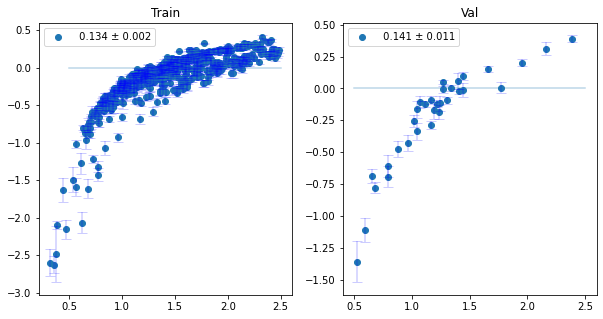

71/71 [==============================] - 101s 1s/step - loss: 0.1267 - val_loss: 0.1477
Epoch 404/1000
71/71 [==============================] - ETA: 0s - loss: 0.1266

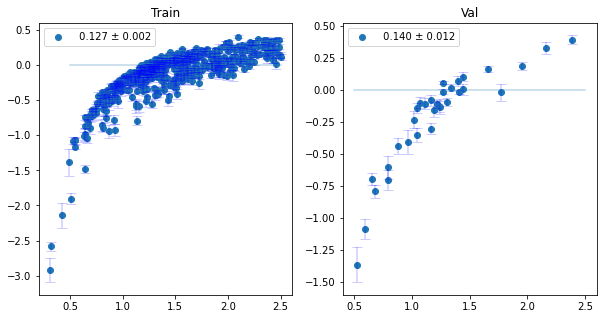

71/71 [==============================] - 101s 1s/step - loss: 0.1266 - val_loss: 0.1482
Epoch 405/1000
71/71 [==============================] - ETA: 0s - loss: 0.1263

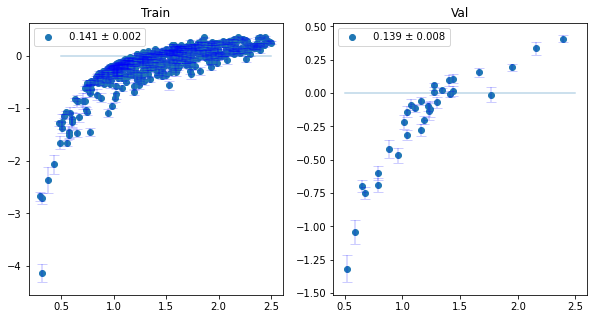

71/71 [==============================] - 101s 1s/step - loss: 0.1263 - val_loss: 0.1491
Epoch 406/1000
53/71 [=====================>........] - ETA: 13s - loss: 0.1255

KeyboardInterrupt: 

In [182]:
globalize(model, batch_size, X_train, Y_train, X_val, Y_val)
model.fit(gen_flow, epochs = 1000, validation_data = (X_val, Y_val), callbacks=[Probabilistic_Dispersion(20)])

In [439]:
import gc
del model
gc.collect()

10004

In [137]:
batch_size = 64*8

### Meta Realm

In [538]:
from tools.models import Maml

In [539]:
inp = ResNet10V2(X_val[0,:,:,:].shape)
y_hat = tf.keras.layers.Dense(1)(inp.layers[-2].output)

model = Maml(inp.input, y_hat)
model.compile(optimizer = optimizer, loss = "mse", run_eagerly=True)

In [540]:

gen = tf.keras.preprocessing.image.ImageDataGenerator(
		#rotation_range=180,
		#zoom_range=0.10,
        #brightness_range = [0.90, 1.10],
        #preprocessing_function = lambda x : tf.add(x, tf.random.normal(shape=tf.shape(x), mean=0.0, stddev=1.0, dtype=tf.float32)),
		#vertical_flip = True,
        #horizontal_flip=True,
		fill_mode="nearest")

gen_flow = gen.flow(X_train, Y_train,  batch_size=batch_size, seed=1)

Epoch 1/300
71/71 [==============================] - ETA: 0s - loss: 0.2990

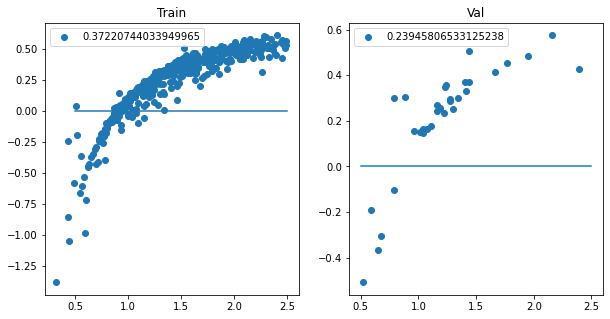

71/71 [==============================] - 27s 380ms/step - loss: 0.2990 - val_loss: 0.2395
Epoch 2/300
71/71 [==============================] - ETA: 0s - loss: 0.0830

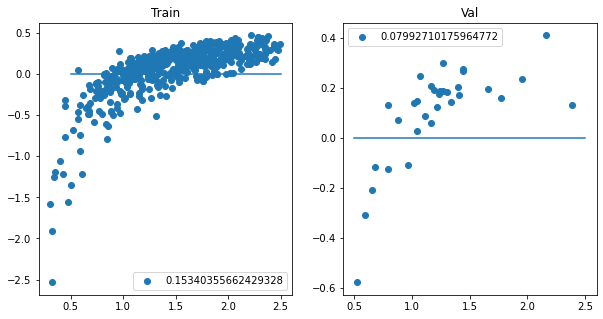

71/71 [==============================] - 27s 377ms/step - loss: 0.0830 - val_loss: 0.0799
Epoch 3/300
71/71 [==============================] - ETA: 0s - loss: 0.0713

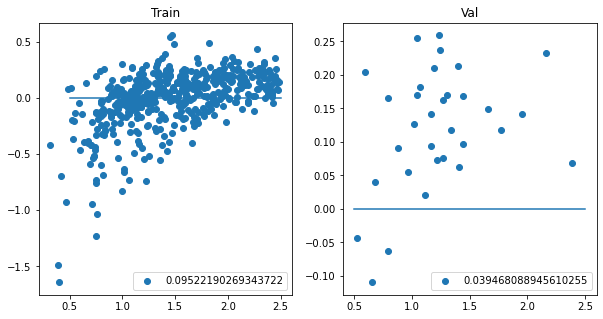

71/71 [==============================] - 27s 380ms/step - loss: 0.0713 - val_loss: 0.0395
Epoch 4/300
71/71 [==============================] - ETA: 0s - loss: 0.0637

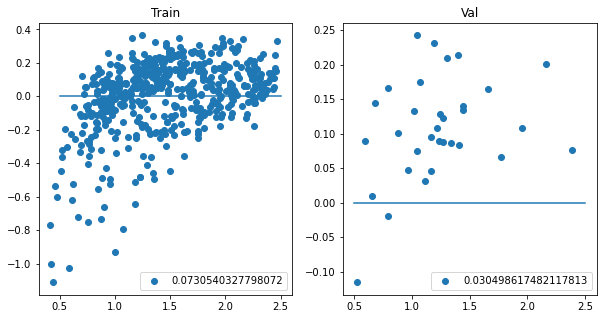

71/71 [==============================] - 29s 415ms/step - loss: 0.0637 - val_loss: 0.0305
Epoch 5/300
71/71 [==============================] - ETA: 0s - loss: 0.0595

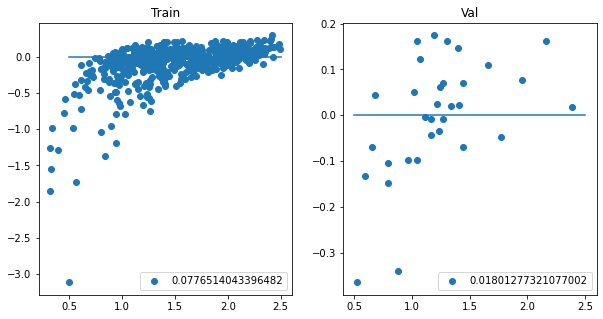

71/71 [==============================] - 27s 384ms/step - loss: 0.0595 - val_loss: 0.0180
Epoch 6/300
71/71 [==============================] - ETA: 0s - loss: 0.0553

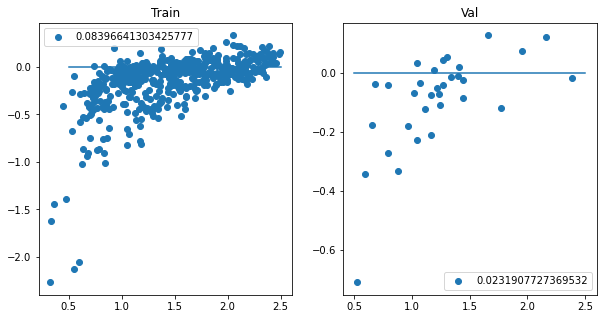

71/71 [==============================] - 27s 386ms/step - loss: 0.0553 - val_loss: 0.0232
Epoch 7/300
71/71 [==============================] - ETA: 0s - loss: 0.0530

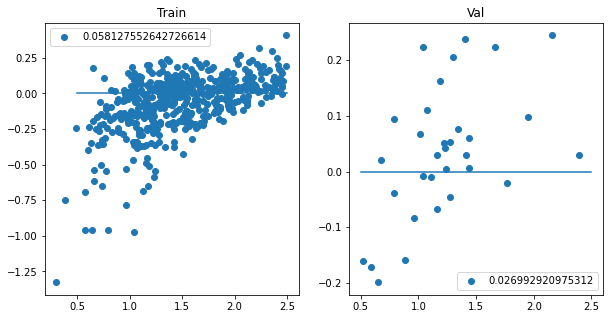

71/71 [==============================] - 27s 383ms/step - loss: 0.0530 - val_loss: 0.0270
Epoch 8/300
71/71 [==============================] - ETA: 0s - loss: 0.0475

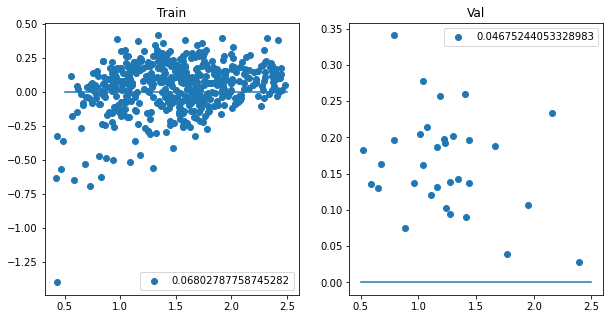

71/71 [==============================] - 27s 387ms/step - loss: 0.0475 - val_loss: 0.0468
Epoch 9/300
71/71 [==============================] - ETA: 0s - loss: 0.0453

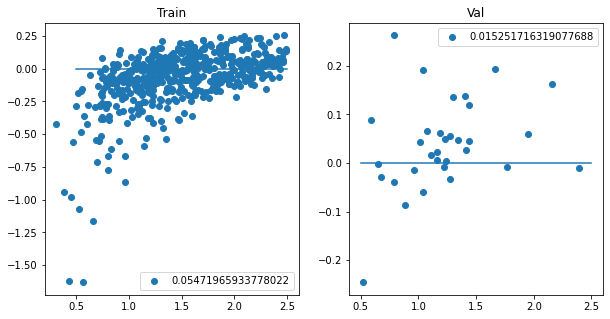

71/71 [==============================] - 27s 386ms/step - loss: 0.0453 - val_loss: 0.0153
Epoch 10/300
71/71 [==============================] - ETA: 0s - loss: 0.0410

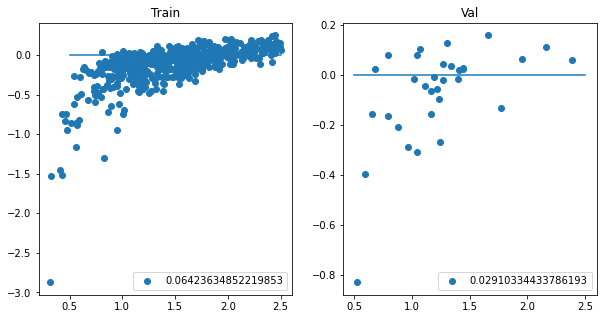

71/71 [==============================] - 28s 390ms/step - loss: 0.0410 - val_loss: 0.0291
Epoch 11/300
71/71 [==============================] - ETA: 0s - loss: 0.0401

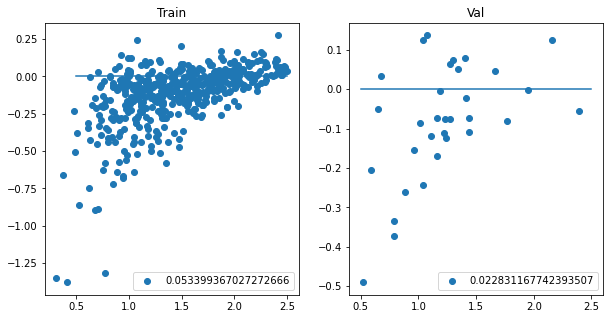

71/71 [==============================] - 27s 384ms/step - loss: 0.0401 - val_loss: 0.0228
Epoch 12/300
71/71 [==============================] - ETA: 0s - loss: 0.0364

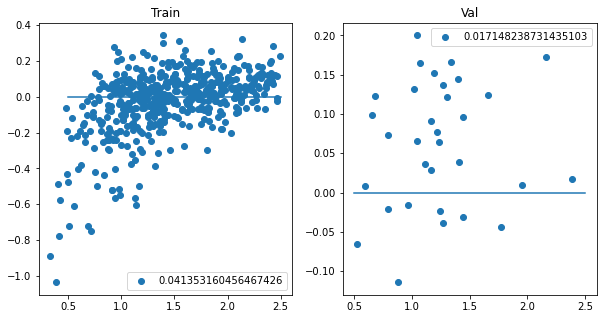

71/71 [==============================] - 28s 391ms/step - loss: 0.0364 - val_loss: 0.0171
Epoch 13/300
71/71 [==============================] - ETA: 0s - loss: 0.0326

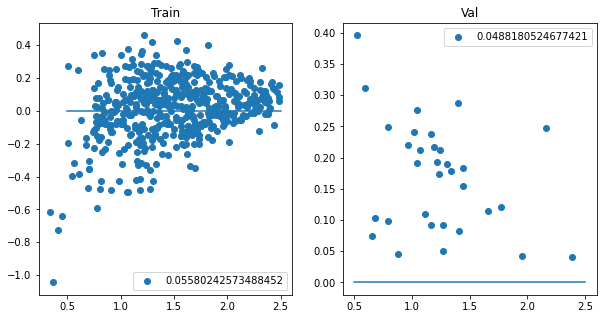

71/71 [==============================] - 27s 385ms/step - loss: 0.0326 - val_loss: 0.0488
Epoch 14/300
71/71 [==============================] - ETA: 0s - loss: 0.0293

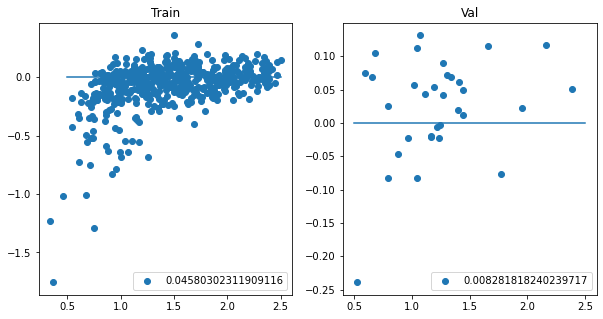

71/71 [==============================] - 27s 387ms/step - loss: 0.0293 - val_loss: 0.0083
Epoch 15/300
71/71 [==============================] - ETA: 0s - loss: 0.0275

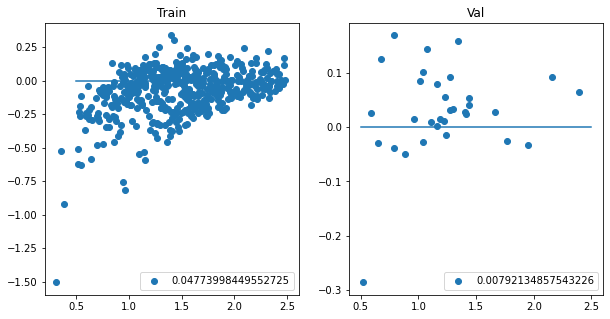

71/71 [==============================] - 29s 410ms/step - loss: 0.0275 - val_loss: 0.0079
Epoch 16/300
71/71 [==============================] - ETA: 0s - loss: 0.0261

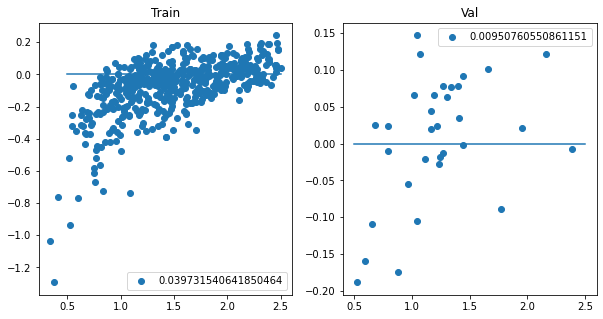

71/71 [==============================] - 28s 392ms/step - loss: 0.0261 - val_loss: 0.0095
Epoch 17/300
71/71 [==============================] - ETA: 0s - loss: 0.0233

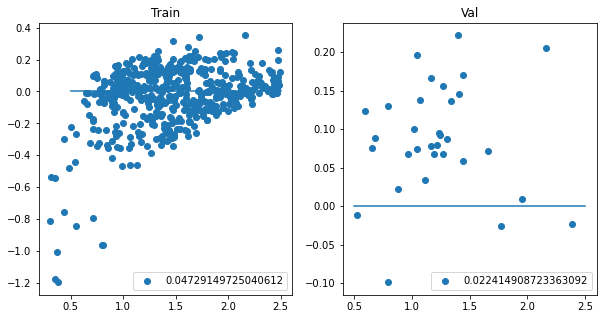

71/71 [==============================] - 27s 380ms/step - loss: 0.0233 - val_loss: 0.0224
Epoch 18/300
71/71 [==============================] - ETA: 0s - loss: 0.0230

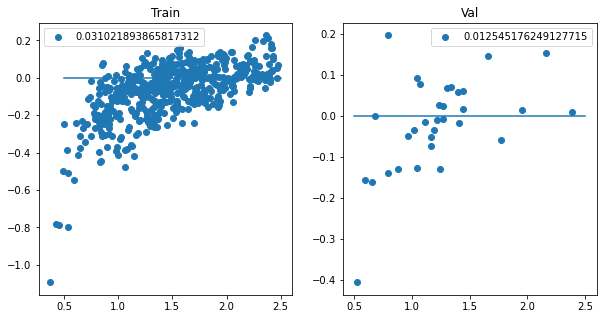

71/71 [==============================] - 27s 384ms/step - loss: 0.0230 - val_loss: 0.0125
Epoch 19/300
71/71 [==============================] - ETA: 0s - loss: 0.0221

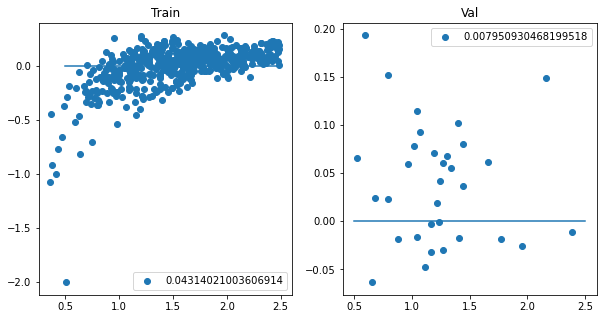

71/71 [==============================] - 28s 392ms/step - loss: 0.0221 - val_loss: 0.0080
Epoch 20/300
71/71 [==============================] - ETA: 0s - loss: 0.0225

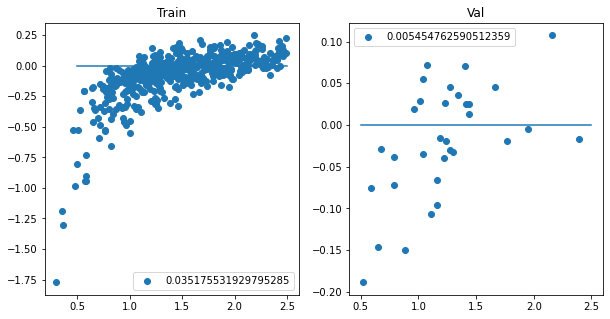

71/71 [==============================] - 28s 389ms/step - loss: 0.0225 - val_loss: 0.0055
Epoch 21/300
71/71 [==============================] - ETA: 0s - loss: 0.0198

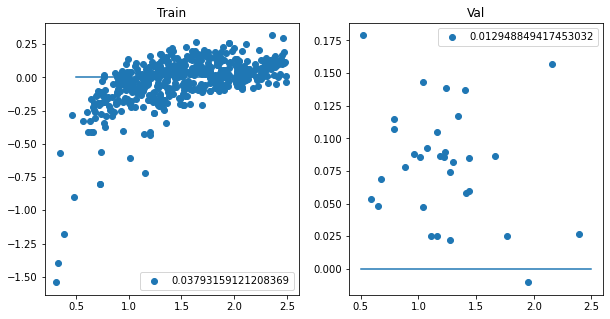

71/71 [==============================] - 28s 391ms/step - loss: 0.0198 - val_loss: 0.0129
Epoch 22/300
71/71 [==============================] - ETA: 0s - loss: 0.0189

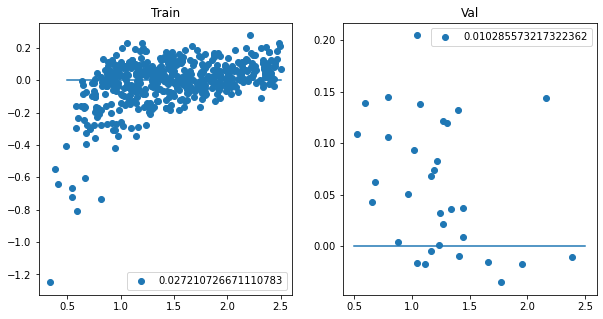

71/71 [==============================] - 28s 394ms/step - loss: 0.0189 - val_loss: 0.0103
Epoch 23/300
71/71 [==============================] - ETA: 0s - loss: 0.0186

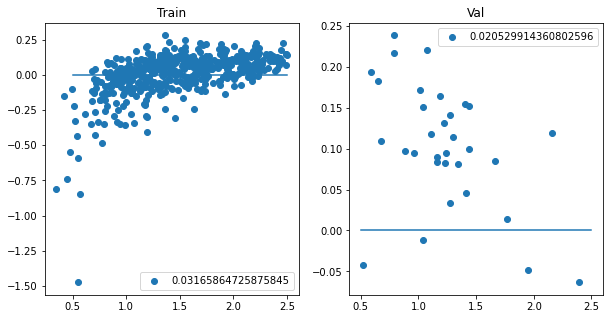

71/71 [==============================] - 28s 395ms/step - loss: 0.0186 - val_loss: 0.0205
Epoch 24/300
71/71 [==============================] - ETA: 0s - loss: 0.0190

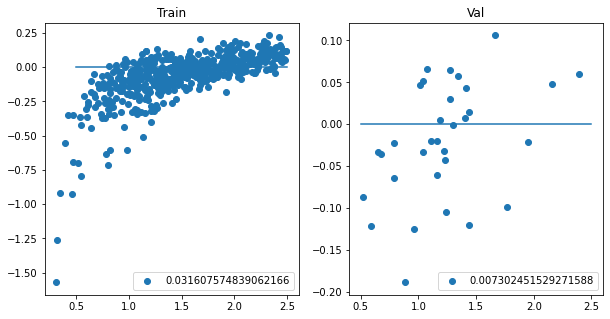

71/71 [==============================] - 28s 391ms/step - loss: 0.0190 - val_loss: 0.0073
Epoch 25/300
71/71 [==============================] - ETA: 0s - loss: 0.0187

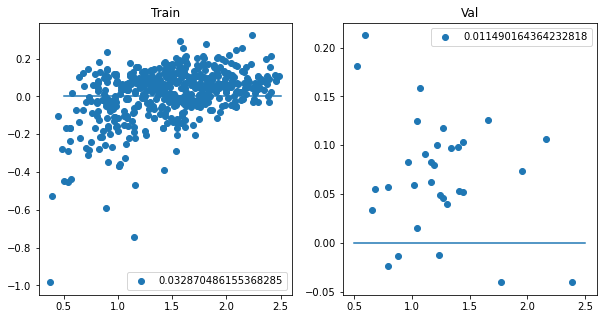

71/71 [==============================] - 27s 385ms/step - loss: 0.0187 - val_loss: 0.0115
Epoch 26/300
71/71 [==============================] - ETA: 0s - loss: 0.0179

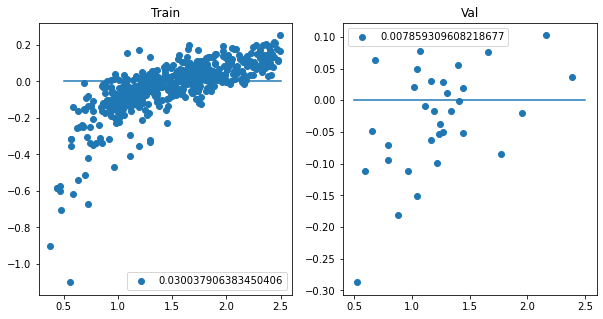

71/71 [==============================] - 28s 398ms/step - loss: 0.0179 - val_loss: 0.0079
Epoch 27/300
71/71 [==============================] - ETA: 0s - loss: 0.0174

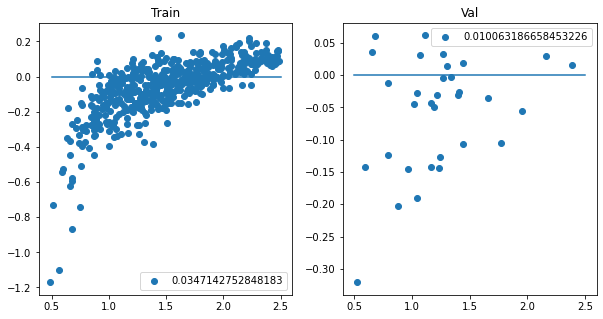

71/71 [==============================] - 30s 418ms/step - loss: 0.0174 - val_loss: 0.0101
Epoch 28/300
71/71 [==============================] - ETA: 0s - loss: 0.0156

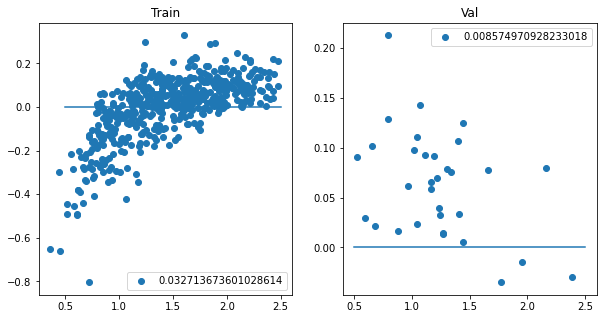

71/71 [==============================] - 28s 388ms/step - loss: 0.0156 - val_loss: 0.0086
Epoch 29/300
71/71 [==============================] - ETA: 0s - loss: 0.0163

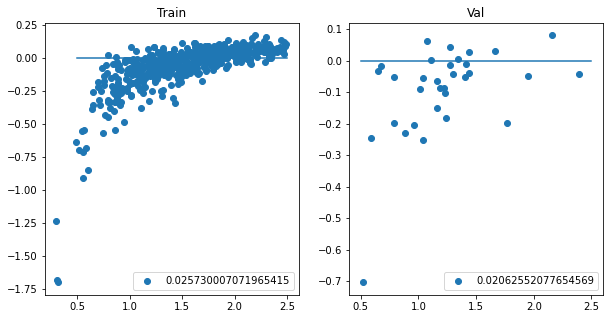

71/71 [==============================] - 28s 395ms/step - loss: 0.0163 - val_loss: 0.0206
Epoch 30/300
71/71 [==============================] - ETA: 0s - loss: 0.0169

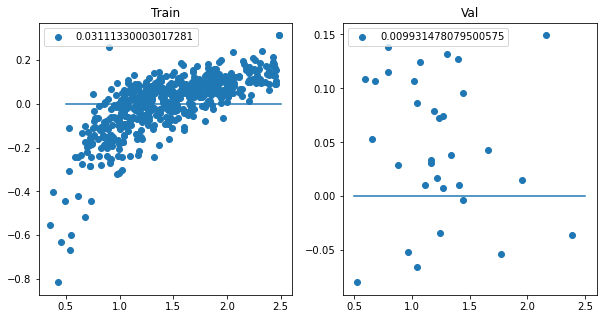

71/71 [==============================] - 28s 388ms/step - loss: 0.0169 - val_loss: 0.0099
Epoch 31/300
71/71 [==============================] - ETA: 0s - loss: 0.0156

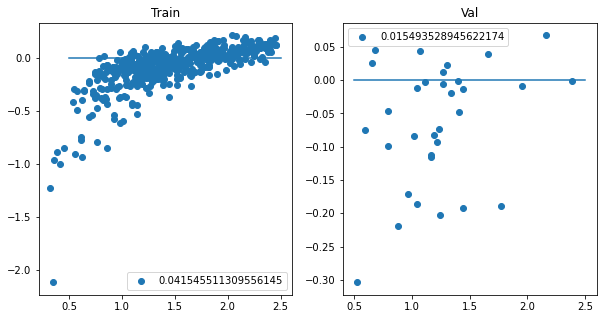

71/71 [==============================] - 27s 385ms/step - loss: 0.0156 - val_loss: 0.0155
Epoch 32/300
71/71 [==============================] - ETA: 0s - loss: 0.0159

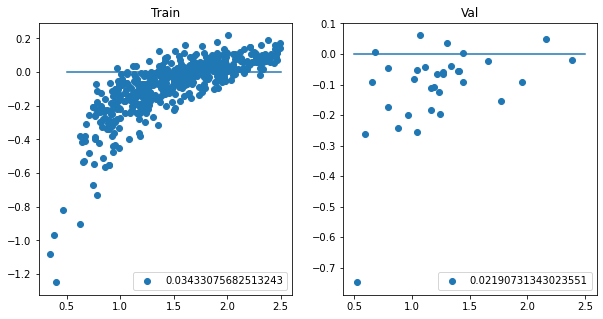

71/71 [==============================] - 27s 385ms/step - loss: 0.0159 - val_loss: 0.0219
Epoch 33/300
71/71 [==============================] - ETA: 0s - loss: 0.0157

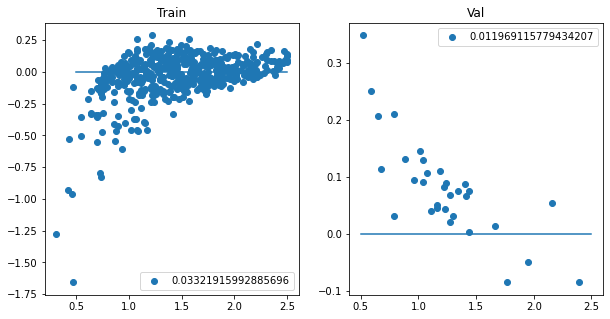

71/71 [==============================] - 27s 385ms/step - loss: 0.0157 - val_loss: 0.0120
Epoch 34/300
71/71 [==============================] - ETA: 0s - loss: 0.0154

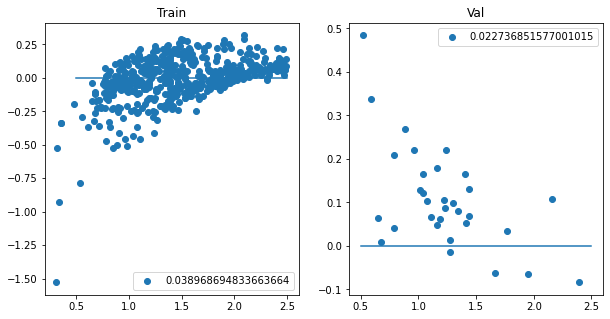

71/71 [==============================] - 28s 391ms/step - loss: 0.0154 - val_loss: 0.0227
Epoch 35/300
71/71 [==============================] - ETA: 0s - loss: 0.0149

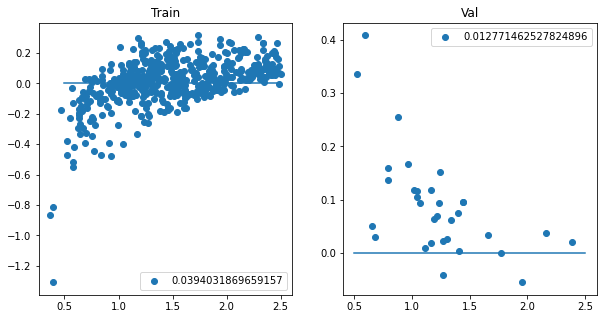

71/71 [==============================] - 27s 385ms/step - loss: 0.0149 - val_loss: 0.0128
Epoch 36/300
71/71 [==============================] - ETA: 0s - loss: 0.0153

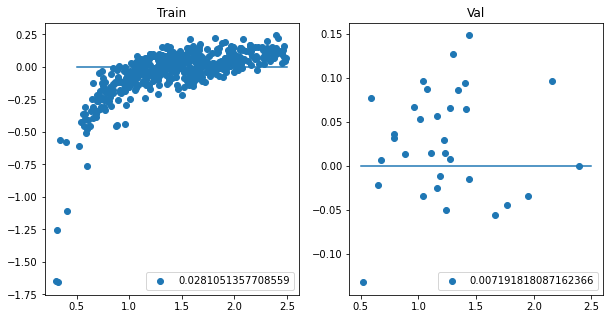

71/71 [==============================] - 27s 386ms/step - loss: 0.0153 - val_loss: 0.0072
Epoch 37/300
71/71 [==============================] - ETA: 0s - loss: 0.0147

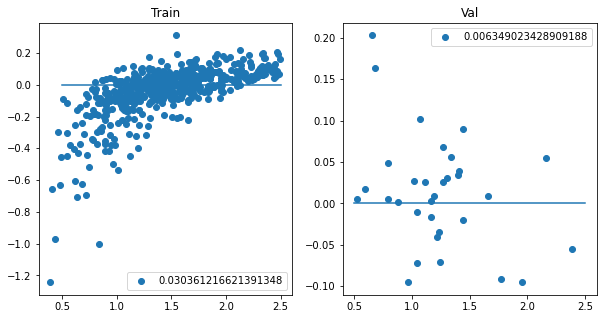

71/71 [==============================] - 28s 390ms/step - loss: 0.0147 - val_loss: 0.0063
Epoch 38/300
71/71 [==============================] - ETA: 0s - loss: 0.0143

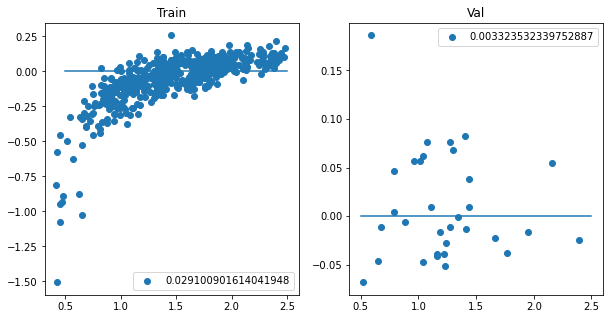

71/71 [==============================] - 29s 415ms/step - loss: 0.0143 - val_loss: 0.0033
Epoch 39/300
71/71 [==============================] - ETA: 0s - loss: 0.0152

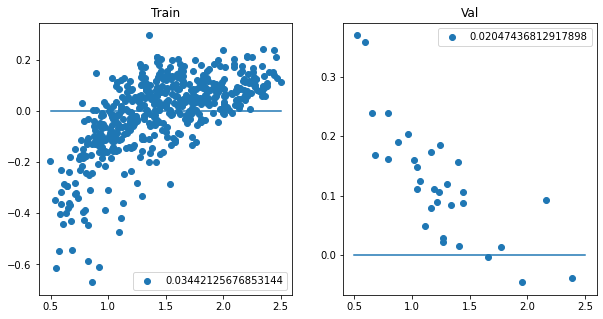

71/71 [==============================] - 28s 396ms/step - loss: 0.0152 - val_loss: 0.0205
Epoch 40/300
71/71 [==============================] - ETA: 0s - loss: 0.0147

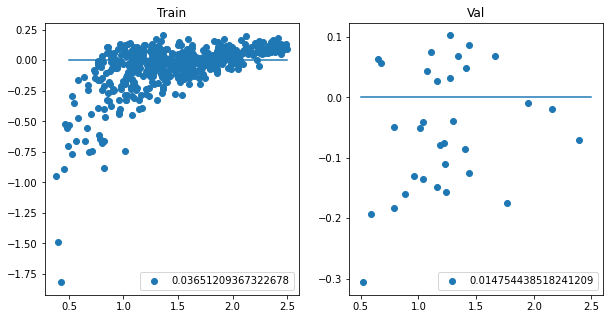

71/71 [==============================] - 27s 386ms/step - loss: 0.0147 - val_loss: 0.0148
Epoch 41/300
71/71 [==============================] - ETA: 0s - loss: 0.0155

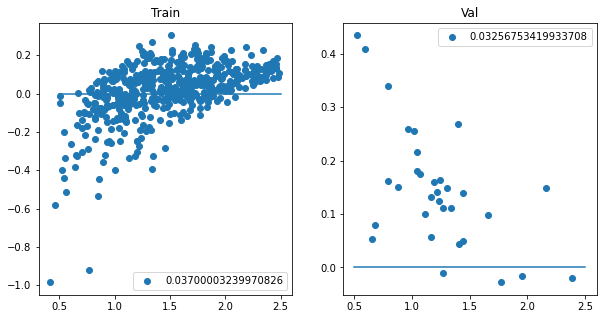

71/71 [==============================] - 28s 399ms/step - loss: 0.0155 - val_loss: 0.0326
Epoch 42/300
71/71 [==============================] - ETA: 0s - loss: 0.0143

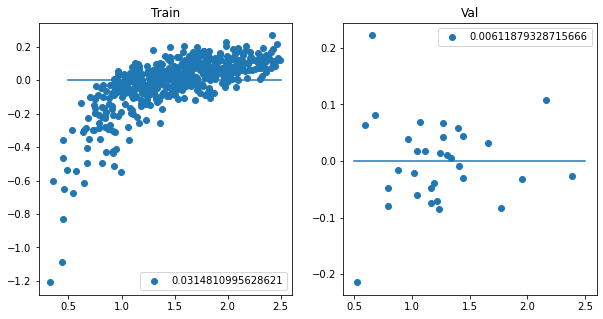

71/71 [==============================] - 27s 387ms/step - loss: 0.0143 - val_loss: 0.0061
Epoch 43/300
71/71 [==============================] - ETA: 0s - loss: 0.0135

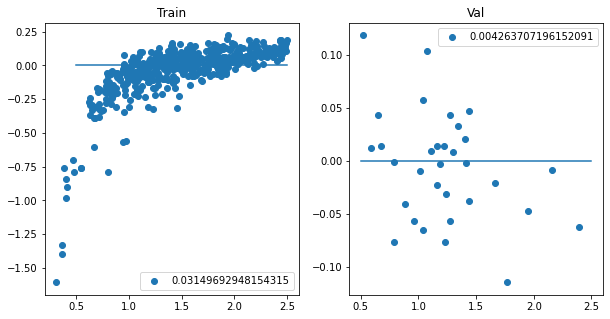

71/71 [==============================] - 27s 383ms/step - loss: 0.0135 - val_loss: 0.0043
Epoch 44/300
71/71 [==============================] - ETA: 0s - loss: 0.0139

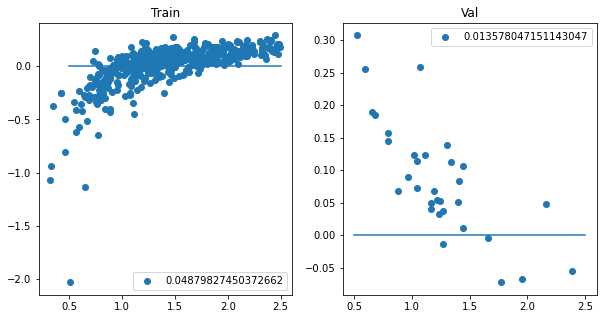

71/71 [==============================] - 27s 384ms/step - loss: 0.0139 - val_loss: 0.0136
Epoch 45/300
71/71 [==============================] - ETA: 0s - loss: 0.0133

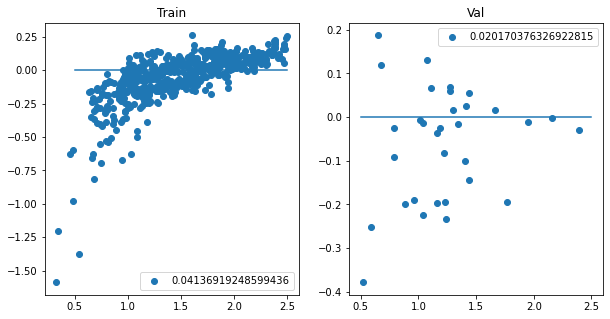

71/71 [==============================] - 27s 385ms/step - loss: 0.0133 - val_loss: 0.0202
Epoch 46/300
71/71 [==============================] - ETA: 0s - loss: 0.0132

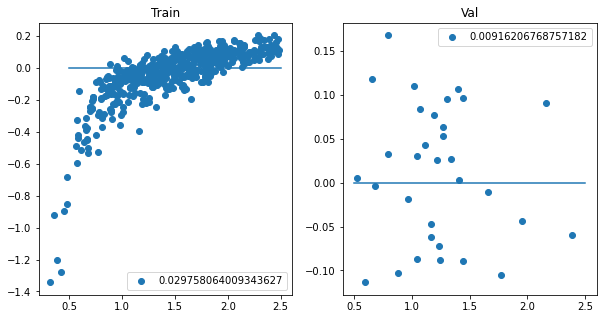

71/71 [==============================] - 28s 388ms/step - loss: 0.0132 - val_loss: 0.0092
Epoch 47/300
71/71 [==============================] - ETA: 0s - loss: 0.0119

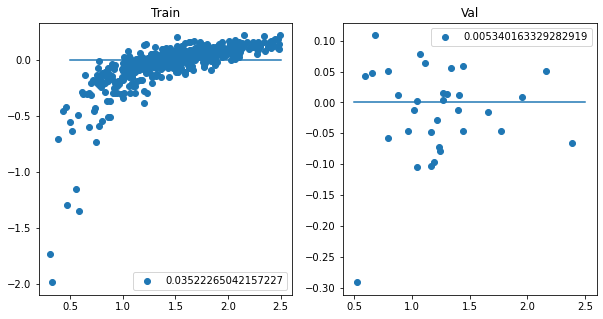

71/71 [==============================] - 28s 390ms/step - loss: 0.0119 - val_loss: 0.0053
Epoch 48/300
71/71 [==============================] - ETA: 0s - loss: 0.0116

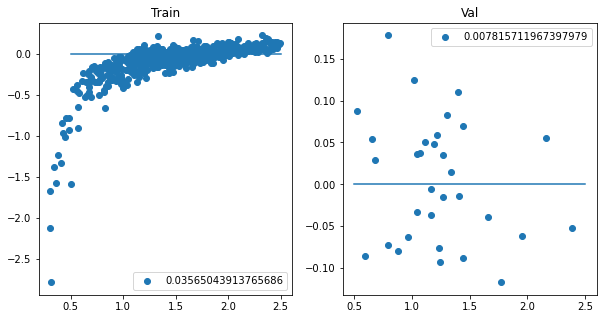

71/71 [==============================] - 28s 394ms/step - loss: 0.0116 - val_loss: 0.0078
Epoch 49/300
71/71 [==============================] - ETA: 0s - loss: 0.0112

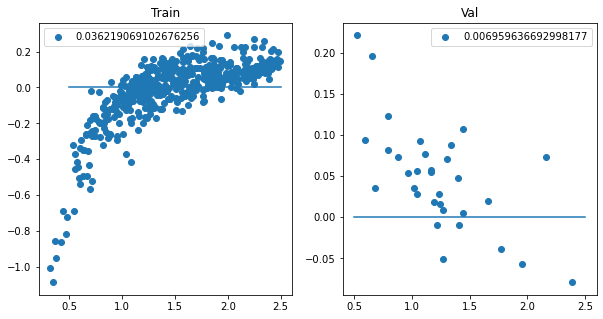

71/71 [==============================] - 27s 377ms/step - loss: 0.0112 - val_loss: 0.0070
Epoch 50/300
71/71 [==============================] - ETA: 0s - loss: 0.0109

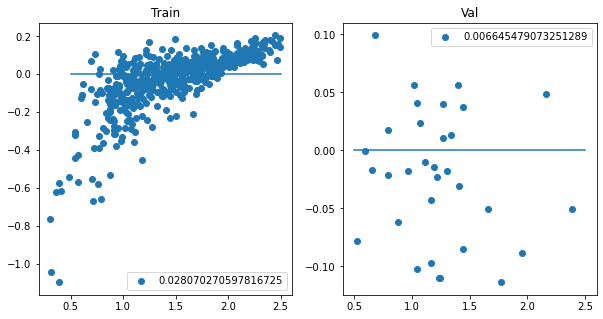

71/71 [==============================] - 29s 405ms/step - loss: 0.0109 - val_loss: 0.0066
Epoch 51/300
71/71 [==============================] - ETA: 0s - loss: 0.0114

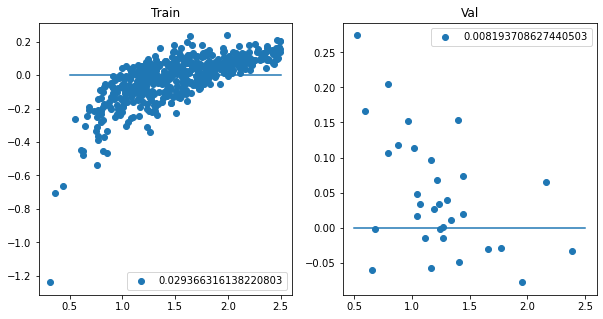

71/71 [==============================] - 28s 401ms/step - loss: 0.0114 - val_loss: 0.0082
Epoch 52/300
71/71 [==============================] - ETA: 0s - loss: 0.0117

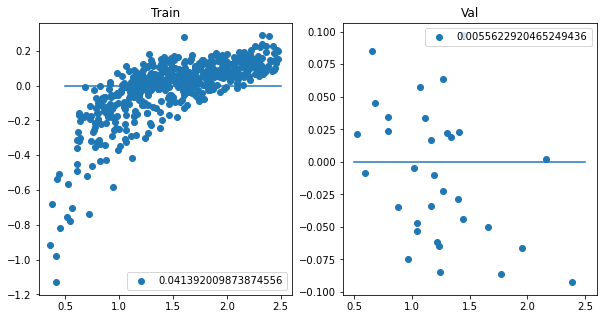

71/71 [==============================] - 28s 389ms/step - loss: 0.0117 - val_loss: 0.0056
Epoch 53/300
71/71 [==============================] - ETA: 0s - loss: 0.0113

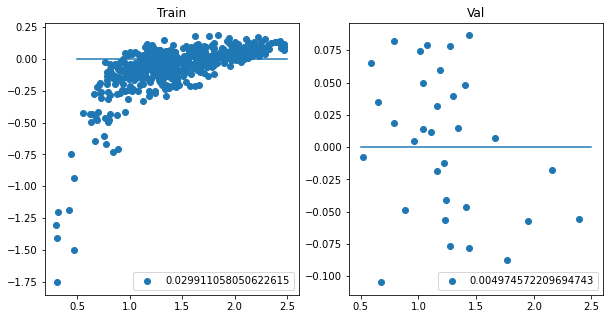

71/71 [==============================] - 27s 382ms/step - loss: 0.0113 - val_loss: 0.0050
Epoch 54/300
71/71 [==============================] - ETA: 0s - loss: 0.0108

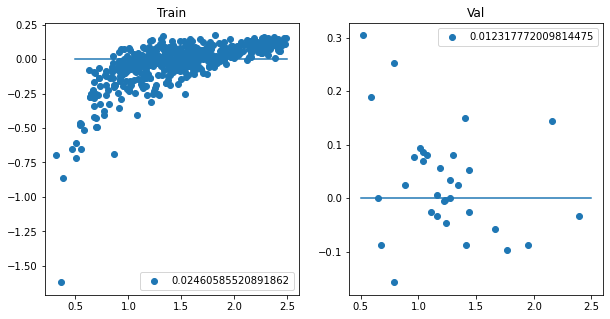

71/71 [==============================] - 27s 380ms/step - loss: 0.0108 - val_loss: 0.0123
Epoch 55/300
71/71 [==============================] - ETA: 0s - loss: 0.0103

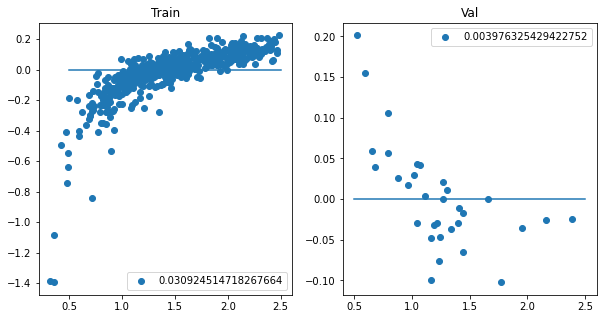

71/71 [==============================] - 27s 379ms/step - loss: 0.0103 - val_loss: 0.0040
Epoch 56/300
71/71 [==============================] - ETA: 0s - loss: 0.0109

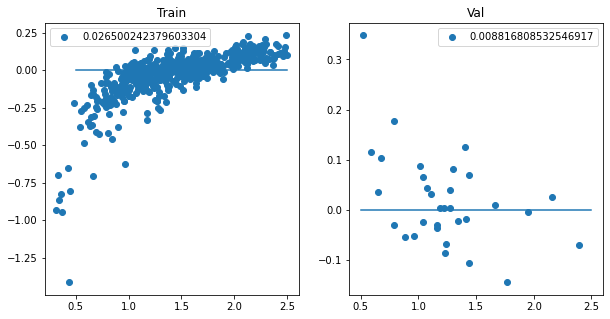

71/71 [==============================] - 27s 382ms/step - loss: 0.0109 - val_loss: 0.0088
Epoch 57/300
71/71 [==============================] - ETA: 0s - loss: 0.0106

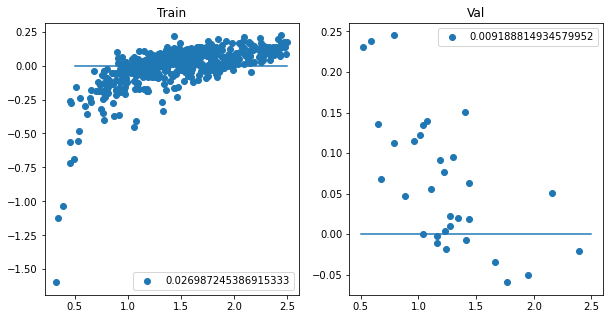

71/71 [==============================] - 27s 386ms/step - loss: 0.0106 - val_loss: 0.0092
Epoch 58/300
71/71 [==============================] - ETA: 0s - loss: 0.0099

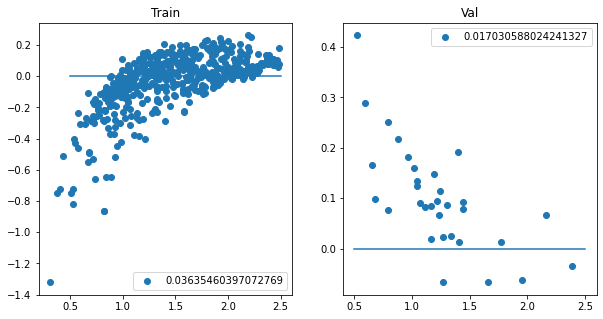

71/71 [==============================] - 28s 392ms/step - loss: 0.0099 - val_loss: 0.0170
Epoch 59/300
71/71 [==============================] - ETA: 0s - loss: 0.0094

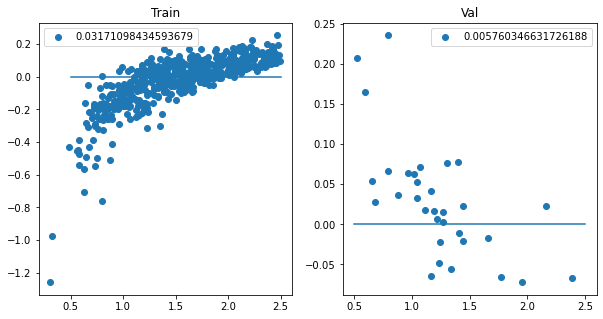

71/71 [==============================] - 27s 384ms/step - loss: 0.0094 - val_loss: 0.0058
Epoch 60/300
71/71 [==============================] - ETA: 0s - loss: 0.0092

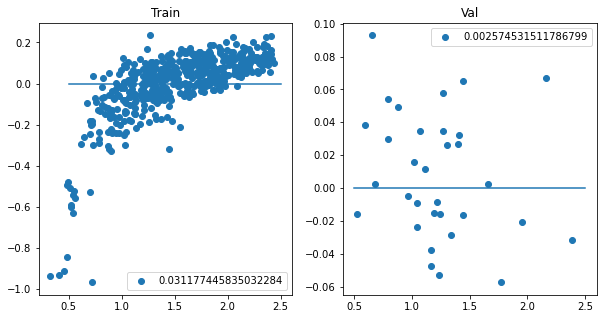

71/71 [==============================] - 28s 391ms/step - loss: 0.0092 - val_loss: 0.0026
Epoch 61/300
71/71 [==============================] - ETA: 0s - loss: 0.0089

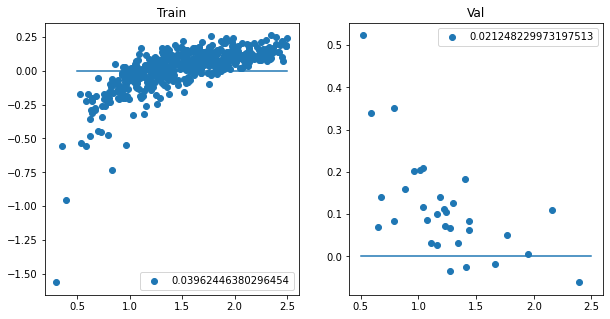

71/71 [==============================] - 27s 379ms/step - loss: 0.0089 - val_loss: 0.0212
Epoch 62/300
71/71 [==============================] - ETA: 0s - loss: 0.0087

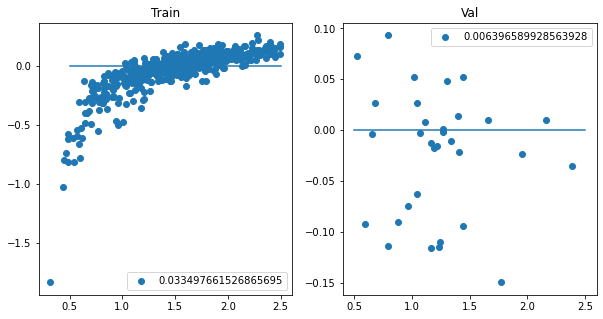

71/71 [==============================] - 28s 400ms/step - loss: 0.0087 - val_loss: 0.0064
Epoch 63/300
71/71 [==============================] - ETA: 0s - loss: 0.0094

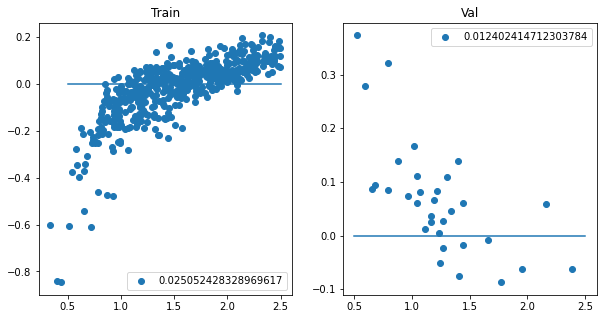

71/71 [==============================] - 28s 389ms/step - loss: 0.0094 - val_loss: 0.0124
Epoch 64/300
71/71 [==============================] - ETA: 0s - loss: 0.0093

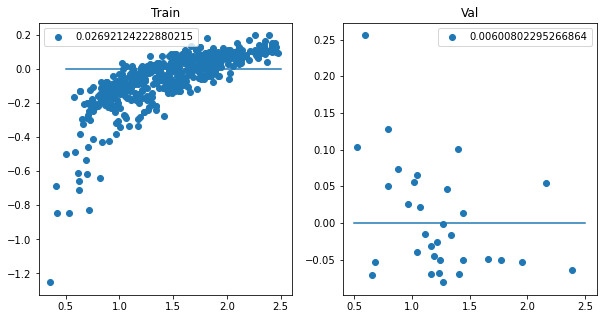

71/71 [==============================] - 28s 387ms/step - loss: 0.0093 - val_loss: 0.0060
Epoch 65/300
71/71 [==============================] - ETA: 0s - loss: 0.0082

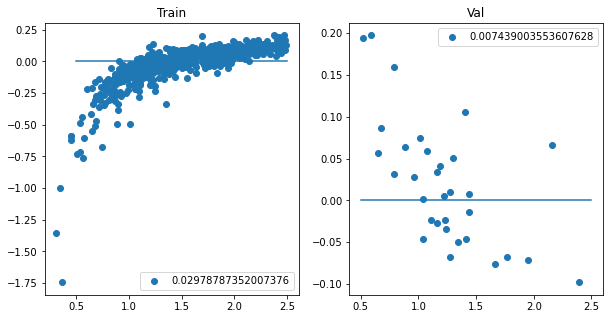

71/71 [==============================] - 27s 386ms/step - loss: 0.0082 - val_loss: 0.0074
Epoch 66/300
71/71 [==============================] - ETA: 0s - loss: 0.0076

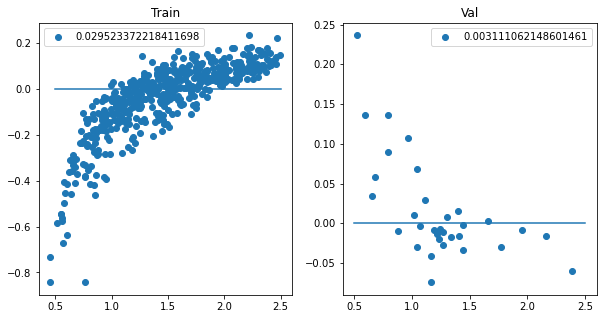

71/71 [==============================] - 27s 384ms/step - loss: 0.0076 - val_loss: 0.0031
Epoch 67/300
71/71 [==============================] - ETA: 0s - loss: 0.0077

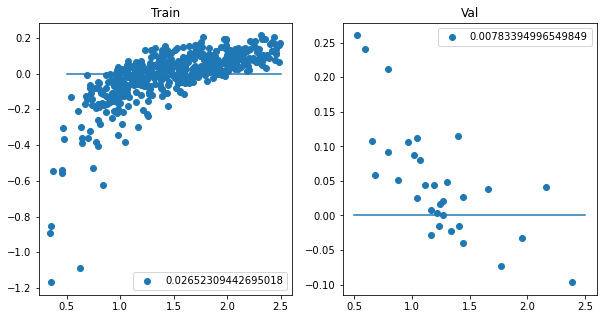

71/71 [==============================] - 27s 386ms/step - loss: 0.0077 - val_loss: 0.0078
Epoch 68/300
71/71 [==============================] - ETA: 0s - loss: 0.0075

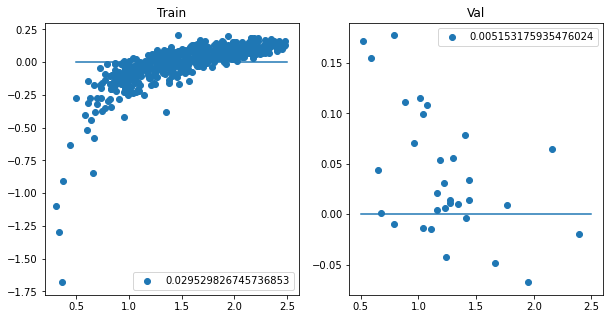

71/71 [==============================] - 27s 383ms/step - loss: 0.0075 - val_loss: 0.0052
Epoch 69/300
71/71 [==============================] - ETA: 0s - loss: 0.0075

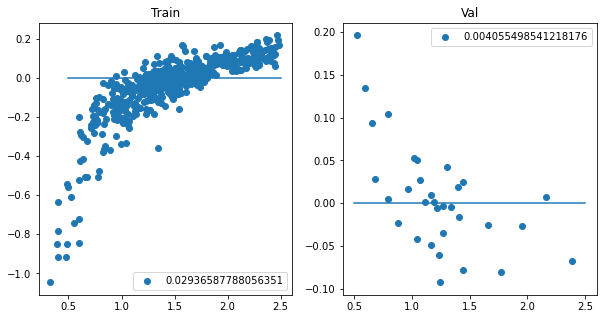

71/71 [==============================] - 27s 384ms/step - loss: 0.0075 - val_loss: 0.0041
Epoch 70/300
71/71 [==============================] - ETA: 0s - loss: 0.0082

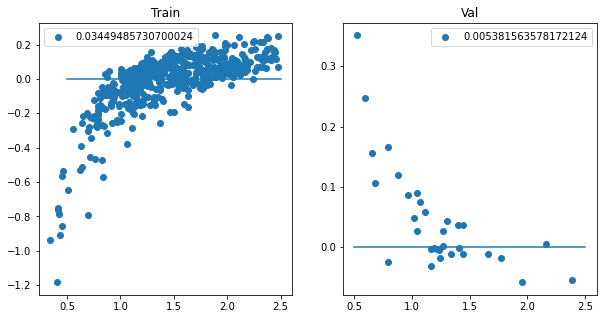

71/71 [==============================] - 28s 394ms/step - loss: 0.0082 - val_loss: 0.0054
Epoch 71/300
71/71 [==============================] - ETA: 0s - loss: 0.0081

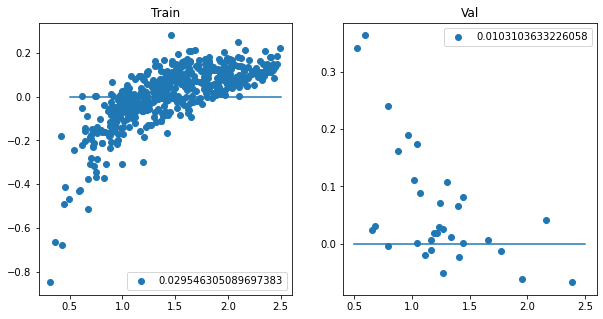

71/71 [==============================] - 27s 384ms/step - loss: 0.0081 - val_loss: 0.0103
Epoch 72/300
71/71 [==============================] - ETA: 0s - loss: 0.0080

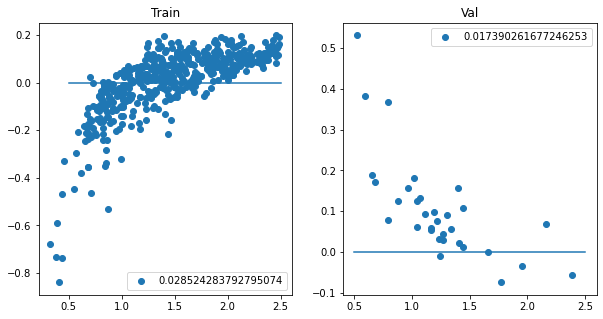

71/71 [==============================] - 27s 386ms/step - loss: 0.0080 - val_loss: 0.0174
Epoch 73/300
71/71 [==============================] - ETA: 0s - loss: 0.0078

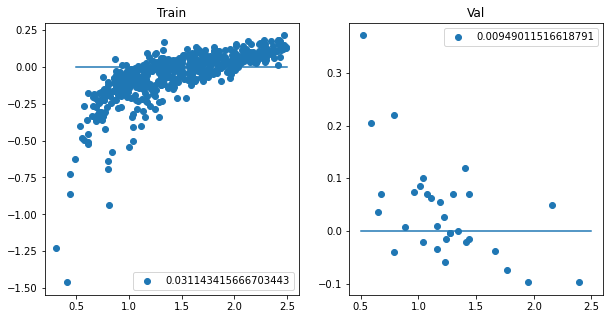

71/71 [==============================] - 29s 402ms/step - loss: 0.0078 - val_loss: 0.0095
Epoch 74/300
71/71 [==============================] - ETA: 0s - loss: 0.0069

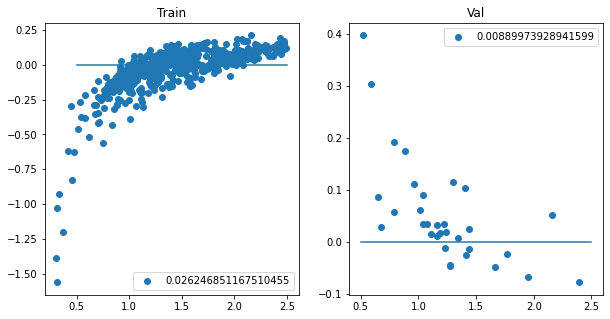

71/71 [==============================] - 27s 383ms/step - loss: 0.0069 - val_loss: 0.0089
Epoch 75/300
71/71 [==============================] - ETA: 0s - loss: 0.0072

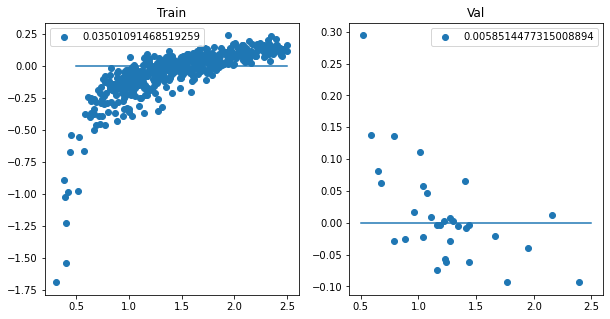

71/71 [==============================] - 28s 389ms/step - loss: 0.0072 - val_loss: 0.0059
Epoch 76/300
71/71 [==============================] - ETA: 0s - loss: 0.0078

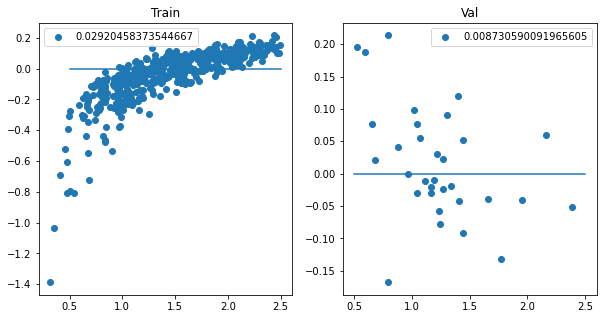

71/71 [==============================] - 28s 393ms/step - loss: 0.0078 - val_loss: 0.0087
Epoch 77/300
71/71 [==============================] - ETA: 0s - loss: 0.0063

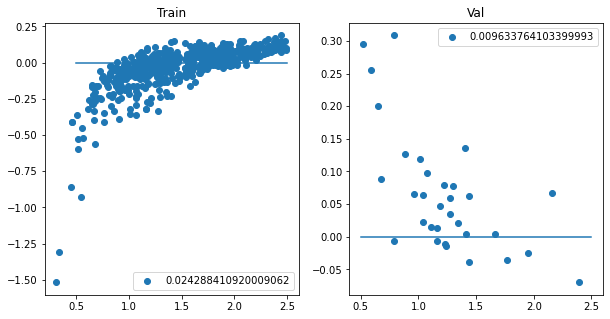

71/71 [==============================] - 27s 387ms/step - loss: 0.0063 - val_loss: 0.0096
Epoch 78/300
71/71 [==============================] - ETA: 0s - loss: 0.0067

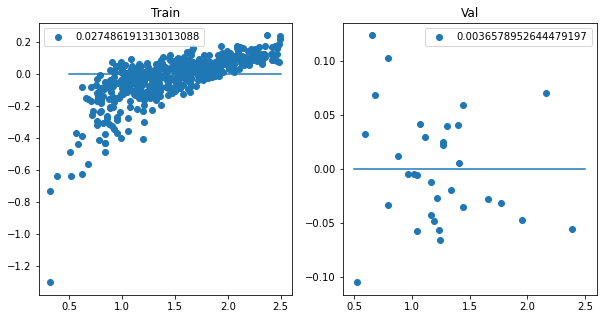

71/71 [==============================] - 28s 389ms/step - loss: 0.0067 - val_loss: 0.0037
Epoch 79/300
71/71 [==============================] - ETA: 0s - loss: 0.0062

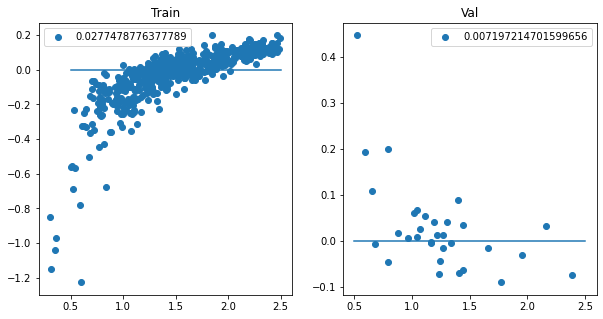

71/71 [==============================] - 27s 381ms/step - loss: 0.0062 - val_loss: 0.0072
Epoch 80/300
71/71 [==============================] - ETA: 0s - loss: 0.0070

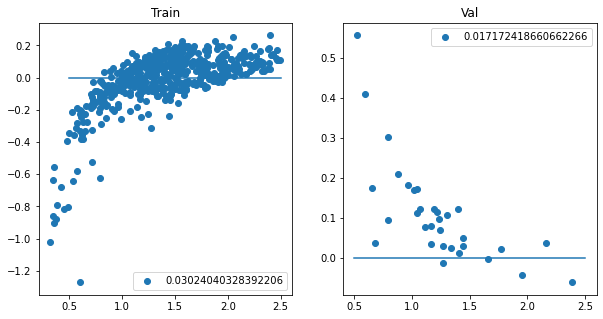

71/71 [==============================] - 27s 382ms/step - loss: 0.0070 - val_loss: 0.0172
Epoch 81/300
71/71 [==============================] - ETA: 0s - loss: 0.0067

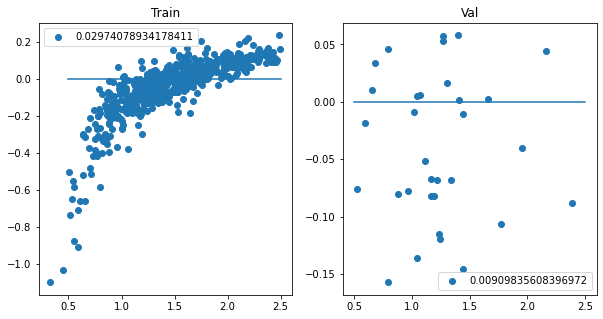

71/71 [==============================] - 27s 378ms/step - loss: 0.0067 - val_loss: 0.0091
Epoch 82/300
71/71 [==============================] - ETA: 0s - loss: 0.0065

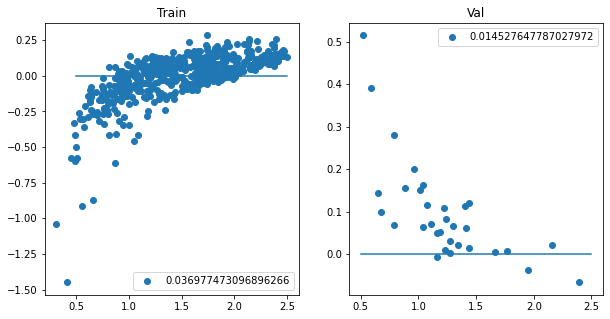

71/71 [==============================] - 27s 377ms/step - loss: 0.0065 - val_loss: 0.0145
Epoch 83/300
71/71 [==============================] - ETA: 0s - loss: 0.0063

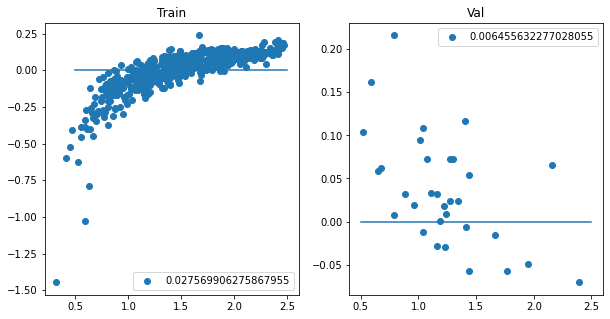

71/71 [==============================] - 27s 377ms/step - loss: 0.0063 - val_loss: 0.0065
Epoch 84/300
71/71 [==============================] - ETA: 0s - loss: 0.0059

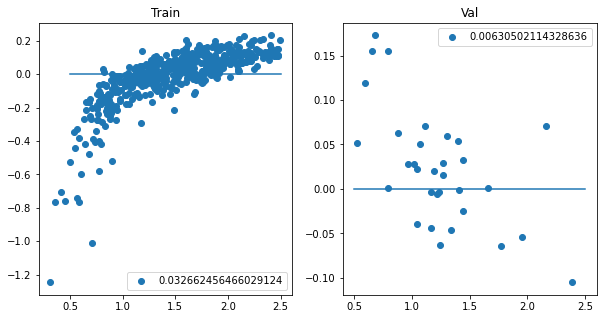

71/71 [==============================] - 27s 378ms/step - loss: 0.0059 - val_loss: 0.0063
Epoch 85/300
71/71 [==============================] - ETA: 0s - loss: 0.0060

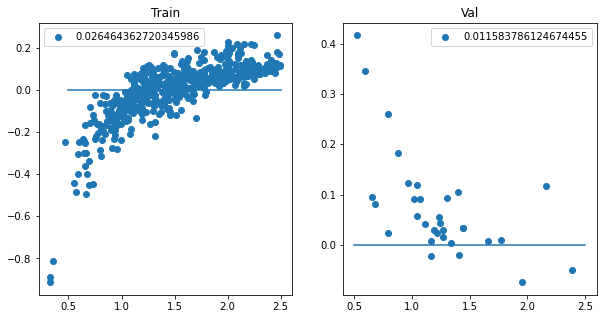

71/71 [==============================] - 29s 407ms/step - loss: 0.0060 - val_loss: 0.0116
Epoch 86/300
71/71 [==============================] - ETA: 0s - loss: 0.0056

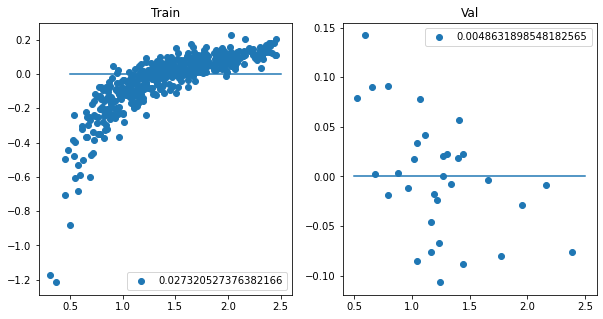

71/71 [==============================] - 27s 381ms/step - loss: 0.0056 - val_loss: 0.0049
Epoch 87/300
71/71 [==============================] - ETA: 0s - loss: 0.0055

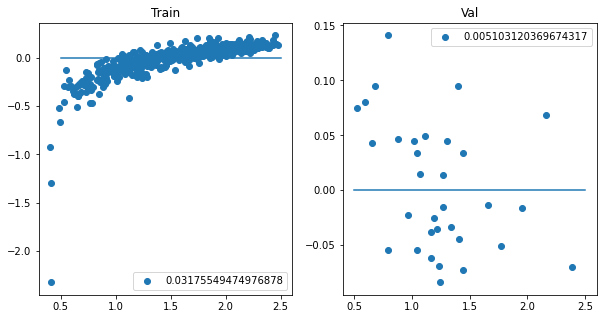

71/71 [==============================] - 27s 383ms/step - loss: 0.0055 - val_loss: 0.0051
Epoch 88/300
71/71 [==============================] - ETA: 0s - loss: 0.0061

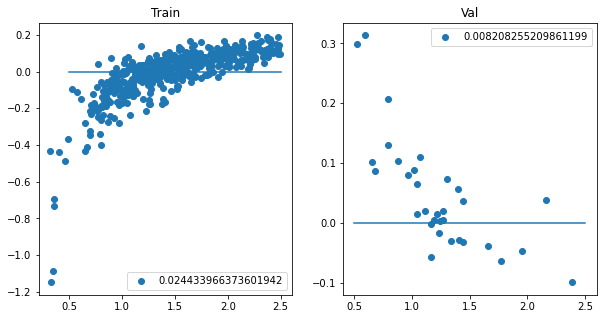

71/71 [==============================] - 27s 382ms/step - loss: 0.0061 - val_loss: 0.0082
Epoch 89/300
71/71 [==============================] - ETA: 0s - loss: 0.0061

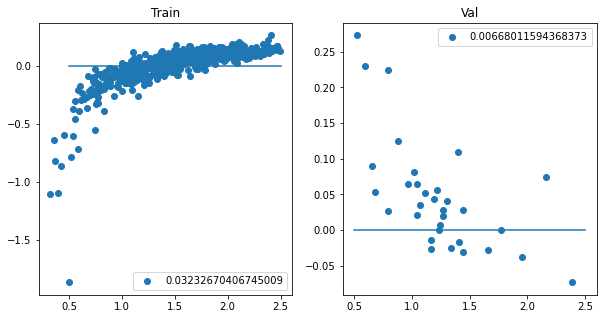

71/71 [==============================] - 28s 388ms/step - loss: 0.0061 - val_loss: 0.0067
Epoch 90/300
71/71 [==============================] - ETA: 0s - loss: 0.0058

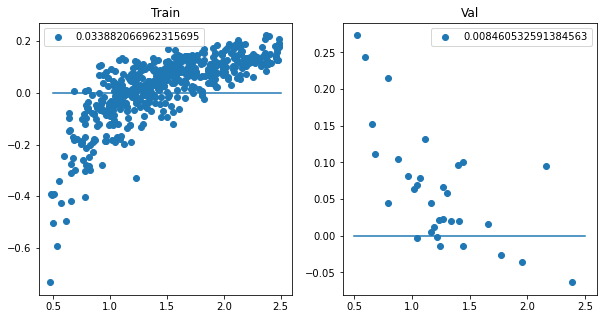

71/71 [==============================] - 27s 384ms/step - loss: 0.0058 - val_loss: 0.0085
Epoch 91/300
71/71 [==============================] - ETA: 0s - loss: 0.0052

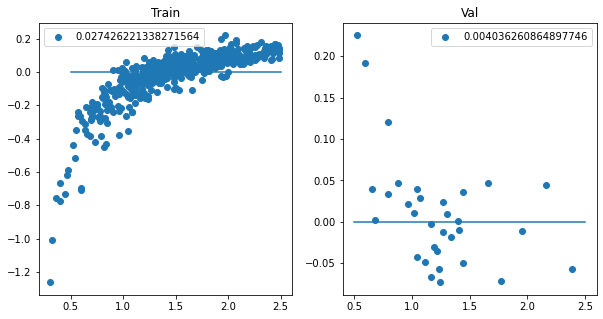

71/71 [==============================] - 27s 376ms/step - loss: 0.0052 - val_loss: 0.0040
Epoch 92/300
71/71 [==============================] - ETA: 0s - loss: 0.0058

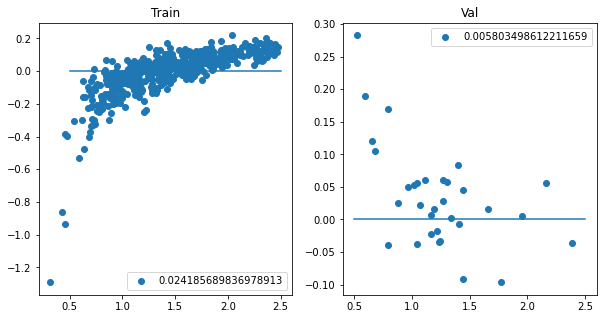

71/71 [==============================] - 27s 379ms/step - loss: 0.0058 - val_loss: 0.0058
Epoch 93/300
71/71 [==============================] - ETA: 0s - loss: 0.0054

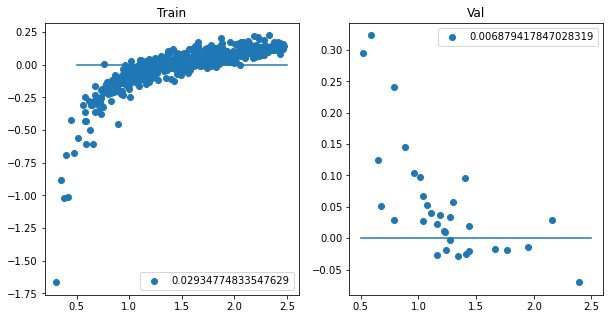

71/71 [==============================] - 27s 381ms/step - loss: 0.0054 - val_loss: 0.0069
Epoch 94/300
71/71 [==============================] - ETA: 0s - loss: 0.0053

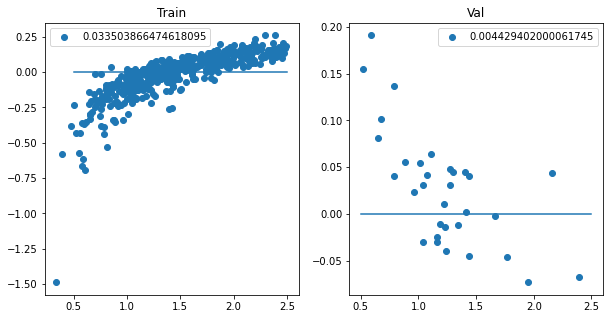

71/71 [==============================] - 27s 379ms/step - loss: 0.0053 - val_loss: 0.0044
Epoch 95/300
71/71 [==============================] - ETA: 0s - loss: 0.0050

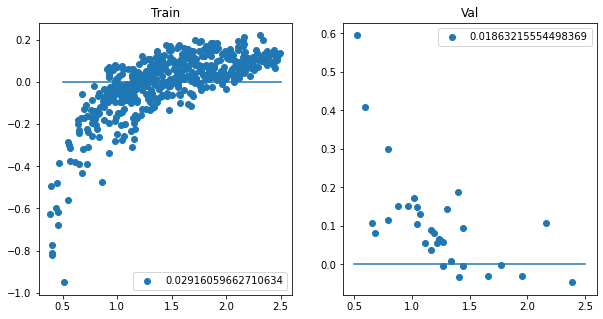

71/71 [==============================] - 27s 377ms/step - loss: 0.0050 - val_loss: 0.0186
Epoch 96/300
71/71 [==============================] - ETA: 0s - loss: 0.0053

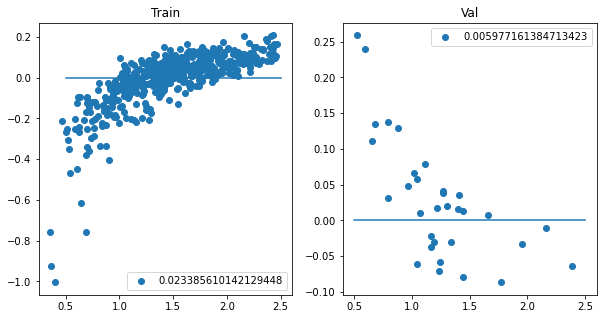

71/71 [==============================] - 29s 411ms/step - loss: 0.0053 - val_loss: 0.0060
Epoch 97/300
71/71 [==============================] - ETA: 0s - loss: 0.0047

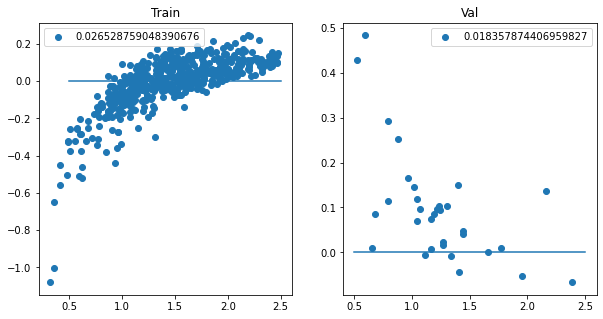

71/71 [==============================] - 28s 390ms/step - loss: 0.0047 - val_loss: 0.0184
Epoch 98/300
71/71 [==============================] - ETA: 0s - loss: 0.0047

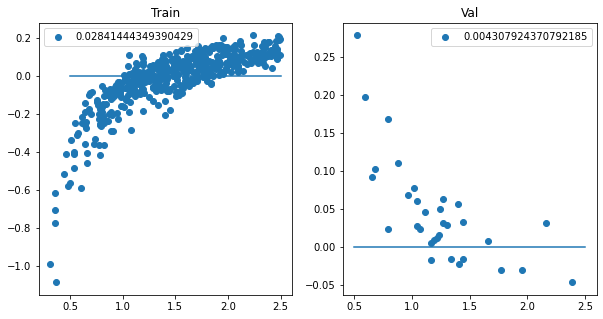

71/71 [==============================] - 28s 399ms/step - loss: 0.0047 - val_loss: 0.0043
Epoch 99/300
71/71 [==============================] - ETA: 0s - loss: 0.0052

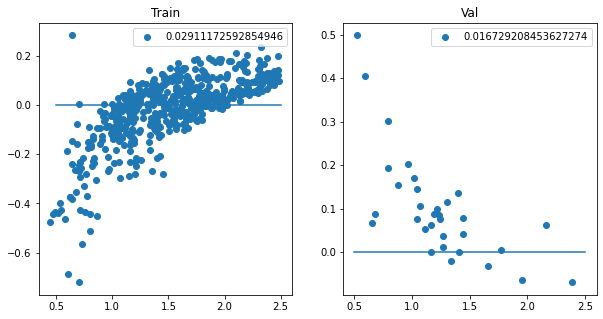

71/71 [==============================] - 27s 387ms/step - loss: 0.0052 - val_loss: 0.0167
Epoch 100/300
71/71 [==============================] - ETA: 0s - loss: 0.0048

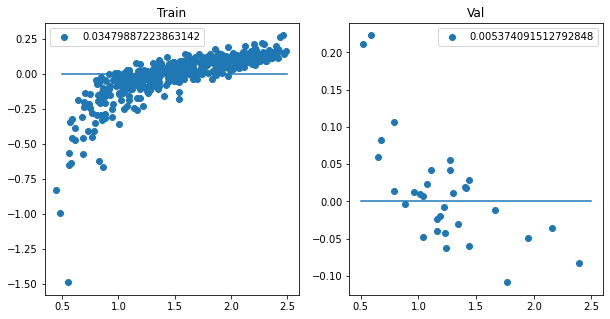

71/71 [==============================] - 28s 397ms/step - loss: 0.0048 - val_loss: 0.0054
Epoch 101/300
71/71 [==============================] - ETA: 0s - loss: 0.0047

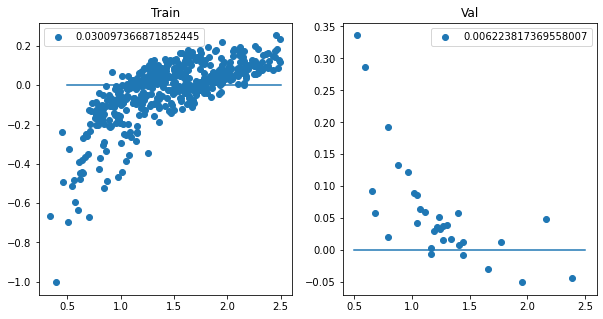

71/71 [==============================] - 27s 386ms/step - loss: 0.0047 - val_loss: 0.0062
Epoch 102/300
71/71 [==============================] - ETA: 0s - loss: 0.0049

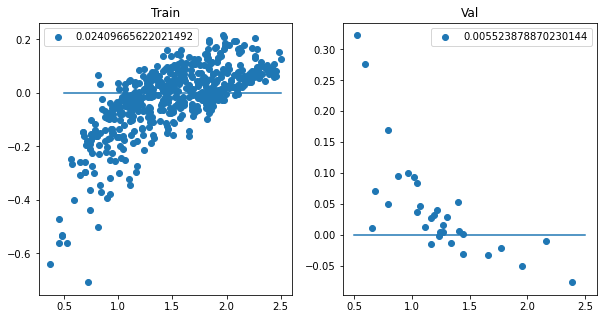

71/71 [==============================] - 27s 382ms/step - loss: 0.0049 - val_loss: 0.0055
Epoch 103/300
71/71 [==============================] - ETA: 0s - loss: 0.0050

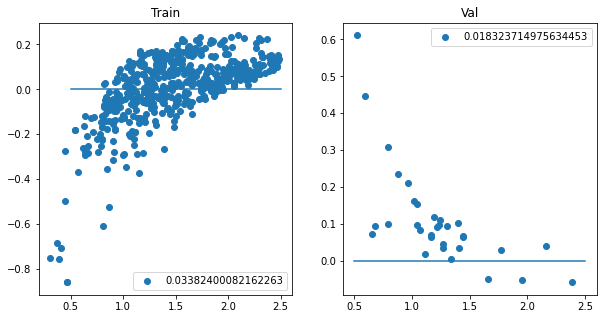

71/71 [==============================] - 28s 392ms/step - loss: 0.0050 - val_loss: 0.0183
Epoch 104/300
71/71 [==============================] - ETA: 0s - loss: 0.0050

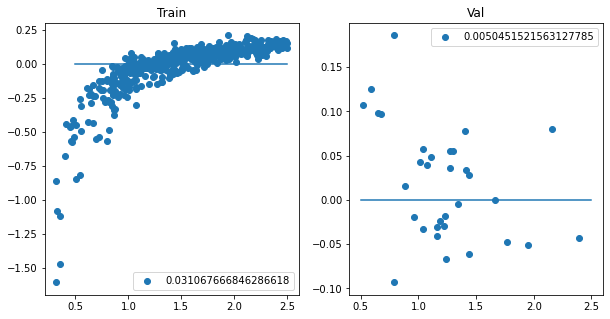

71/71 [==============================] - 27s 380ms/step - loss: 0.0050 - val_loss: 0.0050
Epoch 105/300
71/71 [==============================] - ETA: 0s - loss: 0.0048

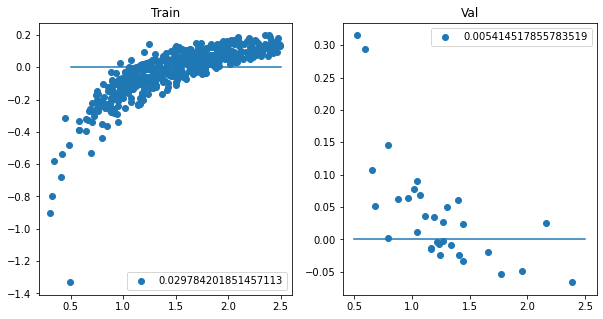

71/71 [==============================] - 27s 379ms/step - loss: 0.0048 - val_loss: 0.0054
Epoch 106/300
71/71 [==============================] - ETA: 0s - loss: 0.0041

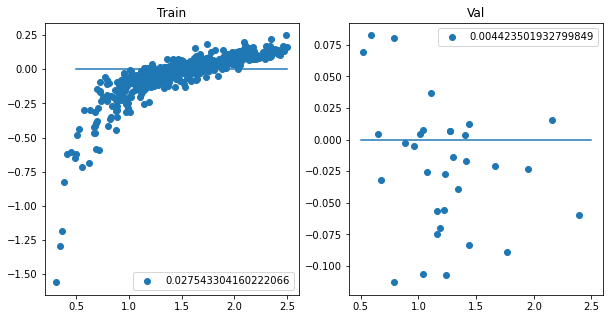

71/71 [==============================] - 27s 381ms/step - loss: 0.0041 - val_loss: 0.0044
Epoch 107/300
71/71 [==============================] - ETA: 0s - loss: 0.0049

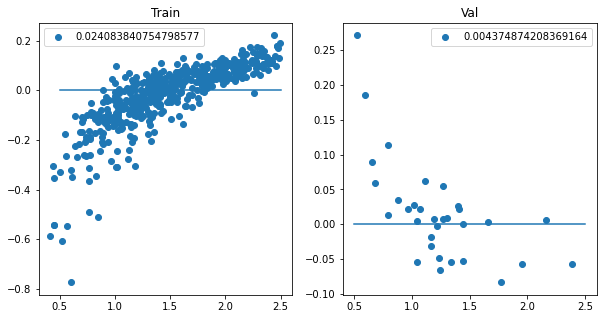

71/71 [==============================] - 28s 392ms/step - loss: 0.0049 - val_loss: 0.0044
Epoch 108/300
71/71 [==============================] - ETA: 0s - loss: 0.0050

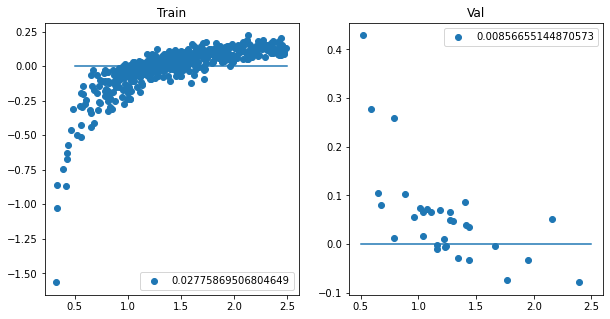

71/71 [==============================] - 27s 382ms/step - loss: 0.0050 - val_loss: 0.0086
Epoch 109/300
71/71 [==============================] - ETA: 0s - loss: 0.0040

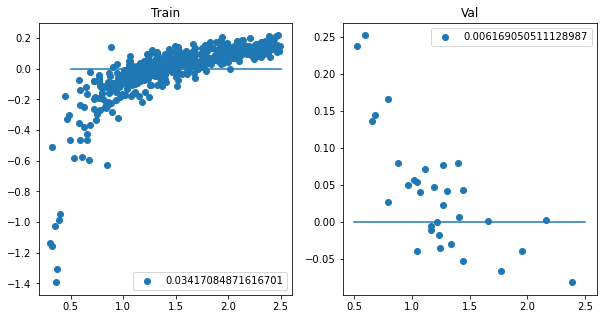

71/71 [==============================] - 27s 383ms/step - loss: 0.0040 - val_loss: 0.0062
Epoch 110/300
71/71 [==============================] - ETA: 0s - loss: 0.0038

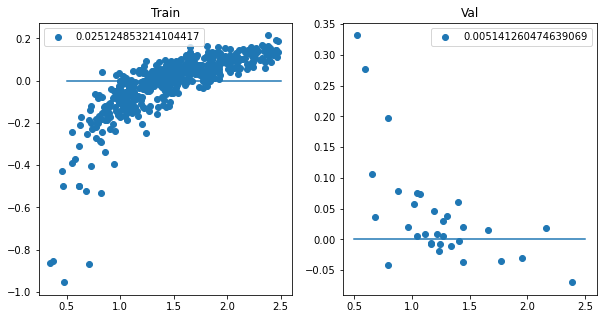

71/71 [==============================] - 27s 381ms/step - loss: 0.0038 - val_loss: 0.0051
Epoch 111/300
71/71 [==============================] - ETA: 0s - loss: 0.0039

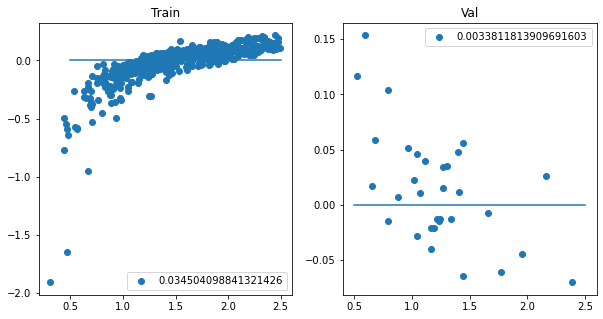

71/71 [==============================] - 27s 383ms/step - loss: 0.0039 - val_loss: 0.0034
Epoch 112/300
71/71 [==============================] - ETA: 0s - loss: 0.0037

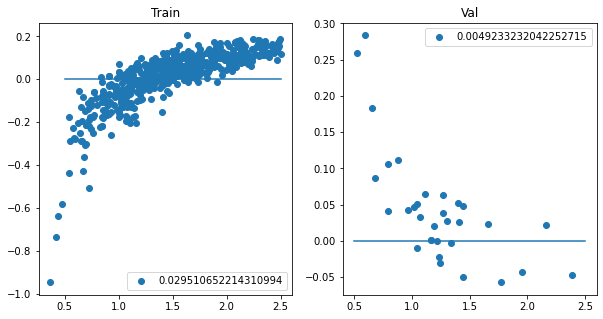

71/71 [==============================] - 27s 378ms/step - loss: 0.0037 - val_loss: 0.0049
Epoch 113/300
71/71 [==============================] - ETA: 0s - loss: 0.0038

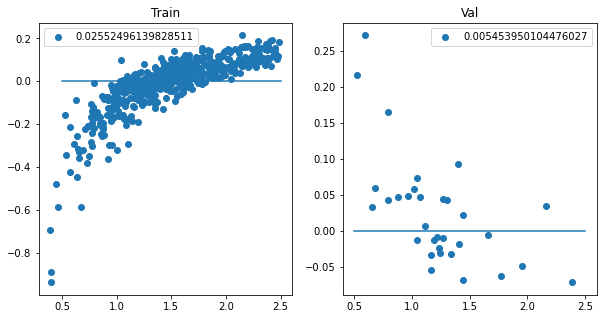

71/71 [==============================] - 27s 384ms/step - loss: 0.0038 - val_loss: 0.0055
Epoch 114/300
71/71 [==============================] - ETA: 0s - loss: 0.0041

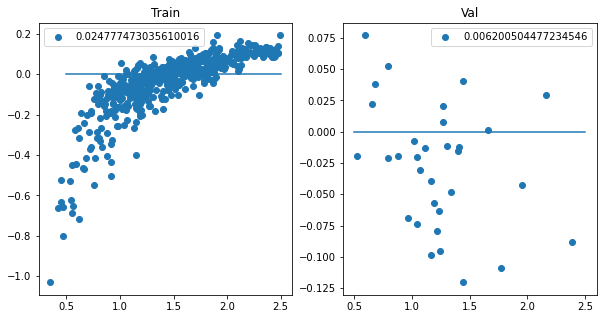

71/71 [==============================] - 27s 384ms/step - loss: 0.0041 - val_loss: 0.0062
Epoch 115/300
71/71 [==============================] - ETA: 0s - loss: 0.0043

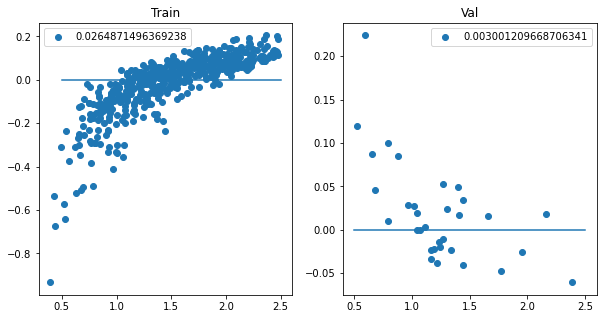

71/71 [==============================] - 28s 387ms/step - loss: 0.0043 - val_loss: 0.0030
Epoch 116/300
71/71 [==============================] - ETA: 0s - loss: 0.0043

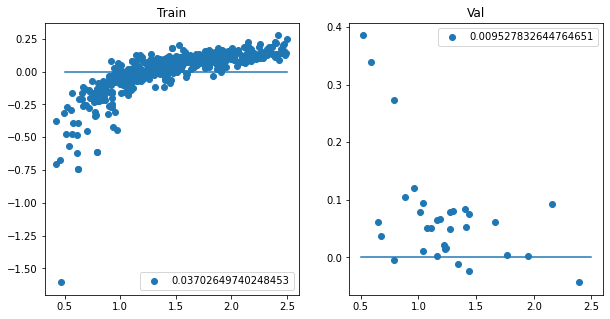

71/71 [==============================] - 27s 381ms/step - loss: 0.0043 - val_loss: 0.0095
Epoch 117/300
71/71 [==============================] - ETA: 0s - loss: 0.0038

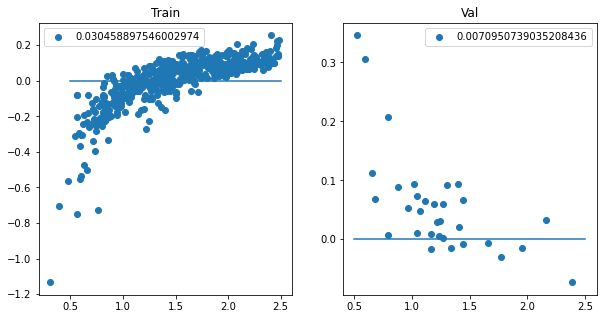

71/71 [==============================] - 27s 379ms/step - loss: 0.0038 - val_loss: 0.0071
Epoch 118/300
71/71 [==============================] - ETA: 0s - loss: 0.0042

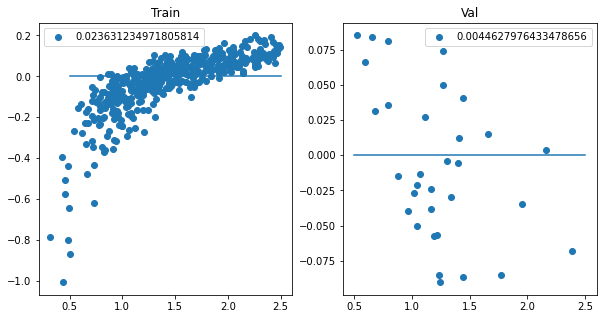

71/71 [==============================] - 27s 384ms/step - loss: 0.0042 - val_loss: 0.0045
Epoch 119/300
71/71 [==============================] - ETA: 0s - loss: 0.0038

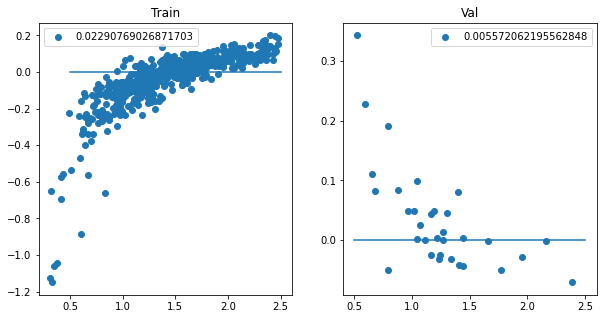

71/71 [==============================] - 30s 416ms/step - loss: 0.0038 - val_loss: 0.0056
Epoch 120/300
71/71 [==============================] - ETA: 0s - loss: 0.0033

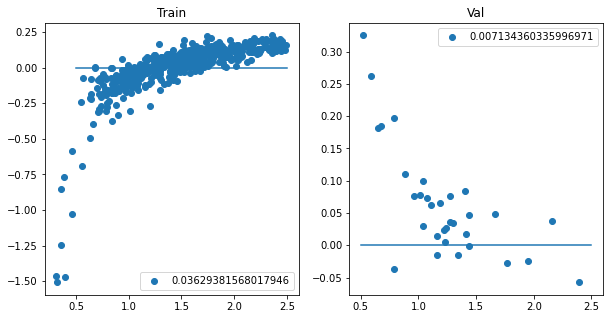

71/71 [==============================] - 28s 389ms/step - loss: 0.0033 - val_loss: 0.0071
Epoch 121/300
71/71 [==============================] - ETA: 0s - loss: 0.0039

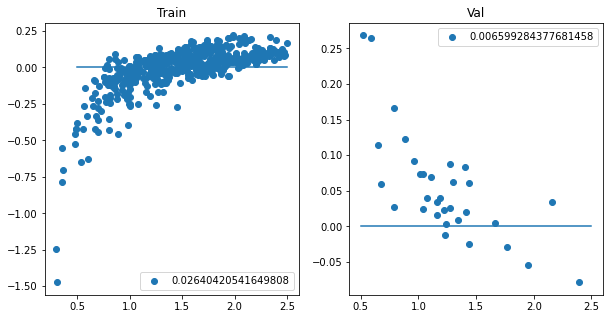

71/71 [==============================] - 27s 387ms/step - loss: 0.0039 - val_loss: 0.0066
Epoch 122/300
71/71 [==============================] - ETA: 0s - loss: 0.0041

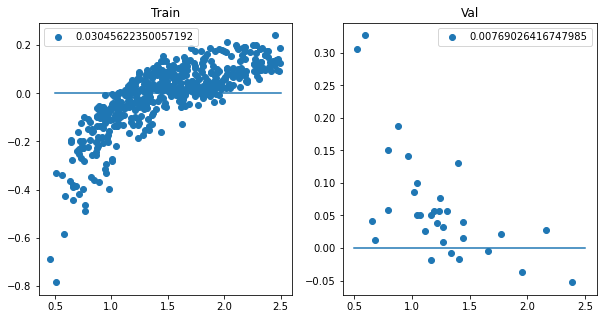

71/71 [==============================] - 27s 384ms/step - loss: 0.0041 - val_loss: 0.0077
Epoch 123/300
71/71 [==============================] - ETA: 0s - loss: 0.0039

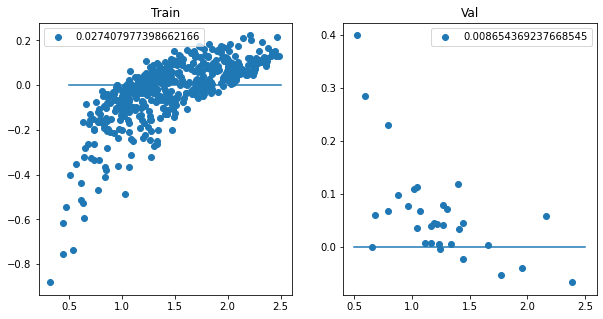

71/71 [==============================] - 27s 379ms/step - loss: 0.0039 - val_loss: 0.0087
Epoch 124/300
71/71 [==============================] - ETA: 0s - loss: 0.0033

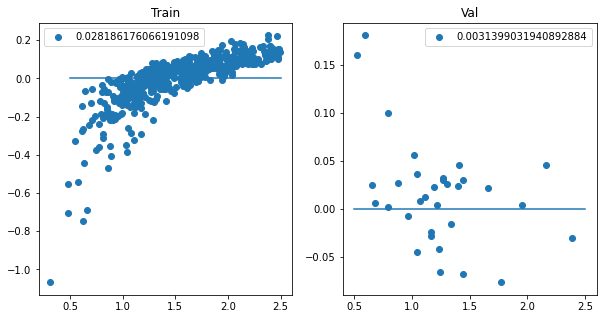

71/71 [==============================] - 27s 383ms/step - loss: 0.0033 - val_loss: 0.0031
Epoch 125/300
71/71 [==============================] - ETA: 0s - loss: 0.0040

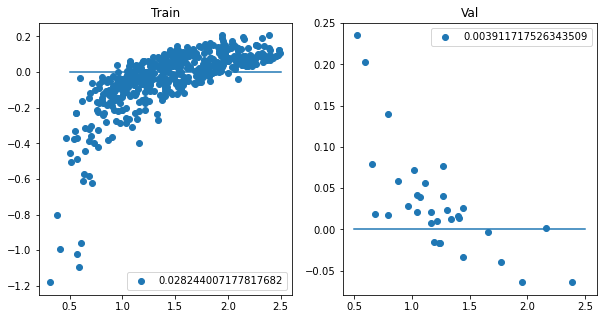

71/71 [==============================] - 27s 384ms/step - loss: 0.0040 - val_loss: 0.0039
Epoch 126/300
71/71 [==============================] - ETA: 0s - loss: 0.0042

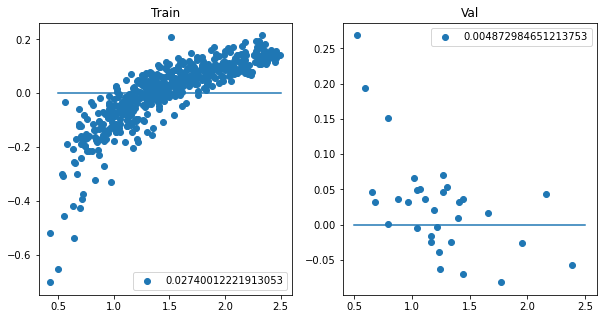

71/71 [==============================] - 27s 387ms/step - loss: 0.0042 - val_loss: 0.0049
Epoch 127/300
71/71 [==============================] - ETA: 0s - loss: 0.0035

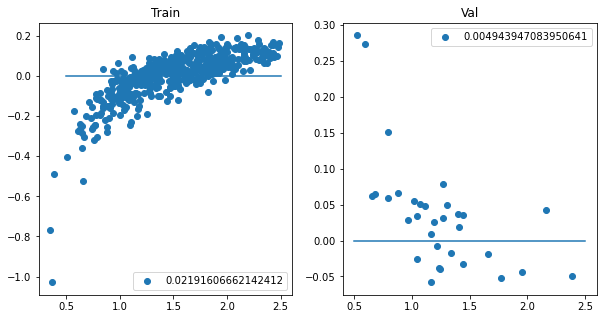

71/71 [==============================] - 27s 380ms/step - loss: 0.0035 - val_loss: 0.0049
Epoch 128/300
71/71 [==============================] - ETA: 0s - loss: 0.0034

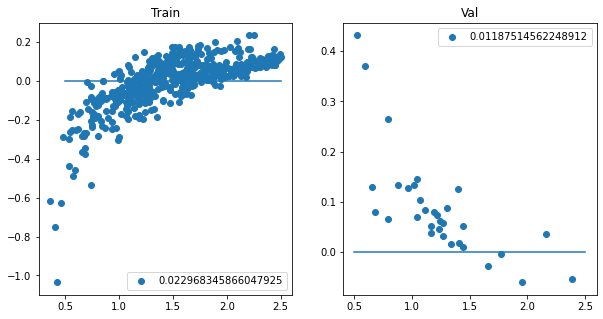

71/71 [==============================] - 27s 383ms/step - loss: 0.0034 - val_loss: 0.0119
Epoch 129/300
71/71 [==============================] - ETA: 0s - loss: 0.0032

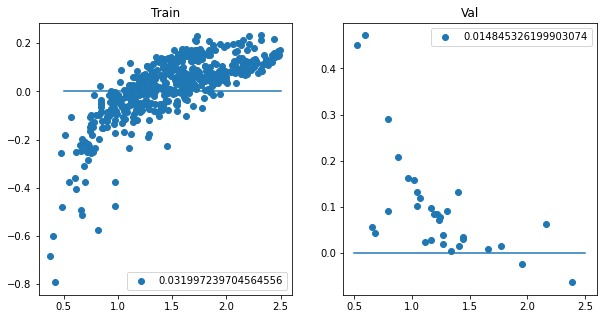

71/71 [==============================] - 27s 383ms/step - loss: 0.0032 - val_loss: 0.0148
Epoch 130/300
71/71 [==============================] - ETA: 0s - loss: 0.0040

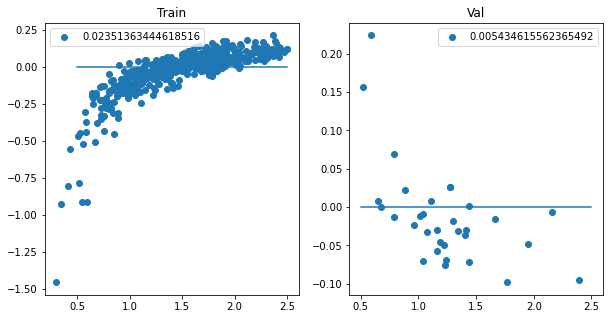

71/71 [==============================] - 30s 417ms/step - loss: 0.0040 - val_loss: 0.0054
Epoch 131/300
71/71 [==============================] - ETA: 0s - loss: 0.0033

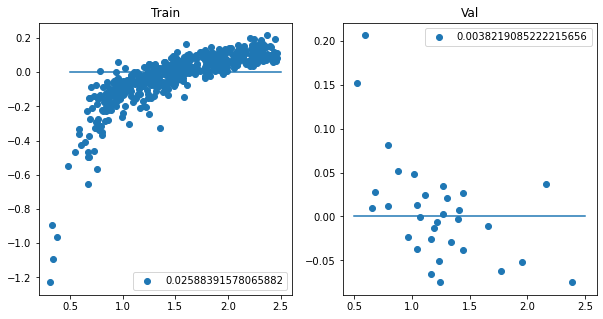

71/71 [==============================] - 27s 386ms/step - loss: 0.0033 - val_loss: 0.0038
Epoch 132/300
71/71 [==============================] - ETA: 0s - loss: 0.0028

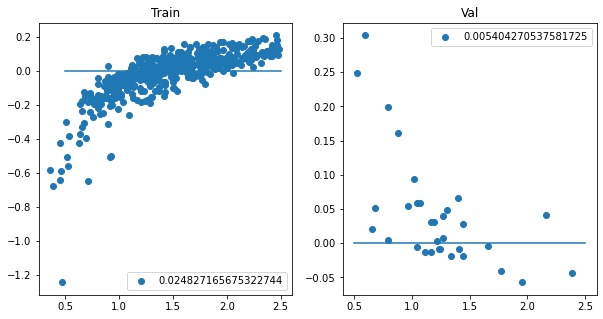

71/71 [==============================] - 28s 388ms/step - loss: 0.0028 - val_loss: 0.0054
Epoch 133/300
71/71 [==============================] - ETA: 0s - loss: 0.0032

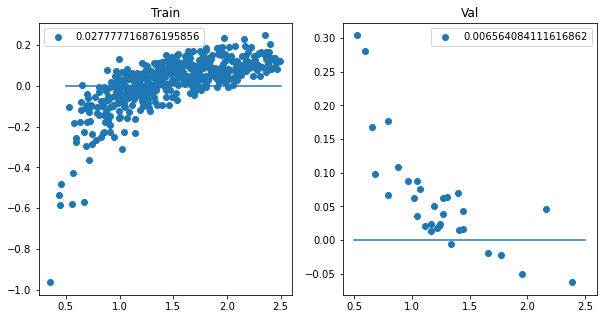

71/71 [==============================] - 27s 385ms/step - loss: 0.0032 - val_loss: 0.0066
Epoch 134/300
71/71 [==============================] - ETA: 0s - loss: 0.0027

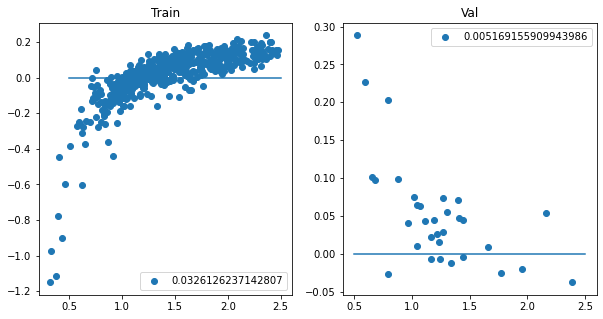

71/71 [==============================] - 27s 381ms/step - loss: 0.0027 - val_loss: 0.0052
Epoch 135/300
71/71 [==============================] - ETA: 0s - loss: 0.0031

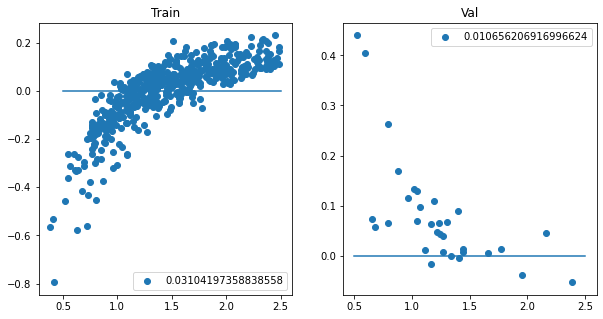

71/71 [==============================] - 27s 380ms/step - loss: 0.0031 - val_loss: 0.0107
Epoch 136/300
71/71 [==============================] - ETA: 0s - loss: 0.0030

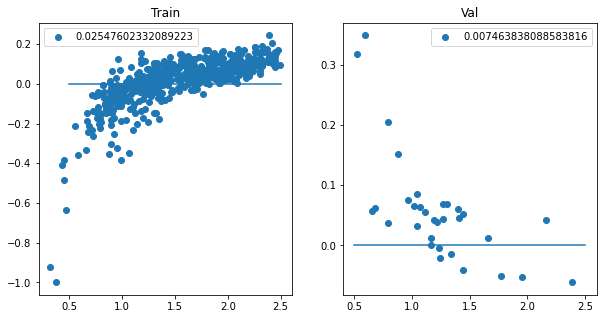

71/71 [==============================] - 27s 380ms/step - loss: 0.0030 - val_loss: 0.0075
Epoch 137/300
71/71 [==============================] - ETA: 0s - loss: 0.0033

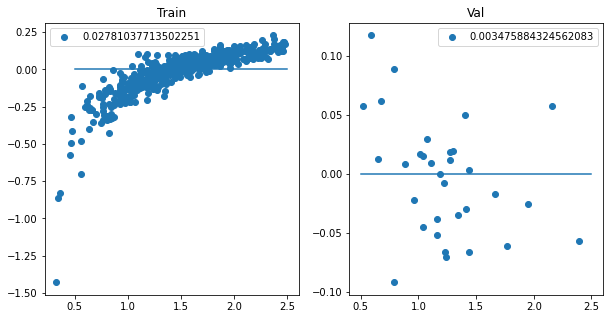

71/71 [==============================] - 28s 394ms/step - loss: 0.0033 - val_loss: 0.0035
Epoch 138/300
71/71 [==============================] - ETA: 0s - loss: 0.0030

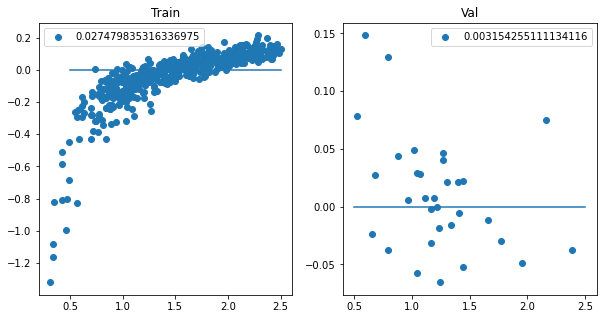

71/71 [==============================] - 27s 380ms/step - loss: 0.0030 - val_loss: 0.0032
Epoch 139/300
71/71 [==============================] - ETA: 0s - loss: 0.0028

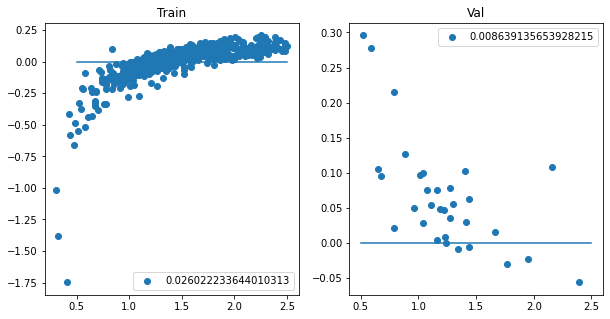

71/71 [==============================] - 28s 391ms/step - loss: 0.0028 - val_loss: 0.0086
Epoch 140/300
71/71 [==============================] - ETA: 0s - loss: 0.0029

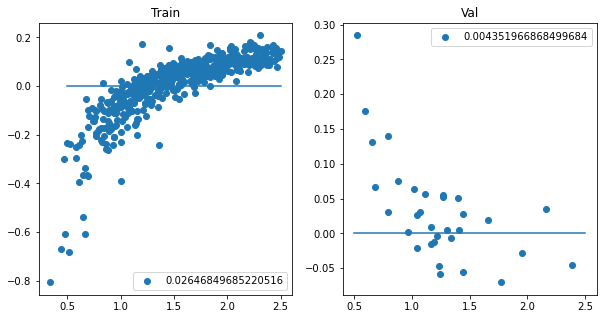

71/71 [==============================] - 27s 386ms/step - loss: 0.0029 - val_loss: 0.0044
Epoch 141/300
71/71 [==============================] - ETA: 0s - loss: 0.0031

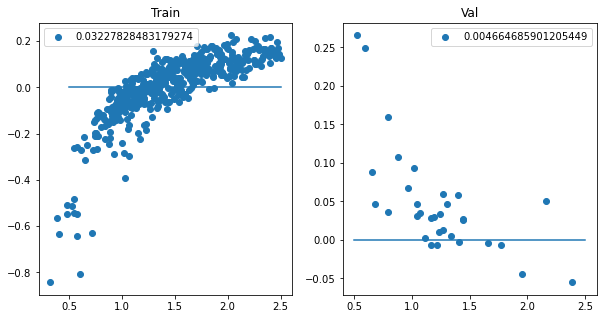

71/71 [==============================] - 27s 384ms/step - loss: 0.0031 - val_loss: 0.0047
Epoch 142/300
71/71 [==============================] - ETA: 0s - loss: 0.0027

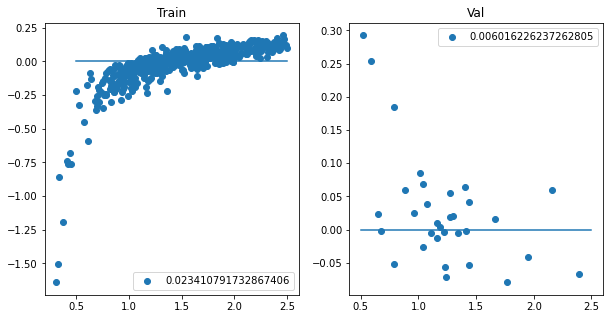

71/71 [==============================] - 30s 417ms/step - loss: 0.0027 - val_loss: 0.0060
Epoch 143/300
71/71 [==============================] - ETA: 0s - loss: 0.0027

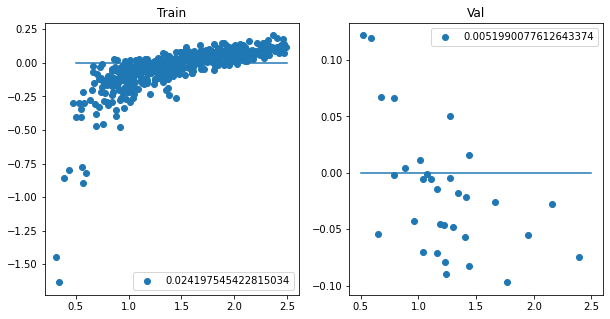

71/71 [==============================] - 27s 387ms/step - loss: 0.0027 - val_loss: 0.0052
Epoch 144/300
71/71 [==============================] - ETA: 0s - loss: 0.0031

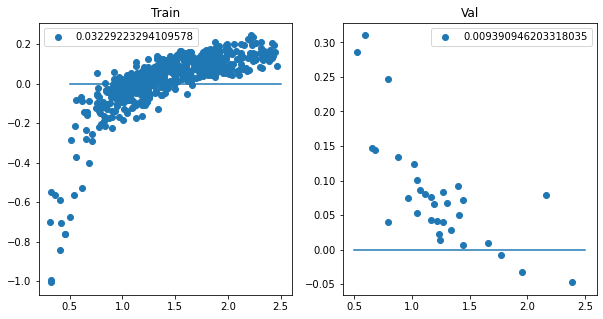

71/71 [==============================] - 28s 390ms/step - loss: 0.0031 - val_loss: 0.0094
Epoch 145/300
71/71 [==============================] - ETA: 0s - loss: 0.0035

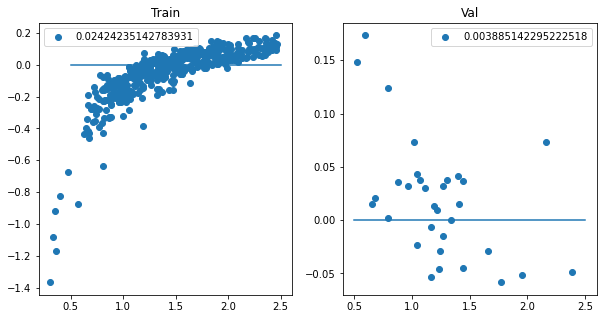

71/71 [==============================] - 27s 384ms/step - loss: 0.0035 - val_loss: 0.0039
Epoch 146/300
71/71 [==============================] - ETA: 0s - loss: 0.0031

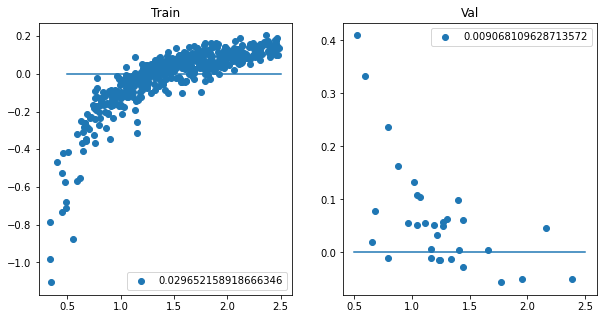

71/71 [==============================] - 27s 380ms/step - loss: 0.0031 - val_loss: 0.0091
Epoch 147/300
71/71 [==============================] - ETA: 0s - loss: 0.0031

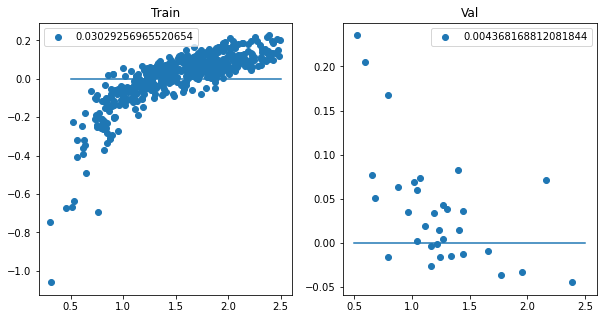

71/71 [==============================] - 27s 378ms/step - loss: 0.0031 - val_loss: 0.0044
Epoch 148/300
71/71 [==============================] - ETA: 0s - loss: 0.0028

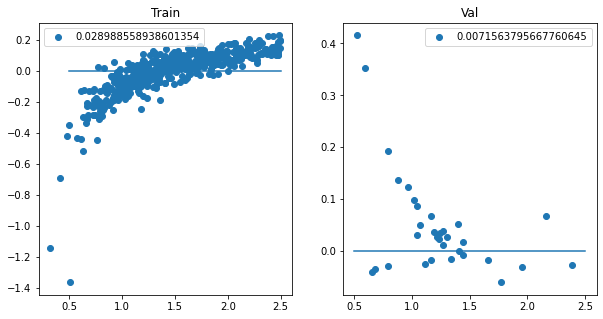

71/71 [==============================] - 28s 388ms/step - loss: 0.0028 - val_loss: 0.0072
Epoch 149/300
71/71 [==============================] - ETA: 0s - loss: 0.0027

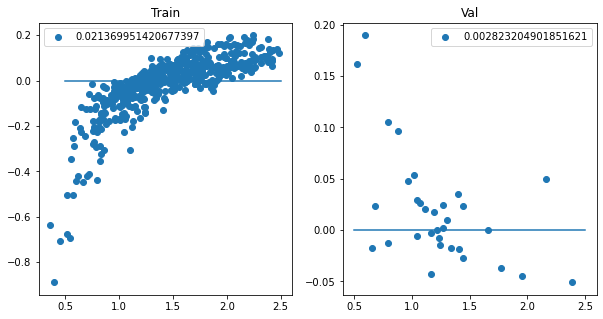

71/71 [==============================] - 28s 392ms/step - loss: 0.0027 - val_loss: 0.0028
Epoch 150/300
71/71 [==============================] - ETA: 0s - loss: 0.0029

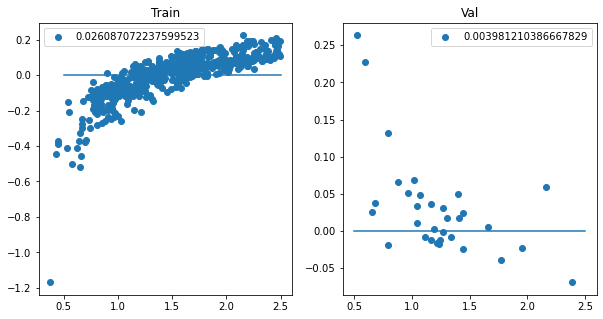

71/71 [==============================] - 27s 380ms/step - loss: 0.0029 - val_loss: 0.0040
Epoch 151/300
71/71 [==============================] - ETA: 0s - loss: 0.0025

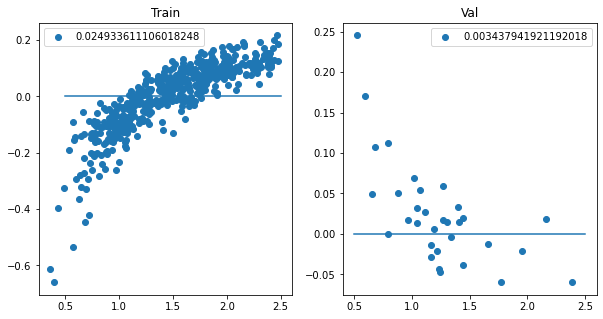

71/71 [==============================] - 27s 377ms/step - loss: 0.0025 - val_loss: 0.0034
Epoch 152/300
71/71 [==============================] - ETA: 0s - loss: 0.0031

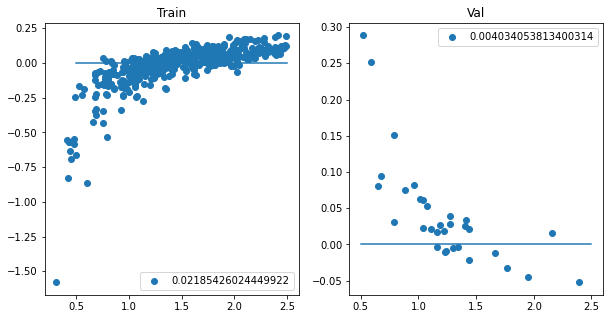

71/71 [==============================] - 27s 380ms/step - loss: 0.0031 - val_loss: 0.0040
Epoch 153/300
71/71 [==============================] - ETA: 0s - loss: 0.0030

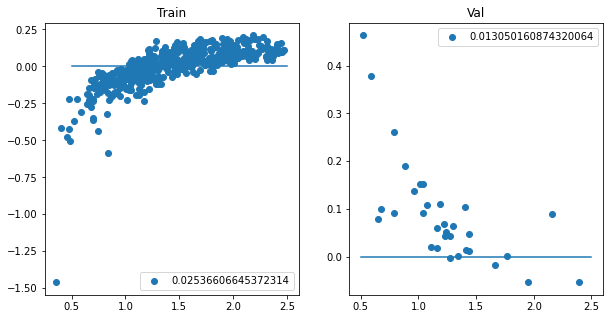

71/71 [==============================] - 28s 392ms/step - loss: 0.0030 - val_loss: 0.0131
Epoch 154/300
71/71 [==============================] - ETA: 0s - loss: 0.0027

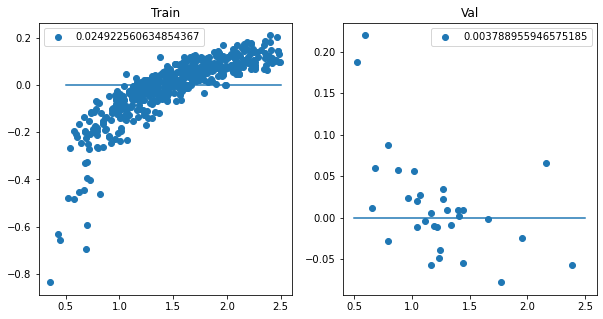

71/71 [==============================] - 29s 402ms/step - loss: 0.0027 - val_loss: 0.0038
Epoch 155/300
71/71 [==============================] - ETA: 0s - loss: 0.0025

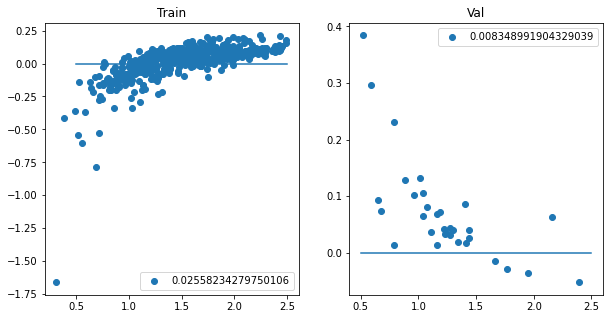

71/71 [==============================] - 27s 382ms/step - loss: 0.0025 - val_loss: 0.0083
Epoch 156/300
71/71 [==============================] - ETA: 0s - loss: 0.0025

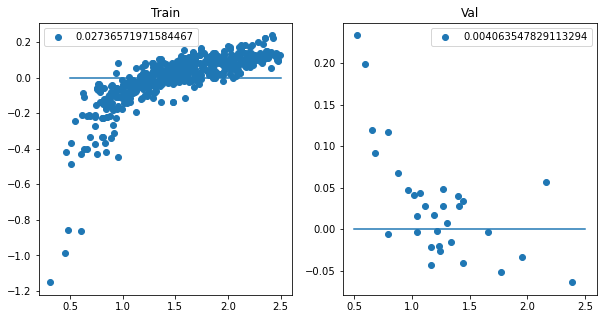

71/71 [==============================] - 27s 384ms/step - loss: 0.0025 - val_loss: 0.0041
Epoch 157/300
71/71 [==============================] - ETA: 0s - loss: 0.0026

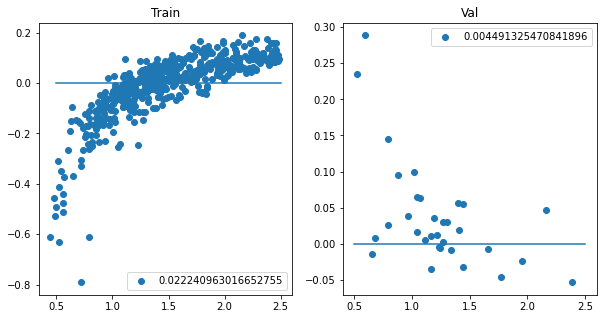

71/71 [==============================] - 27s 382ms/step - loss: 0.0026 - val_loss: 0.0045
Epoch 158/300
71/71 [==============================] - ETA: 0s - loss: 0.0028

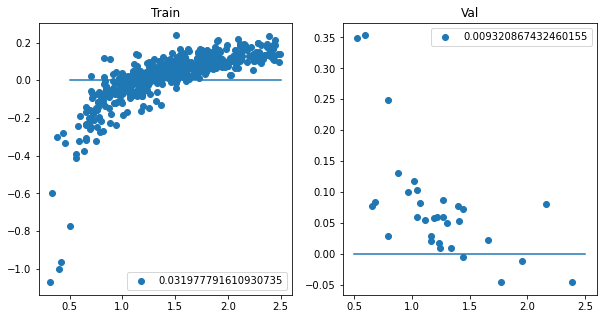

71/71 [==============================] - 28s 388ms/step - loss: 0.0028 - val_loss: 0.0093
Epoch 159/300
71/71 [==============================] - ETA: 0s - loss: 0.0026

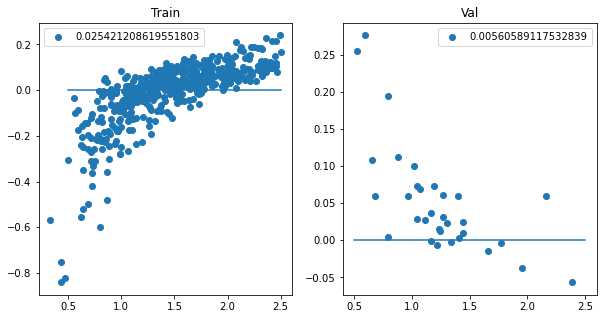

71/71 [==============================] - 28s 391ms/step - loss: 0.0026 - val_loss: 0.0056
Epoch 160/300
71/71 [==============================] - ETA: 0s - loss: 0.0023

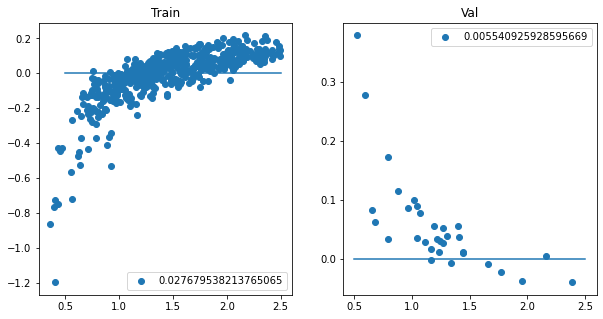

71/71 [==============================] - 27s 387ms/step - loss: 0.0023 - val_loss: 0.0055
Epoch 161/300
71/71 [==============================] - ETA: 0s - loss: 0.0023

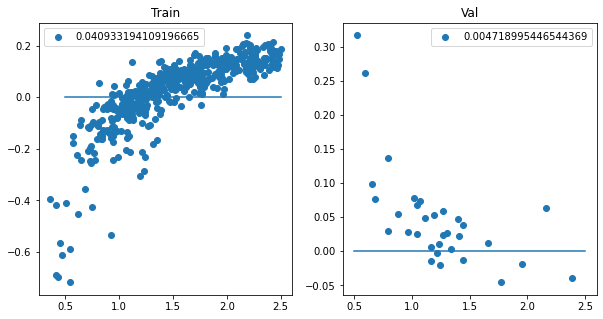

71/71 [==============================] - 27s 381ms/step - loss: 0.0023 - val_loss: 0.0047
Epoch 162/300
71/71 [==============================] - ETA: 0s - loss: 0.0023

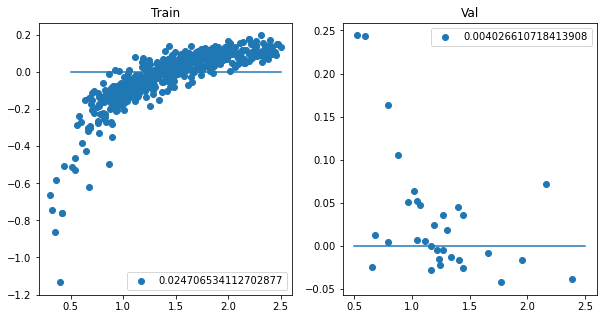

71/71 [==============================] - 27s 381ms/step - loss: 0.0023 - val_loss: 0.0040
Epoch 163/300
71/71 [==============================] - ETA: 0s - loss: 0.0029

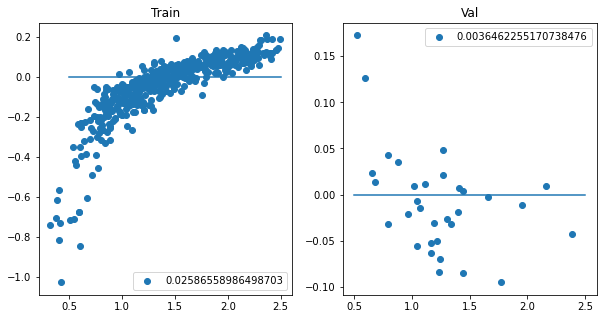

71/71 [==============================] - 27s 382ms/step - loss: 0.0029 - val_loss: 0.0036
Epoch 164/300
71/71 [==============================] - ETA: 0s - loss: 0.0023

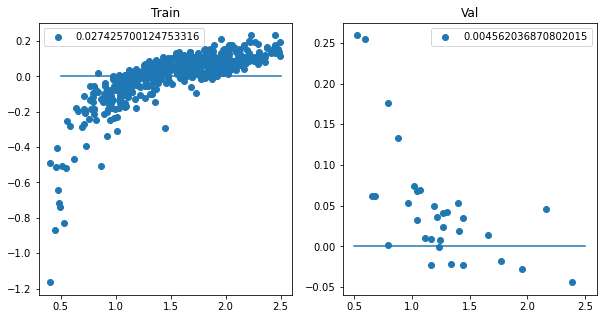

71/71 [==============================] - 27s 380ms/step - loss: 0.0023 - val_loss: 0.0046
Epoch 165/300
71/71 [==============================] - ETA: 0s - loss: 0.0024

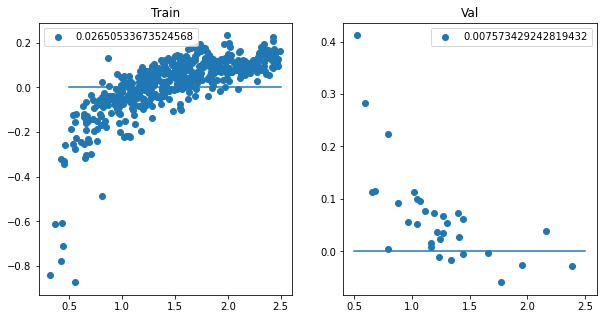

71/71 [==============================] - 28s 401ms/step - loss: 0.0024 - val_loss: 0.0076
Epoch 166/300
71/71 [==============================] - ETA: 0s - loss: 0.0021

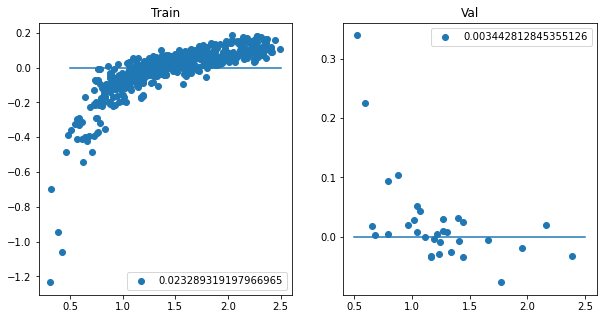

71/71 [==============================] - 27s 383ms/step - loss: 0.0021 - val_loss: 0.0034
Epoch 167/300
71/71 [==============================] - ETA: 0s - loss: 0.0022

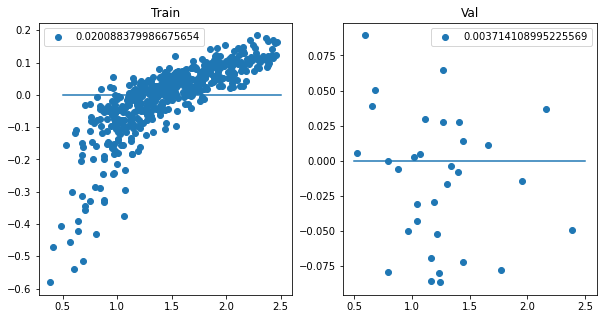

71/71 [==============================] - 27s 386ms/step - loss: 0.0022 - val_loss: 0.0037
Epoch 168/300
71/71 [==============================] - ETA: 0s - loss: 0.0028

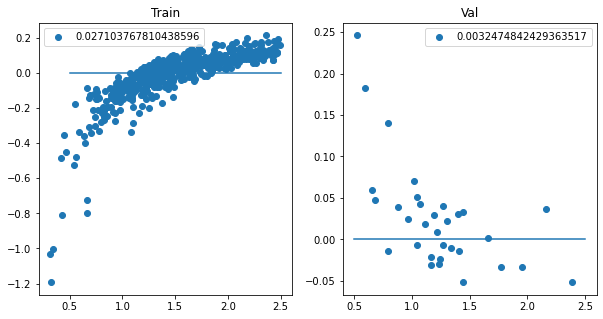

71/71 [==============================] - 27s 381ms/step - loss: 0.0028 - val_loss: 0.0032
Epoch 169/300
71/71 [==============================] - ETA: 0s - loss: 0.0023

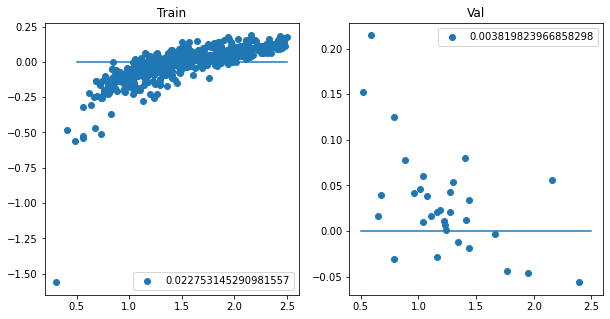

71/71 [==============================] - 28s 389ms/step - loss: 0.0023 - val_loss: 0.0038
Epoch 170/300
71/71 [==============================] - ETA: 0s - loss: 0.0023

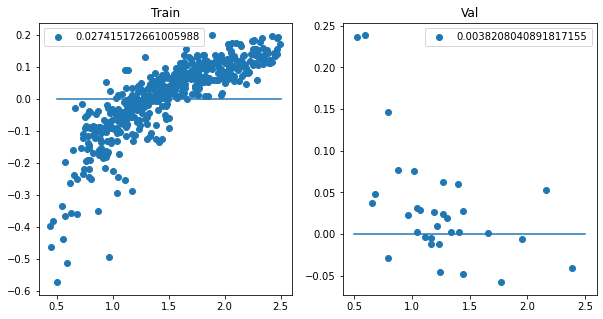

71/71 [==============================] - 27s 377ms/step - loss: 0.0023 - val_loss: 0.0038
Epoch 171/300
71/71 [==============================] - ETA: 0s - loss: 0.0024

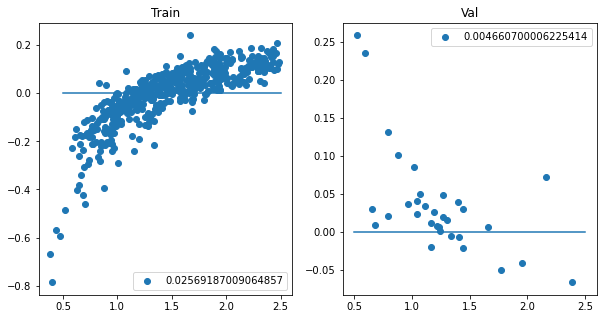

71/71 [==============================] - 27s 378ms/step - loss: 0.0024 - val_loss: 0.0047
Epoch 172/300
71/71 [==============================] - ETA: 0s - loss: 0.0021

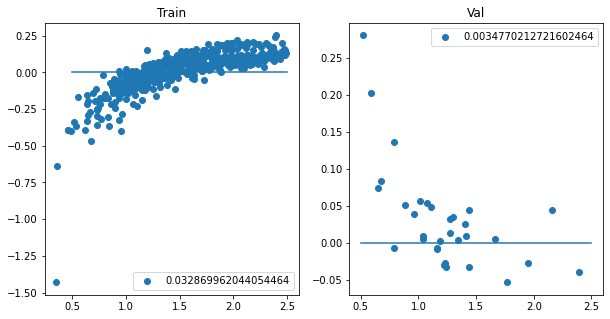

71/71 [==============================] - 27s 379ms/step - loss: 0.0021 - val_loss: 0.0035
Epoch 173/300
71/71 [==============================] - ETA: 0s - loss: 0.0026

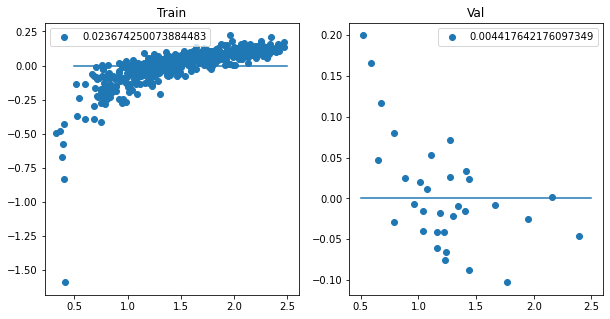

71/71 [==============================] - 27s 378ms/step - loss: 0.0026 - val_loss: 0.0044
Epoch 174/300
71/71 [==============================] - ETA: 0s - loss: 0.0023

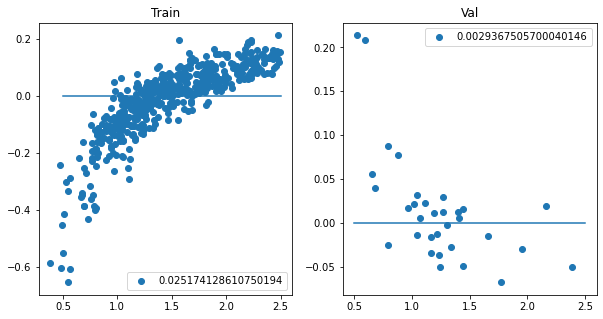

71/71 [==============================] - 27s 379ms/step - loss: 0.0023 - val_loss: 0.0029
Epoch 175/300
71/71 [==============================] - ETA: 0s - loss: 0.0023

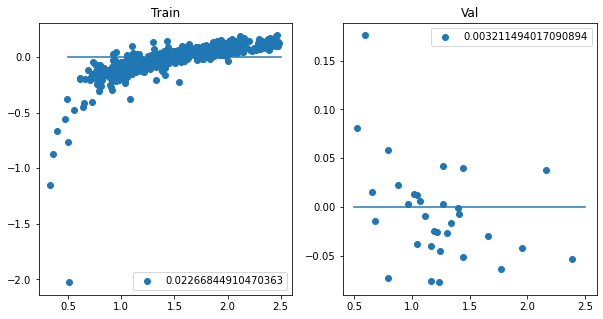

71/71 [==============================] - 27s 387ms/step - loss: 0.0023 - val_loss: 0.0032
Epoch 176/300
71/71 [==============================] - ETA: 0s - loss: 0.0022

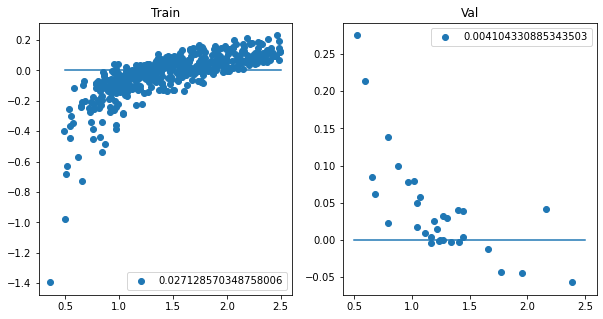

71/71 [==============================] - 27s 379ms/step - loss: 0.0022 - val_loss: 0.0041
Epoch 177/300
71/71 [==============================] - ETA: 0s - loss: 0.0025

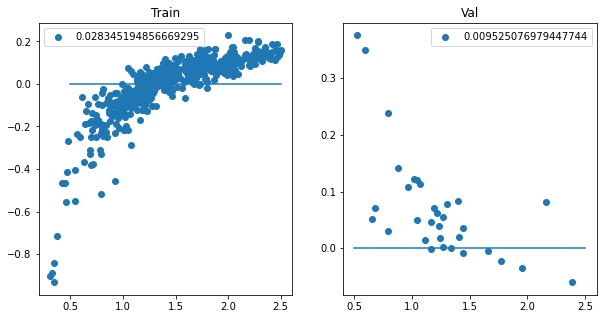

71/71 [==============================] - 27s 379ms/step - loss: 0.0025 - val_loss: 0.0095
Epoch 178/300
71/71 [==============================] - ETA: 0s - loss: 0.0027

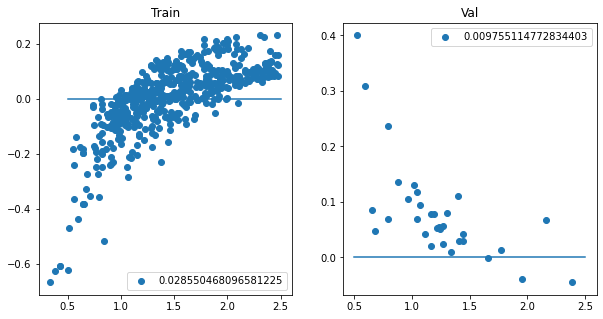

71/71 [==============================] - 27s 380ms/step - loss: 0.0027 - val_loss: 0.0098
Epoch 179/300
71/71 [==============================] - ETA: 0s - loss: 0.0023

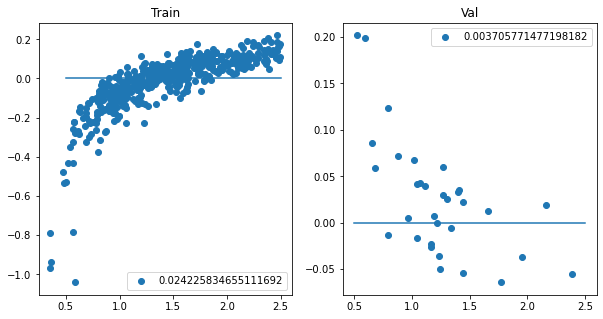

71/71 [==============================] - 27s 387ms/step - loss: 0.0023 - val_loss: 0.0037
Epoch 180/300
71/71 [==============================] - ETA: 0s - loss: 0.0021

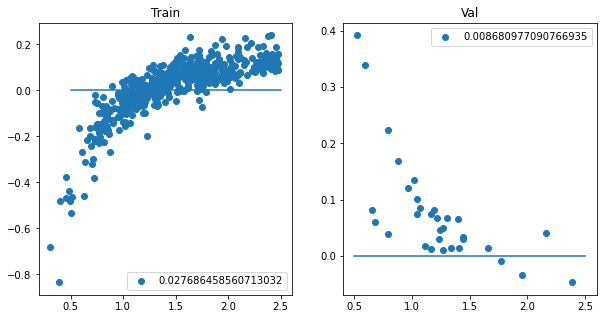

71/71 [==============================] - 28s 388ms/step - loss: 0.0021 - val_loss: 0.0087
Epoch 181/300
71/71 [==============================] - ETA: 0s - loss: 0.0019

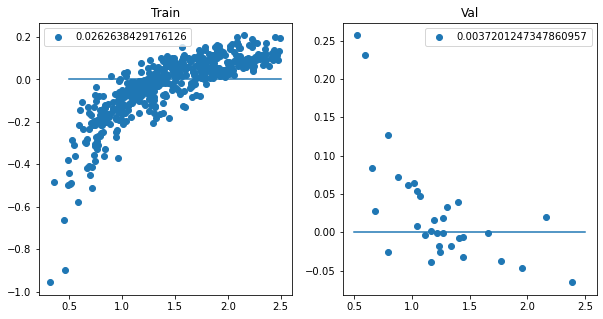

71/71 [==============================] - 27s 380ms/step - loss: 0.0019 - val_loss: 0.0037
Epoch 182/300
71/71 [==============================] - ETA: 0s - loss: 0.0017

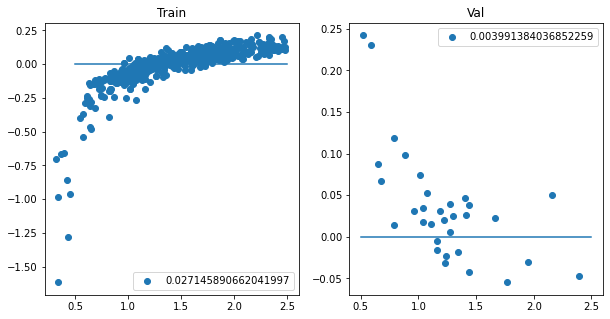

71/71 [==============================] - 27s 380ms/step - loss: 0.0017 - val_loss: 0.0040
Epoch 183/300
71/71 [==============================] - ETA: 0s - loss: 0.0018

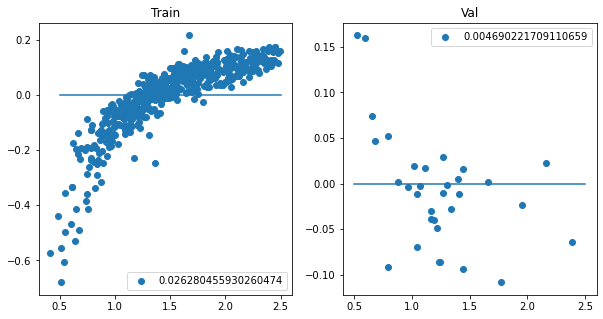

71/71 [==============================] - 27s 379ms/step - loss: 0.0018 - val_loss: 0.0047
Epoch 184/300
71/71 [==============================] - ETA: 0s - loss: 0.0022

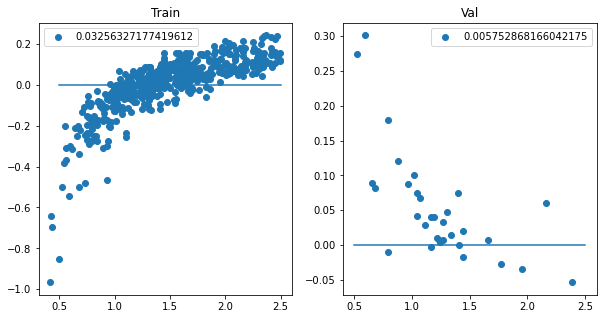

71/71 [==============================] - 27s 379ms/step - loss: 0.0022 - val_loss: 0.0058
Epoch 185/300
71/71 [==============================] - ETA: 0s - loss: 0.0020

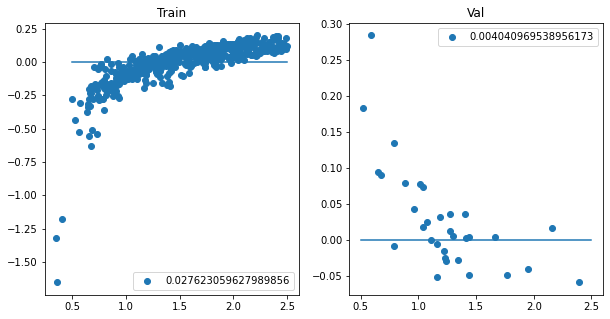

71/71 [==============================] - 27s 384ms/step - loss: 0.0020 - val_loss: 0.0040
Epoch 186/300
71/71 [==============================] - ETA: 0s - loss: 0.0020

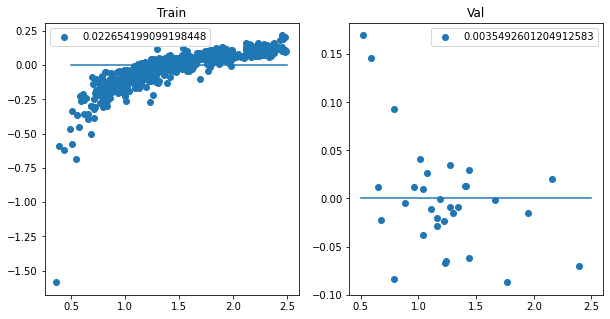

71/71 [==============================] - 27s 381ms/step - loss: 0.0020 - val_loss: 0.0035
Epoch 187/300
71/71 [==============================] - ETA: 0s - loss: 0.0022

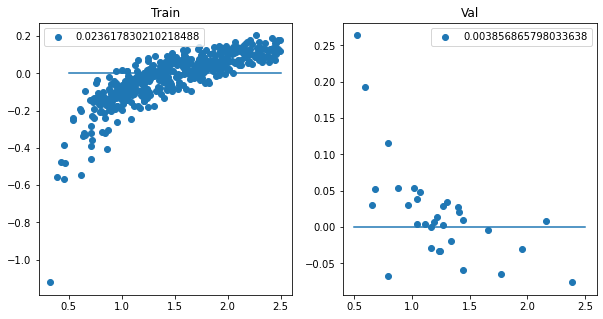

71/71 [==============================] - 27s 381ms/step - loss: 0.0022 - val_loss: 0.0039
Epoch 188/300
71/71 [==============================] - ETA: 0s - loss: 0.0023

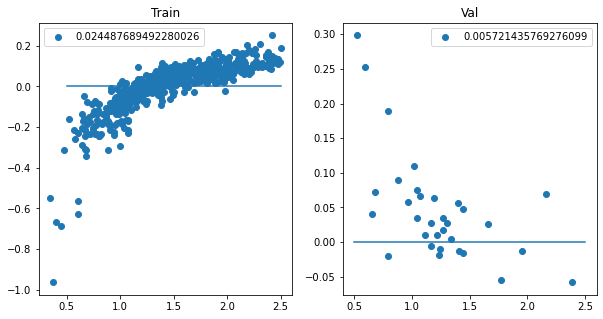

71/71 [==============================] - 29s 406ms/step - loss: 0.0023 - val_loss: 0.0057
Epoch 189/300
71/71 [==============================] - ETA: 0s - loss: 0.0020

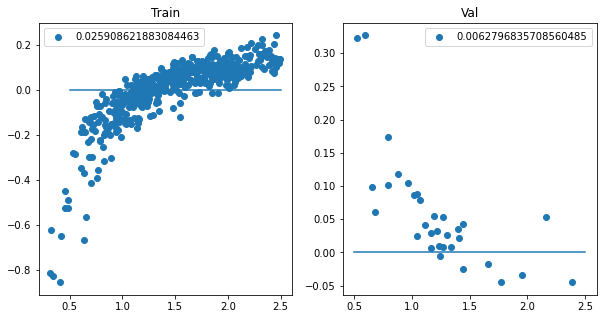

71/71 [==============================] - 27s 386ms/step - loss: 0.0020 - val_loss: 0.0063
Epoch 190/300
71/71 [==============================] - ETA: 0s - loss: 0.0020

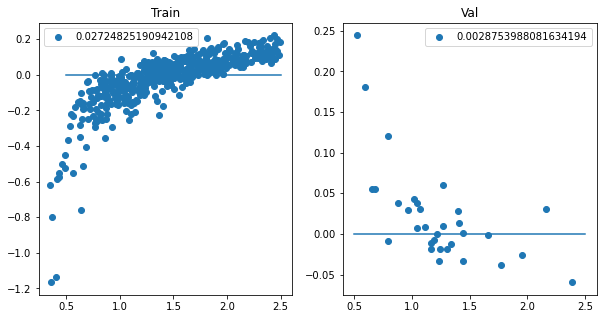

71/71 [==============================] - 28s 393ms/step - loss: 0.0020 - val_loss: 0.0029
Epoch 191/300
71/71 [==============================] - ETA: 0s - loss: 0.0023

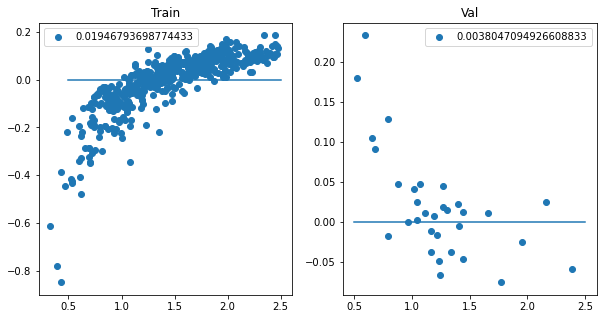

71/71 [==============================] - 28s 387ms/step - loss: 0.0023 - val_loss: 0.0038
Epoch 192/300
71/71 [==============================] - ETA: 0s - loss: 0.0024

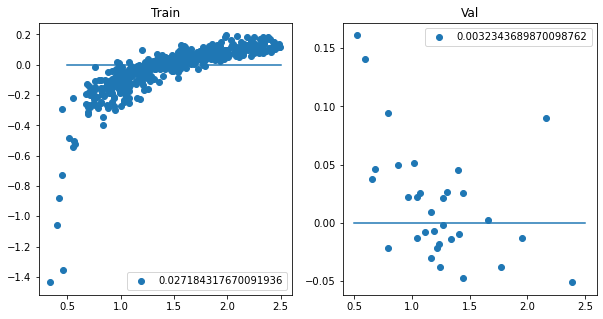

71/71 [==============================] - 28s 391ms/step - loss: 0.0024 - val_loss: 0.0032
Epoch 193/300
71/71 [==============================] - ETA: 0s - loss: 0.0019

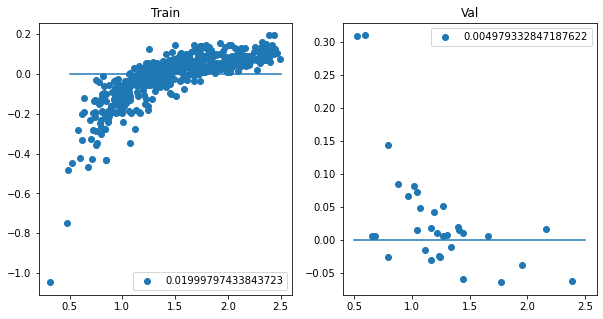

71/71 [==============================] - 27s 386ms/step - loss: 0.0019 - val_loss: 0.0050
Epoch 194/300
71/71 [==============================] - ETA: 0s - loss: 0.0021

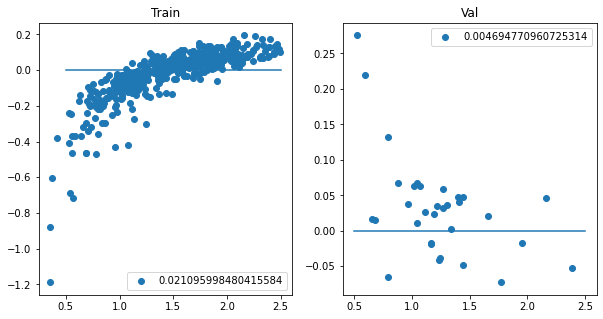

71/71 [==============================] - 27s 382ms/step - loss: 0.0021 - val_loss: 0.0047
Epoch 195/300
71/71 [==============================] - ETA: 0s - loss: 0.0019

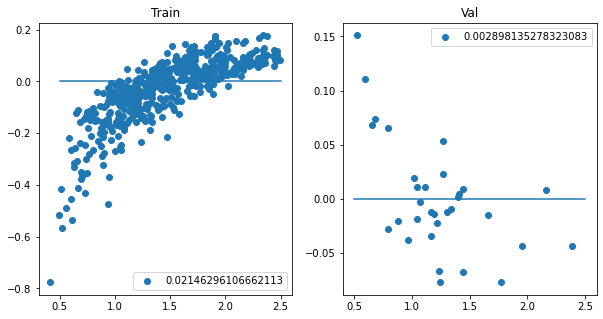

71/71 [==============================] - 27s 377ms/step - loss: 0.0019 - val_loss: 0.0029
Epoch 196/300
71/71 [==============================] - ETA: 0s - loss: 0.0022

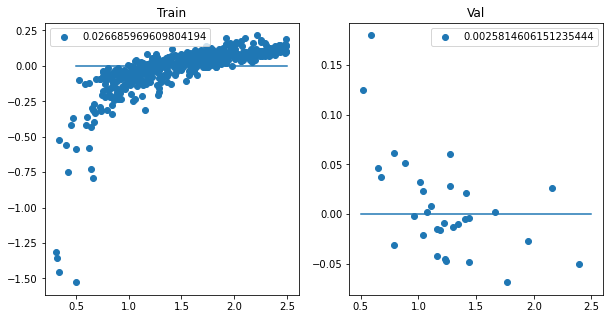

71/71 [==============================] - 27s 381ms/step - loss: 0.0022 - val_loss: 0.0026
Epoch 197/300
71/71 [==============================] - ETA: 0s - loss: 0.0019

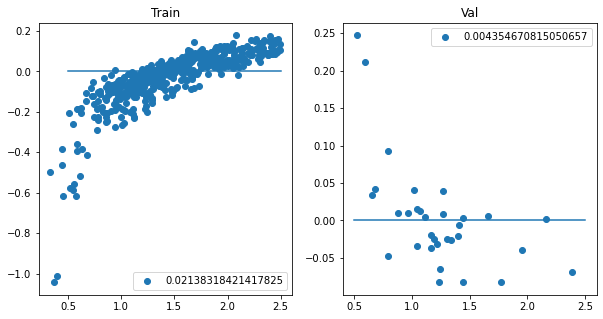

71/71 [==============================] - 28s 388ms/step - loss: 0.0019 - val_loss: 0.0044
Epoch 198/300
71/71 [==============================] - ETA: 0s - loss: 0.0017

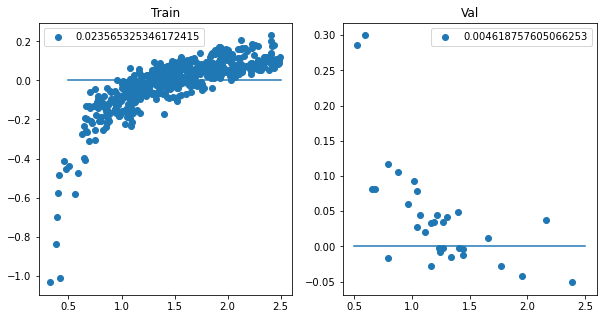

71/71 [==============================] - 27s 378ms/step - loss: 0.0017 - val_loss: 0.0046
Epoch 199/300
71/71 [==============================] - ETA: 0s - loss: 0.0016

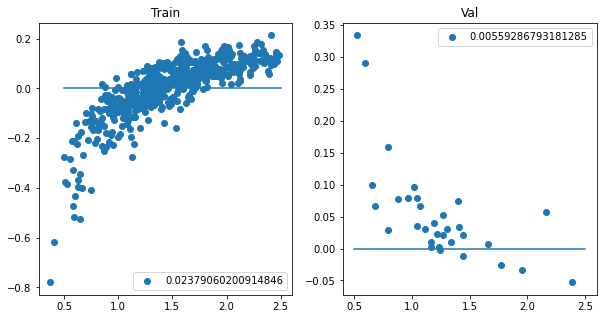

71/71 [==============================] - 27s 378ms/step - loss: 0.0016 - val_loss: 0.0056
Epoch 200/300
71/71 [==============================] - ETA: 0s - loss: 0.0021

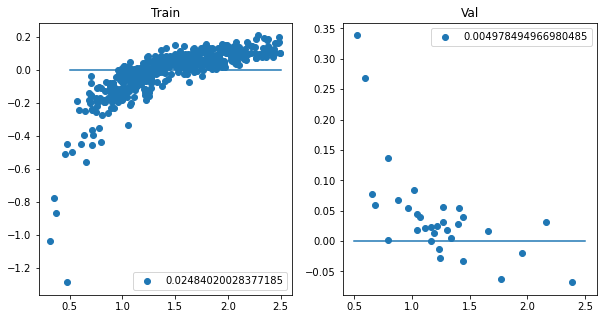

71/71 [==============================] - 27s 384ms/step - loss: 0.0021 - val_loss: 0.0050
Epoch 201/300
71/71 [==============================] - ETA: 0s - loss: 0.0020

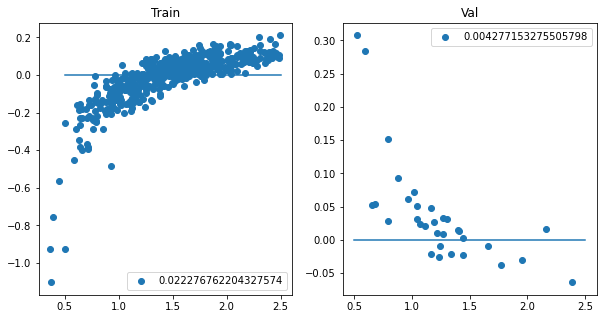

71/71 [==============================] - 28s 389ms/step - loss: 0.0020 - val_loss: 0.0043
Epoch 202/300
71/71 [==============================] - ETA: 0s - loss: 0.0018

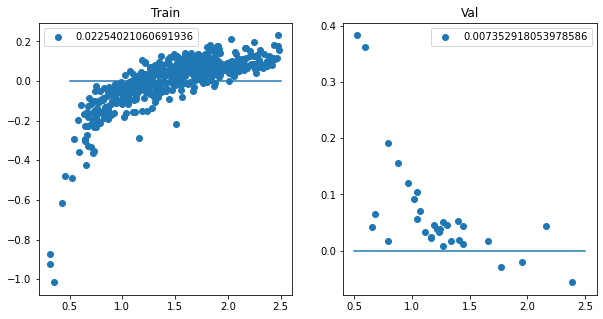

71/71 [==============================] - 27s 386ms/step - loss: 0.0018 - val_loss: 0.0074
Epoch 203/300
71/71 [==============================] - ETA: 0s - loss: 0.0020

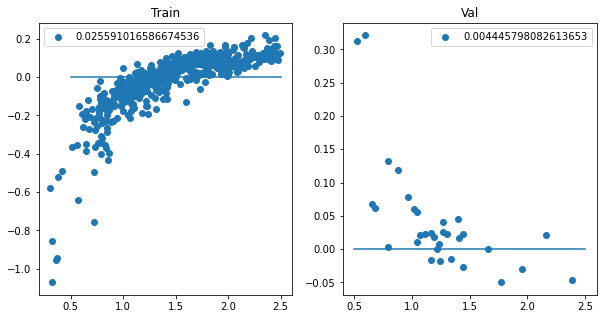

71/71 [==============================] - 28s 388ms/step - loss: 0.0020 - val_loss: 0.0044
Epoch 204/300
71/71 [==============================] - ETA: 0s - loss: 0.0015

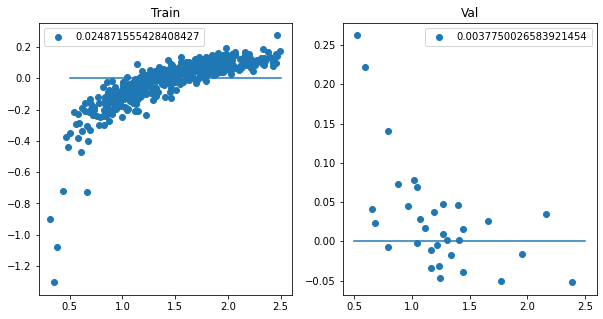

71/71 [==============================] - 28s 399ms/step - loss: 0.0015 - val_loss: 0.0038
Epoch 205/300
71/71 [==============================] - ETA: 0s - loss: 0.0015

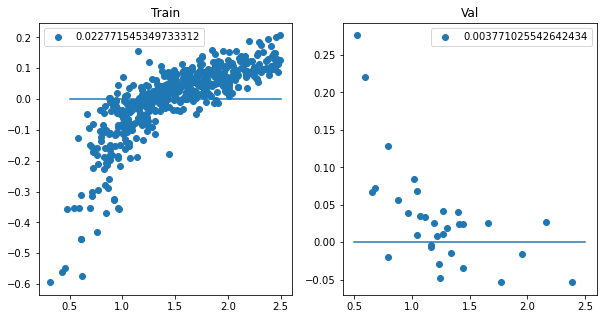

71/71 [==============================] - 27s 387ms/step - loss: 0.0015 - val_loss: 0.0038
Epoch 206/300
71/71 [==============================] - ETA: 0s - loss: 0.0015

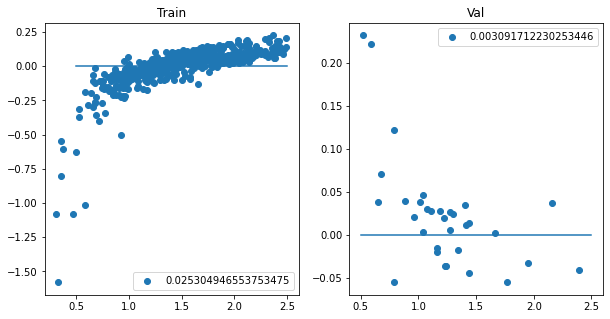

71/71 [==============================] - 27s 385ms/step - loss: 0.0015 - val_loss: 0.0031
Epoch 207/300
71/71 [==============================] - ETA: 0s - loss: 0.0017

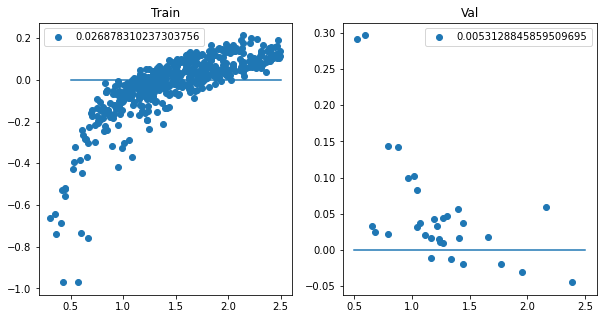

71/71 [==============================] - 27s 386ms/step - loss: 0.0017 - val_loss: 0.0053
Epoch 208/300
71/71 [==============================] - ETA: 0s - loss: 0.0019

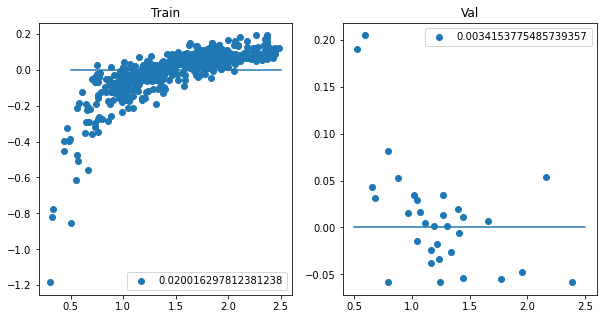

71/71 [==============================] - 27s 386ms/step - loss: 0.0019 - val_loss: 0.0034
Epoch 209/300
71/71 [==============================] - ETA: 0s - loss: 0.0020

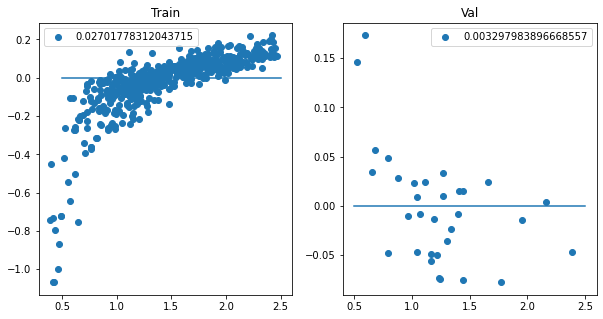

71/71 [==============================] - 27s 378ms/step - loss: 0.0020 - val_loss: 0.0033
Epoch 210/300
71/71 [==============================] - ETA: 0s - loss: 0.0019

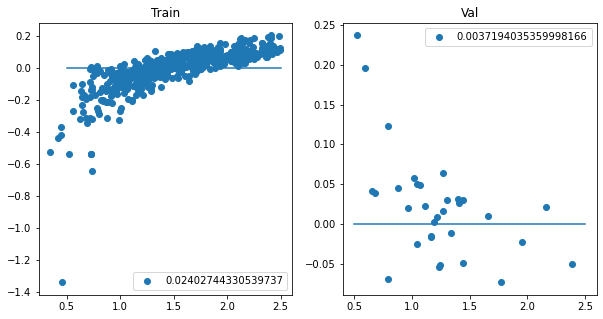

71/71 [==============================] - 27s 380ms/step - loss: 0.0019 - val_loss: 0.0037
Epoch 211/300
71/71 [==============================] - ETA: 0s - loss: 0.0020

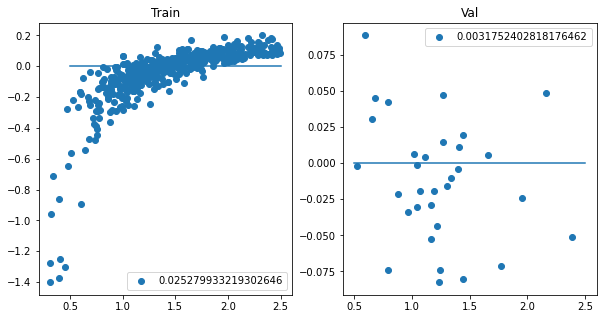

71/71 [==============================] - 28s 399ms/step - loss: 0.0020 - val_loss: 0.0032
Epoch 212/300
61/71 [========================>.....] - ETA: 3s - loss: 0.0018

KeyboardInterrupt: 

In [541]:
globalize(model, batch_size, X_train, Y_train, X_val, Y_val)
model.outter_data(X_val, Y_val, k = 32, evenly = True)
model.fit(gen_flow, epochs = 300, validation_data = (X_val, Y_val), callbacks=[Dispersion()])

### Dataset Slice Test

In [240]:
def slice_dataset(min_val, max_val, data):
    return np.where((data > min_val) & (data < max_val))[0]

In [241]:
idx_train = slice_dataset(0.0, 1.10, Y_train)
idx_val = slice_dataset(0.0, 1.10, Y_val)
X_train_slice1 = X_train[idx_train]
Y_train_slice1 = Y_train[idx_train]
X_val_slice1 = X_val[idx_val]
Y_val_slice1 = Y_val[idx_val]

In [251]:
inp = ResNet10V2(X_val[0,:,:,:].shape)
y_hat = tf.keras.layers.Dense(1)(inp.layers[-2].output)

model = tf.keras.models.Model(inputs = inp.input, outputs = y_hat)
model.compile(optimizer = optimizer, loss = "mse")

In [252]:

gen = tf.keras.preprocessing.image.ImageDataGenerator(
		#rotation_range=180,
		#zoom_range=0.10,
        #brightness_range = [0.90, 1.10],
        #preprocessing_function = lambda x : tf.add(x, tf.random.normal(shape=tf.shape(x), mean=0.0, stddev=1.0, dtype=tf.float32)),
		#vertical_flip = True,
        #horizontal_flip=True,
		fill_mode="nearest")

gen_flow = gen.flow(X_train_slice1, Y_train_slice1,  batch_size=batch_size, seed=1)

In [ ]:
globalize(model, batch_size, X_train_slice1, Y_train_slice1, X_val_slice1, Y_val_slice1)
model.fit(gen_flow, epochs = 300, validation_data = (X_val_slice1, Y_val_slice1), callbacks=[Dispersion()])

### Adversarial Realm

In [243]:
class Adversarial(tf.keras.Model):
    def __init__(self, data):
        super().__init__()
        self.data = data
        self.output_names = ['mse', 'adversarial']
        inp = ResNet10V2(data[0,:,:,:].shape)
        self.feature_extractor = tf.keras.models.Model(inputs = inp.input, outputs = inp.layers[-2].output)
        
        self.regressor = tf.keras.Sequential([tf.keras.layers.Dense(1)])
        
        self.similarity = tf.keras.Sequential([tf.keras.layers.Dense(1, activation = 'sigmoid')])

    def call(self, x):
        fill = tf.random.uniform((x.shape[0],), 0, self.data.shape[0], dtype='int32')
        features_val = self.feature_extractor(self.data[fill], training = True)
        features_train = self.feature_extractor(x)
        y_hat_re = self.regressor(features_train)
        y_hat_si = self.similarity(tf.concat([features_train,features_val], axis=1))
        return [y_hat_re, y_hat_si]


In [244]:
model = Adversarial(X_val)

In [245]:
class AdversarialLoss(tf.keras.losses.Loss):
    def __init__(self, *args, **kwargs):
        super().__init__()
        self.bce = tf.keras.losses.BinaryCrossentropy()
    def call(self, y_true, y_pred):
        return self.bce(tf.ones_like(y_pred), y_pred)
    
model.compile(optimizer = optimizer, loss = ["mse", AdversarialLoss()], run_eagerly = True)

In [246]:

gen = tf.keras.preprocessing.image.ImageDataGenerator(fill_mode="nearest")
gen_flow = gen.flow(X_train, Y_train,  batch_size=batch_size, seed=1)

In [247]:
import numpy as np
import matplotlib.pyplot as plt

class AdversarialDispersion(tf.keras.callbacks.Callback):
    def on_epoch_end(self, epoch, logs=None):
        
        fig, ax = plt.subplots(1,2, figsize = (10,5))
        
        indexes = np.random.randint(X_train.shape[0], size=batch_size)
        pred_train = model.predict(X_train[indexes])[0]
        error_train = (Y_train[indexes] - pred_train) / Y_train[indexes]
        ax[0].scatter(Y_train[indexes], error_train)
        ax[0].set_title('Train')
        ax[0].legend(sum(np.square(Y_train[indexes] - pred_train)) / batch_size)
        ax[0].plot((0.5,2.5), (0,0))
        
        
        
        pred_val = model.predict(X_val)[0]
        error_val = (Y_val - pred_val) / Y_val
        ax[1].scatter(Y_val, error_val)
        ax[1].legend(sum(np.square(Y_val - pred_val)) / pred_val.shape[0])
        ax[1].plot((0.5,2.5), (0,0))
        ax[1].set_title('Val')
        plt.show()

Epoch 1/300
71/71 [==============================] - ETA: 0s - loss: 0.4695 - mse_loss: 0.4323 - adversarial_loss: 0.0372

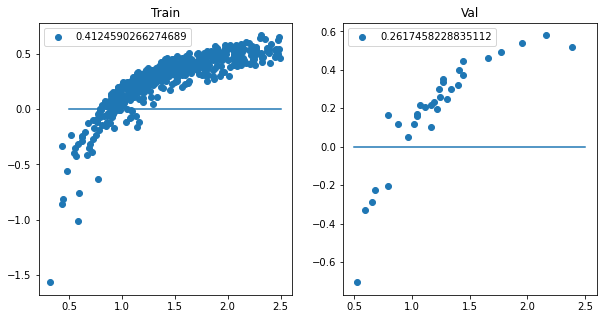

71/71 [==============================] - 30s 427ms/step - loss: 0.4695 - mse_loss: 0.4323 - adversarial_loss: 0.0372 - val_loss: 0.3381 - val_mse_loss: 0.3288 - val_adversarial_loss: 0.0093
Epoch 2/300
71/71 [==============================] - ETA: 0s - loss: 0.0892 - mse_loss: 0.0878 - adversarial_loss: 0.0014

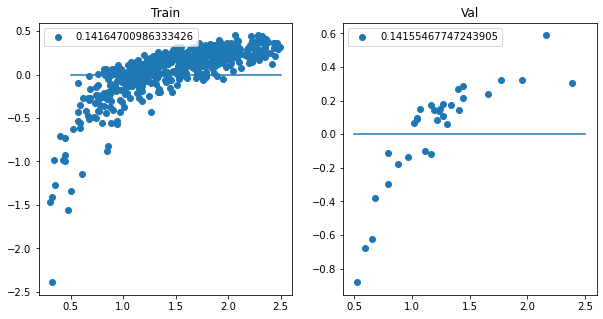

71/71 [==============================] - 30s 427ms/step - loss: 0.0892 - mse_loss: 0.0878 - adversarial_loss: 0.0014 - val_loss: 0.1533 - val_mse_loss: 0.1512 - val_adversarial_loss: 0.0021
Epoch 3/300
71/71 [==============================] - ETA: 0s - loss: 0.0759 - mse_loss: 0.0751 - adversarial_loss: 7.5904e-04

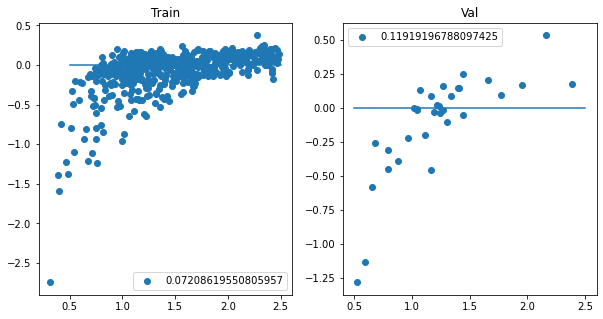

71/71 [==============================] - 30s 428ms/step - loss: 0.0759 - mse_loss: 0.0751 - adversarial_loss: 7.5904e-04 - val_loss: 0.1227 - val_mse_loss: 0.1220 - val_adversarial_loss: 7.2297e-04
Epoch 4/300
71/71 [==============================] - ETA: 0s - loss: 0.0679 - mse_loss: 0.0674 - adversarial_loss: 5.0542e-04

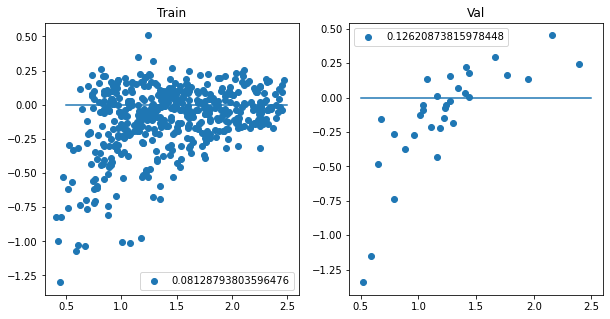

71/71 [==============================] - 30s 428ms/step - loss: 0.0679 - mse_loss: 0.0674 - adversarial_loss: 5.0542e-04 - val_loss: 0.1272 - val_mse_loss: 0.1268 - val_adversarial_loss: 4.1257e-04
Epoch 5/300
71/71 [==============================] - ETA: 0s - loss: 0.0641 - mse_loss: 0.0637 - adversarial_loss: 3.9098e-04

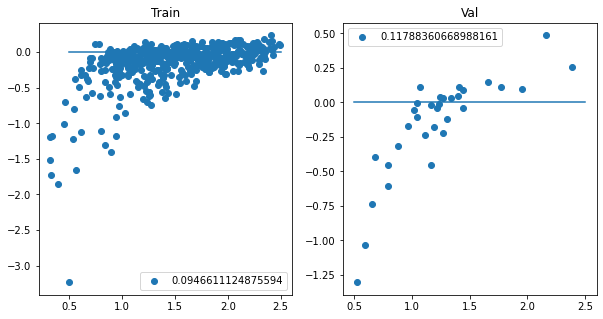

71/71 [==============================] - 31s 435ms/step - loss: 0.0641 - mse_loss: 0.0637 - adversarial_loss: 3.9098e-04 - val_loss: 0.1174 - val_mse_loss: 0.1171 - val_adversarial_loss: 3.0569e-04
Epoch 6/300
71/71 [==============================] - ETA: 0s - loss: 0.0570 - mse_loss: 0.0567 - adversarial_loss: 2.9283e-04

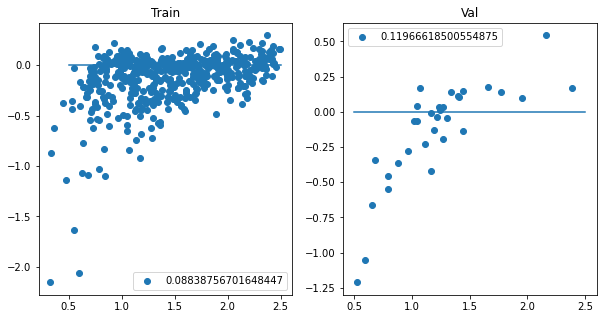

71/71 [==============================] - 31s 431ms/step - loss: 0.0570 - mse_loss: 0.0567 - adversarial_loss: 2.9283e-04 - val_loss: 0.1176 - val_mse_loss: 0.1173 - val_adversarial_loss: 2.8316e-04
Epoch 7/300
71/71 [==============================] - ETA: 0s - loss: 0.0532 - mse_loss: 0.0530 - adversarial_loss: 2.3353e-04

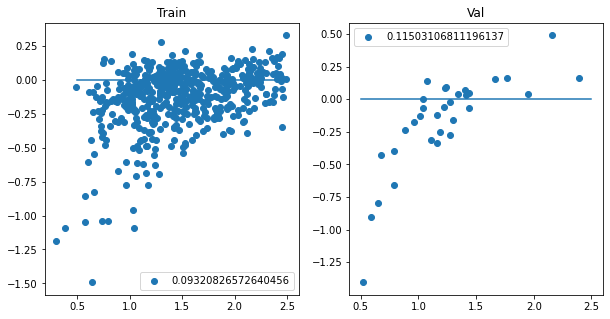

71/71 [==============================] - 30s 427ms/step - loss: 0.0532 - mse_loss: 0.0530 - adversarial_loss: 2.3353e-04 - val_loss: 0.1117 - val_mse_loss: 0.1115 - val_adversarial_loss: 1.7170e-04
Epoch 8/300
71/71 [==============================] - ETA: 0s - loss: 0.0480 - mse_loss: 0.0478 - adversarial_loss: 1.8620e-04

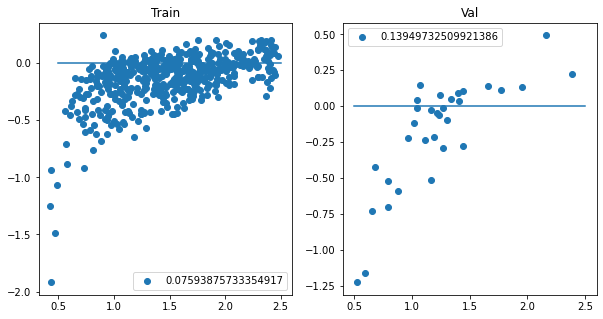

71/71 [==============================] - 30s 429ms/step - loss: 0.0480 - mse_loss: 0.0478 - adversarial_loss: 1.8620e-04 - val_loss: 0.1365 - val_mse_loss: 0.1364 - val_adversarial_loss: 1.7586e-04
Epoch 9/300
71/71 [==============================] - ETA: 0s - loss: 0.0440 - mse_loss: 0.0439 - adversarial_loss: 1.6004e-04

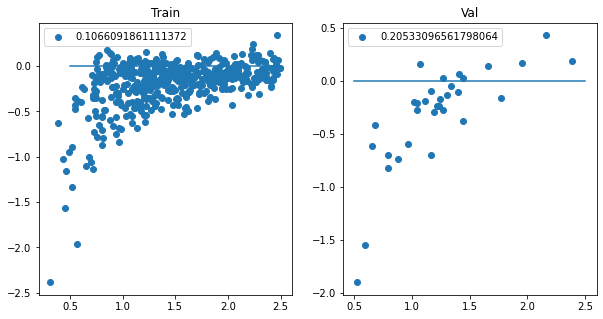

71/71 [==============================] - 30s 429ms/step - loss: 0.0440 - mse_loss: 0.0439 - adversarial_loss: 1.6004e-04 - val_loss: 0.2076 - val_mse_loss: 0.2075 - val_adversarial_loss: 1.1851e-04
Epoch 10/300
71/71 [==============================] - ETA: 0s - loss: 0.0410 - mse_loss: 0.0409 - adversarial_loss: 1.3396e-04

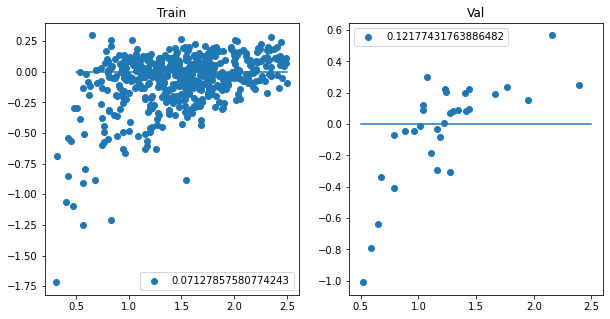

71/71 [==============================] - 30s 429ms/step - loss: 0.0410 - mse_loss: 0.0409 - adversarial_loss: 1.3396e-04 - val_loss: 0.1280 - val_mse_loss: 0.1279 - val_adversarial_loss: 9.5210e-05
Epoch 11/300
71/71 [==============================] - ETA: 0s - loss: 0.0384 - mse_loss: 0.0383 - adversarial_loss: 1.1893e-04

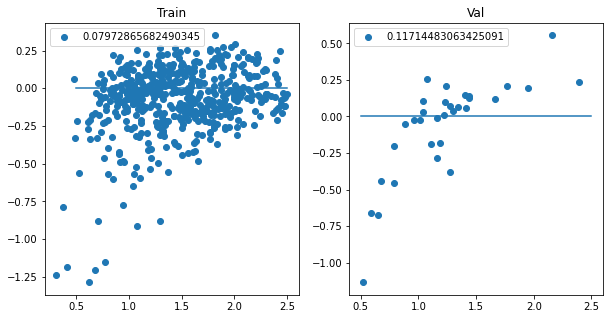

71/71 [==============================] - 30s 427ms/step - loss: 0.0384 - mse_loss: 0.0383 - adversarial_loss: 1.1893e-04 - val_loss: 0.1206 - val_mse_loss: 0.1205 - val_adversarial_loss: 7.6905e-05
Epoch 12/300
71/71 [==============================] - ETA: 0s - loss: 0.0348 - mse_loss: 0.0347 - adversarial_loss: 1.0699e-04

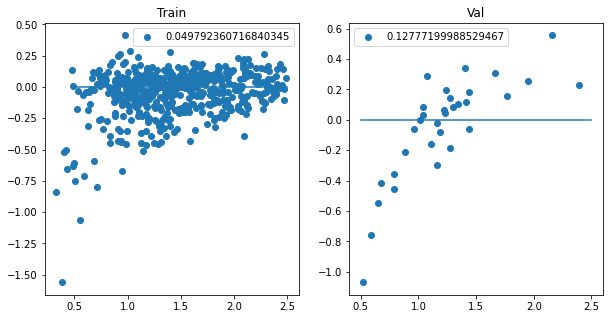

71/71 [==============================] - 30s 428ms/step - loss: 0.0348 - mse_loss: 0.0347 - adversarial_loss: 1.0699e-04 - val_loss: 0.1339 - val_mse_loss: 0.1338 - val_adversarial_loss: 8.9603e-05
Epoch 13/300
71/71 [==============================] - ETA: 0s - loss: 0.0320 - mse_loss: 0.0319 - adversarial_loss: 1.0014e-04

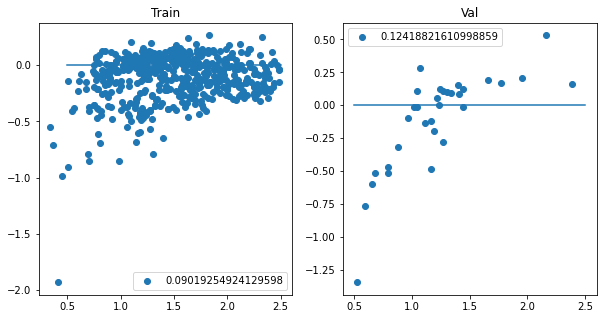

71/71 [==============================] - 30s 428ms/step - loss: 0.0320 - mse_loss: 0.0319 - adversarial_loss: 1.0014e-04 - val_loss: 0.1237 - val_mse_loss: 0.1236 - val_adversarial_loss: 1.0395e-04
Epoch 14/300
71/71 [==============================] - ETA: 0s - loss: 0.0267 - mse_loss: 0.0266 - adversarial_loss: 8.5746e-05

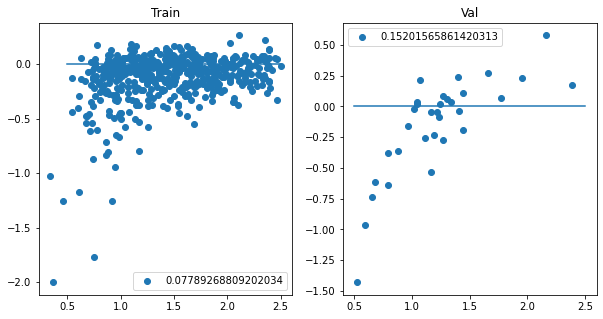

71/71 [==============================] - 31s 435ms/step - loss: 0.0267 - mse_loss: 0.0266 - adversarial_loss: 8.5746e-05 - val_loss: 0.1488 - val_mse_loss: 0.1488 - val_adversarial_loss: 6.2789e-05
Epoch 15/300
71/71 [==============================] - ETA: 0s - loss: 0.0264 - mse_loss: 0.0264 - adversarial_loss: 7.8577e-05

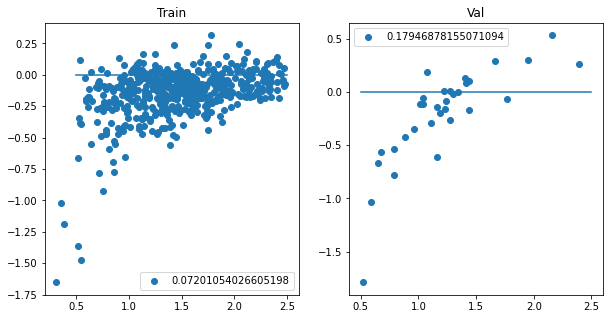

71/71 [==============================] - 30s 428ms/step - loss: 0.0264 - mse_loss: 0.0264 - adversarial_loss: 7.8577e-05 - val_loss: 0.1767 - val_mse_loss: 0.1767 - val_adversarial_loss: 5.4976e-05
Epoch 16/300
71/71 [==============================] - ETA: 0s - loss: 0.0251 - mse_loss: 0.0250 - adversarial_loss: 7.3555e-05

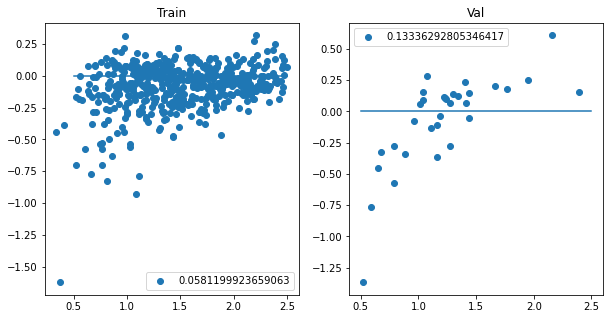

71/71 [==============================] - 31s 431ms/step - loss: 0.0251 - mse_loss: 0.0250 - adversarial_loss: 7.3555e-05 - val_loss: 0.1367 - val_mse_loss: 0.1367 - val_adversarial_loss: 5.1072e-05
Epoch 17/300
71/71 [==============================] - ETA: 0s - loss: 0.0217 - mse_loss: 0.0216 - adversarial_loss: 6.6886e-05

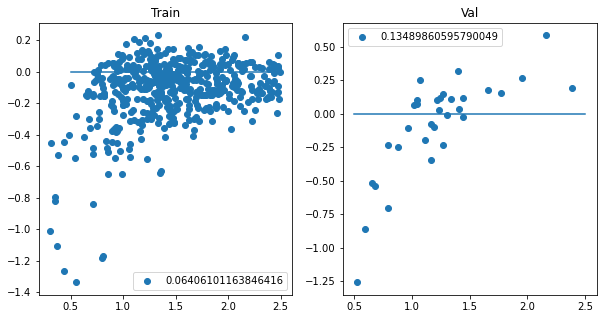

71/71 [==============================] - 31s 442ms/step - loss: 0.0217 - mse_loss: 0.0216 - adversarial_loss: 6.6886e-05 - val_loss: 0.1365 - val_mse_loss: 0.1364 - val_adversarial_loss: 4.5950e-05
Epoch 18/300
71/71 [==============================] - ETA: 0s - loss: 0.0235 - mse_loss: 0.0234 - adversarial_loss: 6.3690e-05

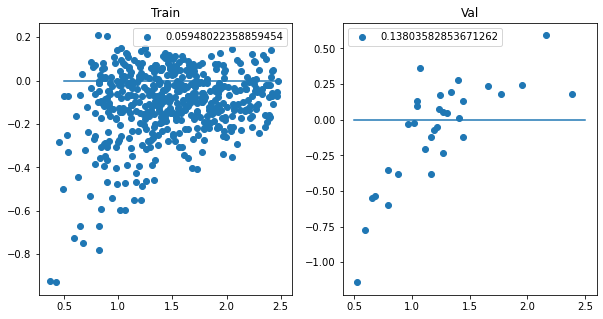

71/71 [==============================] - 30s 429ms/step - loss: 0.0235 - mse_loss: 0.0234 - adversarial_loss: 6.3690e-05 - val_loss: 0.1391 - val_mse_loss: 0.1390 - val_adversarial_loss: 5.5945e-05
Epoch 19/300
71/71 [==============================] - ETA: 0s - loss: 0.0200 - mse_loss: 0.0199 - adversarial_loss: 5.6396e-05

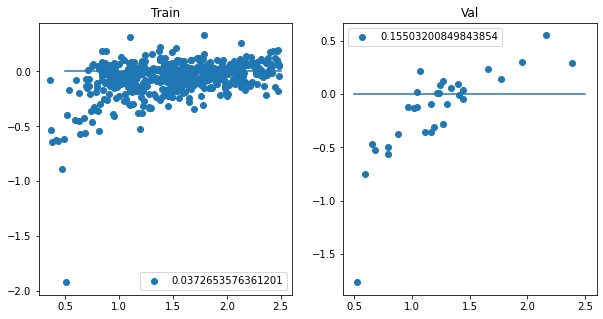

71/71 [==============================] - 30s 427ms/step - loss: 0.0200 - mse_loss: 0.0199 - adversarial_loss: 5.6396e-05 - val_loss: 0.1530 - val_mse_loss: 0.1530 - val_adversarial_loss: 4.5853e-05
Epoch 20/300
71/71 [==============================] - ETA: 0s - loss: 0.0193 - mse_loss: 0.0192 - adversarial_loss: 5.6446e-05

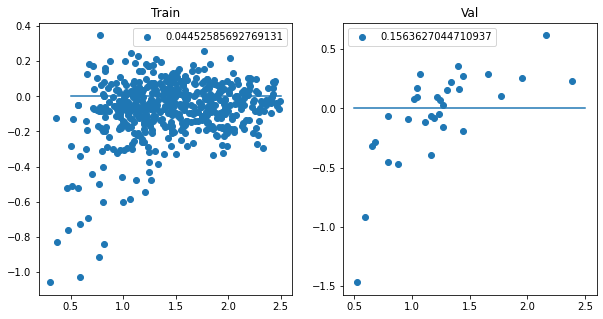

71/71 [==============================] - 30s 427ms/step - loss: 0.0193 - mse_loss: 0.0192 - adversarial_loss: 5.6446e-05 - val_loss: 0.1582 - val_mse_loss: 0.1581 - val_adversarial_loss: 4.2902e-05
Epoch 21/300
71/71 [==============================] - ETA: 0s - loss: 0.0172 - mse_loss: 0.0172 - adversarial_loss: 5.0316e-05

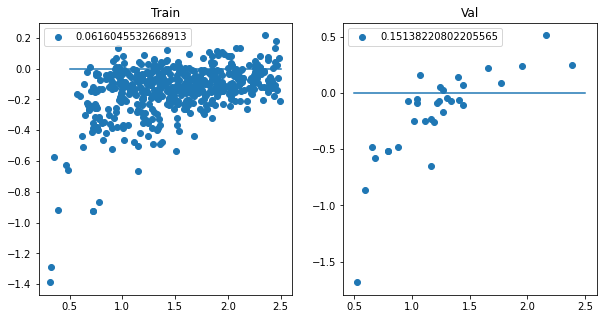

71/71 [==============================] - 30s 427ms/step - loss: 0.0172 - mse_loss: 0.0172 - adversarial_loss: 5.0316e-05 - val_loss: 0.1495 - val_mse_loss: 0.1495 - val_adversarial_loss: 3.6308e-05
Epoch 22/300
71/71 [==============================] - ETA: 0s - loss: 0.0179 - mse_loss: 0.0179 - adversarial_loss: 4.7837e-05

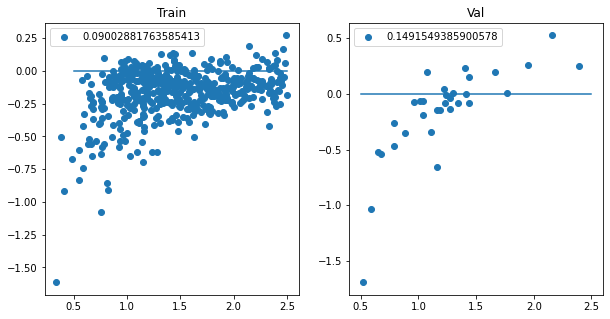

71/71 [==============================] - 30s 428ms/step - loss: 0.0179 - mse_loss: 0.0179 - adversarial_loss: 4.7837e-05 - val_loss: 0.1476 - val_mse_loss: 0.1475 - val_adversarial_loss: 4.2977e-05
Epoch 23/300
71/71 [==============================] - ETA: 0s - loss: 0.0186 - mse_loss: 0.0185 - adversarial_loss: 4.3950e-05

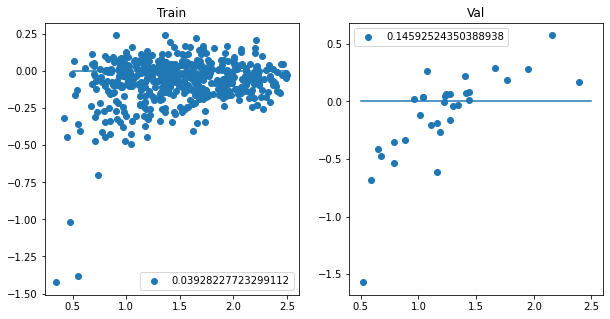

71/71 [==============================] - 30s 427ms/step - loss: 0.0186 - mse_loss: 0.0185 - adversarial_loss: 4.3950e-05 - val_loss: 0.1482 - val_mse_loss: 0.1482 - val_adversarial_loss: 3.6990e-05
Epoch 24/300
71/71 [==============================] - ETA: 0s - loss: 0.0162 - mse_loss: 0.0162 - adversarial_loss: 4.2088e-05

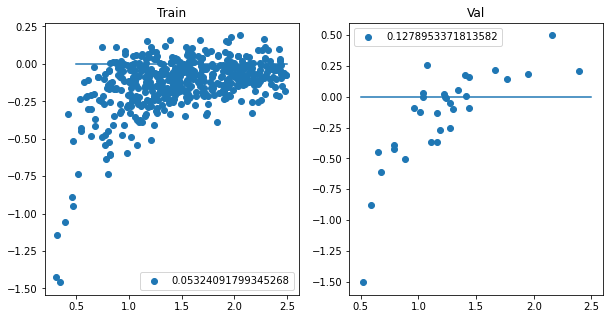

71/71 [==============================] - 30s 428ms/step - loss: 0.0162 - mse_loss: 0.0162 - adversarial_loss: 4.2088e-05 - val_loss: 0.1259 - val_mse_loss: 0.1259 - val_adversarial_loss: 3.4192e-05
Epoch 25/300
71/71 [==============================] - ETA: 0s - loss: 0.0172 - mse_loss: 0.0172 - adversarial_loss: 4.0765e-05

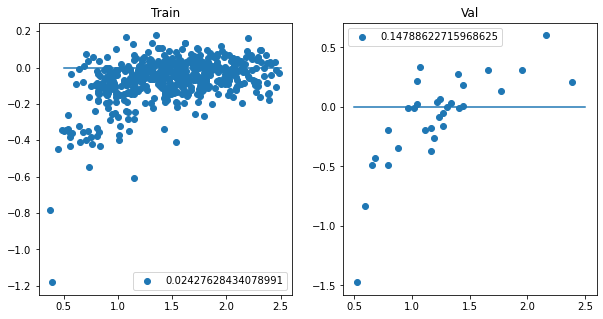

71/71 [==============================] - 30s 429ms/step - loss: 0.0172 - mse_loss: 0.0172 - adversarial_loss: 4.0765e-05 - val_loss: 0.1490 - val_mse_loss: 0.1490 - val_adversarial_loss: 2.6055e-05
Epoch 26/300
71/71 [==============================] - ETA: 0s - loss: 0.0152 - mse_loss: 0.0151 - adversarial_loss: 3.7778e-05

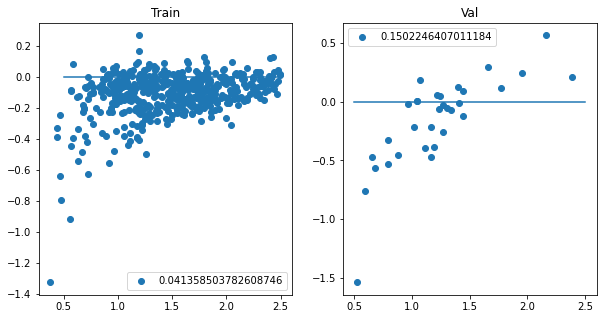

71/71 [==============================] - 32s 445ms/step - loss: 0.0152 - mse_loss: 0.0151 - adversarial_loss: 3.7778e-05 - val_loss: 0.1490 - val_mse_loss: 0.1490 - val_adversarial_loss: 2.8127e-05
Epoch 27/300
71/71 [==============================] - ETA: 0s - loss: 0.0131 - mse_loss: 0.0130 - adversarial_loss: 3.3853e-05

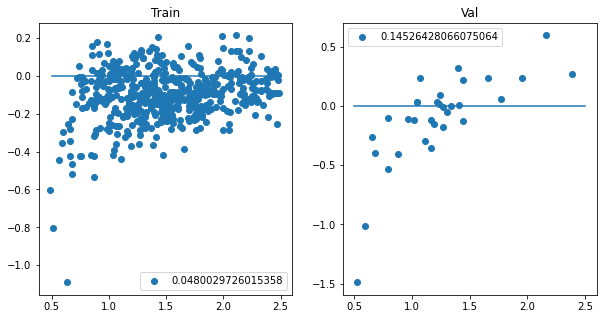

71/71 [==============================] - 31s 431ms/step - loss: 0.0131 - mse_loss: 0.0130 - adversarial_loss: 3.3853e-05 - val_loss: 0.1447 - val_mse_loss: 0.1447 - val_adversarial_loss: 2.3146e-05
Epoch 28/300
71/71 [==============================] - ETA: 0s - loss: 0.0154 - mse_loss: 0.0153 - adversarial_loss: 3.1971e-05

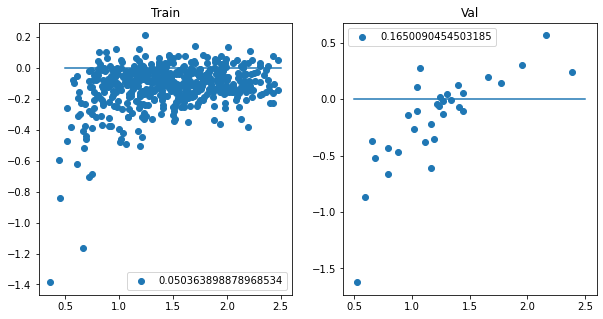

71/71 [==============================] - 30s 428ms/step - loss: 0.0154 - mse_loss: 0.0153 - adversarial_loss: 3.1971e-05 - val_loss: 0.1631 - val_mse_loss: 0.1631 - val_adversarial_loss: 1.9897e-05
Epoch 29/300
71/71 [==============================] - ETA: 0s - loss: 0.0133 - mse_loss: 0.0133 - adversarial_loss: 2.9868e-05

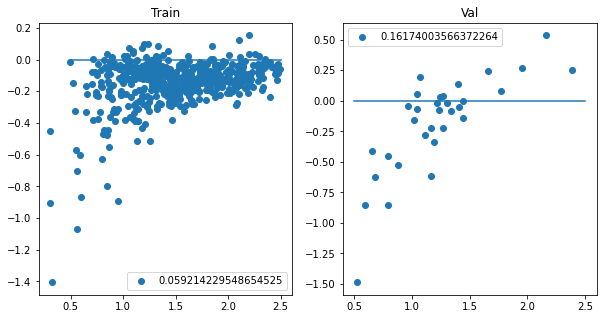

71/71 [==============================] - 30s 429ms/step - loss: 0.0133 - mse_loss: 0.0133 - adversarial_loss: 2.9868e-05 - val_loss: 0.1595 - val_mse_loss: 0.1595 - val_adversarial_loss: 2.0035e-05
Epoch 30/300
71/71 [==============================] - ETA: 0s - loss: 0.0158 - mse_loss: 0.0157 - adversarial_loss: 2.9053e-05

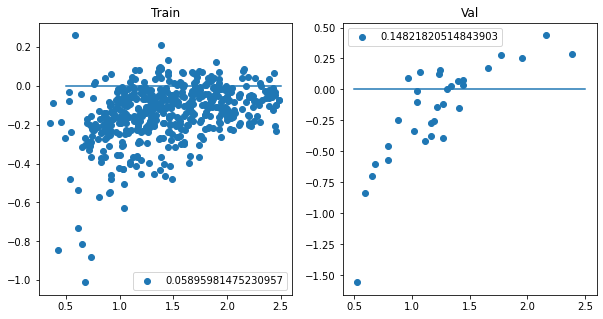

71/71 [==============================] - 31s 431ms/step - loss: 0.0158 - mse_loss: 0.0157 - adversarial_loss: 2.9053e-05 - val_loss: 0.1441 - val_mse_loss: 0.1441 - val_adversarial_loss: 1.8463e-05
Epoch 31/300
71/71 [==============================] - ETA: 0s - loss: 0.0135 - mse_loss: 0.0135 - adversarial_loss: 2.8302e-05

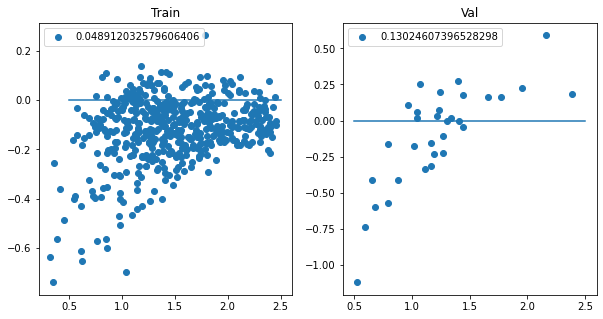

71/71 [==============================] - 31s 440ms/step - loss: 0.0135 - mse_loss: 0.0135 - adversarial_loss: 2.8302e-05 - val_loss: 0.1328 - val_mse_loss: 0.1327 - val_adversarial_loss: 1.7800e-05
Epoch 32/300
71/71 [==============================] - ETA: 0s - loss: 0.0127 - mse_loss: 0.0127 - adversarial_loss: 2.6331e-05

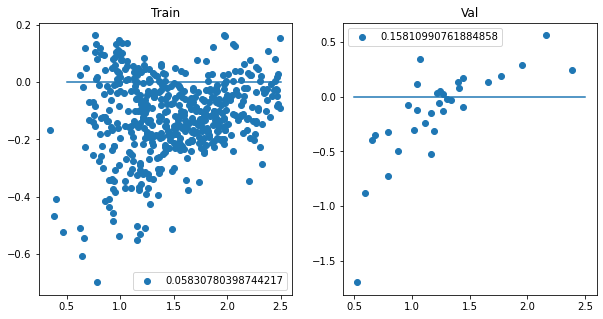

71/71 [==============================] - 31s 441ms/step - loss: 0.0127 - mse_loss: 0.0127 - adversarial_loss: 2.6331e-05 - val_loss: 0.1562 - val_mse_loss: 0.1561 - val_adversarial_loss: 2.4155e-05
Epoch 33/300
71/71 [==============================] - ETA: 0s - loss: 0.0125 - mse_loss: 0.0125 - adversarial_loss: 2.4059e-05

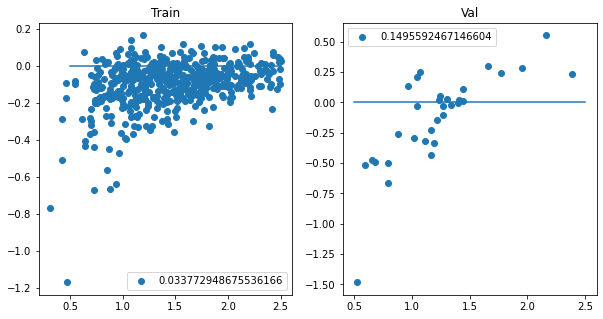

71/71 [==============================] - 31s 438ms/step - loss: 0.0125 - mse_loss: 0.0125 - adversarial_loss: 2.4059e-05 - val_loss: 0.1526 - val_mse_loss: 0.1526 - val_adversarial_loss: 1.7599e-05
Epoch 34/300
71/71 [==============================] - ETA: 0s - loss: 0.0127 - mse_loss: 0.0127 - adversarial_loss: 2.3044e-05

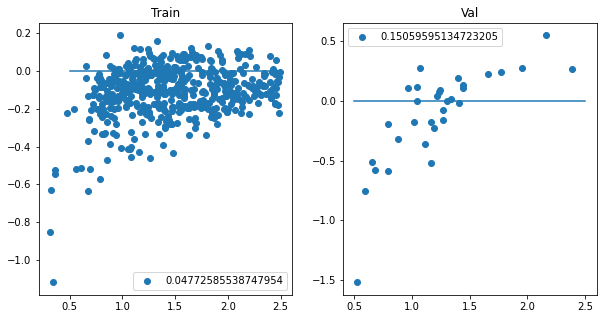

71/71 [==============================] - 30s 429ms/step - loss: 0.0127 - mse_loss: 0.0127 - adversarial_loss: 2.3044e-05 - val_loss: 0.1499 - val_mse_loss: 0.1499 - val_adversarial_loss: 2.7508e-05
Epoch 35/300
71/71 [==============================] - ETA: 0s - loss: 0.0115 - mse_loss: 0.0114 - adversarial_loss: 2.2030e-05

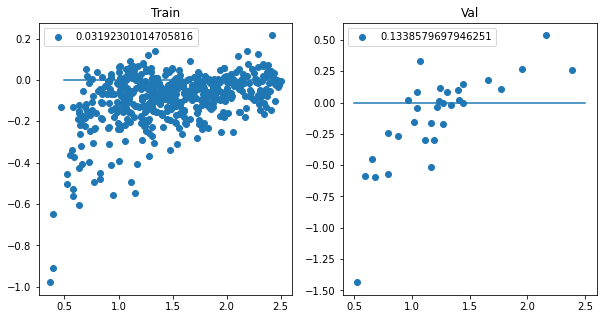

71/71 [==============================] - 31s 436ms/step - loss: 0.0115 - mse_loss: 0.0114 - adversarial_loss: 2.2030e-05 - val_loss: 0.1344 - val_mse_loss: 0.1344 - val_adversarial_loss: 1.4711e-05
Epoch 36/300
71/71 [==============================] - ETA: 0s - loss: 0.0124 - mse_loss: 0.0124 - adversarial_loss: 2.1220e-05

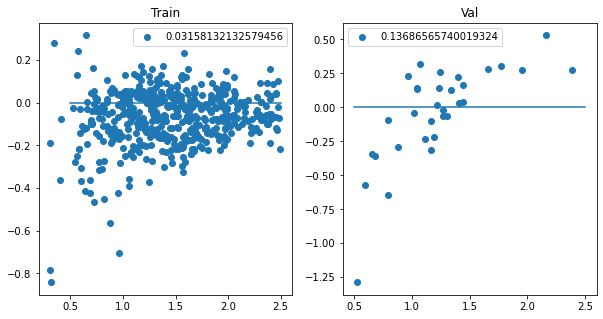

71/71 [==============================] - 31s 441ms/step - loss: 0.0124 - mse_loss: 0.0124 - adversarial_loss: 2.1220e-05 - val_loss: 0.1449 - val_mse_loss: 0.1449 - val_adversarial_loss: 2.2330e-05
Epoch 37/300
71/71 [==============================] - ETA: 0s - loss: 0.0118 - mse_loss: 0.0118 - adversarial_loss: 2.0403e-05

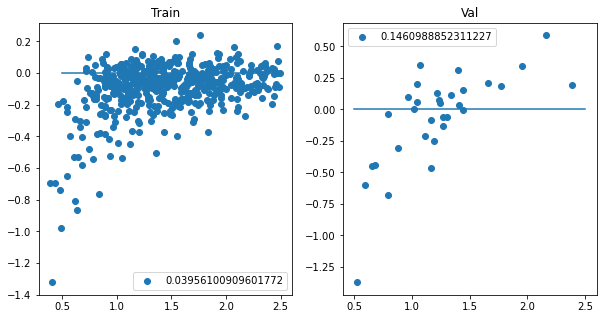

71/71 [==============================] - 31s 441ms/step - loss: 0.0118 - mse_loss: 0.0118 - adversarial_loss: 2.0403e-05 - val_loss: 0.1519 - val_mse_loss: 0.1519 - val_adversarial_loss: 1.4652e-05
Epoch 38/300
71/71 [==============================] - ETA: 0s - loss: 0.0113 - mse_loss: 0.0113 - adversarial_loss: 1.9658e-05

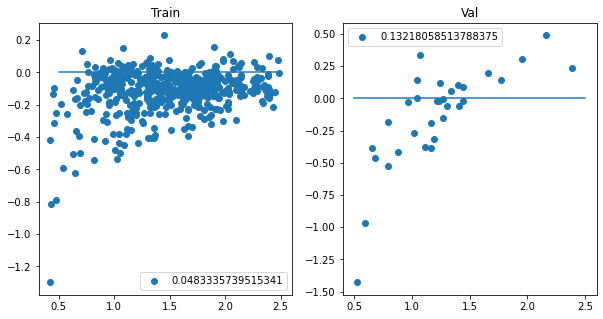

71/71 [==============================] - 31s 442ms/step - loss: 0.0113 - mse_loss: 0.0113 - adversarial_loss: 1.9658e-05 - val_loss: 0.1298 - val_mse_loss: 0.1298 - val_adversarial_loss: 1.6362e-05
Epoch 39/300
71/71 [==============================] - ETA: 0s - loss: 0.0117 - mse_loss: 0.0117 - adversarial_loss: 1.9411e-05

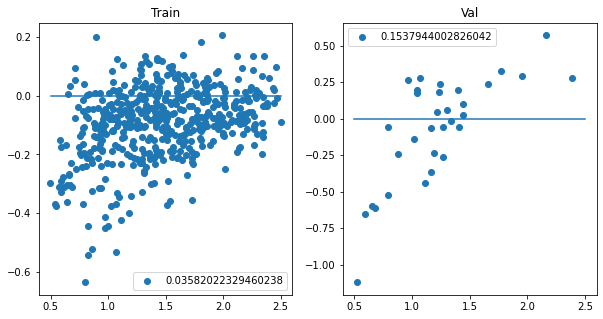

71/71 [==============================] - 31s 441ms/step - loss: 0.0117 - mse_loss: 0.0117 - adversarial_loss: 1.9411e-05 - val_loss: 0.1604 - val_mse_loss: 0.1604 - val_adversarial_loss: 1.3721e-05
Epoch 40/300
71/71 [==============================] - ETA: 0s - loss: 0.0112 - mse_loss: 0.0112 - adversarial_loss: 1.8239e-05

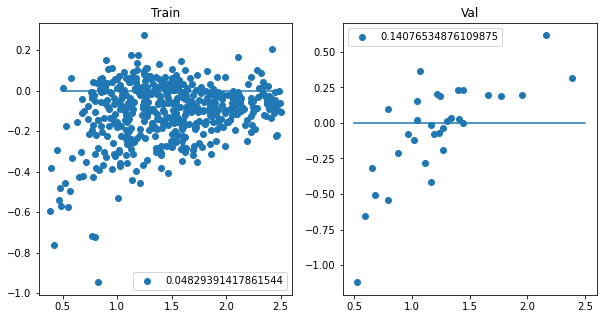

71/71 [==============================] - 31s 442ms/step - loss: 0.0112 - mse_loss: 0.0112 - adversarial_loss: 1.8239e-05 - val_loss: 0.1442 - val_mse_loss: 0.1442 - val_adversarial_loss: 1.4711e-05
Epoch 41/300
71/71 [==============================] - ETA: 0s - loss: 0.0112 - mse_loss: 0.0111 - adversarial_loss: 1.8535e-05

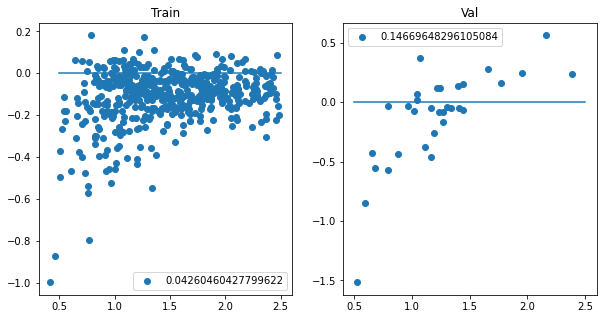

71/71 [==============================] - 31s 441ms/step - loss: 0.0112 - mse_loss: 0.0111 - adversarial_loss: 1.8535e-05 - val_loss: 0.1484 - val_mse_loss: 0.1484 - val_adversarial_loss: 9.9951e-06
Epoch 42/300
71/71 [==============================] - ETA: 0s - loss: 0.0097 - mse_loss: 0.0097 - adversarial_loss: 1.7094e-05

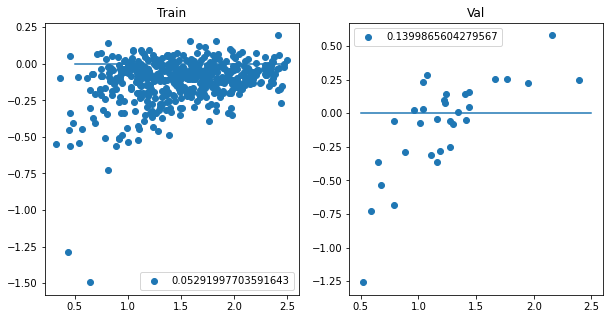

71/71 [==============================] - 31s 439ms/step - loss: 0.0097 - mse_loss: 0.0097 - adversarial_loss: 1.7094e-05 - val_loss: 0.1416 - val_mse_loss: 0.1416 - val_adversarial_loss: 1.1679e-05
Epoch 43/300
51/71 [====================>.........] - ETA: 8s - loss: 0.0114 - mse_loss: 0.0113 - adversarial_loss: 1.7081e-05

KeyboardInterrupt: 

In [248]:
globalize(model, batch_size, X_train, Y_train, X_val, Y_val)
model.fit(gen_flow, epochs = 300, validation_data = (X_val, Y_val), callbacks=[AdversarialDispersion()])

### Adversarial Adventure

In [542]:
cross_entropy = tf.keras.losses.BinaryCrossentropy(from_logits=False)

def discriminator_loss(_, outputs):
    real_output, fake_output = outputs[0], outputs[1]
    real_loss = cross_entropy(tf.ones_like(real_output), real_output)
    fake_loss = cross_entropy(tf.zeros_like(fake_output), fake_output)
    total_loss = real_loss + fake_loss
    return total_loss

def generator_loss(_, fake_output):
    return cross_entropy(tf.ones_like(fake_output), fake_output)


In [543]:
cross_entropy = tf.keras.losses.BinaryCrossentropy(from_logits=False)
mse = tf.keras.losses.MeanSquaredError()

class Adversarial(tf.keras.Model):
    def __init__(self, data, k):
        super().__init__()
        self.data = data
        self.output_names = ['mse', 'discriminator', 'generator']
        self.k = k
        inp = ResNet10V2(data[0,:,:,:].shape)
        self.feature_extractor = tf.keras.models.Model(inputs = inp.input, outputs = inp.layers[-2].output)
        
        self.regressor = tf.keras.Sequential([tf.keras.layers.Dense(1)])
        
        self.similarity = tf.keras.Sequential([tf.keras.layers.Dense(1, activation = 'sigmoid')])
        
        self.fe_optimizer = tf.keras.optimizers.Adam(1e-4)
        self.re_optimizer = tf.keras.optimizers.Adam(1e-4)
        self.si_optimizer = tf.keras.optimizers.Adam(1e-4)
    
    def similarity_loss(self, real_output, fake_output):
        real_loss = cross_entropy(tf.ones_like(real_output), real_output)
        fake_loss = cross_entropy(tf.zeros_like(fake_output), fake_output)
        total_loss = real_loss + fake_loss
        return total_loss
    
    def feature_loss(self,fake_output):
        return cross_entropy(tf.ones_like(fake_output), fake_output)
    
    
    def call(self, x):
        fill = tf.random.uniform((x.shape[0],), 0, self.data.shape[0], dtype='int32')
        features_val = self.feature_extractor(self.data[fill], training = False)
        features_train = self.feature_extractor(x)

        y_hat_re = self.regressor(features_train)
        y_hat_si_val = self.similarity(features_val)
        y_hat_si_train = self.similarity(features_train)
        return [y_hat_re, [y_hat_si_val, y_hat_si_train], y_hat_si_train]
    
    def similarity_loop(self, fe_val, fe_train):
        
        for i in range(self.k):
            with tf.GradientTape(persistent = True) as si_tape:
                y_hat_si_val = self.similarity(fe_val)
                y_hat_si_train = self.similarity(fe_train)

                si_loss = tf.math.multiply(1., self.similarity_loss(y_hat_si_val, y_hat_si_train))
            si_gradients = si_tape.gradient(si_loss, self.similarity.trainable_variables)
            self.si_optimizer.apply_gradients(zip(si_gradients, self.similarity.trainable_variables))
        return y_hat_si_val, y_hat_si_train
    
    def train_step(self, data):
        x, y = data
        
        with tf.GradientTape() as fe_tape, tf.GradientTape() as re_tape:
            fill = tf.random.uniform((x.shape[0],), 0, self.data.shape[0], dtype='int32')
            features_val = self.feature_extractor(self.data[fill], training = True)
            features_train = self.feature_extractor(x)
            
            y_hat_re = self.regressor(features_train)
            y_hat_si_val, y_hat_si_train = self.similarity_loop(features_val, features_train)
            #for i in range(self.k):
            #    y_hat_si_val = self.similarity(features_val)
            #    y_hat_si_train = self.similarity(features_train)

            #    si_loss = tf.math.multiply(1., self.similarity_loss(y_hat_si_val, y_hat_si_train))
            #    si_gradients = si_tape.gradient(si_loss, self.similarity.trainable_variables)
            #    self.si_optimizer.apply_gradients(zip(si_gradients, self.similarity.trainable_variables))
                
            #y_hat_si_val = self.similarity(features_val)
            #y_hat_si_train = self.similarity(features_train)
            
            #si_loss = tf.math.multiply(1., self.similarity_loss(y_hat_si_val, y_hat_si_train))
            fe_loss = self.feature_loss(y_hat_si_train)
            re_loss = mse(y, y_hat_re)
            total_loss = tf.math.add(tf.math.multiply(1.,fe_loss), re_loss) ####

            re_gradients = re_tape.gradient(re_loss, self.regressor.trainable_variables)
            #si_gradients = si_tape.gradient(si_loss, self.similarity.trainable_variables)
            fe_gradients = fe_tape.gradient(total_loss, self.feature_extractor.trainable_variables)

            self.re_optimizer.apply_gradients(zip(re_gradients, self.regressor.trainable_variables))
            #self.si_optimizer.apply_gradients(zip(si_gradients, self.similarity.trainable_variables))
            self.fe_optimizer.apply_gradients(zip(fe_gradients, self.feature_extractor.trainable_variables))
            
        loss = self.compiled_loss(y, [y_hat_re, [y_hat_si_val, y_hat_si_train], y_hat_si_train], regularization_losses=self.losses)
        self.compiled_metrics.update_state(y, [y_hat_re, [y_hat_si_val, y_hat_si_train], y_hat_si_train])

        return {m.name: m.result() for m in self.metrics}

In [544]:
model = Adversarial(X_val, 1)
model.compile(optimizer = optimizer, loss = ["mse", discriminator_loss, generator_loss], run_eagerly = True)

In [545]:

gen = tf.keras.preprocessing.image.ImageDataGenerator(fill_mode="nearest")
gen_flow = gen.flow(X_train, Y_train,  batch_size=batch_size, seed=1)

In [546]:
import numpy as np
import matplotlib.pyplot as plt

class AdversarialDispersion(tf.keras.callbacks.Callback):
    def on_epoch_end(self, epoch, logs=None):
        
        fig, ax = plt.subplots(1,2, figsize = (10,5))
        
        indexes = np.random.randint(X_train.shape[0], size=batch_size)
        pred_train = model.predict(X_train[indexes])[0]
        error_train = (Y_train[indexes] - pred_train) / Y_train[indexes]
        ax[0].scatter(Y_train[indexes], error_train)
        ax[0].set_title('Train')
        ax[0].legend(sum(np.square(Y_train[indexes] - pred_train)) / batch_size)
        ax[0].plot((0.5,2.5), (0,0))
        
        
        
        pred_val = model.predict(X_val)[0]
        error_val = (Y_val - pred_val) / Y_val
        ax[1].scatter(Y_val, error_val)
        ax[1].legend(sum(np.square(Y_val - pred_val)) / pred_val.shape[0])
        ax[1].plot((0.5,2.5), (0,0))
        ax[1].set_title('Val')
        plt.show()

In [ ]:
globalize(model, batch_size, X_train, Y_train, X_val, Y_val)
model.fit(gen_flow, epochs = 300, validation_data = (X_val, Y_val), callbacks=[AdversarialDispersion()])

In [34]:
#model.layers[0].layers

In [266]:
baseline = tf.keras.models.load_model('baseline.hdf5')
_ = model(X_val)
model.layers[0].set_weights(baseline.get_weights()[:-2])
model.layers[1].set_weights(baseline.get_weights()[-2:])

### Using predictive distribution to approximate data features

In [743]:
class ShiftNet(tf.keras.Model):
    def sim_data(self,x,y):
        #if evenly:
        #    space = np.ceil(len(y) / k).astype('int32')
        #    arg = np.argsort(y, axis=0)
        #    indexes = arg[::space].flatten()
        #else:
        #    indexes = np.random.randint(0,y.shape[0], k)
        self.target_x = tf.convert_to_tensor(x)
        self.target_y = tf.convert_to_tensor(y.astype('float32'))

    def KNN(self, x1, x2):
        x1 = tf.convert_to_tensor(x1)
        x2 = tf.convert_to_tensor(x2)
        #print(x1)
        #print(x2)
        distance = tf.math.abs(tf.math.add( x1, 
                                            tf.math.negative(tf.repeat(tf.transpose(x2), repeats = x1.shape[0], axis=0)) 
                                          ))
        idx = tf.math.argmin(distance,1)
        return idx
        
    def train_step(self, data):
        x, y = data
        
        with tf.GradientTape() as train_tape:
            pred_mse, pred_cos = self(x, training=True)
            idx = self.KNN(y, self.target_y)
            targets = tf.gather(self.target_x, idx)
            #print(targets)
            #print(tf.concat([y, tf.gather(self.target_y, idx)], axis=1))
            pred_target_mse, pred_target_cos = self(targets, training=False)
            
            loss = self.compiled_loss([y, pred_target_cos], [pred_mse, pred_cos], regularization_losses=self.losses)

        gradients = train_tape.gradient(loss, self.trainable_variables)
        self.optimizer.apply_gradients(zip(gradients, self.trainable_variables))
        
        self.compiled_metrics.update_state([y, pred_target_cos], [pred_mse, pred_cos])

        return {m.name: m.result() for m in self.metrics}

In [744]:
inp = ResNet10V2(X_val[0,:,:,:].shape)

y_hat = tf.keras.layers.Dense(1)(inp.layers[-2].output)

model = ShiftNet(inp.input, [y_hat, inp.layers[-2].output])
model.compile(optimizer = optimizer , loss = ["mse", "mse"], loss_weights = [1.0, 1.0], run_eagerly = True)
model.sim_data(X_val, Y_val)

In [745]:

gen = tf.keras.preprocessing.image.ImageDataGenerator(fill_mode="nearest")
gen_flow = gen.flow(X_train, Y_train,  batch_size=batch_size, seed=1)

In [746]:
import numpy as np
import matplotlib.pyplot as plt

class AdversarialDispersion(tf.keras.callbacks.Callback):
    def on_epoch_end(self, epoch, logs=None):
        
        fig, ax = plt.subplots(1,2, figsize = (10,5))
        
        indexes = np.random.randint(X_train.shape[0], size=batch_size)
        pred_train = model.predict(X_train[indexes])[0]
        error_train = (Y_train[indexes] - pred_train) / Y_train[indexes]
        ax[0].scatter(Y_train[indexes], error_train)
        ax[0].set_title('Train')
        ax[0].legend(sum(np.square(Y_train[indexes] - pred_train)) / batch_size)
        ax[0].plot((0.5,2.5), (0,0))
        
        
        
        pred_val = model.predict(X_val)[0]
        error_val = (Y_val - pred_val) / Y_val
        ax[1].scatter(Y_val, error_val)
        ax[1].legend(sum(np.square(Y_val - pred_val)) / pred_val.shape[0])
        ax[1].plot((0.5,2.5), (0,0))
        ax[1].set_title('Val')
        plt.show()

In [747]:
globalize(model, batch_size, X_train, Y_train, X_val, Y_val)
model.fit(gen_flow, epochs = 300, validation_data = (X_val, Y_val), callbacks=[AdversarialDispersion()])

Epoch 1/300
 12/568 [..............................] - ETA: 1:18 - loss: 1.6046 - dense_367_loss: 1.2544 - global_average_pooling2d_77_loss: 0.3502

KeyboardInterrupt: 

### Crazy NF Attempt

In [53]:
class MLP_ODE(tf.keras.Model):
    def __init__(self, num_hidden, num_layers, num_output, name='mlp_ode'):
        super(MLP_ODE, self).__init__(name=name)
        self._num_hidden = num_hidden
        self._num_output = num_output
        self._num_layers = num_layers
        self._modules = []
        for _ in range(self._num_layers - 1):
            self._modules.append(tf.keras.layers.Dense(self._num_hidden))
            self._modules.append(tf.keras.layers.BatchNormalization())
            self._modules.append(tf.keras.layers.Activation('tanh'))
        self._modules.append(tf.keras.layers.Dense(self._num_output))
        self._model = tf.keras.Sequential(self._modules)

    def call(self, t, inputs):
        inputs = tf.concat([tf.broadcast_to(t, inputs.shape), inputs], -1)
        return self._model(inputs)
    
tfb = tfp.bijectors


In [61]:
def create_bijectors():    
    solver = tfp.math.ode.DormandPrince(atol=1e-5)
    ode_solve_fn = solver.solve
    trace_augmentation_fn = tfb.ffjord.trace_jacobian_exact

    bijectors = []
    for _ in range(1):
        mlp_model = MLP_ODE(8, 3, 2)
        next_ffjord = tfb.FFJORD(
          state_time_derivative_fn=mlp_model,ode_solve_fn=ode_solve_fn,
          trace_augmentation_fn=trace_augmentation_fn)
        bijectors.append(next_ffjord)

    stacked_ffjord = tfb.Chain(bijectors[::-1])
    return stacked_ffjord

In [62]:
def negloglik(_,x):
    return tf.math.negative(tf.reduce_mean(tf.math.log(x)))

kl_div = tf.keras.losses.KLDivergence()
mse = tf.keras.losses.MeanSquaredError()

In [63]:
class NF_NET(tf.keras.Model):
    def __init__(self, data):
        super().__init__()
        self.data = data
        self.output_names = ['mse', 'nnl_train','nnl_val', 'kl_div']

        
        inp = ResNet10V2(data[0,:,:,:].shape)
        dense = tf.keras.layers.Dense(2)(inp.layers[-2].output)
        self.feature_extractor = tf.keras.models.Model(inputs = inp.input, outputs = dense)
        
        self.regressor = tf.keras.Sequential([tf.keras.layers.Dense(1)])
        
        
        
        #base_loc = np.zeros((inp.layers[-2].output.shape[1],), dtype = 'float32')
        #base_sigma = np.ones((inp.layers[-2].output.shape[1],), dtype = 'float32')
        base_loc = np.zeros((2,), dtype = 'float32')
        base_sigma = np.ones((2,), dtype = 'float32')
        base_distribution = tfd.MultivariateNormalDiag(base_loc, base_sigma)
        
        bj_train = create_bijectors()
        bj_val = create_bijectors()
        
        self.nf_train = tfd.TransformedDistribution(
    distribution=base_distribution, bijector=bj_train)
        self.nf_val = tfd.TransformedDistribution(
    distribution=base_distribution, bijector=bj_val)
        
        
        #self.nf = tf.keras.Sequential([tf.keras.layers.Dense(1, activation = 'sigmoid')])
        
        
        
        self.fe_optimizer = tf.keras.optimizers.Adam(1e-4)
        self.re_optimizer = tf.keras.optimizers.Adam(1e-4)
        self.nf_t_optimizer = tf.keras.optimizers.Adam(1e-4)
        self.nf_v_optimizer = tf.keras.optimizers.Adam(1e-4)
    
    
    def call(self, x):
        fill = tf.random.uniform((x.shape[0],), 0, self.data.shape[0], dtype='int32')
        features_val = self.feature_extractor(self.data[fill], training = False)
        features_train = self.feature_extractor(x)

        y_hat_re = self.regressor(features_train)
        y_hat_nf_val = self.nf_val.prob(features_val)
        y_hat_nf_train = self.nf_train.prob(features_train)
        return [y_hat_re, y_hat_nf_train, y_hat_nf_val, [y_hat_nf_val, y_hat_nf_train]]
    
    
    def train_step(self, data):
        x, y = data
        
        with tf.GradientTape() as fe_tape, tf.GradientTape() as re_tape, tf.GradientTape() as nf_t_tape, tf.GradientTape() as nf_v_tape:
                
            fill = tf.random.uniform((x.shape[0],), 0, self.data.shape[0], dtype='int32')
            features_val = self.feature_extractor(self.data[fill], training = False)
            features_train = self.feature_extractor(x)
            
            y_hat_re = self.regressor(features_train)
            y_hat_nf_val = self.nf_val.prob(features_val)
            y_hat_nf_train = self.nf_train.prob(features_train)
            
       
            loss_nf_t = negloglik(y, y_hat_nf_train)
            loss_nf_v = negloglik(y, y_hat_nf_val)
            loss_kl_div = kl_div(y_hat_nf_val, y_hat_nf_train)
            loss_re = mse(y, y_hat_re)
            total_loss = tf.math.add(loss_re, loss_kl_div)

        nf_t_gradients = nf_t_tape.gradient(loss_nf_t, self.nf_train.trainable_variables)
        nf_v_gradients = nf_v_tape.gradient(loss_nf_v, self.nf_val.trainable_variables)
        re_gradients = re_tape.gradient(loss_re, self.regressor.trainable_variables)
        fe_gradients = fe_tape.gradient(total_loss, self.feature_extractor.trainable_variables)

        self.nf_t_optimizer.apply_gradients(zip(nf_t_gradients, self.nf_train.trainable_variables))
        self.nf_v_optimizer.apply_gradients(zip(nf_v_gradients, self.nf_val.trainable_variables))
        self.re_optimizer.apply_gradients(zip(re_gradients, self.regressor.trainable_variables))
        self.fe_optimizer.apply_gradients(zip(fe_gradients, self.feature_extractor.trainable_variables))
            
        loss = self.compiled_loss(y, [y_hat_re, y_hat_nf_train, y_hat_nf_val, [y_hat_nf_val, y_hat_nf_train]], regularization_losses=self.losses)
        self.compiled_metrics.update_state(y, [y_hat_re, y_hat_nf_train, y_hat_nf_val, [y_hat_nf_val, y_hat_nf_train]])

        return {m.name: m.result() for m in self.metrics}

In [64]:
model = NF_NET(X_val)
model.compile(optimizer = optimizer, loss = ["mse", negloglik, negloglik, kl_div], run_eagerly = True)

In [65]:
batch_size = 64*8
gen = tf.keras.preprocessing.image.ImageDataGenerator(fill_mode="nearest")
gen_flow = gen.flow(X_train, Y_train,  batch_size=batch_size, seed=1)

In [66]:
import numpy as np
import matplotlib.pyplot as plt

class AdversarialDispersion(tf.keras.callbacks.Callback):
    def on_epoch_end(self, epoch, logs=None):
        
        fig, ax = plt.subplots(1,2, figsize = (10,5))
        
        indexes = np.random.randint(X_train.shape[0], size=batch_size)
        pred_train = model.predict(X_train[indexes])[0]
        error_train = (Y_train[indexes] - pred_train) / Y_train[indexes]
        ax[0].scatter(Y_train[indexes], error_train)
        ax[0].set_title('Train')
        ax[0].legend(sum(np.square(Y_train[indexes] - pred_train)) / batch_size)
        ax[0].plot((0.5,2.5), (0,0))
        
        
        
        pred_val = model.predict(X_val)[0]
        error_val = (Y_val - pred_val) / Y_val
        ax[1].scatter(Y_val, error_val)
        ax[1].legend(sum(np.square(Y_val - pred_val)) / pred_val.shape[0])
        ax[1].plot((0.5,2.5), (0,0))
        ax[1].set_title('Val')
        plt.show()

In [ ]:
globalize(model, batch_size, X_train, Y_train, X_val, Y_val)
model.fit(gen_flow, epochs = 300, validation_data = (X_val, Y_val), callbacks=[AdversarialDispersion()])

Epoch 1/300
50/71 [====================>.........] - ETA: 6:01 - loss: 2137.8149 - mse_loss: 0.8836 - nnl_train_loss: 2.8629 - nnl_val_loss: 4.3482 - kl_div_loss: 2129.7202